In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:29,516] A new study created in memory with name: no-name-edc4dbe3-ce3a-4939-8eb1-74d52f719b6c
[I 2025-05-21 00:06:38,075] Trial 0 finished with value: 0.05546450093388557 and parameters: {'lr': 0.5518789984363179, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.11258131714297814}. Best is trial 0 with value: 0.05546450093388557.


Cross Validation Accuracies:
[0.04179703816771507, 0.05275905504822731, 0.05931121110916138, 0.0717114806175232, 0.05174371972680092]
Mean Cross Validation Accuracy:
0.05546450093388557
Standard Deviation of Cross Validation Accuracy:
0.009866354105838495


[I 2025-05-21 00:15:27,921] Trial 1 finished with value: 0.06295196637511254 and parameters: {'lr': 0.004413720236141473, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22667916044585434}. Best is trial 0 with value: 0.05546450093388557.


Cross Validation Accuracies:
[0.05628979578614235, 0.05209871754050255, 0.06267836689949036, 0.08403293788433075, 0.059660013765096664]
Mean Cross Validation Accuracy:
0.06295196637511254
Standard Deviation of Cross Validation Accuracy:
0.011113025651501246


[I 2025-05-21 00:23:15,393] Trial 2 finished with value: 0.05153346359729767 and parameters: {'lr': 0.07384448092839656, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.26127642493496606}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.04252738505601883, 0.0457686185836792, 0.056778017431497574, 0.06364627182483673, 0.04894702509045601]
Mean Cross Validation Accuracy:
0.05153346359729767
Standard Deviation of Cross Validation Accuracy:
0.007684504160313237


[I 2025-05-21 00:34:57,602] Trial 3 finished with value: 0.06821324303746223 and parameters: {'lr': 0.005876902938400359, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13914866740955026}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.06460151821374893, 0.05490526184439659, 0.06281474232673645, 0.08054409921169281, 0.07820059359073639]
Mean Cross Validation Accuracy:
0.06821324303746223
Standard Deviation of Cross Validation Accuracy:
0.009706574211579165


[I 2025-05-21 00:42:02,480] Trial 4 finished with value: 0.05617077946662903 and parameters: {'lr': 0.0012875612057850882, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4763374469393947}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.04903716966509819, 0.05057113990187645, 0.060583457350730896, 0.06311052292585373, 0.057551607489585876]
Mean Cross Validation Accuracy:
0.05617077946662903
Standard Deviation of Cross Validation Accuracy:
0.005509678819555928


[I 2025-05-21 00:49:10,222] Trial 5 finished with value: 0.3279962301254272 and parameters: {'lr': 0.01595807887257437, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.35667845752308847}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.33614832162857056, 0.29754015803337097, 0.3370852470397949, 0.3502837121486664, 0.3189237117767334]
Mean Cross Validation Accuracy:
0.3279962301254272
Standard Deviation of Cross Validation Accuracy:
0.018197151402048653


[I 2025-05-21 00:58:04,279] Trial 6 finished with value: 0.6672236561775208 and parameters: {'lr': 0.4176400357250939, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13681808969616407}. Best is trial 2 with value: 0.05153346359729767.


Cross Validation Accuracies:
[0.48834866285324097, 0.5513358116149902, 0.5928149223327637, 0.9039112329483032, 0.7997076511383057]
Mean Cross Validation Accuracy:
0.6672236561775208
Standard Deviation of Cross Validation Accuracy:
0.1578201085697793


[I 2025-05-21 01:08:41,683] Trial 7 finished with value: 0.050855860114097595 and parameters: {'lr': 0.030352053102970206, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.36776069420791446}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04338105767965317, 0.043859295547008514, 0.05687088146805763, 0.06233687698841095, 0.04783118888735771]
Mean Cross Validation Accuracy:
0.050855860114097595
Standard Deviation of Cross Validation Accuracy:
0.007509559954646532


[I 2025-05-21 01:15:27,891] Trial 8 finished with value: 0.07601092159748077 and parameters: {'lr': 0.11248297275463415, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.44210273417241186}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.0645236000418663, 0.08350156992673874, 0.06902534514665604, 0.08802815526723862, 0.07497593760490417]
Mean Cross Validation Accuracy:
0.07601092159748077
Standard Deviation of Cross Validation Accuracy:
0.008744732634031398


[I 2025-05-21 01:21:19,903] Trial 9 finished with value: 0.3221215844154358 and parameters: {'lr': 0.017064681723606676, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.46403044948305383}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.277052104473114, 0.32566651701927185, 0.33738580346107483, 0.31574156880378723, 0.35476192831993103]
Mean Cross Validation Accuracy:
0.3221215844154358
Standard Deviation of Cross Validation Accuracy:
0.02601121912528874


[I 2025-05-21 01:31:41,736] Trial 10 finished with value: 0.46244009733200075 and parameters: {'lr': 0.08786782211969547, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3533077073445875}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.43609288334846497, 0.5326026678085327, 0.4559714198112488, 0.3928699791431427, 0.4946635365486145]
Mean Cross Validation Accuracy:
0.46244009733200075
Standard Deviation of Cross Validation Accuracy:
0.04803573076199528


[I 2025-05-21 01:40:38,524] Trial 11 finished with value: 0.05234026089310646 and parameters: {'lr': 0.07028175594742758, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2659786910690122}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04348636791110039, 0.04590046405792236, 0.060470517724752426, 0.06215545907616615, 0.04968849569559097]
Mean Cross Validation Accuracy:
0.05234026089310646
Standard Deviation of Cross Validation Accuracy:
0.0076070158984884746


[I 2025-05-21 01:49:42,273] Trial 12 finished with value: 0.05239376202225685 and parameters: {'lr': 0.03794947763357871, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.34782046406487155}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.043493401259183884, 0.04706139862537384, 0.05774190276861191, 0.06375133246183395, 0.04992077499628067]
Mean Cross Validation Accuracy:
0.05239376202225685
Standard Deviation of Cross Validation Accuracy:
0.007366996697063083


[I 2025-05-21 01:55:57,703] Trial 13 finished with value: 0.05094001740217209 and parameters: {'lr': 0.27922163325808397, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.20910043225221703}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04208924621343613, 0.04473491758108139, 0.05632966384291649, 0.062259916216135025, 0.04928634315729141]
Mean Cross Validation Accuracy:
0.05094001740217209
Standard Deviation of Cross Validation Accuracy:
0.007439925414247489


[I 2025-05-21 02:04:20,148] Trial 14 finished with value: 0.05359750464558601 and parameters: {'lr': 0.24406189010612328, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.22233787004808542}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.044731657952070236, 0.049071405082941055, 0.057139802724123, 0.06553646922111511, 0.051508188247680664]
Mean Cross Validation Accuracy:
0.05359750464558601
Standard Deviation of Cross Validation Accuracy:
0.007190838736439599


[I 2025-05-21 02:13:29,402] Trial 15 finished with value: 0.05649444833397865 and parameters: {'lr': 0.8671648768472249, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.418732069314958}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.051982581615448, 0.054199349135160446, 0.05851932615041733, 0.06696897745132446, 0.05080200731754303]
Mean Cross Validation Accuracy:
0.05649444833397865
Standard Deviation of Cross Validation Accuracy:
0.005862494294162338


[I 2025-05-21 02:23:35,826] Trial 16 finished with value: 0.054681087285280226 and parameters: {'lr': 0.2458898961016869, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.18804537334296048}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.046008285135030746, 0.04916977509856224, 0.06270837038755417, 0.06681087613105774, 0.04870812967419624]
Mean Cross Validation Accuracy:
0.054681087285280226
Standard Deviation of Cross Validation Accuracy:
0.008400444431431538


[I 2025-05-21 02:33:14,024] Trial 17 finished with value: 0.05265631452202797 and parameters: {'lr': 0.029424127048802262, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.31026651902920893}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04713711515069008, 0.04593338072299957, 0.057296767830848694, 0.06300303339958191, 0.04991127550601959]
Mean Cross Validation Accuracy:
0.05265631452202797
Standard Deviation of Cross Validation Accuracy:
0.006508195421291212


[I 2025-05-21 02:41:12,974] Trial 18 finished with value: 0.05115128457546234 and parameters: {'lr': 0.007833397468318942, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.401775486849688}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.042820584028959274, 0.04508340731263161, 0.05653437599539757, 0.06260842084884644, 0.04870963469147682]
Mean Cross Validation Accuracy:
0.05115128457546234
Standard Deviation of Cross Validation Accuracy:
0.007381395600433905


[I 2025-05-21 02:47:09,023] Trial 19 finished with value: 13.685708236694335 and parameters: {'lr': 0.16365389290958912, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.29575252518211675}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[12.846256256103516, 16.82706642150879, 10.07559585571289, 12.26413345336914, 16.415489196777344]
Mean Cross Validation Accuracy:
13.685708236694335
Standard Deviation of Cross Validation Accuracy:
2.572092581185674


[I 2025-05-21 02:53:57,688] Trial 20 finished with value: 0.5036359369754791 and parameters: {'lr': 0.0015107720253403675, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.18465335631124052}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.5028360486030579, 0.5075955986976624, 0.507061243057251, 0.4913659989833832, 0.5093207955360413]
Mean Cross Validation Accuracy:
0.5036359369754791
Standard Deviation of Cross Validation Accuracy:
0.006494928164341113


[I 2025-05-21 03:01:10,103] Trial 21 finished with value: 0.05113359987735748 and parameters: {'lr': 0.006862856409169233, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3992992937840002}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.042784418910741806, 0.04544306546449661, 0.056254222989082336, 0.0626053586602211, 0.04858093336224556]
Mean Cross Validation Accuracy:
0.05113359987735748
Standard Deviation of Cross Validation Accuracy:
0.007299714263985463


[I 2025-05-21 03:08:15,799] Trial 22 finished with value: 0.2171670287847519 and parameters: {'lr': 0.0028204953364634722, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.38936010479432986}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.21957620978355408, 0.23192334175109863, 0.27722182869911194, 0.21083340048789978, 0.14628036320209503]
Mean Cross Validation Accuracy:
0.2171670287847519
Standard Deviation of Cross Validation Accuracy:
0.042178587276080495


[I 2025-05-21 03:14:52,929] Trial 23 finished with value: 0.05105367377400398 and parameters: {'lr': 0.011737381034553965, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3116622002871407}. Best is trial 7 with value: 0.050855860114097595.


Cross Validation Accuracies:
[0.04275411367416382, 0.04487450420856476, 0.05621074512600899, 0.06266443431377411, 0.04876457154750824]
Mean Cross Validation Accuracy:
0.05105367377400398
Standard Deviation of Cross Validation Accuracy:
0.007398783259620609


[I 2025-05-21 03:23:30,678] Trial 24 finished with value: 0.050433243811130526 and parameters: {'lr': 0.03737837945167207, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3191410752056673}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04197392612695694, 0.04376792162656784, 0.05629090964794159, 0.0628327801823616, 0.047300681471824646]
Mean Cross Validation Accuracy:
0.050433243811130526
Standard Deviation of Cross Validation Accuracy:
0.007922881718070247


[I 2025-05-21 03:30:01,667] Trial 25 finished with value: 0.05603054165840149 and parameters: {'lr': 0.03456152873165979, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2585780195685582}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.057018741965293884, 0.04416492581367493, 0.05694517120718956, 0.07101186364889145, 0.051012005656957626]
Mean Cross Validation Accuracy:
0.05603054165840149
Standard Deviation of Cross Validation Accuracy:
0.008856993153584469


[I 2025-05-21 03:36:16,375] Trial 26 finished with value: 0.05239826291799545 and parameters: {'lr': 0.04865309432939573, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32791065581275564}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04497269168496132, 0.046052929013967514, 0.057531293481588364, 0.06368124485015869, 0.049753155559301376]
Mean Cross Validation Accuracy:
0.05239826291799545
Standard Deviation of Cross Validation Accuracy:
0.007156153261044499


[I 2025-05-21 03:42:45,367] Trial 27 finished with value: 0.2556251049041748 and parameters: {'lr': 0.020491677052135424, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3735210971000368}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.2600573003292084, 0.30796539783477783, 0.19412164390087128, 0.27299365401268005, 0.2429875284433365]
Mean Cross Validation Accuracy:
0.2556251049041748
Standard Deviation of Cross Validation Accuracy:
0.03742512838366755


[I 2025-05-21 03:50:00,354] Trial 28 finished with value: 12.936040115356445 and parameters: {'lr': 0.14077946412068093, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21445793558322876}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[12.998711585998535, 11.102079391479492, 13.013484954833984, 13.481223106384277, 14.084701538085938]
Mean Cross Validation Accuracy:
12.936040115356445
Standard Deviation of Cross Validation Accuracy:
0.9989979890760959


[I 2025-05-21 04:00:48,689] Trial 29 finished with value: 0.865675151348114 and parameters: {'lr': 0.4923659234953605, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.278884665993987}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[1.1777524948120117, 0.8111864328384399, 0.8576177954673767, 0.7318400740623474, 0.7499789595603943]
Mean Cross Validation Accuracy:
0.865675151348114
Standard Deviation of Cross Validation Accuracy:
0.16231059511835133


[I 2025-05-21 04:06:39,894] Trial 30 finished with value: 0.06011151224374771 and parameters: {'lr': 0.8913280459189977, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.10445092365265951}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.054114580154418945, 0.0564575232565403, 0.07269149273633957, 0.06462011486291885, 0.05267385020852089]
Mean Cross Validation Accuracy:
0.06011151224374771
Standard Deviation of Cross Validation Accuracy:
0.007526181678972374


[I 2025-05-21 04:12:23,182] Trial 31 finished with value: 0.051236022263765335 and parameters: {'lr': 0.011557343604094938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32051724296164474}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04292907193303108, 0.045117128640413284, 0.05657083913683891, 0.0627562403678894, 0.04880683124065399]
Mean Cross Validation Accuracy:
0.051236022263765335
Standard Deviation of Cross Validation Accuracy:
0.0073962551096317325


[I 2025-05-21 04:19:47,753] Trial 32 finished with value: 0.05097685009241104 and parameters: {'lr': 0.0095385003264528, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28994253863647335}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04219742491841316, 0.04527978226542473, 0.05614681541919708, 0.06278140097856522, 0.04847882688045502]
Mean Cross Validation Accuracy:
0.05097685009241104
Standard Deviation of Cross Validation Accuracy:
0.007508008674509567


[I 2025-05-21 04:27:28,333] Trial 33 finished with value: 0.23777825832366944 and parameters: {'lr': 0.0030896959743057124, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.23803265787471073}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.28539595007896423, 0.23161959648132324, 0.20908251404762268, 0.22832046449184418, 0.23447276651859283]
Mean Cross Validation Accuracy:
0.23777825832366944
Standard Deviation of Cross Validation Accuracy:
0.025413364844450063


[I 2025-05-21 04:33:23,469] Trial 34 finished with value: 0.05170042961835861 and parameters: {'lr': 0.056255122667120135, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.19297290001644948}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.044717561453580856, 0.04581223800778389, 0.058837100863456726, 0.06171673908829689, 0.0474185086786747]
Mean Cross Validation Accuracy:
0.05170042961835861
Standard Deviation of Cross Validation Accuracy:
0.007113713896993585


[I 2025-05-21 04:40:54,243] Trial 35 finished with value: 0.09719895720481872 and parameters: {'lr': 0.026851508780970874, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.29553058573228763}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.10696279257535934, 0.10745514184236526, 0.09815008193254471, 0.09443674236536026, 0.07899002730846405]
Mean Cross Validation Accuracy:
0.09719895720481872
Standard Deviation of Cross Validation Accuracy:
0.010398282564922355


[I 2025-05-21 04:49:05,733] Trial 36 finished with value: 0.054420842230319975 and parameters: {'lr': 0.00422678405058702, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.33432759603977763}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042580388486385345, 0.048417266458272934, 0.06158832460641861, 0.06859588623046875, 0.050922345370054245]
Mean Cross Validation Accuracy:
0.054420842230319975
Standard Deviation of Cross Validation Accuracy:
0.009389179125057667


[I 2025-05-21 04:56:25,551] Trial 37 finished with value: 0.338869971036911 and parameters: {'lr': 0.01339216626520026, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.13730024026272397}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.3290025293827057, 0.37988826632499695, 0.34728649258613586, 0.2618075907230377, 0.37636497616767883]
Mean Cross Validation Accuracy:
0.338869971036911
Standard Deviation of Cross Validation Accuracy:
0.04288400787595459


[I 2025-05-21 05:02:48,206] Trial 38 finished with value: 0.051319868117570874 and parameters: {'lr': 0.008402507930684108, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1592156725806386}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04412821680307388, 0.04591507092118263, 0.05583491548895836, 0.06272458285093307, 0.047996554523706436]
Mean Cross Validation Accuracy:
0.051319868117570874
Standard Deviation of Cross Validation Accuracy:
0.006963178376600711


[I 2025-05-21 05:09:44,972] Trial 39 finished with value: 4.464042472839355 and parameters: {'lr': 0.3561587967331019, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.24102577035518802}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[3.8061842918395996, 3.7161710262298584, 7.22193717956543, 3.0477259159088135, 4.528193950653076]
Mean Cross Validation Accuracy:
4.464042472839355
Standard Deviation of Cross Validation Accuracy:
1.4565809487900805


[I 2025-05-21 05:17:52,059] Trial 40 finished with value: 0.2193756192922592 and parameters: {'lr': 0.018530258819673306, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.376845674125124}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.15742753446102142, 0.22182832658290863, 0.2610197067260742, 0.2949206531047821, 0.1616818755865097]
Mean Cross Validation Accuracy:
0.2193756192922592
Standard Deviation of Cross Validation Accuracy:
0.05406187418509833


[I 2025-05-21 05:24:45,890] Trial 41 finished with value: 0.051099643856287 and parameters: {'lr': 0.010701493236760323, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2832441001653555}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04258056357502937, 0.04533354565501213, 0.056613001972436905, 0.06231224909424782, 0.048658858984708786]
Mean Cross Validation Accuracy:
0.051099643856287
Standard Deviation of Cross Validation Accuracy:
0.007319831719839538


[I 2025-05-21 05:31:44,977] Trial 42 finished with value: 0.05092206969857216 and parameters: {'lr': 0.022090198510389212, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3630621300172976}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042396385222673416, 0.0451434887945652, 0.055324241518974304, 0.06285689771175385, 0.04888933524489403]
Mean Cross Validation Accuracy:
0.05092206969857216
Standard Deviation of Cross Validation Accuracy:
0.007376049604584745


[I 2025-05-21 05:39:55,886] Trial 43 finished with value: 0.05108741894364357 and parameters: {'lr': 0.04698871241939184, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4224695598594986}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.041999250650405884, 0.045658741146326065, 0.05774053558707237, 0.06098966300487518, 0.049048904329538345]
Mean Cross Validation Accuracy:
0.05108741894364357
Standard Deviation of Cross Validation Accuracy:
0.007190817559978635


[I 2025-05-21 05:46:56,756] Trial 44 finished with value: 0.053218836337327956 and parameters: {'lr': 0.09215277613390052, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3663843927868293}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0400368757545948, 0.051879800856113434, 0.05823000892996788, 0.0642792209982872, 0.05166827514767647]
Mean Cross Validation Accuracy:
0.053218836337327956
Standard Deviation of Cross Validation Accuracy:
0.008067283315083752


[I 2025-05-21 05:53:21,467] Trial 45 finished with value: 0.05201904475688934 and parameters: {'lr': 0.02297008874253552, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3410585929484522}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.045044202357530594, 0.046952053904533386, 0.056252703070640564, 0.061662718653678894, 0.05018354579806328]
Mean Cross Validation Accuracy:
0.05201904475688934
Standard Deviation of Cross Validation Accuracy:
0.006141924587078842


[I 2025-05-21 05:59:35,390] Trial 46 finished with value: 0.05249976813793182 and parameters: {'lr': 0.06493513378267732, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4964974580825686}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04537615552544594, 0.04741161689162254, 0.05724387988448143, 0.06288251280784607, 0.04958467558026314]
Mean Cross Validation Accuracy:
0.05249976813793182
Standard Deviation of Cross Validation Accuracy:
0.0065641585526592


[I 2025-05-21 06:07:50,610] Trial 47 finished with value: 0.05112811103463173 and parameters: {'lr': 0.005455018434692666, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.3565985070287006}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04280805587768555, 0.04518680274486542, 0.05635102093219757, 0.062447622418403625, 0.048847053200006485]
Mean Cross Validation Accuracy:
0.05112811103463173
Standard Deviation of Cross Validation Accuracy:
0.0072819751801143995


[I 2025-05-21 06:15:29,356] Trial 48 finished with value: 0.05169562548398972 and parameters: {'lr': 0.03889566831059792, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4214732739710132}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042489007115364075, 0.046687159687280655, 0.057426486164331436, 0.06299926340579987, 0.048876211047172546]
Mean Cross Validation Accuracy:
0.05169562548398972
Standard Deviation of Cross Validation Accuracy:
0.007462045880235847


[I 2025-05-21 06:23:18,429] Trial 49 finished with value: 0.05285592973232269 and parameters: {'lr': 0.016981895241232864, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4438108507062478}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04457526654005051, 0.048116330057382584, 0.05804203450679779, 0.06365872919559479, 0.049887288361787796]
Mean Cross Validation Accuracy:
0.05285592973232269
Standard Deviation of Cross Validation Accuracy:
0.006977709918660998


[I 2025-05-21 06:29:27,045] Trial 50 finished with value: 0.05340316072106362 and parameters: {'lr': 0.12057941880153704, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.2651169766334324}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04419638589024544, 0.04933646693825722, 0.061027754098176956, 0.0654960498213768, 0.04695914685726166]
Mean Cross Validation Accuracy:
0.05340316072106362
Standard Deviation of Cross Validation Accuracy:
0.008333071543484661


[I 2025-05-21 06:35:16,652] Trial 51 finished with value: 0.051240439713001254 and parameters: {'lr': 0.01004549203238462, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3067555338060908}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042615655809640884, 0.04553423821926117, 0.05661793798208237, 0.06259912252426147, 0.04883524402976036]
Mean Cross Validation Accuracy:
0.051240439713001254
Standard Deviation of Cross Validation Accuracy:
0.007357577889255337


[I 2025-05-21 06:41:22,748] Trial 52 finished with value: 0.05096243694424629 and parameters: {'lr': 0.027573042364715406, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3162312744312893}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04214823246002197, 0.044599439948797226, 0.05706311762332916, 0.062480974942445755, 0.048520419746637344]
Mean Cross Validation Accuracy:
0.05096243694424629
Standard Deviation of Cross Validation Accuracy:
0.00766859050688367


[I 2025-05-21 06:49:19,258] Trial 53 finished with value: 0.051341093331575396 and parameters: {'lr': 0.02477359031305221, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3441932424074565}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.043414413928985596, 0.04564081132411957, 0.05623679980635643, 0.062824547290802, 0.04858889430761337]
Mean Cross Validation Accuracy:
0.051341093331575396
Standard Deviation of Cross Validation Accuracy:
0.0071935765444506635


[I 2025-05-21 06:58:06,232] Trial 54 finished with value: 0.05121971145272255 and parameters: {'lr': 0.015379729779705772, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2833257703259192}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.04249849170446396, 0.04576468840241432, 0.05624258518218994, 0.0627611055970192, 0.04883168637752533]
Mean Cross Validation Accuracy:
0.05121971145272255
Standard Deviation of Cross Validation Accuracy:
0.007347824894929914


[I 2025-05-21 07:05:59,660] Trial 55 finished with value: 0.05128016993403435 and parameters: {'lr': 0.0307492805784045, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3845306509682807}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.042034585028886795, 0.04528464004397392, 0.05743503198027611, 0.06247277557849884, 0.04917381703853607]
Mean Cross Validation Accuracy:
0.05128016993403435
Standard Deviation of Cross Validation Accuracy:
0.00760290325260081


[I 2025-05-21 07:12:29,916] Trial 56 finished with value: 2.644948196411133 and parameters: {'lr': 0.25937971792586495, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32138688319762154}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[3.320505380630493, 2.7698447704315186, 2.167811632156372, 1.799710750579834, 3.1668684482574463]
Mean Cross Validation Accuracy:
2.644948196411133
Standard Deviation of Cross Validation Accuracy:
0.5807689821992899


[I 2025-05-21 07:18:22,548] Trial 57 finished with value: 0.052229438722133634 and parameters: {'lr': 0.0444508808801289, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.35704570013287423}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0442282110452652, 0.04556960240006447, 0.057934001088142395, 0.06356009095907211, 0.04985528811812401]
Mean Cross Validation Accuracy:
0.052229438722133634
Standard Deviation of Cross Validation Accuracy:
0.007415326926932877


[I 2025-05-21 07:24:44,346] Trial 58 finished with value: 0.05296849980950356 and parameters: {'lr': 0.661852450644778, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20444262170493663}. Best is trial 24 with value: 0.050433243811130526.


Cross Validation Accuracies:
[0.0413963608443737, 0.048999249935150146, 0.060257479548454285, 0.06086944043636322, 0.05331996828317642]
Mean Cross Validation Accuracy:
0.05296849980950356
Standard Deviation of Cross Validation Accuracy:
0.007284874237834349


[I 2025-05-21 07:33:22,229] Trial 59 finished with value: 0.03162175677716732 and parameters: {'lr': 0.0010081360098625786, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16166304459917463}. Best is trial 59 with value: 0.03162175677716732.


Cross Validation Accuracies:
[0.025342129170894623, 0.028123361989855766, 0.036764610558748245, 0.0402519665658474, 0.02762671560049057]
Mean Cross Validation Accuracy:
0.03162175677716732
Standard Deviation of Cross Validation Accuracy:
0.005806243346261749


[I 2025-05-21 07:41:33,253] Trial 60 finished with value: 0.029260244965553284 and parameters: {'lr': 0.0014456919220217819, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12504411327251702}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02325894683599472, 0.028573455289006233, 0.029662830755114555, 0.036719199270009995, 0.028086792677640915]
Mean Cross Validation Accuracy:
0.029260244965553284
Standard Deviation of Cross Validation Accuracy:
0.004328101759561377


[I 2025-05-21 07:51:22,444] Trial 61 finished with value: 0.031133480742573737 and parameters: {'lr': 0.001067798177206867, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1685431613078528}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02414175122976303, 0.027311241254210472, 0.03181565925478935, 0.0400848425924778, 0.032313909381628036]
Mean Cross Validation Accuracy:
0.031133480742573737
Standard Deviation of Cross Validation Accuracy:
0.005394060706908254


[I 2025-05-21 08:01:59,222] Trial 62 finished with value: 0.031190507113933563 and parameters: {'lr': 0.0011588932623188201, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1540630669087759}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.0220344178378582, 0.032669104635715485, 0.033528830856084824, 0.04024628549814224, 0.027473896741867065]
Mean Cross Validation Accuracy:
0.031190507113933563
Standard Deviation of Cross Validation Accuracy:
0.006120593013550952


[I 2025-05-21 08:09:32,170] Trial 63 finished with value: 0.03168450929224491 and parameters: {'lr': 0.0010392242112079652, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12454500075815758}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03000032715499401, 0.028964512050151825, 0.03053515963256359, 0.03895038366317749, 0.02997216396033764]
Mean Cross Validation Accuracy:
0.03168450929224491
Standard Deviation of Cross Validation Accuracy:
0.0036682670573042558


[I 2025-05-21 08:16:15,420] Trial 64 finished with value: 0.03201966919004917 and parameters: {'lr': 0.0011757500141731589, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15575159996323068}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02284727618098259, 0.03316603600978851, 0.03321830928325653, 0.04221706464886665, 0.02864965982735157]
Mean Cross Validation Accuracy:
0.03201966919004917
Standard Deviation of Cross Validation Accuracy:
0.006359678069201268


[I 2025-05-21 08:23:02,034] Trial 65 finished with value: 0.032786577567458154 and parameters: {'lr': 0.0010473926851456879, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12205117002033503}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03113696724176407, 0.03241925686597824, 0.031324371695518494, 0.040431637316942215, 0.028620654717087746]
Mean Cross Validation Accuracy:
0.032786577567458154
Standard Deviation of Cross Validation Accuracy:
0.004019851651609215


[I 2025-05-21 08:29:41,133] Trial 66 finished with value: 0.03042711056768894 and parameters: {'lr': 0.0010797902469965972, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12243755397579002}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.02333221584558487, 0.03001600317656994, 0.02983683906495571, 0.03962460905313492, 0.029325885698199272]
Mean Cross Validation Accuracy:
0.03042711056768894
Standard Deviation of Cross Validation Accuracy:
0.005228032812725556


[I 2025-05-21 08:36:03,461] Trial 67 finished with value: 0.030605563521385194 and parameters: {'lr': 0.0017350090286919104, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15909871709510826}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.0274607315659523, 0.02778857760131359, 0.030639730393886566, 0.03871239349246025, 0.028426384553313255]
Mean Cross Validation Accuracy:
0.030605563521385194
Standard Deviation of Cross Validation Accuracy:
0.004202286478377645


[I 2025-05-21 08:43:32,964] Trial 68 finished with value: 0.03140632249414921 and parameters: {'lr': 0.0018725374026875323, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16512358729124063}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.028671858832240105, 0.028435228392481804, 0.03229883685708046, 0.039219025522470474, 0.028406662866473198]
Mean Cross Validation Accuracy:
0.03140632249414921
Standard Deviation of Cross Validation Accuracy:
0.004174627170369887


[I 2025-05-21 08:51:47,454] Trial 69 finished with value: 0.032672460004687306 and parameters: {'lr': 0.0016353779482484248, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.16770466024346486}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.024078290909528732, 0.025248972699046135, 0.035535864531993866, 0.04445652663707733, 0.03404264524579048]
Mean Cross Validation Accuracy:
0.032672460004687306
Standard Deviation of Cross Validation Accuracy:
0.007455315227295745


[I 2025-05-21 08:57:38,889] Trial 70 finished with value: 0.03461599498987198 and parameters: {'lr': 0.0019724583608950277, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.17448626207800527}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.026592759415507317, 0.035906288772821426, 0.0328991562128067, 0.04699406400322914, 0.030687706544995308]
Mean Cross Validation Accuracy:
0.03461599498987198
Standard Deviation of Cross Validation Accuracy:
0.0068939501756262785


[I 2025-05-21 09:02:50,807] Trial 71 finished with value: 0.030809585750102998 and parameters: {'lr': 0.002100296063102598, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11370444825690766}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.022425634786486626, 0.028082815930247307, 0.031545668840408325, 0.04168954864144325, 0.030304260551929474]
Mean Cross Validation Accuracy:
0.030809585750102998
Standard Deviation of Cross Validation Accuracy:
0.006275295559565036


[I 2025-05-21 09:08:33,143] Trial 72 finished with value: 0.03466539904475212 and parameters: {'lr': 0.0020009976077075935, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.148139605207636}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03469192236661911, 0.02977314032614231, 0.04342718422412872, 0.03846796602010727, 0.02696678228676319]
Mean Cross Validation Accuracy:
0.03466539904475212
Standard Deviation of Cross Validation Accuracy:
0.00590647092559355


[I 2025-05-21 09:15:19,619] Trial 73 finished with value: 0.030646011233329773 and parameters: {'lr': 0.0014124647642694197, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10083681741207912}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.03232090547680855, 0.02502293698489666, 0.029525626450777054, 0.03916589170694351, 0.02719469554722309]
Mean Cross Validation Accuracy:
0.030646011233329773
Standard Deviation of Cross Validation Accuracy:
0.004902640921810129


[I 2025-05-21 09:20:40,842] Trial 74 finished with value: 0.034846014156937596 and parameters: {'lr': 0.002764729794322568, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10150221193962597}. Best is trial 60 with value: 0.029260244965553284.


Cross Validation Accuracies:
[0.028483696281909943, 0.04073607176542282, 0.03449300304055214, 0.04060898348689079, 0.0299083162099123]
Mean Cross Validation Accuracy:
0.034846014156937596
Standard Deviation of Cross Validation Accuracy:
0.005155369254214519


[I 2025-05-21 09:25:52,163] Trial 75 finished with value: 0.02892891988158226 and parameters: {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.022303422912955284, 0.02493550069630146, 0.032134152948856354, 0.038703713566064835, 0.026567809283733368]
Mean Cross Validation Accuracy:
0.02892891988158226
Standard Deviation of Cross Validation Accuracy:
0.00585217157499122


[I 2025-05-21 09:31:03,764] Trial 76 finished with value: 0.030369213223457335 and parameters: {'lr': 0.0014240495166765639, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12415609467460002}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027717797085642815, 0.028413953259587288, 0.03190543130040169, 0.038478996604681015, 0.025329887866973877]
Mean Cross Validation Accuracy:
0.030369213223457335
Standard Deviation of Cross Validation Accuracy:
0.004568947396960833


[I 2025-05-21 09:36:15,684] Trial 77 finished with value: 0.029854414984583855 and parameters: {'lr': 0.0014514274355296986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12108118976581857}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02303067408502102, 0.034363023936748505, 0.028448235243558884, 0.03741256520152092, 0.026017576456069946]
Mean Cross Validation Accuracy:
0.029854414984583855
Standard Deviation of Cross Validation Accuracy:
0.0053050033102279865


[I 2025-05-21 09:41:27,852] Trial 78 finished with value: 0.03201723769307137 and parameters: {'lr': 0.0014040797142500852, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11841954208706566}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02816920168697834, 0.025751693174242973, 0.037561219185590744, 0.040598124265670776, 0.028005950152873993]
Mean Cross Validation Accuracy:
0.03201723769307137
Standard Deviation of Cross Validation Accuracy:
0.0059079980046199375


[I 2025-05-21 09:46:28,989] Trial 79 finished with value: 0.032908587530255315 and parameters: {'lr': 0.002388710975650464, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1286239246111367}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.03212607651948929, 0.030795199796557426, 0.0338512547314167, 0.04099028557538986, 0.02678012102842331]
Mean Cross Validation Accuracy:
0.032908587530255315
Standard Deviation of Cross Validation Accuracy:
0.00466560387525278


[I 2025-05-21 09:51:55,785] Trial 80 finished with value: 0.05031934678554535 and parameters: {'lr': 0.0035406972192590885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10939349472866161}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.04446573555469513, 0.04695839062333107, 0.05472157895565033, 0.06378120929002762, 0.0416698195040226]
Mean Cross Validation Accuracy:
0.05031934678554535
Standard Deviation of Cross Validation Accuracy:
0.008012196991202364


[I 2025-05-21 09:57:05,373] Trial 81 finished with value: 0.03193980008363724 and parameters: {'lr': 0.0014320780508007155, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.14365111183292004}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.032898396253585815, 0.02951870672404766, 0.030420958995819092, 0.03906174749135971, 0.02779919095337391]
Mean Cross Validation Accuracy:
0.03193980008363724
Standard Deviation of Cross Validation Accuracy:
0.003923117555488704


[I 2025-05-21 10:02:15,780] Trial 82 finished with value: 0.03343916572630405 and parameters: {'lr': 0.0017057659585646404, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11328401961848387}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.024391889572143555, 0.03144478425383568, 0.03314967080950737, 0.04933687672019005, 0.02887260727584362]
Mean Cross Validation Accuracy:
0.03343916572630405
Standard Deviation of Cross Validation Accuracy:
0.008479448584675923


[I 2025-05-21 10:07:26,919] Trial 83 finished with value: 0.03425704278051853 and parameters: {'lr': 0.002354097518445903, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13383244171750003}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02517281286418438, 0.031373441219329834, 0.033678848296403885, 0.04526451602578163, 0.03579559549689293]
Mean Cross Validation Accuracy:
0.03425704278051853
Standard Deviation of Cross Validation Accuracy:
0.006552927768627041


[I 2025-05-21 10:12:36,538] Trial 84 finished with value: 0.02999826371669769 and parameters: {'lr': 0.0013049039363096555, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13759497728681921}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023713409900665283, 0.027078473940491676, 0.029414169490337372, 0.0387149304151535, 0.03107033483684063]
Mean Cross Validation Accuracy:
0.02999826371669769
Standard Deviation of Cross Validation Accuracy:
0.005009897019101587


[I 2025-05-21 10:17:47,033] Trial 85 finished with value: 0.03054726906120777 and parameters: {'lr': 0.0013109789341707522, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13961133070533752}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.024029918015003204, 0.02852562628686428, 0.03126577287912369, 0.04213156923651695, 0.02678345888853073]
Mean Cross Validation Accuracy:
0.03054726906120777
Standard Deviation of Cross Validation Accuracy:
0.00625206253120511


[I 2025-05-21 10:23:00,602] Trial 86 finished with value: 0.030713951960206032 and parameters: {'lr': 0.001314654133939153, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13792560145207922}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.025950850918889046, 0.02884274534881115, 0.0317588709294796, 0.04018622636795044, 0.026831066235899925]
Mean Cross Validation Accuracy:
0.030713951960206032
Standard Deviation of Cross Validation Accuracy:
0.005139672856676784


[I 2025-05-21 10:28:05,029] Trial 87 finished with value: 0.03065322935581207 and parameters: {'lr': 0.001662950296556859, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.14501002360532605}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02340702898800373, 0.03184694051742554, 0.032874107360839844, 0.0383719801902771, 0.026766089722514153]
Mean Cross Validation Accuracy:
0.03065322935581207
Standard Deviation of Cross Validation Accuracy:
0.0051682421420500895


[I 2025-05-21 10:33:14,163] Trial 88 finished with value: 0.050107187032699584 and parameters: {'lr': 0.003462971556877114, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1287865139748109}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.042926568537950516, 0.04637341573834419, 0.05679396539926529, 0.05567555129528046, 0.04876643419265747]
Mean Cross Validation Accuracy:
0.050107187032699584
Standard Deviation of Cross Validation Accuracy:
0.005348263899773919


[I 2025-05-21 10:38:28,991] Trial 89 finished with value: 0.033667571097612384 and parameters: {'lr': 0.0024461159775788555, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1063249990870765}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.03146393224596977, 0.03494224697351456, 0.03285109996795654, 0.04061031714081764, 0.02847025915980339]
Mean Cross Validation Accuracy:
0.033667571097612384
Standard Deviation of Cross Validation Accuracy:
0.004058601283249474


[I 2025-05-21 10:43:55,756] Trial 90 finished with value: 0.029549747705459595 and parameters: {'lr': 0.001271431467856402, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10084369024337858}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023859180510044098, 0.029573284089565277, 0.03011026792228222, 0.0399525947868824, 0.02425341121852398]
Mean Cross Validation Accuracy:
0.029549747705459595
Standard Deviation of Cross Validation Accuracy:
0.0058132211288182585


[I 2025-05-21 10:49:25,155] Trial 91 finished with value: 0.029419084638357164 and parameters: {'lr': 0.0013409266193940578, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12071864285915174}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023622654378414154, 0.02649390511214733, 0.031147025525569916, 0.03874342888593674, 0.027088409289717674]
Mean Cross Validation Accuracy:
0.029419084638357164
Standard Deviation of Cross Validation Accuracy:
0.005244358911378356


[I 2025-05-21 10:54:39,373] Trial 92 finished with value: 0.030808959901332856 and parameters: {'lr': 0.0012095156889940885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1793174142790444}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02496487647294998, 0.026357805356383324, 0.034914419054985046, 0.03897649049758911, 0.028831208124756813]
Mean Cross Validation Accuracy:
0.030808959901332856
Standard Deviation of Cross Validation Accuracy:
0.0053186641347947984


[I 2025-05-21 11:00:48,613] Trial 93 finished with value: 0.031932439655065536 and parameters: {'lr': 0.001567848903435735, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12155220698527078}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.023414356634020805, 0.0286096204072237, 0.0338822565972805, 0.03867406025528908, 0.035081904381513596]
Mean Cross Validation Accuracy:
0.031932439655065536
Standard Deviation of Cross Validation Accuracy:
0.005343579859904523


[I 2025-05-21 11:04:04,809] Trial 94 finished with value: 0.031487008556723595 and parameters: {'lr': 0.0013115192442512966, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.13391844906109687}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02491820603609085, 0.026160912588238716, 0.032814960926771164, 0.03969361260533333, 0.033847350627183914]
Mean Cross Validation Accuracy:
0.031487008556723595
Standard Deviation of Cross Validation Accuracy:
0.005407392847166544


[I 2025-05-21 11:07:02,842] Trial 95 finished with value: 0.032438061013817784 and parameters: {'lr': 0.0018525512849797308, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15059023338345903}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027263779193162918, 0.03230118378996849, 0.03521191328763962, 0.03789953887462616, 0.02951388992369175]
Mean Cross Validation Accuracy:
0.032438061013817784
Standard Deviation of Cross Validation Accuracy:
0.0038174520601936468


[I 2025-05-21 11:09:59,695] Trial 96 finished with value: 0.031310655921697614 and parameters: {'lr': 0.002181899540733276, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1146858690681445}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.02332657389342785, 0.028056340292096138, 0.03653864935040474, 0.04088951647281647, 0.02774219959974289]
Mean Cross Validation Accuracy:
0.031310655921697614
Standard Deviation of Cross Validation Accuracy:
0.0064211603518568704


[I 2025-05-21 11:12:57,487] Trial 97 finished with value: 0.04084825962781906 and parameters: {'lr': 0.002953436549079501, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.1300544246112823}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.027050267904996872, 0.04193327948451042, 0.04002484306693077, 0.05480251461267471, 0.04043039306998253]
Mean Cross Validation Accuracy:
0.04084825962781906
Standard Deviation of Cross Validation Accuracy:
0.00879926932361723


[I 2025-05-21 11:16:37,394] Trial 98 finished with value: 0.06413637325167656 and parameters: {'lr': 0.0012363466182173377, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.19301048888324718}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.05323684588074684, 0.06007181107997894, 0.06406768411397934, 0.07914011180400848, 0.06416541337966919]
Mean Cross Validation Accuracy:
0.06413637325167656
Standard Deviation of Cross Validation Accuracy:
0.008490442799178897


[I 2025-05-21 11:18:33,688] Trial 99 finished with value: 0.030597278103232383 and parameters: {'lr': 0.0015481657515323084, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.14143320432450543}. Best is trial 75 with value: 0.02892891988158226.


Cross Validation Accuracies:
[0.025968216359615326, 0.027736078947782516, 0.02975679188966751, 0.040491312742233276, 0.02903399057686329]
Mean Cross Validation Accuracy:
0.030597278103232383
Standard Deviation of Cross Validation Accuracy:
0.005111885750609248
Number of finished trials: 100
Best trial: {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}
Best hyperparameters:  {'lr': 0.0014335369627198127, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.11945020126222661}
Fold 1:
Epoch 1/100
84/84 [==============================] - 9s 57ms/step - loss: 0.1242 - val_loss: 0.0927
Epoch 2/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0804 - val_loss: 0.0692
Epoch 3/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0703 - val_loss: 0.0659
Epoch 4/100
84/84 [==============================] - 4s

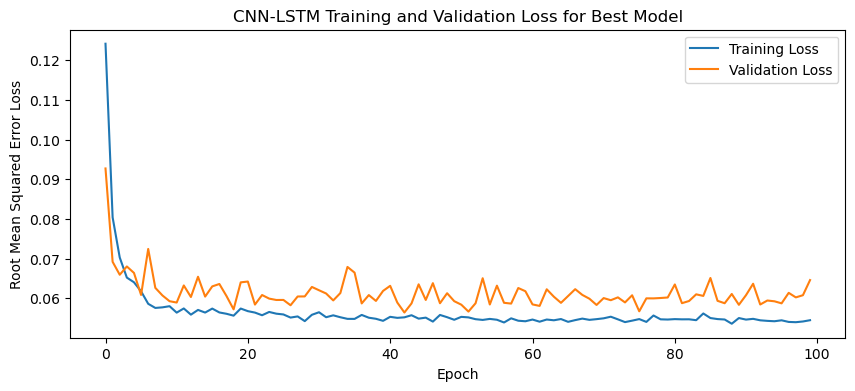

1/1 - 1s - loss: 0.0378 - 1s/epoch - 1s/step
Test Loss: 0.03779962658882141
1/1 [==============================] - 0s 32ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

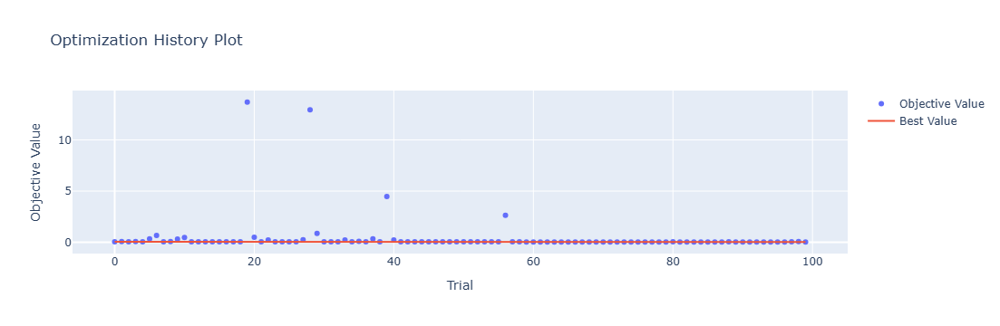

In [4]:
optuna.visualization.plot_optimization_history(study)

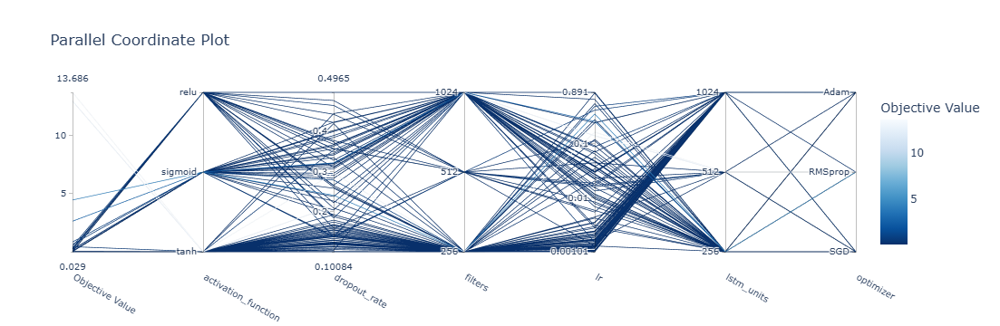

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

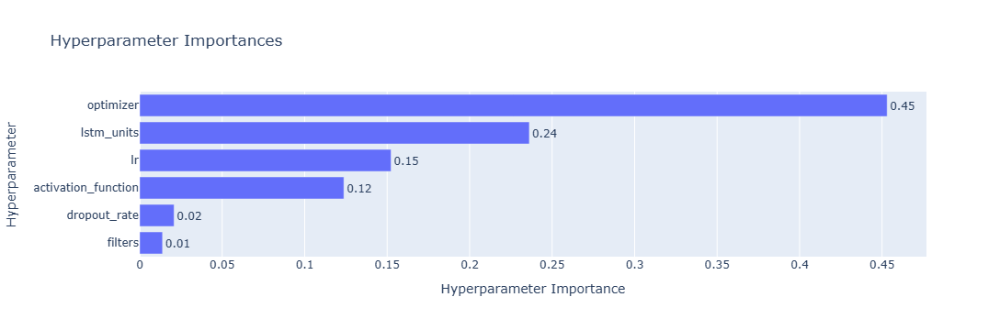

In [6]:
optuna.visualization.plot_param_importances(study)

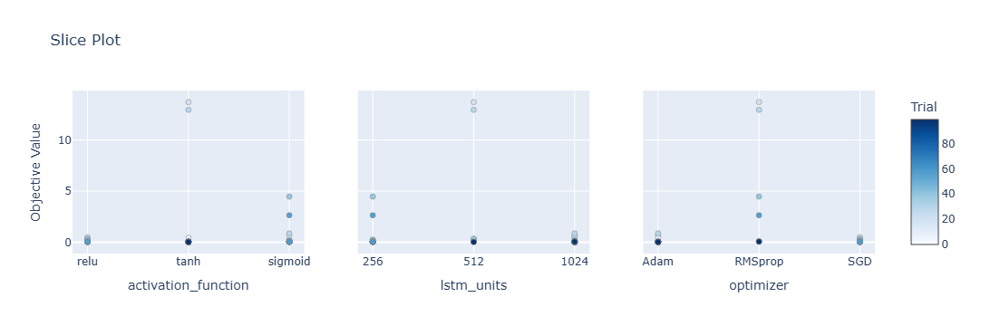

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

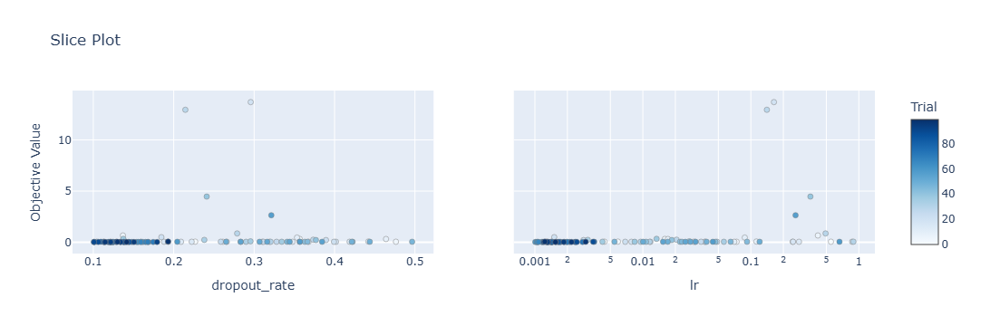

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 24s 67ms/step - loss: 0.1209 - accuracy: 0.2857 - mae: 0.0993 - rmse: 0.1209 - mape: inf - pearson: 0.6388 - val_loss: 0.0831 - val_accuracy: 0.0000e+00 - val_mae: 0.0658 - val_rmse: 0.0831 - val_mape: 15.6715 - val_pearson: 0.7192
Epoch 2/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0805 - accuracy: 0.5000 - mae: 0.0648 - rmse: 0.0805 - mape: inf - pearson: 0.7871 - val_loss: 0.0683 - val_accuracy: 0.1000 - val_mae: 0.0556 - val_rmse: 0.0683 - val_mape: 12.6157 - val_pearson: 0.8161
Epoch 3/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0694 - accuracy: 0.4643 - mae: 0.0557 - rmse: 0.0694 - mape: inf - pearson: 0.8155 - val_loss: 0.0701 - val_accuracy: 0.4000 - val_mae: 0.0553 - val_rmse: 0.0701 - val_mape: 12.2270 - val_pearson: 0.7962
Epoch 4/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0637 - accuracy: 0.4643 - mae: 0.0505 - rmse: 0.0637 - mape: inf - pearson: 0.8

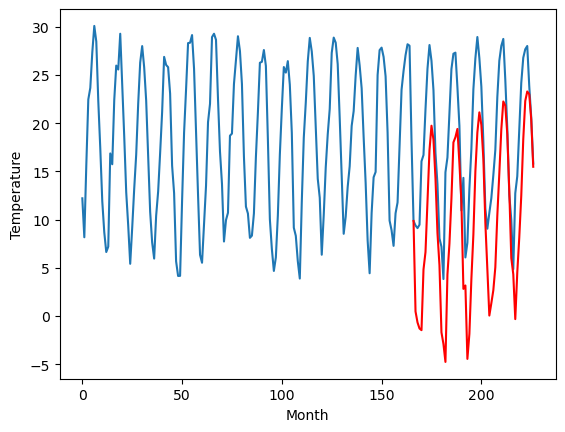

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.50		0.45
-1.85		-1.64		0.21
-2.23		-2.27		-0.04
-1.48		-2.44		-0.96
4.35		3.85		-0.50
4.84		5.65		0.81
7.61		10.92		3.31
11.36		16.21		4.85
11.84		18.75		6.91
12.47		17.30		4.83
9.49		13.32		3.83
6.86		7.64		0.78
3.44		4.29		0.85
-3.77		-2.67		1.10
-3.11		-3.87		-0.76
-3.20		-5.73		-2.53
1.86		3.33		1.47
3.26		6.52		3.26
7.28		11.20		3.92
10.76		17.03		6.27
11.98		17.56		5.58
12.32		18.42		6.10
10.19		14.86		4.67
7.56		10.85		3.29
2.05		1.84		-0.21
1.81		2.19		0.38
-4.87		-5.42		-0.55
-2.10		-2.83		-0.73
1.76		2.87		1.11
4.73		7.47		2.74
9.04		14.02		4.98
12.73		18.06		5.33
12.87		20.14		7.27
12.32		18.85		6.53
11.30		15.34		4.04
5.70		8.71		3.01
3.01		3.91		0.90
-0.84		-0.92		-0.08
-0.05		0.35		0.40
1.05		1.70		0.65
2.64		4.08		1.44
4.79		9.46		4.67
7.97		13.81		5.84
11.05		18.36		7.31
12.88		21.27		8.39
14.47		20.84		6.37
11.09		17.87		6.78
5.98		11.98		6.00
0.74		5.04		4.30
-1.96

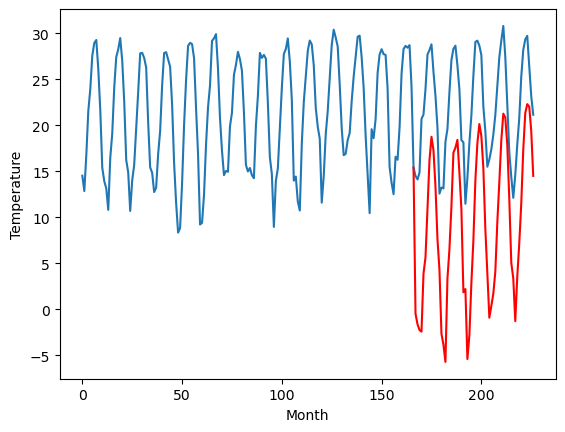

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.88		1.22
-3.21		-3.02		0.19
-3.83		-3.65		0.18
-3.21		-3.82		-0.61
3.04		2.47		-0.57
2.80		4.27		1.47
6.49		9.54		3.05
10.21		14.83		4.62
12.58		17.37		4.79
11.82		15.92		4.10
8.43		11.94		3.51
4.71		6.26		1.55
-0.22		2.91		3.13
-7.22		-4.05		3.17
-6.40		-5.25		1.15
-5.54		-7.11		-1.57
0.44		1.95		1.51
2.08		5.14		3.06
6.06		9.82		3.76
10.20		15.65		5.45
11.96		16.18		4.22
12.24		17.04		4.80
8.67		13.48		4.81
4.79		9.47		4.68
-3.57		0.46		4.03
-1.39		0.81		2.20
-7.40		-6.80		0.60
-3.45		-4.21		-0.76
0.05		1.49		1.44
2.79		6.09		3.30
8.55		12.64		4.09
12.33		16.68		4.35
13.25		18.76		5.51
12.02		17.46		5.44
8.90		13.96		5.06
1.76		7.33		5.57
-0.72		2.53		3.25
-5.24		-2.30		2.94
-3.29		-1.03		2.26
-0.51		0.32		0.83
-0.53		2.70		3.23
2.54		8.08		5.54
5.95		12.43		6.48
9.27		16.98		7.71
12.37		19.89		7.52
11.98		19.46		7.48
8.53		16.49		7.96
2.55		10.60		8.05
-2.54		3.66		6.20
-5.57		1.

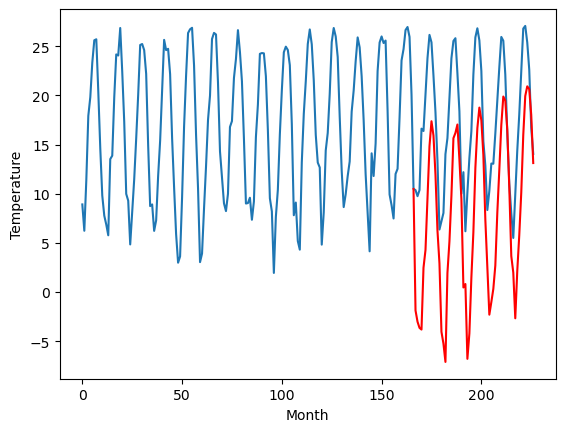

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-3.08		-0.59
-2.51		-4.22		-1.71
-2.47		-4.85		-2.38
-2.47		-5.02		-2.55
4.45		1.27		-3.18
4.53		3.07		-1.46
7.42		8.34		0.92
10.33		13.63		3.30
11.30		16.17		4.87
11.64		14.72		3.08
9.31		10.74		1.43
5.25		5.06		-0.19
2.41		1.71		-0.70
-5.05		-5.25		-0.20
-4.96		-6.45		-1.49
-6.53		-8.31		-1.78
1.38		0.75		-0.63
3.17		3.94		0.77
7.14		8.62		1.48
10.42		14.45		4.03
11.05		14.98		3.93
11.10		15.84		4.74
8.59		12.28		3.69
6.28		8.27		1.99
-1.81		-0.74		1.07
0.96		-0.39		-1.35
-6.39		-8.00		-1.61
-3.95		-5.41		-1.46
-0.16		0.29		0.45
4.63		4.89		0.26
9.15		11.44		2.29
11.58		15.48		3.90
11.56		17.56		6.00
10.37		16.26		5.89
9.13		12.76		3.63
3.51		6.13		2.62
-0.60		1.33		1.93
-2.78		-3.50		-0.72
-1.34		-2.23		-0.89
-0.93		-0.88		0.05
2.59		1.50		-1.09
4.01		6.88		2.87
8.44		11.23		2.79
12.19		15.78		3.59
13.31		18.69		5.38
14.84		18.26		3.42
11.40		15.29		3.89
5.15		9.40		4.25
-0.71		2.46

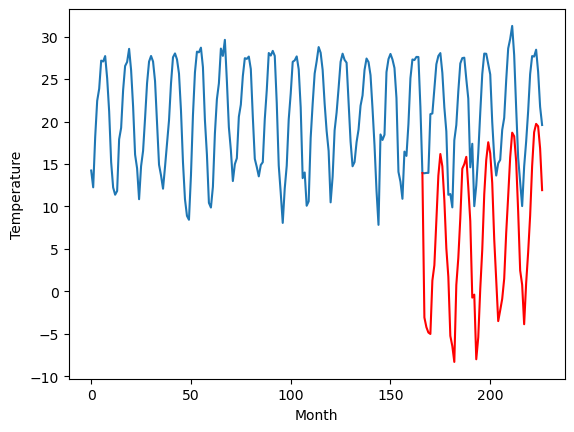

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		3.84		-1.48
3.27		2.70		-0.57
4.01		2.07		-1.94
3.34		1.90		-1.44
11.09		8.19		-2.90
11.34		10.00		-1.34
16.32		15.26		-1.06
20.52		20.55		0.03
22.13		23.09		0.96
22.62		21.64		-0.98
16.91		17.67		0.76
12.03		11.98		-0.05
9.51		8.63		-0.88
3.04		1.67		-1.37
2.16		0.47		-1.69
-0.93		-1.39		-0.46
8.97		7.67		-1.30
10.90		10.86		-0.04
14.76		15.54		0.78
19.96		21.37		1.41
20.39		21.90		1.51
21.15		22.76		1.61
19.14		19.20		0.06
14.79		15.19		0.40
7.22		6.18		-1.04
9.55		6.53		-3.02
1.10		-1.08		-2.18
0.87		1.51		0.64
7.36		7.21		-0.15
13.40		11.81		-1.59
18.11		18.36		0.25
22.45		22.40		-0.05
24.81		24.48		-0.33
22.45		23.18		0.73
19.50		19.68		0.18
13.58		13.05		-0.53
6.65		8.25		1.60
3.92		3.41		-0.51
4.89		4.69		-0.20
5.02		6.04		1.02
9.74		8.42		-1.32
11.24		13.80		2.56
16.77		18.15		1.38
21.32		22.70		1.38
24.31		25.61		1.30
26.05		25.18		-0.87
21.57		22.21		0.64
13.91		16.32		2.41
7.

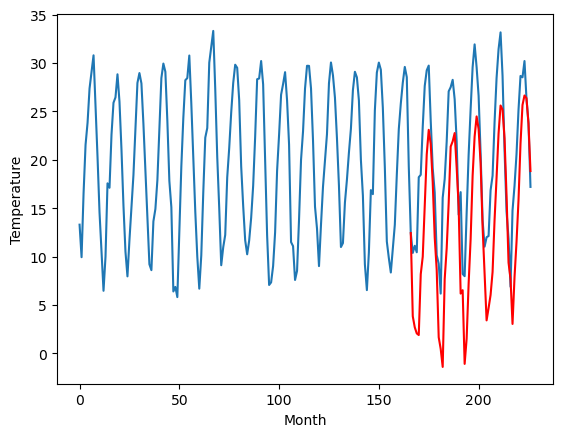

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.15		0.30
5.28		5.01		-0.27
4.75		4.38		-0.37
4.44		4.21		-0.23
8.03		10.50		2.47
10.00		12.30		2.30
13.69		17.57		3.88
18.04		22.86		4.82
21.78		25.40		3.62
20.93		23.95		3.02
17.90		19.97		2.07
13.81		14.29		0.48
9.69		10.94		1.25
2.94		3.98		1.04
1.16		2.78		1.62
1.81		0.92		-0.89
6.71		9.98		3.27
10.08		13.17		3.09
13.59		17.85		4.26
18.16		23.68		5.52
20.15		24.21		4.06
20.63		25.07		4.44
17.62		21.51		3.89
14.02		17.50		3.48
5.85		8.49		2.64
6.90		8.84		1.94
0.52		1.23		0.71
4.13		3.82		-0.31
8.05		9.52		1.47
10.92		14.12		3.20
15.55		20.67		5.12
19.12		24.71		5.59
21.26		26.79		5.53
20.41		25.49		5.08
17.76		21.99		4.23
11.20		15.36		4.16
9.51		10.56		1.05
2.99		5.73		2.74
4.68		7.00		2.32
6.17		8.35		2.18
7.08		10.73		3.65
11.76		16.11		4.35
13.28		20.46		7.18
17.10		25.01		7.91
20.93		27.92		6.99
20.45		27.49		7.04
16.93		24.52		7.59
12.58		18.63		6.05
7.14		11.69		4.55
5.00		

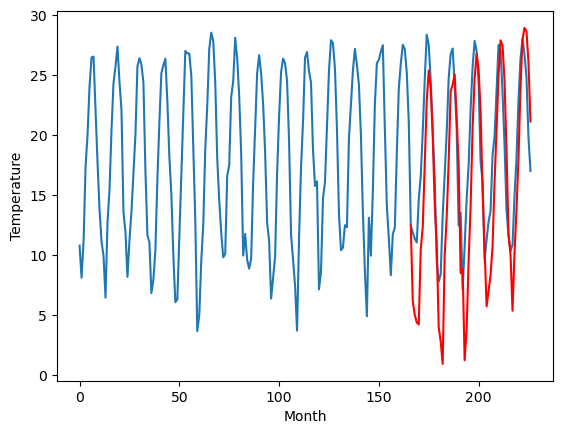

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		0.54		1.74
-1.56		-0.60		0.96
-2.03		-1.23		0.80
-0.92		-1.40		-0.48
4.50		4.89		0.39
5.74		6.69		0.95
8.08		11.96		3.88
13.33		17.25		3.92
16.40		19.79		3.39
15.37		18.34		2.97
11.48		14.36		2.88
7.48		8.68		1.20
3.30		5.33		2.03
-3.63		-1.63		2.00
-4.21		-2.83		1.38
-3.57		-4.69		-1.12
3.41		4.37		0.96
4.44		7.56		3.12
8.15		12.24		4.09
12.48		18.07		5.59
14.10		18.60		4.50
14.04		19.46		5.42
9.99		15.90		5.91
6.76		11.89		5.13
-1.89		2.88		4.77
0.05		3.23		3.18
-6.60		-4.38		2.22
-2.62		-1.79		0.83
1.72		3.91		2.19
4.64		8.51		3.87
9.71		15.06		5.35
13.62		19.10		5.48
14.72		21.18		6.46
13.43		19.88		6.45
10.37		16.38		6.01
3.43		9.75		6.32
1.20		4.95		3.75
-5.31		0.12		5.43
-2.12		1.39		3.51
0.88		2.74		1.86
1.36		5.12		3.76
4.92		10.50		5.58
7.61		14.85		7.24
10.96		19.40		8.44
14.67		22.31		7.64
13.98		21.88		7.90
10.47		18.91		8.44
5.26		13.02		7.76
-0.61		6.08		6.69
-2.90		4.39

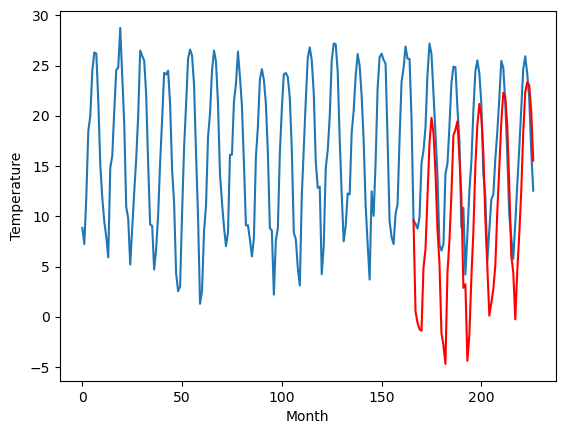

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.86		1.85
3.64		4.72		1.08
3.52		4.09		0.57
4.56		3.92		-0.64
10.14		10.21		0.07
11.04		12.01		0.97
14.16		17.28		3.12
19.68		22.57		2.89
22.94		25.11		2.17
21.57		23.66		2.09
16.70		19.68		2.98
12.86		14.00		1.14
8.63		10.65		2.02
1.70		3.69		1.99
0.76		2.49		1.73
1.38		0.63		-0.75
7.90		9.69		1.79
11.53		12.88		1.35
14.55		17.56		3.01
19.34		23.39		4.05
21.46		23.92		2.46
21.41		24.78		3.37
16.90		21.22		4.32
13.05		17.21		4.16
3.55		8.20		4.65
5.61		8.55		2.94
-1.57		0.94		2.51
2.67		3.53		0.86
7.51		9.23		1.72
10.83		13.83		3.00
15.81		20.38		4.57
19.81		24.42		4.61
21.68		26.50		4.82
20.00		25.20		5.20
16.30		21.70		5.40
9.11		15.07		5.96
6.91		10.27		3.36
-0.26		5.44		5.70
2.91		6.71		3.80
5.88		8.06		2.18
6.56		10.44		3.88
11.18		15.82		4.64
13.47		20.17		6.70
17.22		24.72		7.50
21.36		27.63		6.27
20.22		27.20		6.98
16.46		24.23		7.77
11.07		18.34		7.27
4.62		11.40		6.78
3.03		9

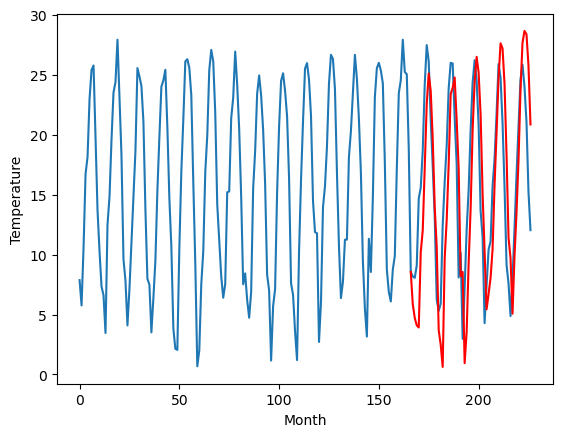

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		4.93		0.45
4.32		3.79		-0.53
3.13		3.16		0.03
3.63		2.99		-0.64
10.20		9.28		-0.92
12.48		11.09		-1.39
17.36		16.35		-1.01
23.29		21.64		-1.65
26.03		24.19		-1.84
23.02		22.73		-0.29
19.46		18.76		-0.70
12.20		13.07		0.87
9.34		9.72		0.38
2.63		2.76		0.13
1.84		1.56		-0.28
-2.43		-0.30		2.13
10.04		8.76		-1.28
12.64		11.95		-0.69
17.33		16.63		-0.70
23.52		22.46		-1.06
24.09		22.99		-1.10
24.03		23.85		-0.18
20.29		20.29		0.00
16.33		16.28		-0.05
6.29		7.27		0.98
8.09		7.62		-0.47
-0.42		0.01		0.43
1.62		2.60		0.98
8.84		8.30		-0.54
12.79		12.90		0.11
19.63		19.45		-0.18
24.15		23.49		-0.66
26.48		25.57		-0.91
23.60		24.27		0.67
19.96		20.77		0.81
13.40		14.14		0.74
7.43		9.34		1.91
2.14		4.50		2.36
4.70		5.78		1.08
6.31		7.13		0.82
8.13		9.51		1.38
13.91		14.89		0.98
19.50		19.24		-0.26
23.37		23.79		0.42
24.86		26.70		1.84
23.60		26.27		2.67
20.43		23.30		2.87
14.83		17.41		2.58
7.84	

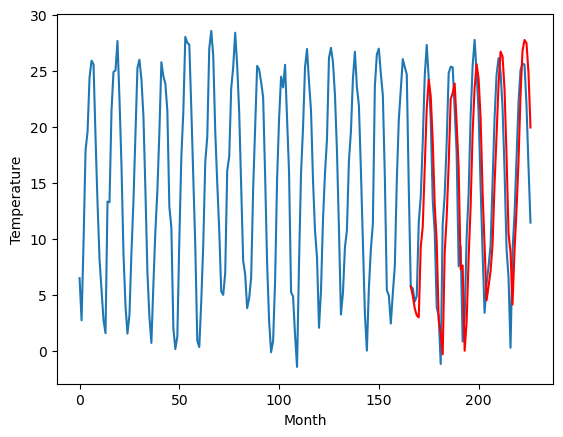

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		2.42		2.68
-0.08		1.28		1.36
-1.36		0.65		2.01
-2.23		0.48		2.71
4.96		6.77		1.81
6.62		8.58		1.96
11.71		13.84		2.13
18.69		19.13		0.44
21.32		21.68		0.36
18.94		20.22		1.28
15.27		16.25		0.98
8.88		10.56		1.68
5.20		7.21		2.01
-2.31		0.25		2.56
-3.90		-0.95		2.95
-6.07		-2.81		3.26
4.68		6.25		1.57
7.74		9.44		1.70
12.21		14.12		1.91
18.69		19.95		1.26
19.70		20.48		0.78
20.30		21.34		1.04
16.44		17.78		1.34
11.97		13.77		1.80
1.31		4.76		3.45
2.54		5.11		2.57
-6.43		-2.50		3.93
-2.85		0.09		2.94
4.13		5.79		1.66
6.86		10.39		3.53
15.03		16.94		1.91
18.93		20.98		2.05
20.96		23.06		2.10
19.05		21.76		2.71
15.32		18.26		2.94
8.28		11.63		3.35
3.26		6.83		3.57
-2.45		1.99		4.44
-0.56		3.27		3.83
1.48		4.62		3.14
1.82		7.00		5.18
8.10		12.38		4.28
13.06		16.73		3.67
16.90		21.28		4.38
19.73		24.19		4.46
18.93		23.76		4.83
16.32		20.79		4.47
9.74		14.90		5.16
3.24		7.96		4.72
0.81		6.27

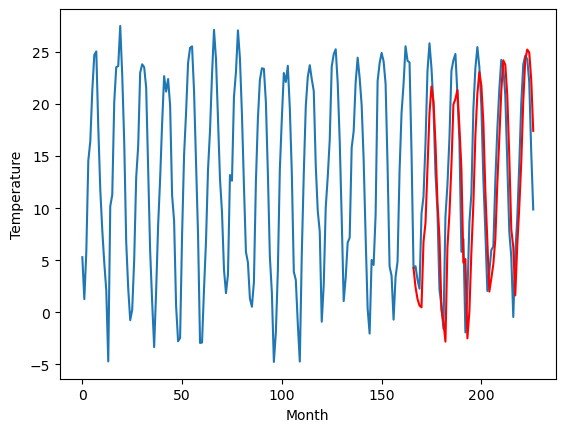

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		0.48		1.98
-2.17		-0.66		1.51
-3.20		-1.29		1.91
-4.66		-1.46		3.20
1.48		4.83		3.35
4.13		6.64		2.51
10.56		11.90		1.34
18.52		17.19		-1.33
21.68		19.74		-1.94
18.99		18.28		-0.71
14.16		14.31		0.15
7.41		8.62		1.21
3.93		5.27		1.34
-3.10		-1.69		1.41
-4.71		-2.89		1.82
-9.02		-4.75		4.27
2.71		4.31		1.60
6.68		7.50		0.82
11.83		12.18		0.35
19.14		18.01		-1.13
19.73		18.54		-1.19
20.44		19.40		-1.04
16.39		15.84		-0.55
12.04		11.83		-0.21
1.18		2.82		1.64
0.28		3.17		2.89
-8.67		-4.44		4.23
-5.43		-1.85		3.58
1.48		3.85		2.37
5.09		8.45		3.36
14.41		15.00		0.59
19.17		19.04		-0.13
20.28		21.12		0.84
19.16		19.82		0.66
15.32		16.32		1.00
8.08		9.69		1.61
3.05		4.89		1.84
-3.13		0.05		3.18
-2.00		1.33		3.33
-1.59		2.68		4.27
0.27		5.06		4.79
7.12		10.44		3.32
12.14		14.79		2.65
17.65		19.34		1.69
20.11		22.25		2.14
18.30		21.82		3.52
15.92		18.85		2.93
9.96		12.96		3.00
2.32		6.02		3.7

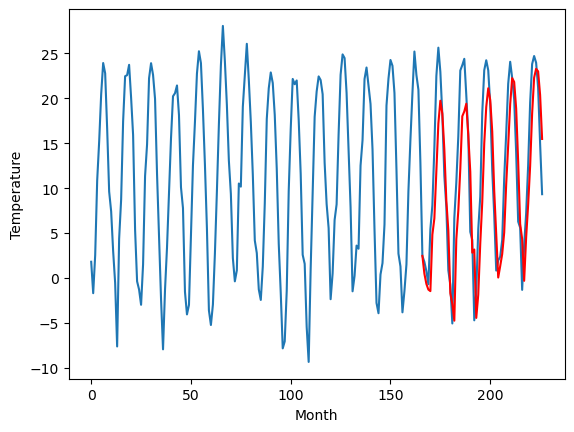

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[0.4799066543579098, -0.4999522018432616, -1.8800227737426756, -3.0800199127197265, 3.8399009323120126, 6.149980087280273, 0.5399610137939455, 5.859938125610352, 4.929880905151368, 2.4198789978027335, 0.47986850738525355]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   0.479907
1                 1   -0.95  -0.499952
2                 2   -3.10  -1.880023
3                 3   -2.49  -3.080020
4                 4    5.32   3.839901
5                 5    5.85   6.149980
6                 6   -1.20   0.539961
7                 7    4.01   5.859938
8                 8    4.48   4.929881
9                 9   -0.26   2.419879
10               10   -1.50   0.479869


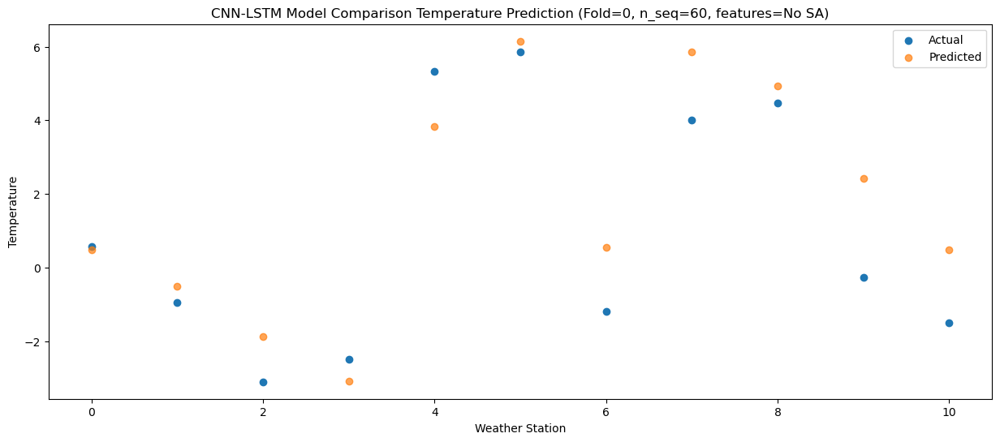

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -0.660670
1                 1   -1.85  -1.640527
2                 2   -3.21  -3.020602
3                 3   -2.51  -4.220599
4                 4    3.27   2.699324
5                 5    5.28   5.009405
6                 6   -1.56  -0.600618
7                 7    3.64   4.719359
8                 8    4.32   3.789306
9                 9   -0.08   1.279306
10               10   -2.17  -0.660702


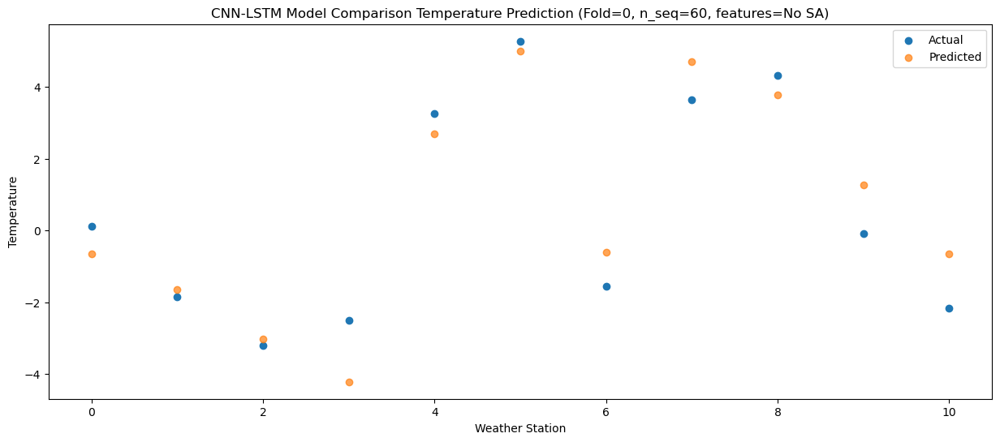

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -1.288924
1                 1   -2.23  -2.269564
2                 2   -3.83  -3.649256
3                 3   -2.47  -4.849265
4                 4    4.01   2.071109
5                 5    4.75   4.380751
6                 6   -2.03  -1.229168
7                 7    3.52   4.090938
8                 8    3.13   3.161244
9                 9   -1.36   0.651242
10               10   -3.20  -1.288711


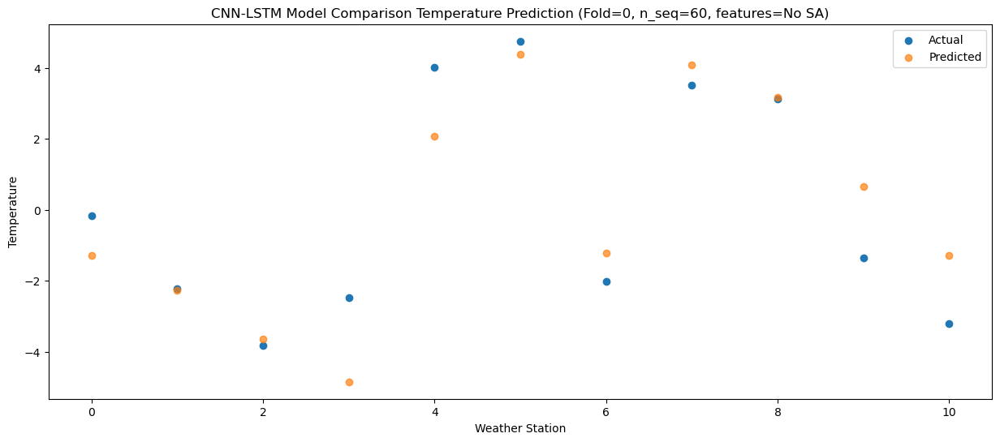

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -1.459322
1                 1   -1.48  -2.440274
2                 2   -3.21  -3.819812
3                 3   -2.47  -5.019824
4                 4    3.34   1.900728
5                 5    4.44   4.210190
6                 6   -0.92  -1.399685
7                 7    4.56   3.920474
8                 8    3.63   2.990921
9                 9   -2.23   0.480916
10               10   -4.66  -1.459014


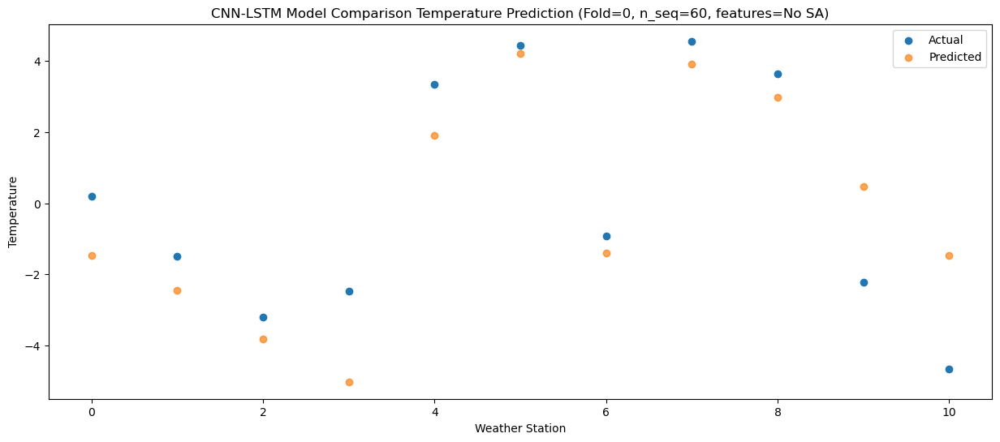

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   4.829708
1                 1    4.35   3.848340
2                 2    3.04   2.469006
3                 3    4.45   1.268989
4                 4   11.09   8.189778
5                 5    8.03  10.499010
6                 6    4.50   4.889184
7                 7   10.14  10.209414
8                 8   10.20   9.280045
9                 9    4.96   6.770037
10               10    1.48   4.830136


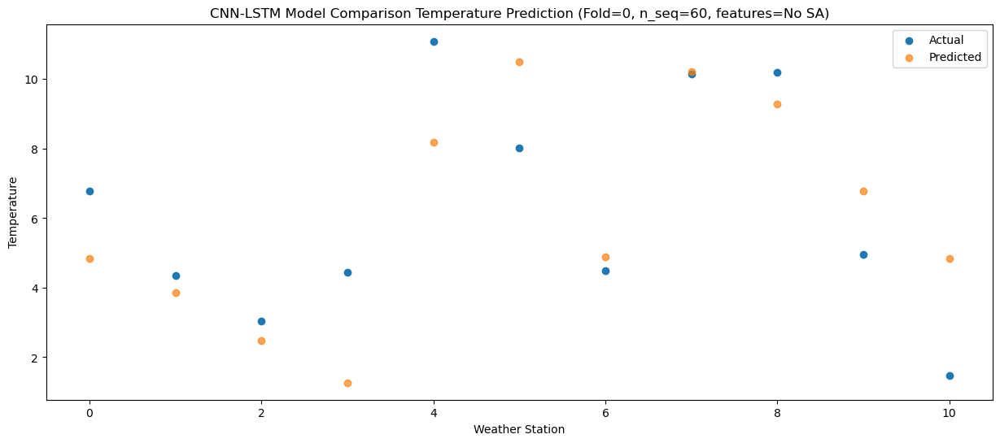

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   6.635146
1                 1    4.84   5.653072
2                 2    2.80   4.274085
3                 3    4.53   3.074060
4                 4   11.34   9.995249
5                 5   10.00  12.304089
6                 6    5.74   6.694351
7                 7   11.04  12.014700
8                 8   12.48  11.085646
9                 9    6.62   8.575633
10               10    4.13   6.635783


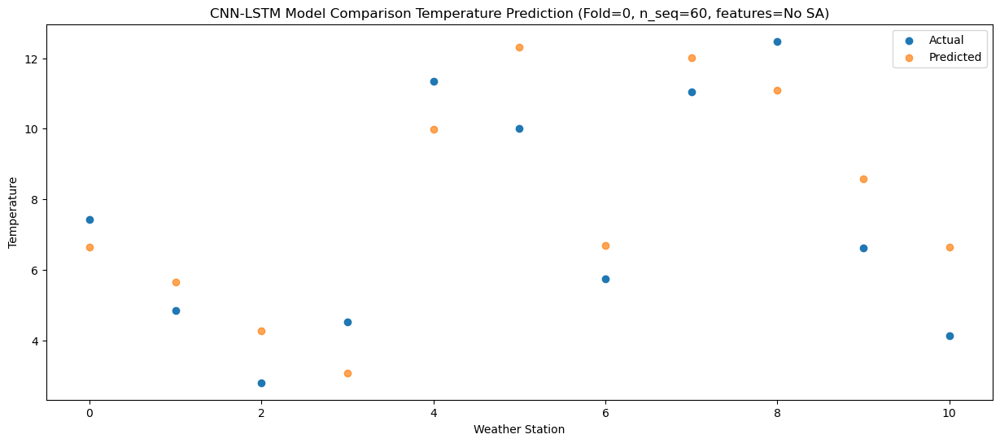

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  11.897796
1                 1    7.61  10.915412
2                 2    6.49   9.536575
3                 3    7.42   8.336545
4                 4   16.32  15.257919
5                 5   13.69  17.566582
6                 6    8.08  11.956884
7                 7   14.16  17.277280
8                 8   17.36  16.348379
9                 9   11.71  13.838366
10               10   10.56  11.898548


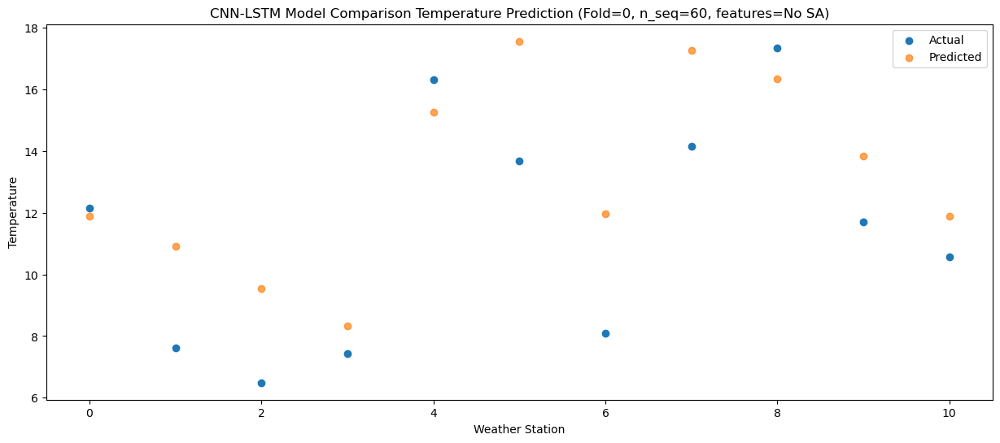

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  17.192581
1                 1   11.36  16.209889
2                 2   10.21  14.831199
3                 3   10.33  13.631164
4                 4   20.52  20.552719
5                 5   18.04  22.861207
6                 6   13.33  17.251550
7                 7   19.68  22.571999
8                 8   23.29  21.643239
9                 9   18.69  19.133222
10               10   18.52  17.193427


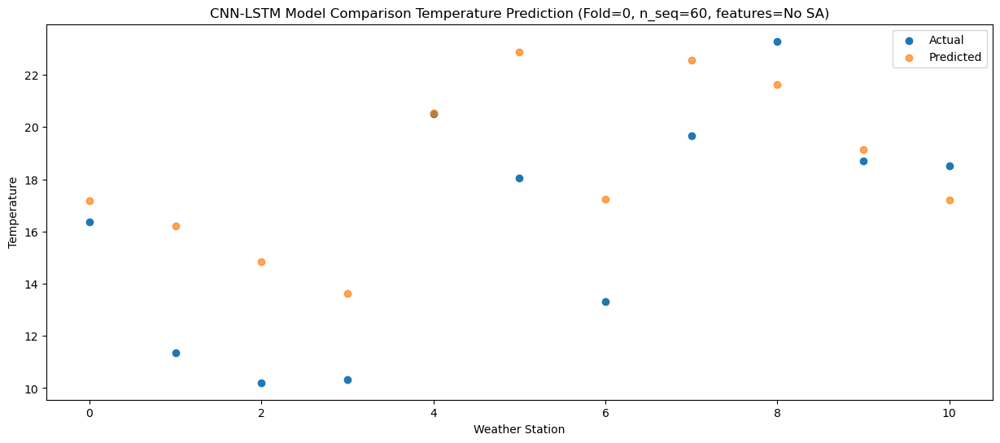

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  19.734341
1                 1   11.84  18.751350
2                 2   12.58  17.372806
3                 3   11.30  16.172768
4                 4   22.13  23.094491
5                 5   21.78  25.402819
6                 6   16.40  19.793195
7                 7   22.94  25.113694
8                 8   26.03  24.185071
9                 9   21.32  21.675053
10               10   21.68  19.735281


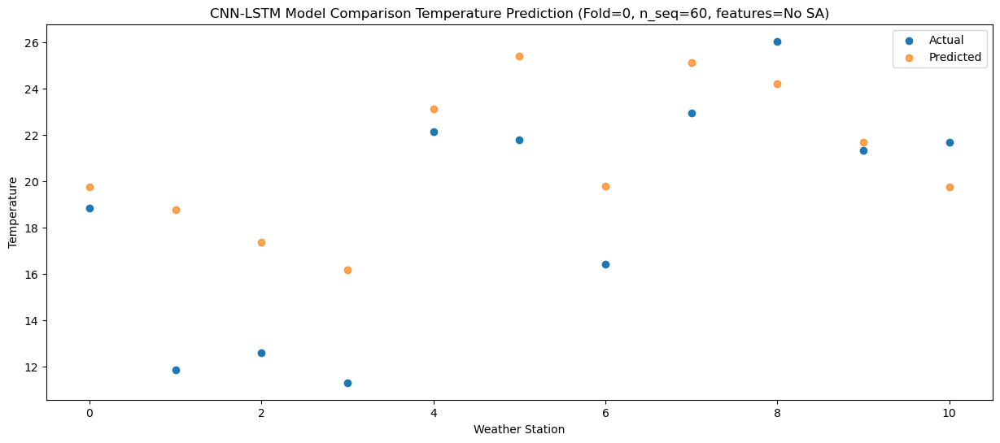

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  18.280113
1                 1   12.47  17.297350
2                 2   11.82  15.918699
3                 3   11.64  14.718664
4                 4   22.62  21.640249
5                 5   20.93  23.948711
6                 6   15.37  18.339059
7                 7   21.57  23.659520
8                 8   23.02  22.730788
9                 9   18.94  20.220768
10               10   18.99  18.280978


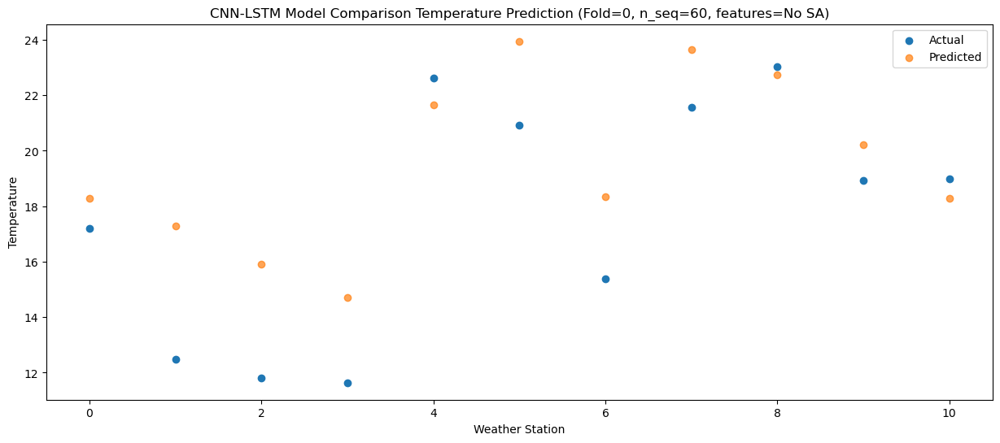

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  14.305540
1                 1    9.49  13.322905
2                 2    8.43  11.944187
3                 3    9.31  10.744157
4                 4   16.91  17.665670
5                 5   17.90  19.974203
6                 6   11.48  14.364537
7                 7   16.70  19.684975
8                 8   19.46  18.756188
9                 9   15.27  16.246168
10               10   14.16  14.306371


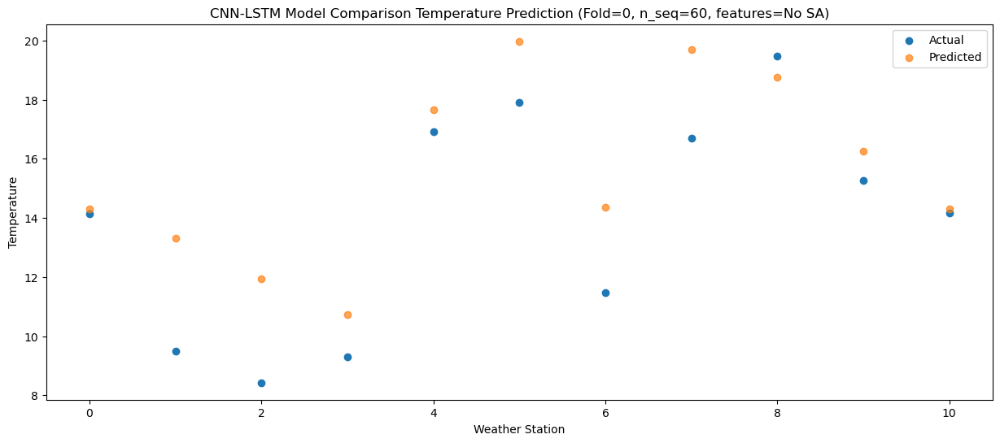

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   8.619784
1                 1    6.86   7.638377
2                 2    4.71   6.259063
3                 3    5.25   5.059051
4                 4   12.03  11.979851
5                 5   13.81  14.289076
6                 6    7.48   8.679257
7                 7   12.86  13.999490
8                 8   12.20  13.070137
9                 9    8.88  10.560121
10               10    7.41   8.620228


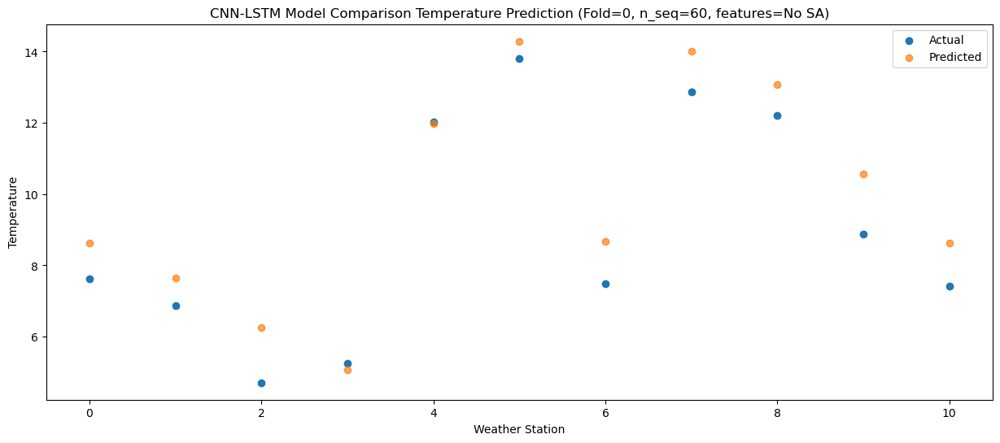

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.269218
1                 1    3.44   4.287954
2                 2   -0.22   2.908569
3                 3    2.41   1.708562
4                 4    9.51   8.629277
5                 5    9.69  10.938583
6                 6    3.30   5.328748
7                 7    8.63  10.648955
8                 8    9.34   9.719536
9                 9    5.20   7.209521
10               10    3.93   5.269612


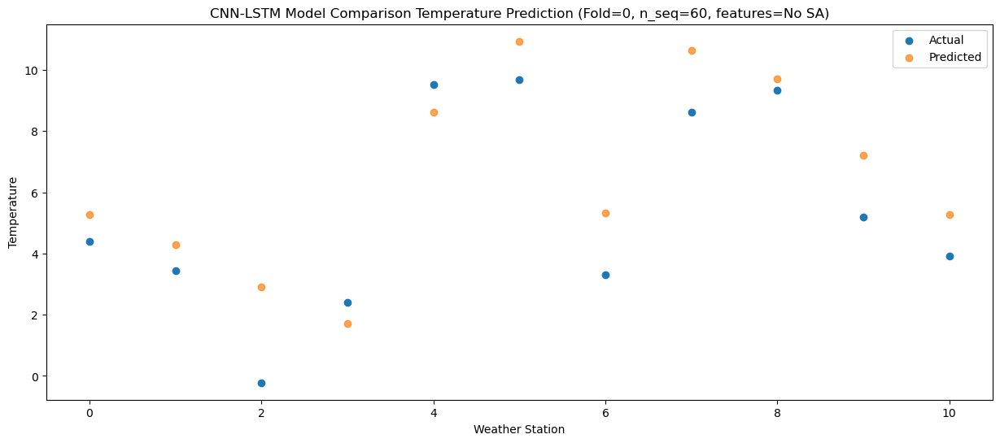

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -1.687930
1                 1   -3.77  -2.669177
2                 2   -7.22  -4.048574
3                 3   -5.05  -5.248579
4                 4    3.04   1.672128
5                 5    2.94   3.981440
6                 6   -3.63  -1.628396
7                 7    1.70   3.691809
8                 8    2.63   2.762389
9                 9   -2.31   0.252373
10               10   -3.10  -1.687534


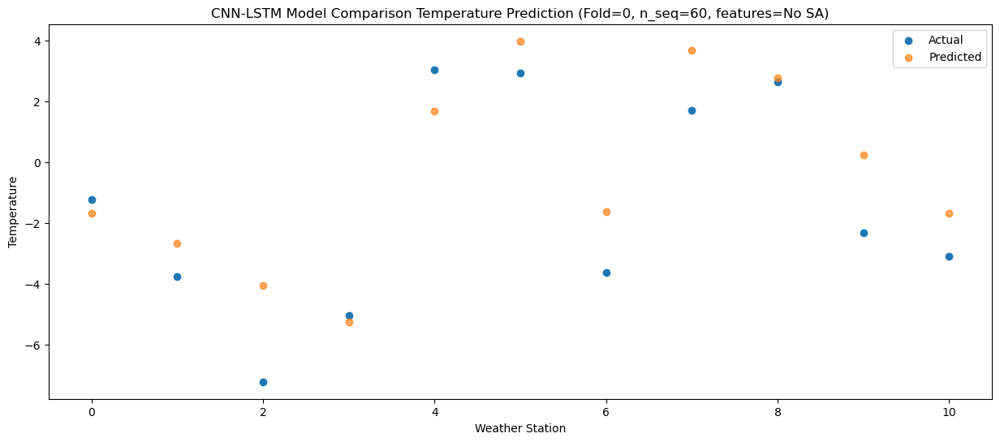

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -2.893461
1                 1   -3.11  -3.874181
2                 2   -6.40  -5.253840
3                 3   -4.96  -6.453836
4                 4    2.16   0.466571
5                 5    1.16   2.776178
6                 6   -4.21  -2.833724
7                 7    0.76   2.486391
8                 8    1.84   1.556739
9                 9   -3.90  -0.953273
10               10   -4.71  -2.893216


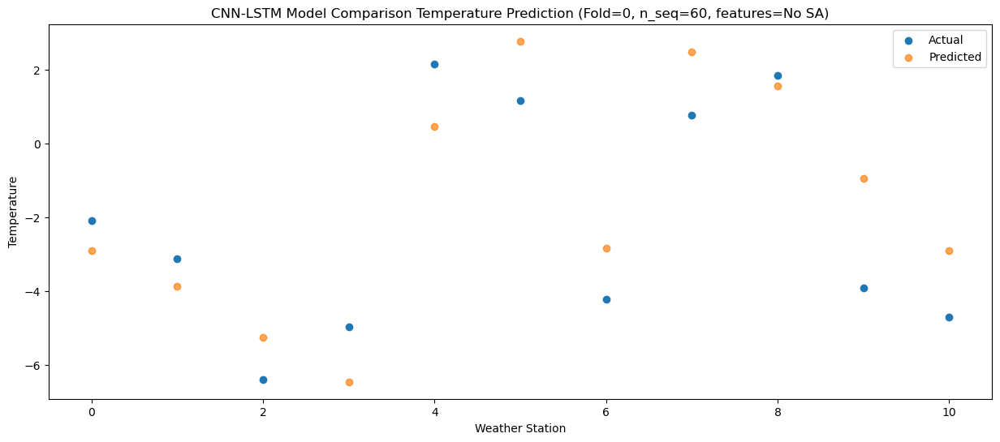

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -4.752420
1                 1   -3.20  -5.732998
2                 2   -5.54  -7.112728
3                 3   -6.53  -8.312721
4                 4   -0.93  -1.392395
5                 5    1.81   0.917293
6                 6   -3.57  -4.692629
7                 7    1.38   0.627465
8                 8   -2.43  -0.302256
9                 9   -6.07  -2.812263
10               10   -9.02  -4.752219


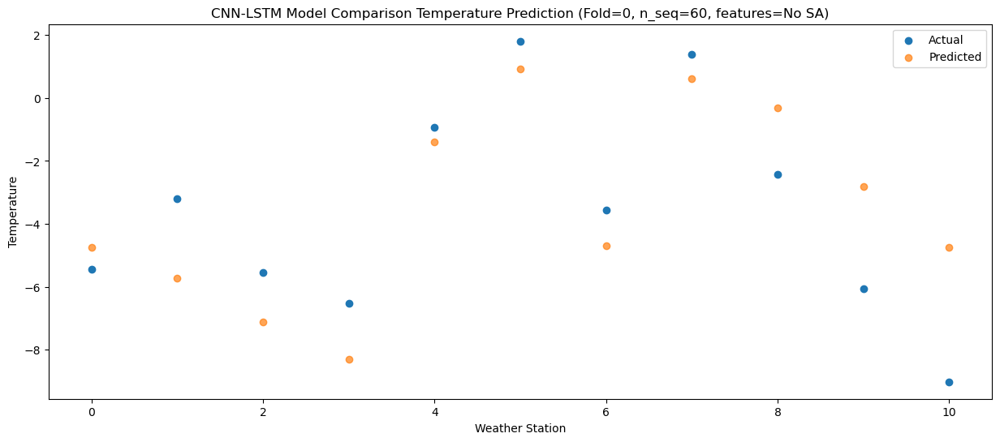

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   4.309525
1                 1    1.86   3.329185
2                 2    0.44   1.949345
3                 3    1.38   0.749352
4                 4    8.97   7.669545
5                 5    6.71   9.979364
6                 6    3.41   4.369413
7                 7    7.90   9.689464
8                 8   10.04   8.759634
9                 9    4.68   6.249626
10               10    2.71   4.309650


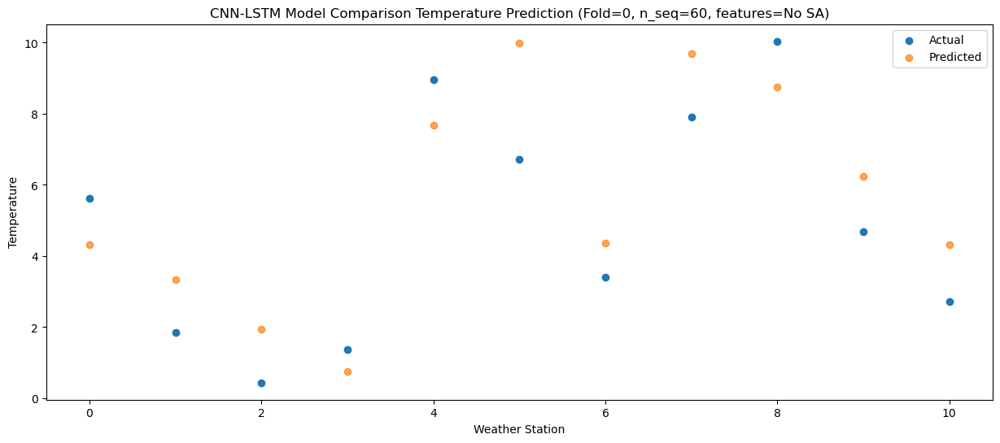

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.498209
1                 1    3.26   6.517574
2                 2    2.08   5.137882
3                 3    3.17   3.937877
4                 4   10.90  10.858248
5                 5   10.08  13.167898
6                 6    4.44   7.557987
7                 7   11.53  12.878085
8                 8   12.64  11.948400
9                 9    7.74   9.438385
10               10    6.68   7.498438


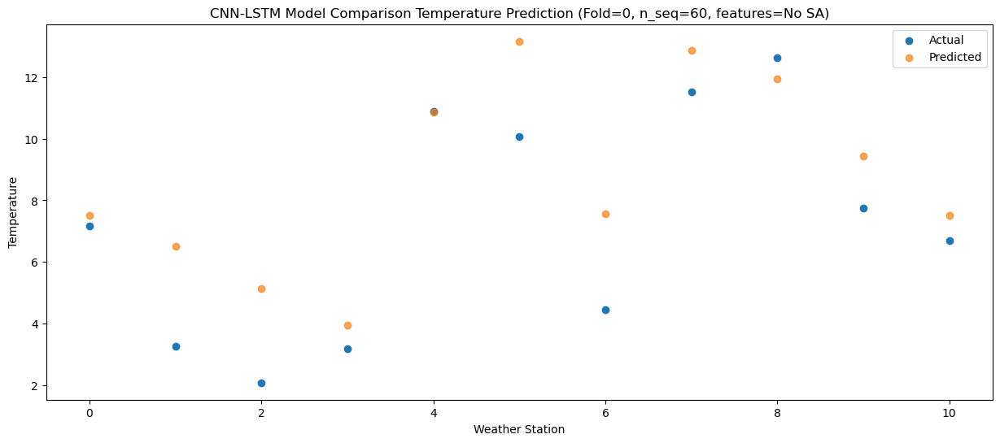

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  12.177946
1                 1    7.28  11.197586
2                 2    6.06   9.817763
3                 3    7.14   8.617759
4                 4   14.76  15.537969
5                 5   13.59  17.847776
6                 6    8.15  12.237829
7                 7   14.55  17.557884
8                 8   17.33  16.628066
9                 9   12.21  14.118050
10               10   11.83  12.178076


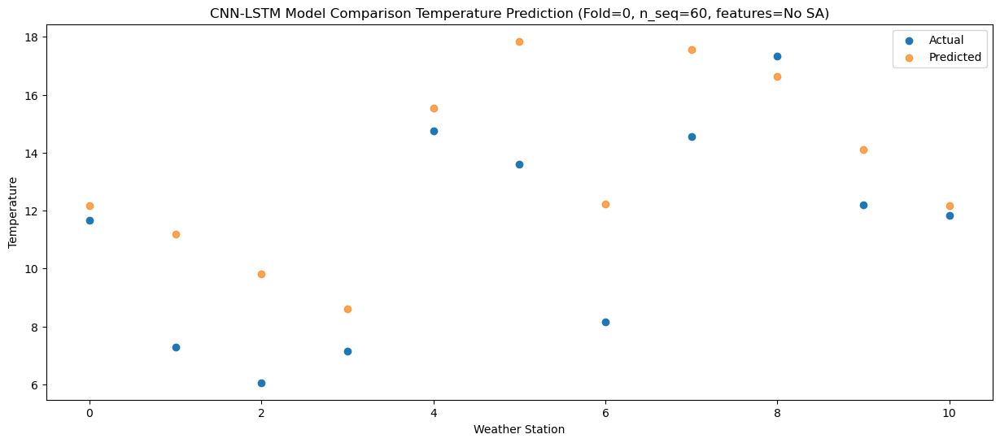

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  18.007049
1                 1   10.76  17.026342
2                 2   10.20  15.646679
3                 3   10.42  14.446672
4                 4   19.96  21.367087
5                 5   18.16  23.676694
6                 6   12.48  18.066798
7                 7   19.34  23.386904
8                 8   23.52  22.457258
9                 9   18.69  19.947240
10               10   19.14  18.007298


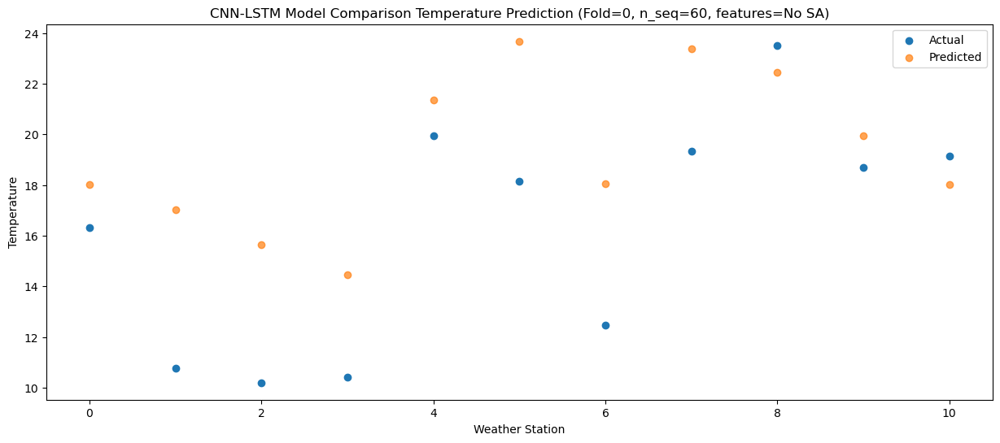

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  18.543758
1                 1   11.98  17.563177
2                 2   11.96  16.183450
3                 3   11.05  14.983448
4                 4   20.39  21.903792
5                 5   20.15  24.213463
6                 6   14.10  18.603555
7                 7   21.46  23.923640
8                 8   24.09  22.993939
9                 9   19.70  20.483926
10               10   19.73  18.543973


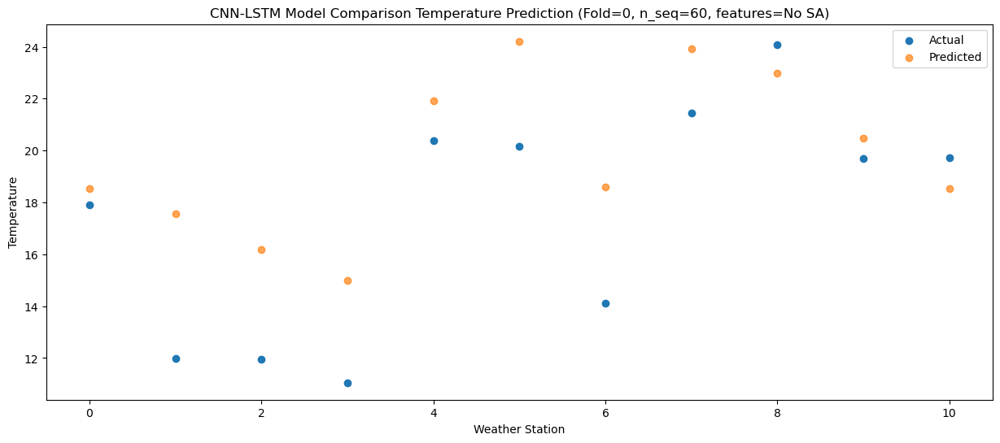

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  19.398419
1                 1   12.32  18.418352
2                 2   12.24  17.038376
3                 3   11.10  15.838383
4                 4   21.15  22.758433
5                 5   20.63  25.068387
6                 6   14.04  19.458419
7                 7   21.41  24.778415
8                 8   24.03  23.848482
9                 9   20.30  21.338465
10               10   20.44  19.398477


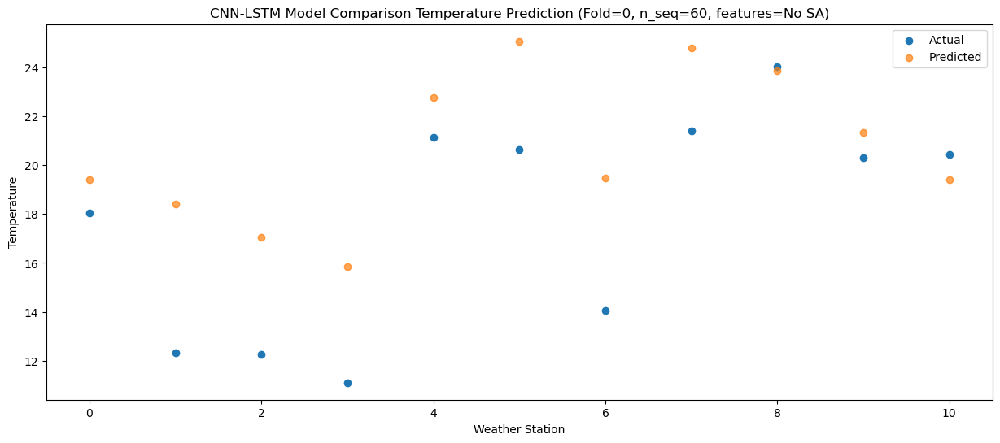

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  15.842184
1                 1   10.19  14.862430
2                 2    8.67  13.482296
3                 3    8.59  12.282308
4                 4   19.14  19.202185
5                 5   17.62  21.512311
6                 6    9.99  15.902299
7                 7   16.90  21.222247
8                 8   20.29  20.292179
9                 9   16.44  17.782166
10               10   16.39  15.842152


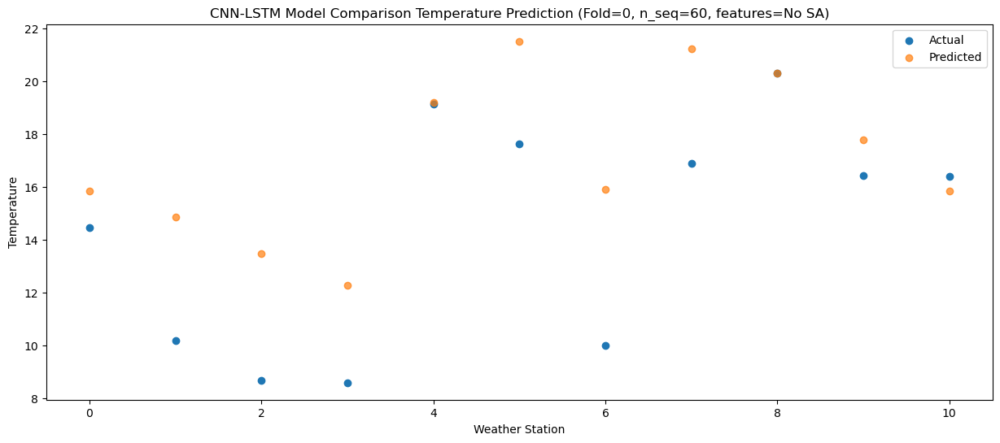

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  11.831780
1                 1    7.56  10.852123
2                 2    4.79   9.471945
3                 3    6.28   8.271957
4                 4   14.79  15.191775
5                 5   14.02  17.501956
6                 6    6.76  11.891935
7                 7   13.05  17.211869
8                 8   16.33  16.281750
9                 9   11.97  13.771740
10               10   12.04  11.831717


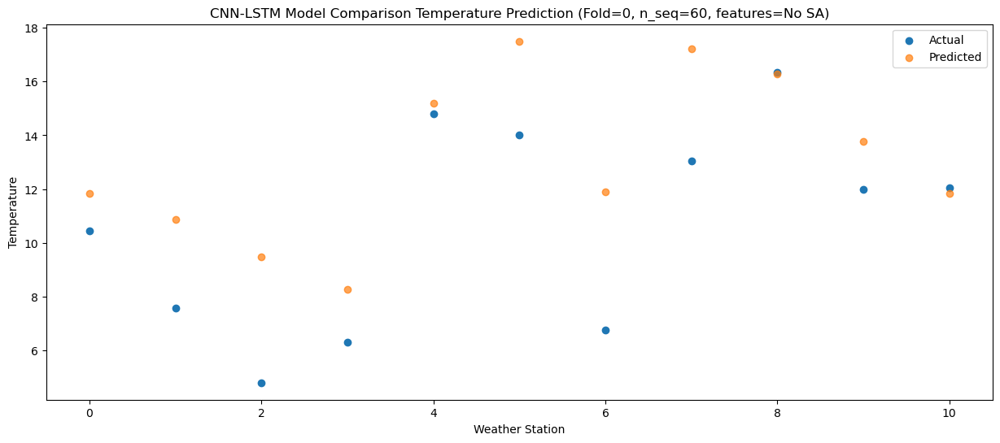

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   2.819491
1                 1    2.05   1.839777
2                 2   -3.57   0.459631
3                 3   -1.81  -0.740359
4                 4    7.22   6.179488
5                 5    5.85   8.489639
6                 6   -1.89   2.879626
7                 7    3.55   8.199569
8                 8    6.29   7.269467
9                 9    1.31   4.759458
10               10    1.18   2.819437


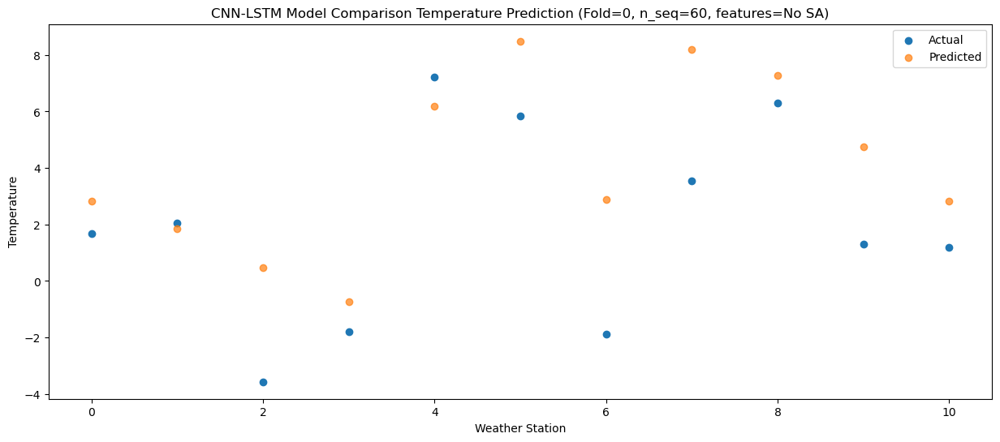

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   3.172936
1                 1    1.81   2.192747
2                 2   -1.39   0.812837
3                 3    0.96  -0.387159
4                 4    9.55   6.532958
5                 5    6.90   8.842846
6                 6    0.05   3.232888
7                 7    5.61   8.552910
8                 8    8.09   7.623030
9                 9    2.54   5.113016
10               10    0.28   3.173030


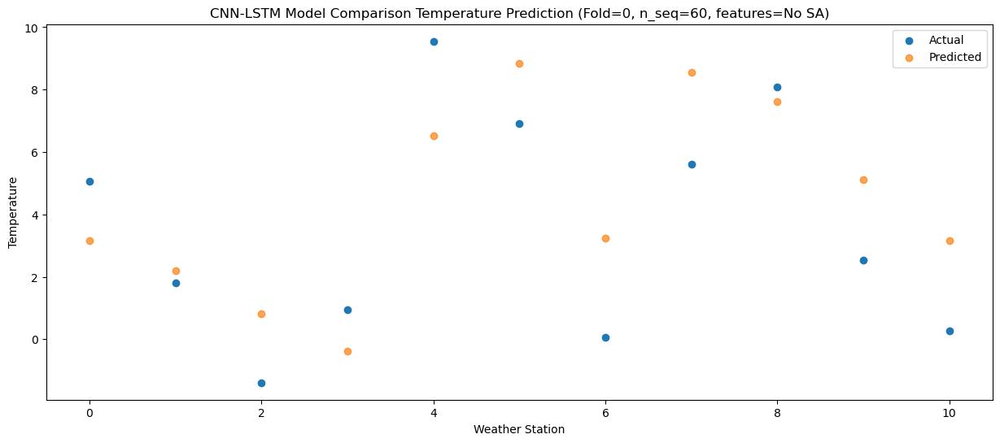

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -4.439935
1                 1   -4.87  -5.420439
2                 2   -7.40  -6.800191
3                 3   -6.39  -8.000192
4                 4    1.10  -1.079896
5                 5    0.52   1.229816
6                 6   -6.60  -4.380101
7                 7   -1.57   0.939974
8                 8   -0.42   0.010228
9                 9   -6.43  -2.499785
10               10   -8.67  -4.439751


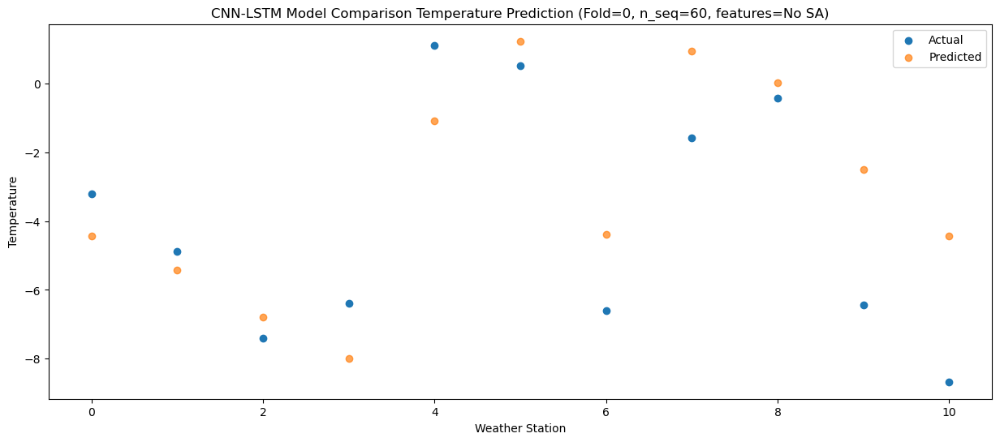

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -1.848354
1                 1   -2.10  -2.829131
2                 2   -3.45  -4.208753
3                 3   -3.95  -5.408760
4                 4    0.87   1.511698
5                 5    4.13   3.821256
6                 6   -2.62  -1.788625
7                 7    2.67   3.531492
8                 8    1.62   2.601876
9                 9   -2.85   0.091861
10               10   -5.43  -1.848077


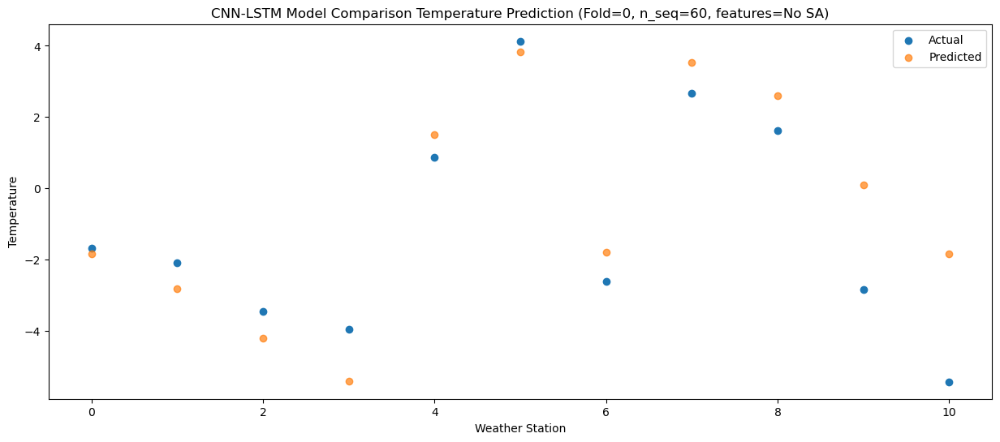

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   3.846162
1                 1    1.76   2.865567
2                 2    0.05   1.485853
3                 3   -0.16   0.285850
4                 4    7.36   7.206201
5                 5    8.05   9.515864
6                 6    1.72   3.905957
7                 7    7.51   9.226043
8                 8    8.84   8.296341
9                 9    4.13   5.786325
10               10    1.48   3.846375


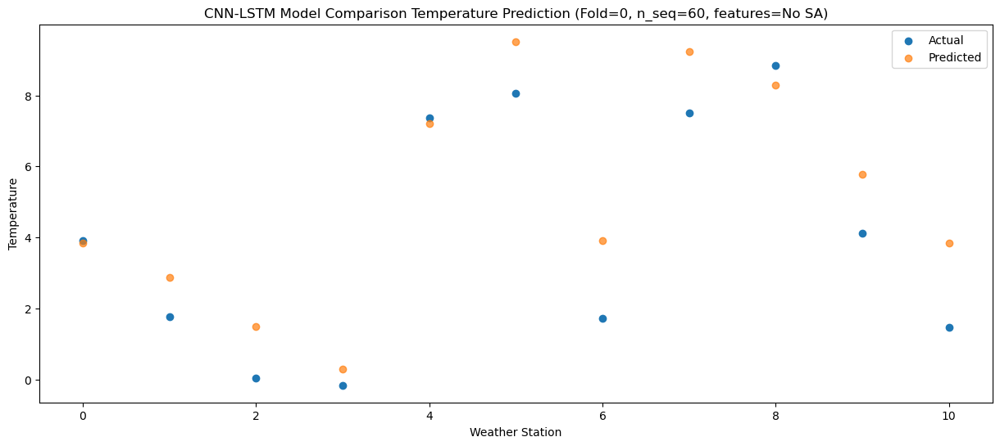

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   8.447978
1                 1    4.73   7.467919
2                 2    2.79   6.087934
3                 3    4.63   4.887947
4                 4   13.40  11.807992
5                 5   10.92  14.117953
6                 6    4.64   8.507979
7                 7   10.83  13.827971
8                 8   12.79  12.898027
9                 9    6.86  10.388018
10               10    5.09   8.448021


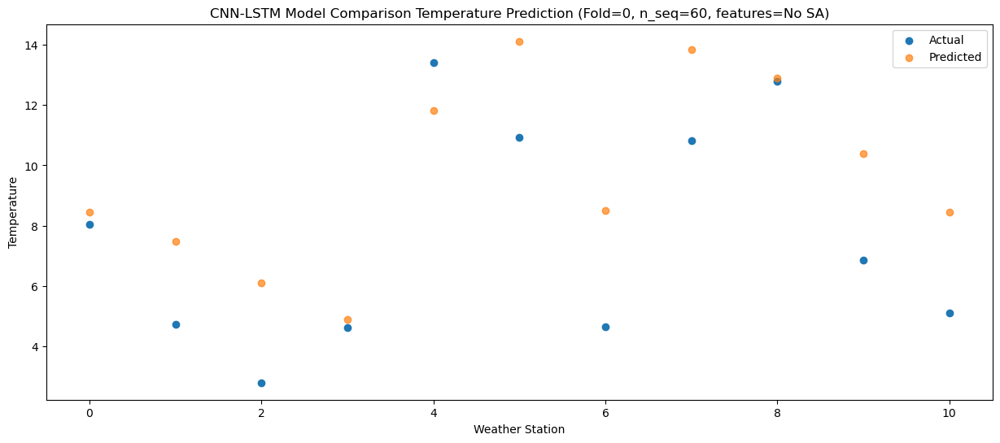

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  14.997084
1                 1    9.04  14.017478
2                 2    8.55  12.637278
3                 3    9.15  11.437300
4                 4   18.11  18.357076
5                 5   15.55  20.667292
6                 6    9.71  15.057264
7                 7   15.81  20.377183
8                 8   19.63  19.447026
9                 9   15.03  16.937016
10               10   14.41  14.996976


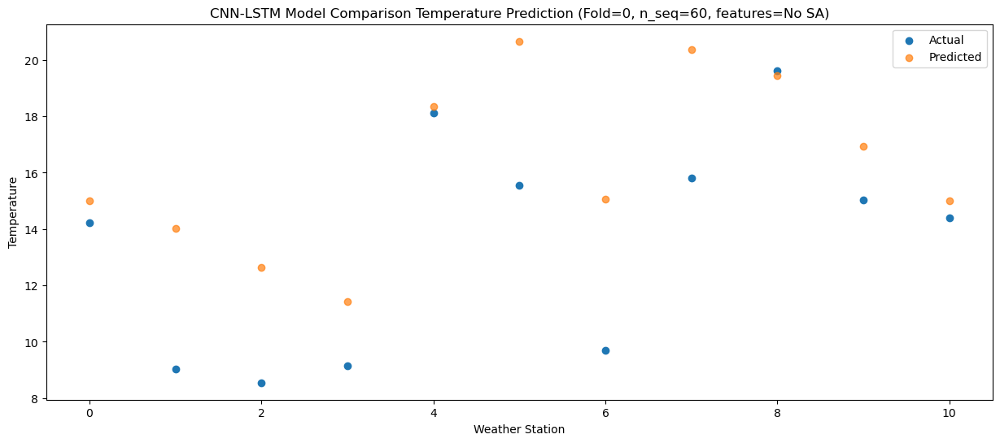

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  19.035139
1                 1   12.73  18.055270
2                 2   12.33  16.675197
3                 3   11.58  15.475214
4                 4   22.45  22.395145
5                 5   19.12  24.705214
6                 6   13.62  19.095217
7                 7   19.81  24.415181
8                 8   24.15  23.485147
9                 9   18.93  20.975134
10               10   19.17  19.035113


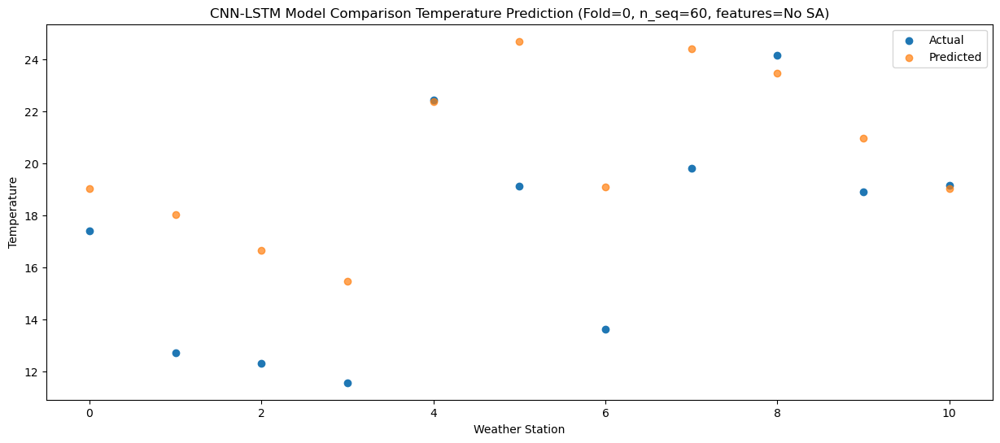

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  21.119672
1                 1   12.87  20.140455
2                 2   13.25  18.760068
3                 3   11.56  17.560096
4                 4   24.81  24.479647
5                 5   21.26  26.790083
6                 6   14.72  21.180007
7                 7   21.68  26.499859
8                 8   26.48  25.569523
9                 9   20.96  23.059514
10               10   20.28  21.119442


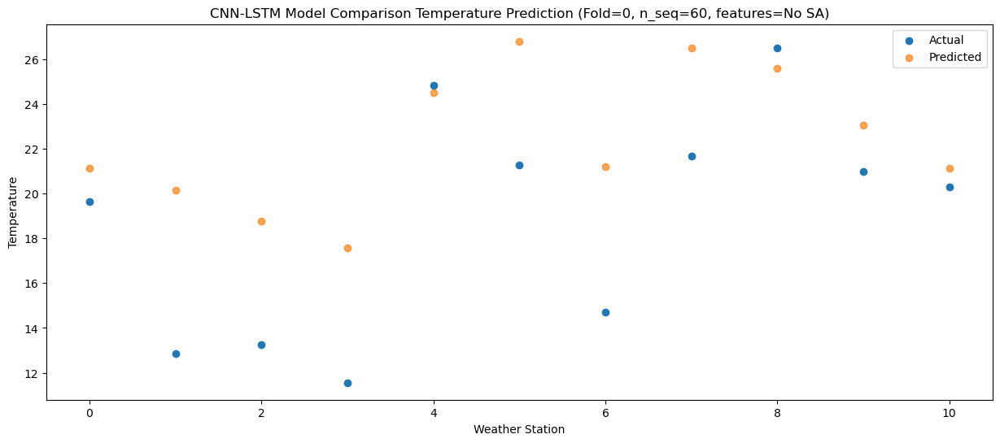

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  19.823600
1                 1   12.32  18.845209
2                 2   12.02  17.464420
3                 3   10.37  16.264457
4                 4   22.45  23.183532
5                 5   20.41  25.494432
6                 6   13.43  19.884255
7                 7   20.00  25.203968
8                 8   23.60  24.273253
9                 9   19.05  21.763246
10               10   19.16  19.823113


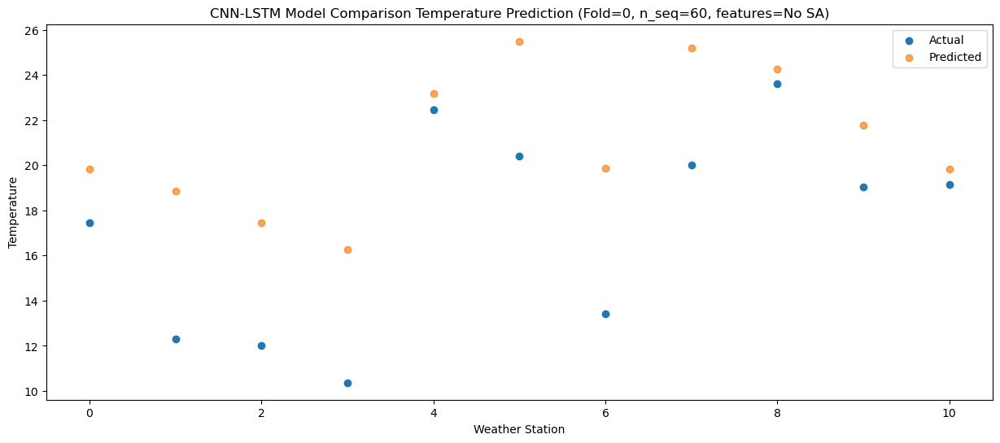

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  16.315926
1                 1   11.30  15.337628
2                 2    8.90  13.956792
3                 3    9.13  12.756831
4                 4   19.50  19.675850
5                 5   17.76  21.986807
6                 6   10.37  16.376616
7                 7   16.30  21.696313
8                 8   19.96  20.765553
9                 9   15.32  18.255548
10               10   15.32  16.315408


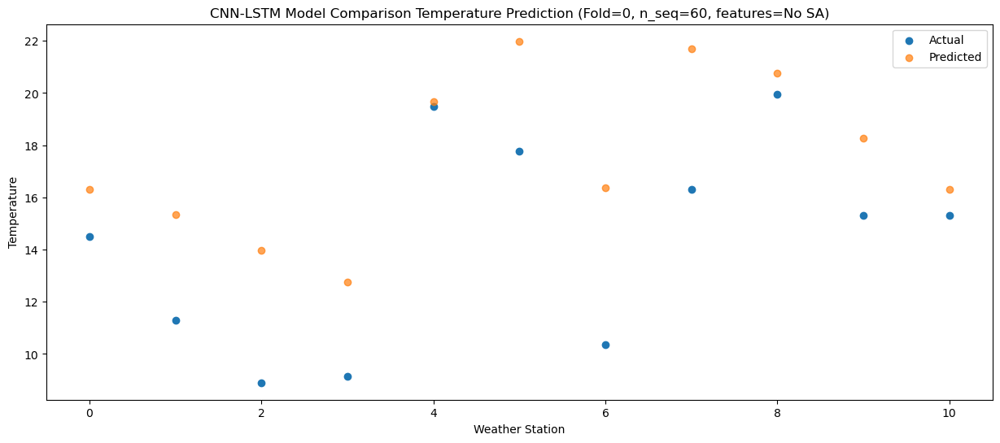

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   9.687039
1                 1    5.70   8.708923
2                 2    1.76   7.327998
3                 3    3.51   6.128039
4                 4   13.58  13.046954
5                 5   11.20  15.358012
6                 6    3.43   9.747798
7                 7    9.11  15.067464
8                 8   13.40  14.136625
9                 9    8.28  11.626622
10               10    8.08   9.686471


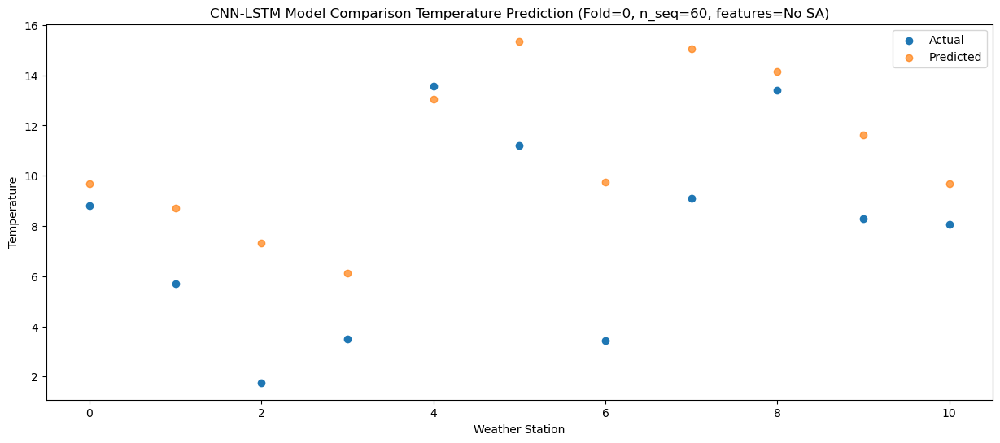

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   4.889513
1                 1    3.01   3.911794
2                 2   -0.72   2.530677
3                 3   -0.60   1.330724
4                 4    6.65   8.249407
5                 5    9.51  10.560689
6                 6    1.20   4.950423
7                 7    6.91  10.270027
8                 8    7.43   9.339003
9                 9    3.26   6.829001
10               10    3.05   4.888820


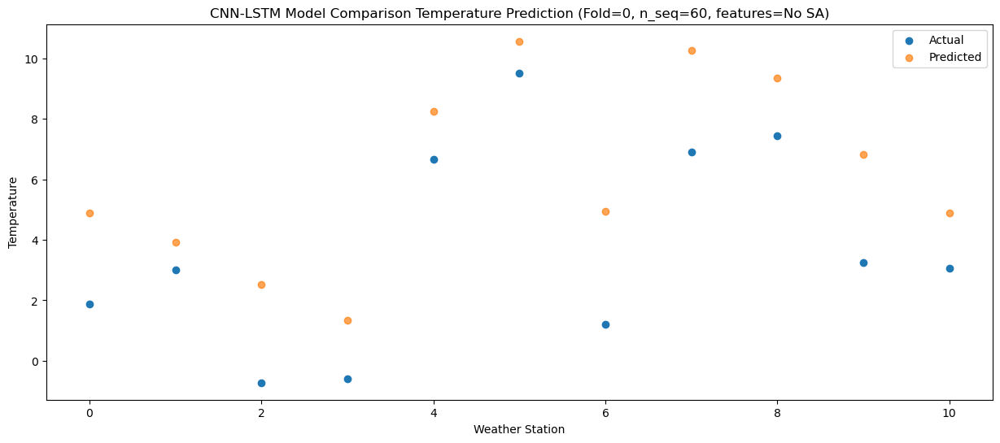

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22   0.054577
1                 1   -0.84  -0.923552
2                 2   -5.24  -2.304468
3                 3   -2.78  -3.504424
4                 4    3.92   3.414491
5                 5    2.99   5.725542
6                 6   -5.31   0.115329
7                 7   -0.26   5.435000
8                 8    2.14   4.504159
9                 9   -2.45   1.994156
10               10   -3.13   0.054002


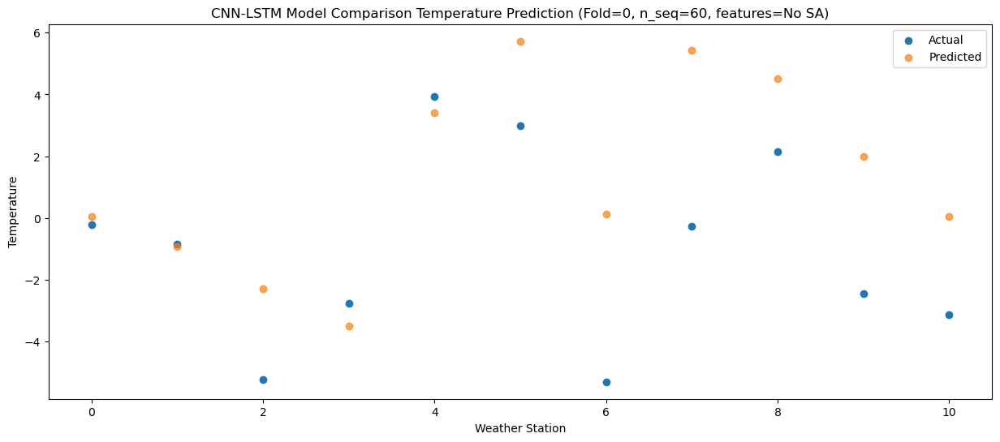

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42   1.332617
1                 1   -0.05   0.353975
2                 2   -3.29  -1.026687
3                 3   -1.34  -2.226651
4                 4    4.89   4.692552
5                 5    4.68   7.003325
6                 6   -2.12   1.393171
7                 7    2.91   6.712930
8                 8    4.70   5.782322
9                 9   -0.56   3.272316
10               10   -2.00   1.332201


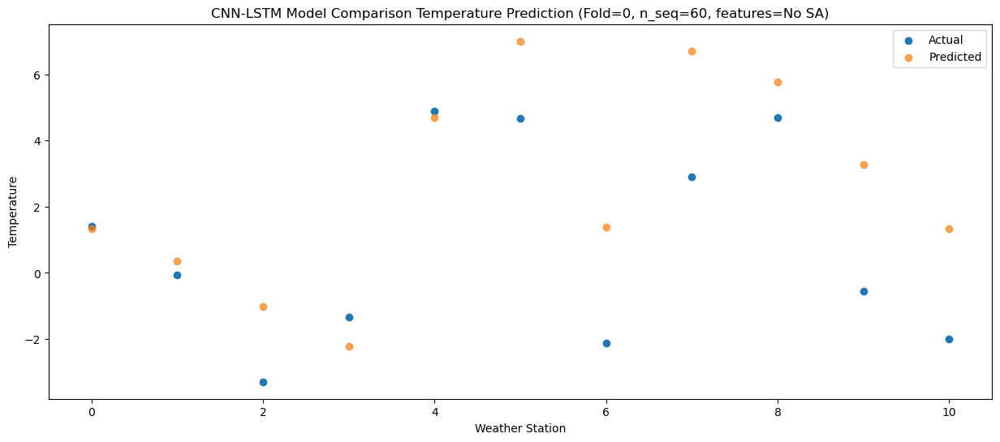

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95   2.679008
1                 1    1.05   1.700409
2                 2   -0.51   0.319727
3                 3   -0.93  -0.880239
4                 4    5.02   6.038941
5                 5    6.17   8.349737
6                 6    0.88   2.739581
7                 7    5.88   8.059329
8                 8    6.31   7.128703
9                 9    1.48   4.618697
10               10   -1.59   2.678572


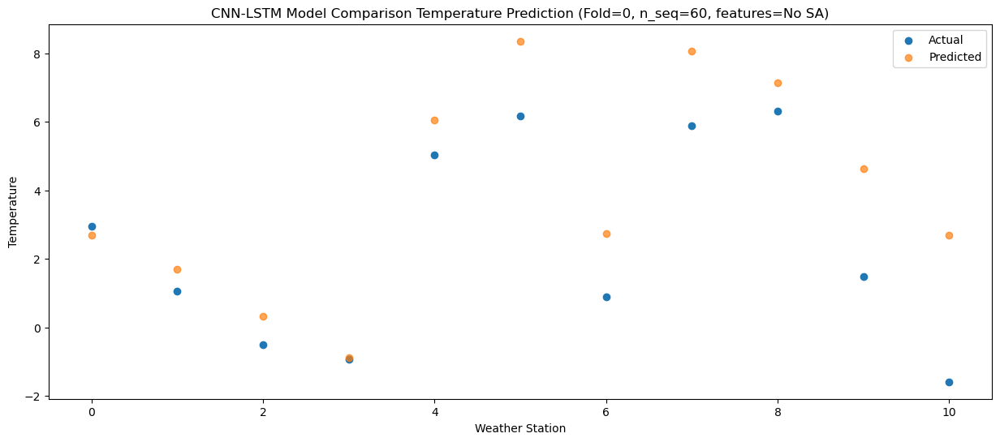

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   5.056795
1                 1    2.64   4.077417
2                 2   -0.53   2.697112
3                 3    2.59   1.497136
4                 4    9.74   8.416767
5                 5    7.08  10.727126
6                 6    1.36   5.117064
7                 7    6.56  10.436947
8                 8    8.13   9.506675
9                 9    1.82   6.996669
10               10    0.27   5.056606


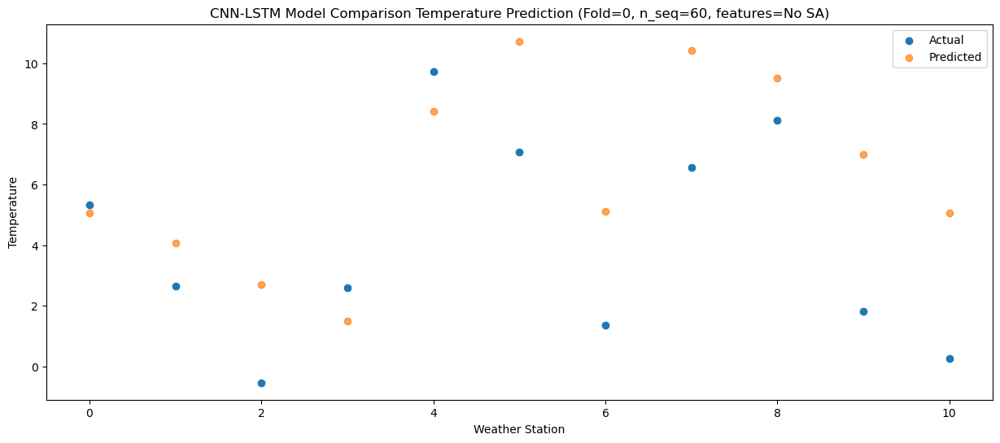

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94  10.437030
1                 1    4.79   9.458048
2                 2    2.54   8.077551
3                 3    4.01   6.877585
4                 4   11.24  13.796975
5                 5   11.76  16.107563
6                 6    4.92  10.497449
7                 7   11.18  15.817268
8                 8   13.91  14.886801
9                 9    8.10  12.376797
10               10    7.12  10.436703


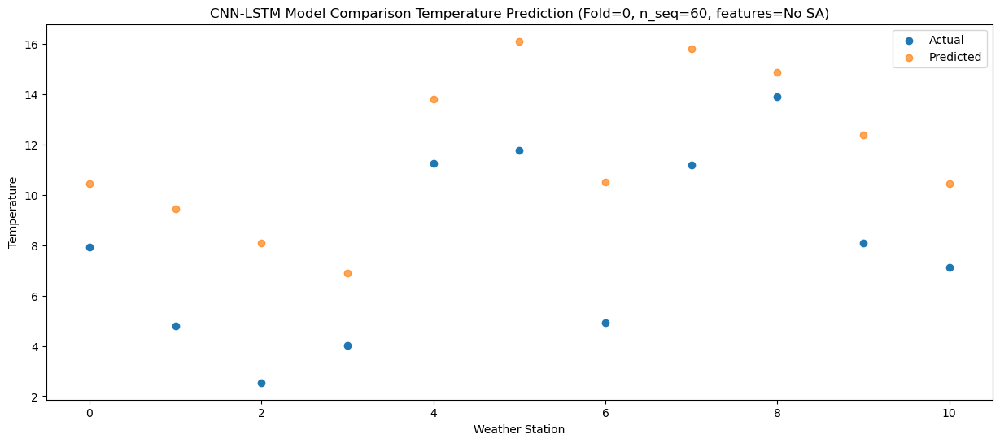

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  14.785738
1                 1    7.97  13.806525
2                 2    5.95  12.426141
3                 3    8.44  11.226175
4                 4   16.77  18.145698
5                 5   13.28  20.456157
6                 6    7.61  14.846071
7                 7   13.47  20.165925
8                 8   19.50  19.235572
9                 9   13.06  16.725564
10               10   12.14  14.785498


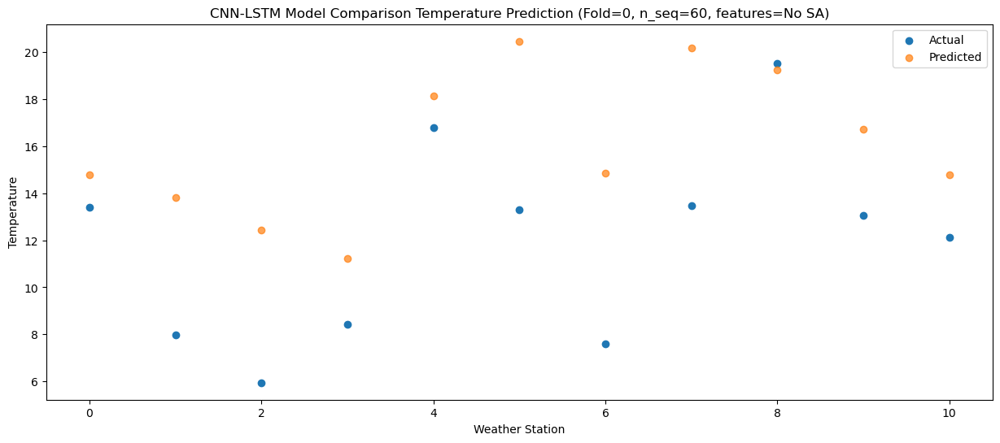

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  19.343314
1                 1   11.05  18.364243
2                 2    9.27  16.983784
3                 3   12.19  15.783822
4                 4   21.32  22.703271
5                 5   17.10  25.013804
6                 6   10.96  19.403701
7                 7   17.22  24.723530
8                 8   23.37  23.793121
9                 9   16.90  21.283115
10               10   17.65  19.343041


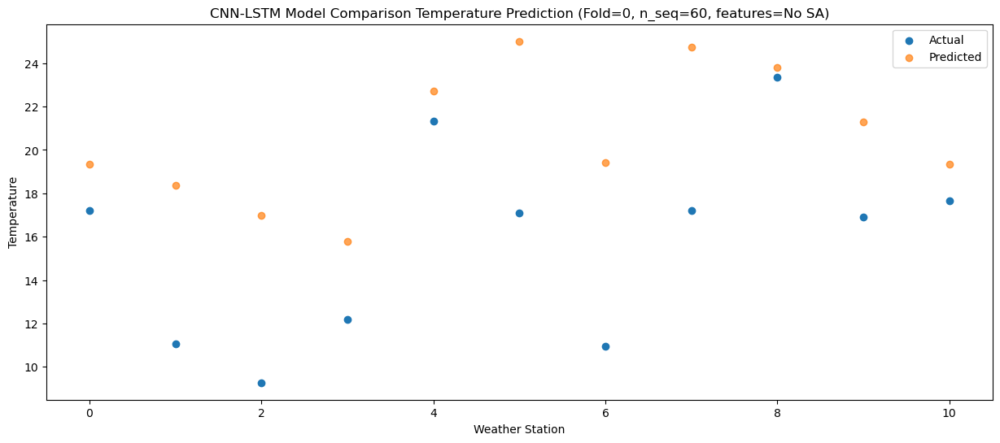

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  22.247764
1                 1   12.88  21.268775
2                 2   12.37  19.888277
3                 3   13.31  18.688315
4                 4   24.31  25.607721
5                 5   20.93  27.918297
6                 6   14.67  22.308182
7                 7   21.36  27.627999
8                 8   24.86  26.697555
9                 9   19.73  24.187551
10               10   20.11  22.247471


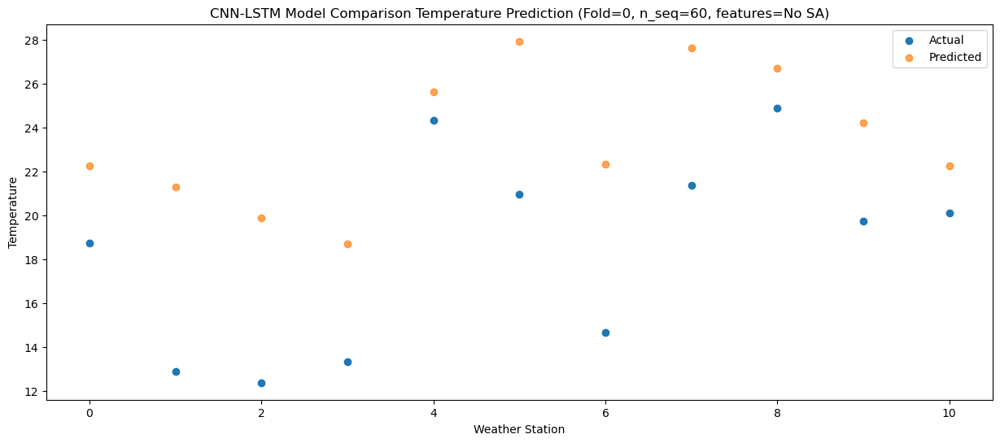

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  21.821607
1                 1   14.47  20.842529
2                 2   11.98  19.462066
3                 3   14.84  18.262103
4                 4   26.05  25.181571
5                 5   20.45  27.492091
6                 6   13.98  21.881985
7                 7   20.22  27.201817
8                 8   23.60  26.271433
9                 9   18.93  23.761426
10               10   18.30  21.821359


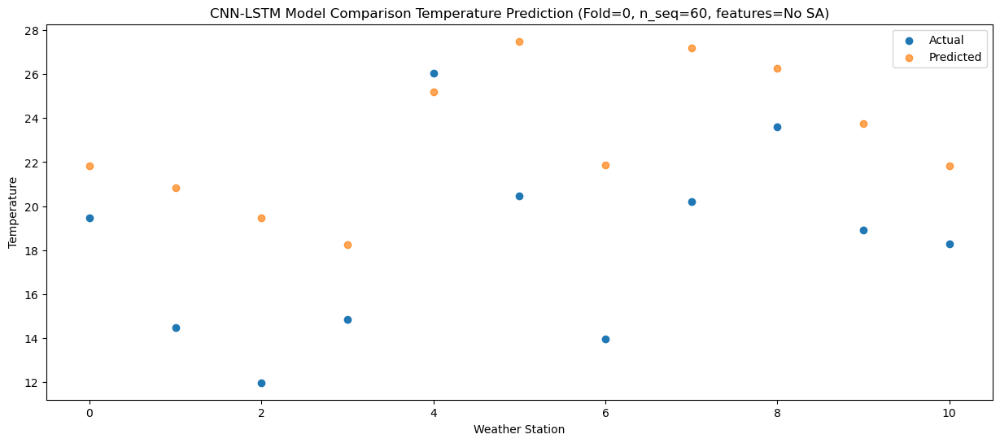

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  18.851650
1                 1   11.09  17.872532
2                 2    8.53  16.492086
3                 3   11.40  15.292124
4                 4   21.57  22.211620
5                 5   16.93  24.522114
6                 6   10.47  18.912011
7                 7   16.46  24.231851
8                 8   20.43  23.301489
9                 9   16.32  20.791484
10               10   15.92  18.851422


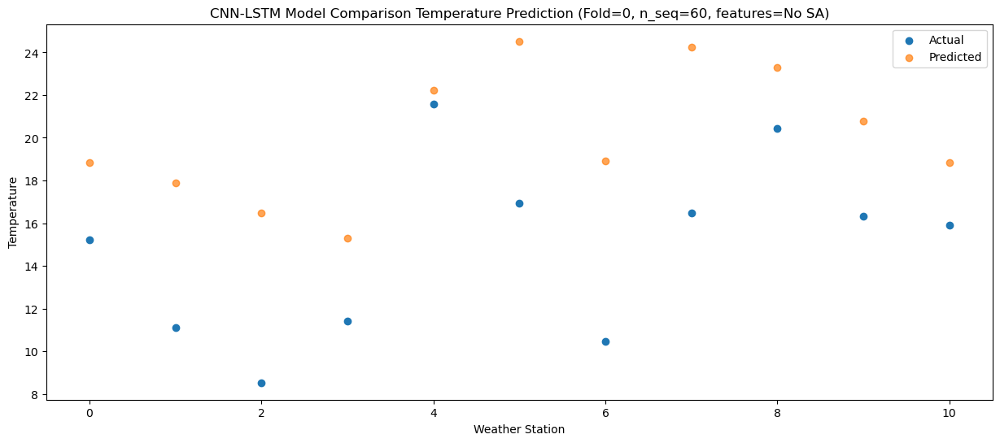

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16  12.957811
1                 1    5.98  11.978372
2                 2    2.55  10.598079
3                 3    5.15   9.398115
4                 4   13.91  16.317798
5                 5   12.58  18.628112
6                 6    5.26  13.018046
7                 7   11.07  18.337940
8                 8   14.83  17.407730
9                 9    9.74  14.897724
10               10    9.96  12.957688


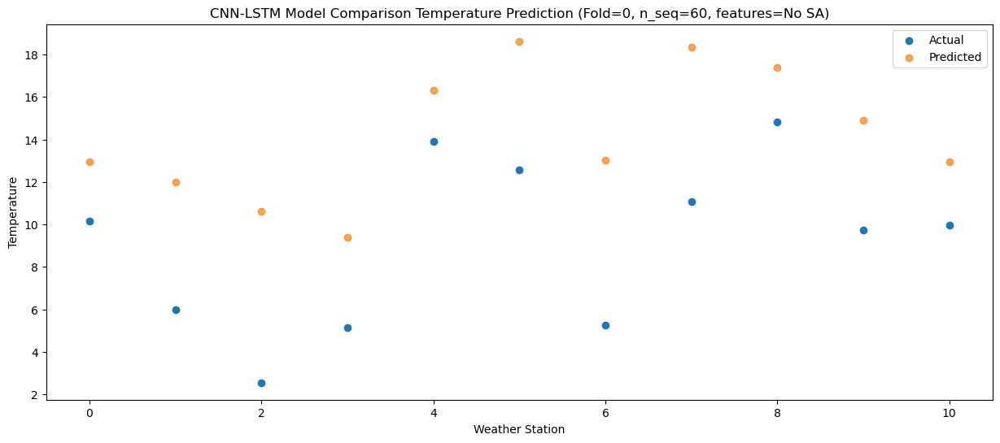

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   6.019015
1                 1    0.74   5.039829
2                 2   -2.54   3.659407
3                 3   -0.71   2.459449
4                 4    7.55   9.378986
5                 5    7.14  11.689446
6                 6   -0.61   6.079344
7                 7    4.62  11.399197
8                 8    7.84  10.468881
9                 9    3.24   7.958874
10               10    2.32   6.018822


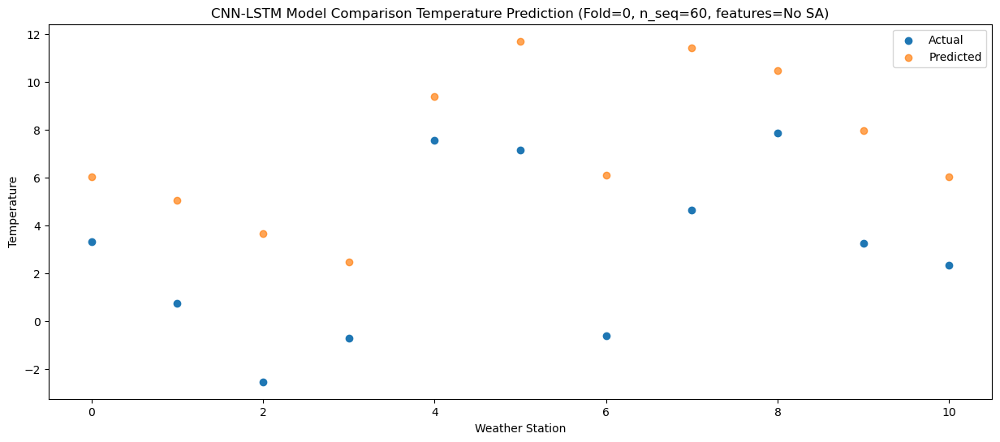

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   4.333822
1                 1   -1.96   3.354428
2                 2   -5.57   1.974104
3                 3   -3.50   0.774146
4                 4    4.76   7.693807
5                 5    5.00  10.004147
6                 6   -2.90   4.394073
7                 7    3.03   9.713960
8                 8    5.28   8.783739
9                 9    0.81   6.273730
10               10    1.64   4.333702


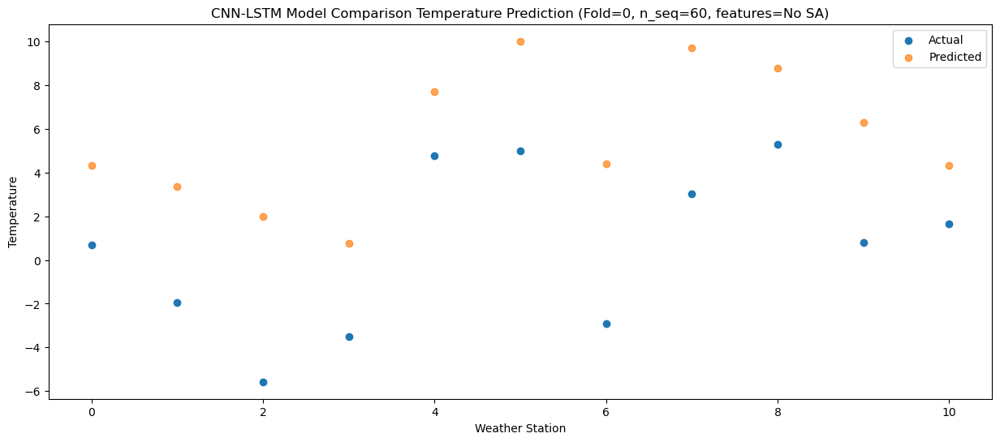

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -0.314440
1                 1   -4.23  -1.293578
2                 2   -8.08  -2.674027
3                 3   -6.38  -3.873980
4                 4   -0.22   3.045531
5                 5    3.73   5.356015
6                 6   -5.03  -0.254090
7                 7    0.33   5.065754
8                 8   -0.98   4.135411
9                 9   -4.95   1.625401
10               10   -5.28  -0.314647


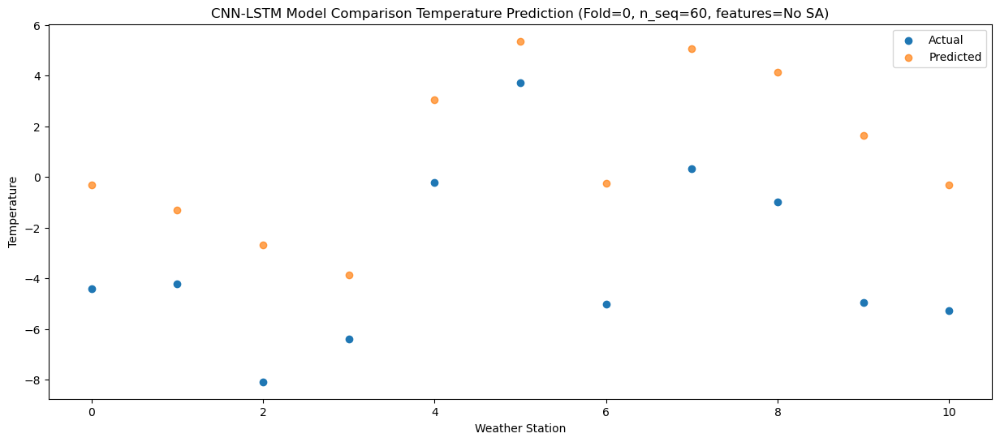

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   4.516225
1                 1   -1.73   3.537457
2                 2   -3.57   2.156827
3                 3   -1.73   0.956881
4                 4    7.65   7.876179
5                 5    4.25  10.186869
6                 6   -1.47   4.576719
7                 7    3.47   9.896497
8                 8    7.64   8.965986
9                 9    1.19   6.455977
10               10   -0.27   4.515901


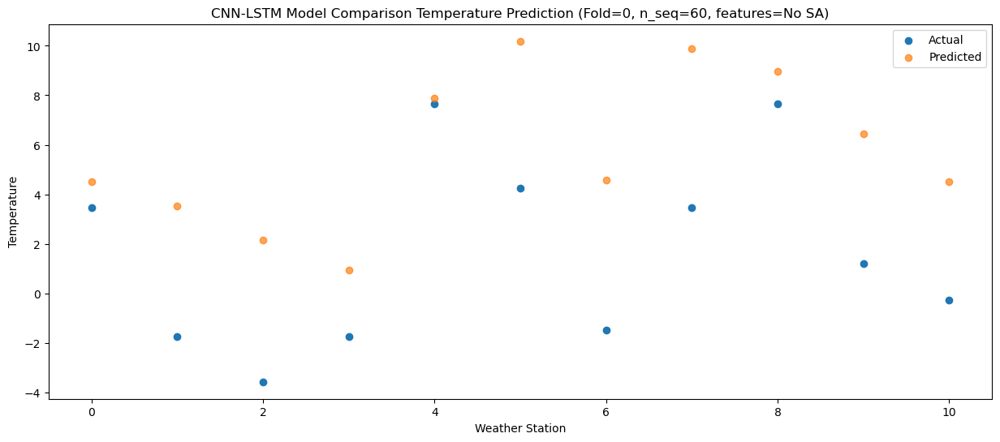

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   8.142700
1                 1    1.57   7.163861
2                 2    0.81   5.783257
3                 3    1.21   4.583314
4                 4   10.20  11.502657
5                 5    8.30  13.813299
6                 6    2.37   8.203163
7                 7    7.62  13.522952
8                 8   10.92  12.592481
9                 9    4.51  10.082475
10               10    3.23   8.142408


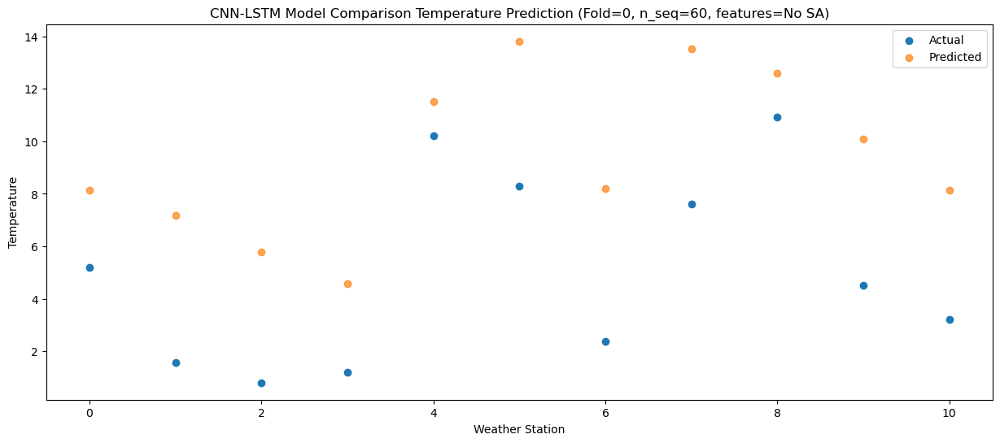

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98  12.472181
1                 1    4.45  11.493771
2                 2    4.50  10.112953
3                 3    4.78   8.913022
4                 4   13.47  15.832122
5                 5   11.52  18.143000
6                 6    5.96  12.532814
7                 7   12.10  17.852523
8                 8   15.80  16.921871
9                 9    9.73  14.411865
10               10    8.57  12.471769


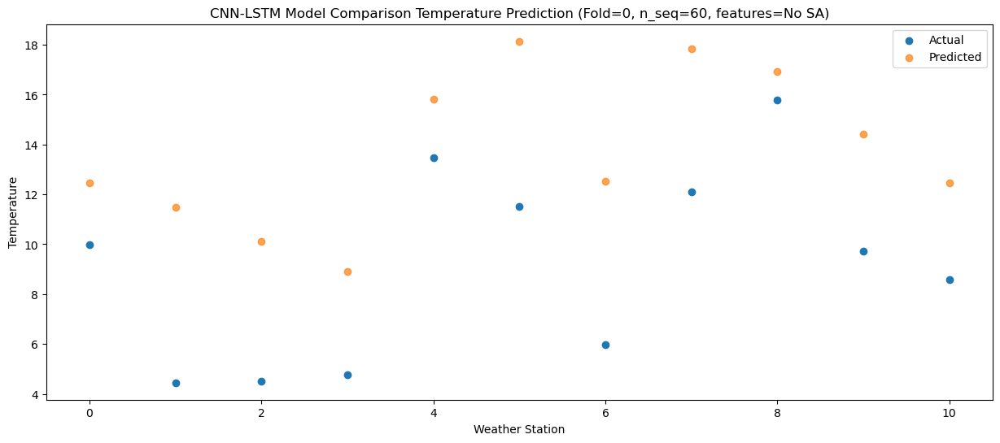

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  18.315434
1                 1    8.94  17.337224
2                 2    8.98  15.956305
3                 3    9.17  14.756368
4                 4   18.05  21.675372
5                 5   16.33  23.986351
6                 6    9.96  18.376140
7                 7   16.06  23.695819
8                 8   20.87  22.765085
9                 9   15.53  20.255081
10               10   15.54  18.314974


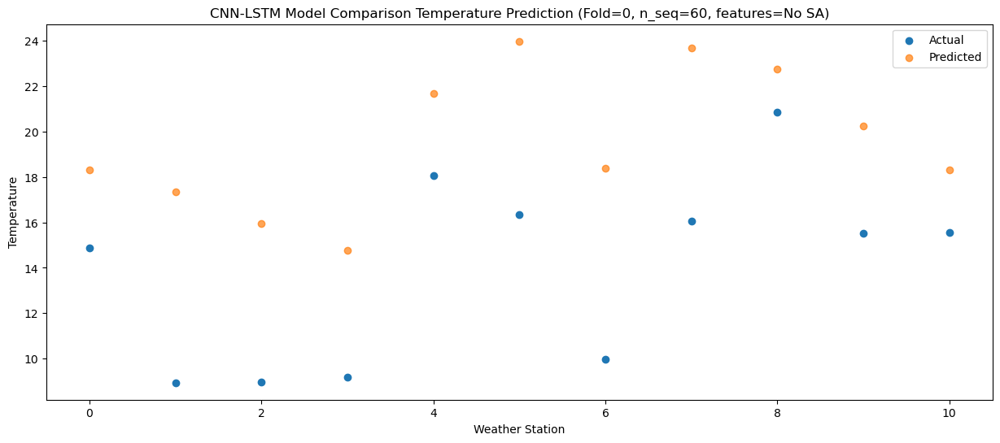

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  22.299105
1                 1   11.87  21.320566
2                 2   13.22  19.939803
3                 3   11.29  18.739858
4                 4   21.55  25.659062
5                 5   19.76  27.969849
6                 6   13.87  22.359681
7                 7   20.08  27.679412
8                 8   23.80  26.748838
9                 9   19.29  24.238833
10               10   19.86  22.298751


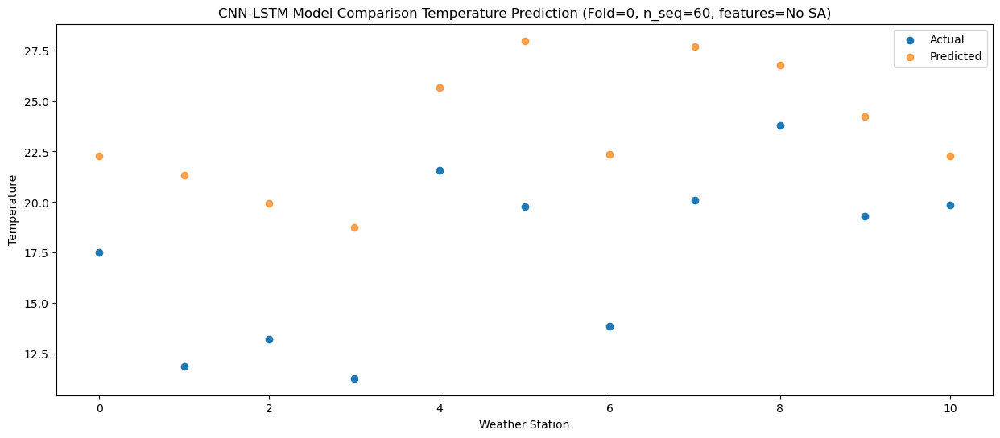

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  23.282607
1                 1   13.00  22.304093
2                 2   13.49  20.923321
3                 3   11.23  19.723376
4                 4   21.41  26.642560
5                 5   21.42  28.953365
6                 6   15.13  23.343195
7                 7   21.30  28.662924
8                 8   24.35  27.732333
9                 9   20.13  25.222327
10               10   20.75  23.282245


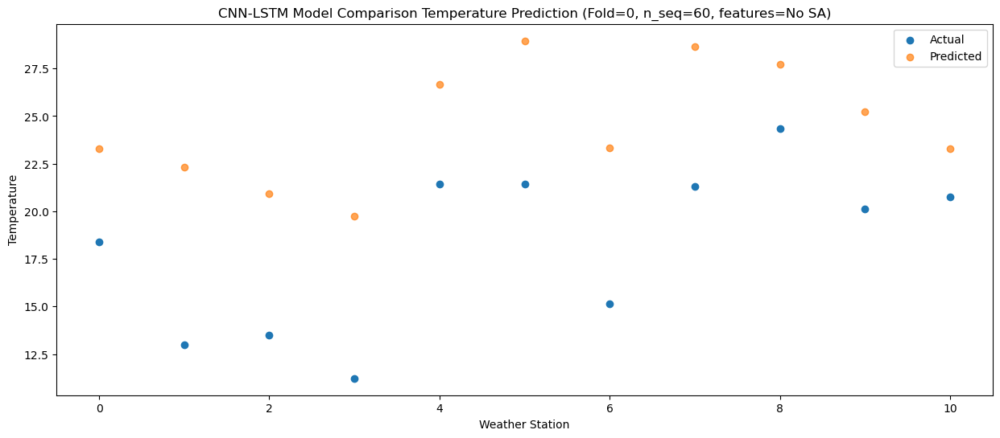

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  23.000900
1                 1   13.39  22.022585
2                 2   11.81  20.641720
3                 3   12.04  19.441777
4                 4   23.09  26.360840
5                 5   20.15  28.671762
6                 6   13.38  23.061570
7                 7   19.46  28.381262
8                 8   24.29  27.450569
9                 9   19.80  24.940567
10               10   20.00  23.000466


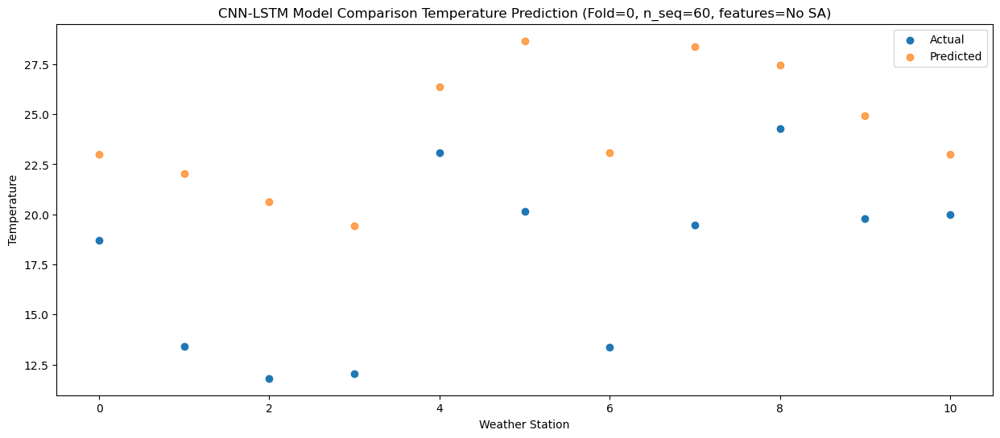

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  20.372737
1                 1   10.15  19.394332
2                 2    9.04  18.013510
3                 3    9.45  16.813566
4                 4   19.17  23.732681
5                 5   18.21  26.043554
6                 6   10.95  20.433372
7                 7   16.53  25.753083
8                 8   20.67  24.822427
9                 9   17.61  22.312424
10               10   17.22  20.372327


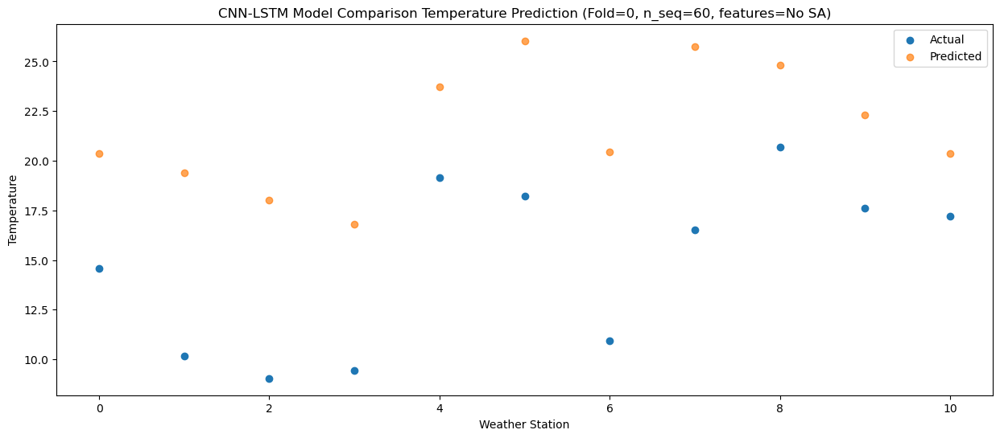

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31  15.477977
1                 1    6.83  14.499347
2                 2    3.14  13.118639
3                 3    5.31  11.918692
4                 4   16.72  18.837938
5                 5   13.18  21.148685
6                 6    5.68  15.538531
7                 7   10.70  20.858277
8                 8   15.24  19.927724
9                 9   10.87  17.417721
10               10   10.99  15.477643


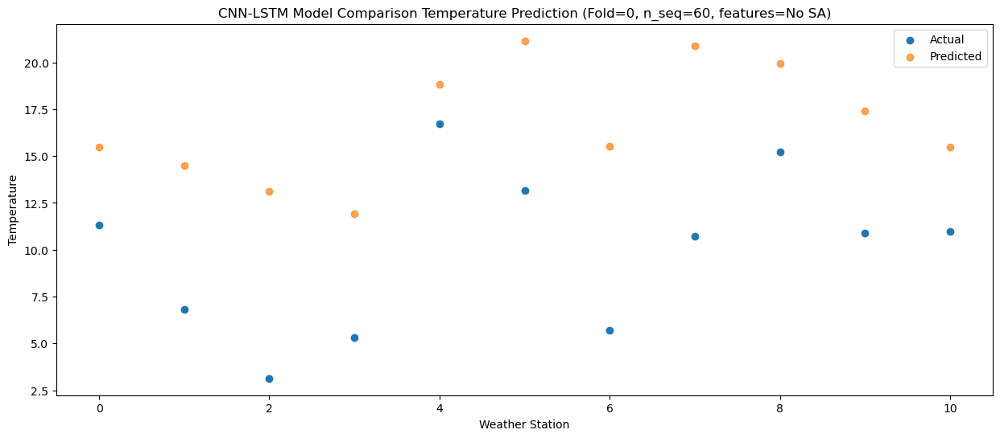

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 256)            464896    
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 256)           0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 256)            0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 1024)           5246976   
                                                                 
 dropout_7 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_5 (LSTM)               (None, 1024)              8392704   
                                                      

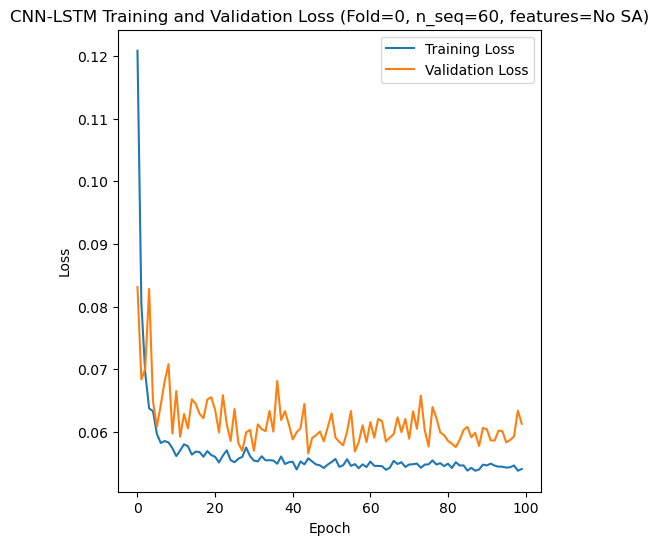

Epoch 1/100
84/84 [==============================] - 10s 63ms/step - loss: 0.1179 - accuracy: 0.2738 - mae: 0.0972 - rmse: 0.1179 - mape: inf - pearson: 0.6635 - val_loss: 0.0808 - val_accuracy: 0.6000 - val_mae: 0.0653 - val_rmse: 0.0808 - val_mape: 13.2591 - val_pearson: 0.8159
Epoch 2/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0805 - accuracy: 0.4881 - mae: 0.0652 - rmse: 0.0805 - mape: inf - pearson: 0.7873 - val_loss: 0.0731 - val_accuracy: 0.6000 - val_mae: 0.0589 - val_rmse: 0.0731 - val_mape: 12.3972 - val_pearson: 0.8143
Epoch 3/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0687 - accuracy: 0.4405 - mae: 0.0551 - rmse: 0.0687 - mape: inf - pearson: 0.8202 - val_loss: 0.0661 - val_accuracy: 0.6000 - val_mae: 0.0519 - val_rmse: 0.0661 - val_mape: 11.6783 - val_pearson: 0.8270
Epoch 4/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0662 - accuracy: 0.5833 - mae: 0.0527 - rmse: 0.0662 - mape: inf - pearson: 0.8295 

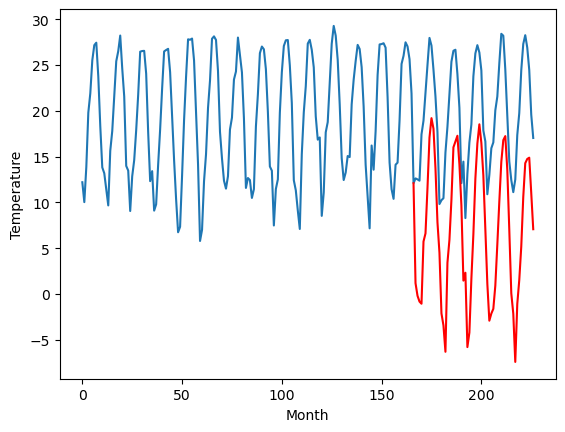

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-0.24		0.75
-1.90		-1.62		0.28
-3.01		-2.26		0.75
-2.92		-2.49		0.43
3.08		4.30		1.22
4.30		5.19		0.89
7.65		10.16		2.51
12.00		15.64		3.64
15.37		17.76		2.39
13.96		16.61		2.65
10.42		12.29		1.87
6.70		6.40		-0.30
2.60		3.07		0.47
-4.29		-3.54		0.75
-4.49		-4.85		-0.36
-3.83		-7.73		-3.90
2.94		1.98		-0.96
5.08		4.48		-0.60
8.81		8.86		0.05
12.95		14.58		1.63
14.33		15.21		0.88
14.60		15.84		1.24
10.86		12.72		1.86
7.08		8.23		1.15
-0.58		0.04		0.62
1.05		0.89		-0.16
-5.68		-7.22		-1.54
-1.45		-5.64		-4.19
2.12		0.24		-1.88
5.12		5.10		-0.02
11.00		11.17		0.17
14.97		14.99		0.02
15.47		17.09		1.62
14.01		15.07		1.06
10.92		11.50		0.58
4.58		5.62		1.04
1.58		-0.32		-1.90
-4.23		-4.34		-0.11
-2.04		-3.56		-1.52
1.33		-3.04		-4.37
2.10		-0.51		-2.61
5.37		3.97		-1.40
8.65		8.65		-0.00
11.84		12.99		1.15
15.44		15.37		-0.07
14.90		15.81		0.91
11.39		12.14		0.75
6.38		5.58		-0.80
0.76		-1.

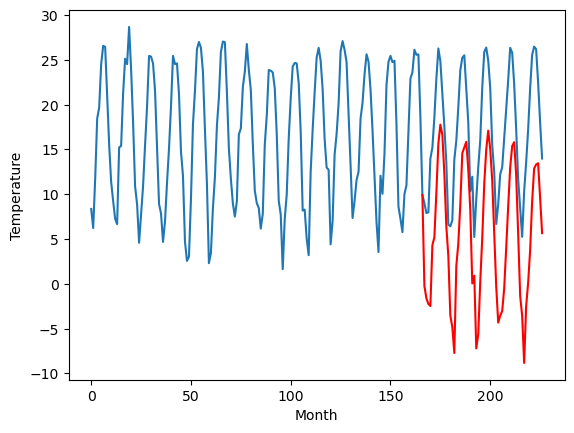

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		1.00		1.90
-0.47		-0.38		0.09
-1.00		-1.02		-0.02
-0.72		-1.25		-0.53
6.38		5.54		-0.84
5.41		6.43		1.02
9.56		11.40		1.84
13.79		16.88		3.09
15.26		19.00		3.74
15.25		17.85		2.60
12.45		13.53		1.08
8.10		7.64		-0.46
3.30		4.31		1.01
-3.76		-2.30		1.46
-3.34		-3.61		-0.27
-2.85		-6.49		-3.64
4.21		3.22		-0.99
5.61		5.72		0.11
9.73		10.10		0.37
13.61		15.82		2.21
14.38		16.45		2.07
15.04		17.08		2.04
12.02		13.96		1.94
8.24		9.47		1.23
0.50		1.28		0.78
3.10		2.14		-0.96
-3.79		-5.98		-2.19
-0.44		-4.39		-3.95
3.56		1.49		-2.07
7.15		6.34		-0.81
12.51		12.41		-0.10
15.48		16.23		0.75
16.19		18.33		2.14
14.58		16.31		1.73
12.19		12.74		0.55
5.50		6.87		1.37
2.18		0.92		-1.26
-0.98		-3.09		-2.11
0.02		-2.32		-2.34
2.61		-1.80		-4.41
4.04		0.74		-3.30
6.73		5.22		-1.51
9.97		9.89		-0.08
13.72		14.23		0.51
16.09		16.61		0.52
16.53		17.05		0.52
13.57		13.38		-0.19
7.53		6.82		-0.71
0.97		-0.1

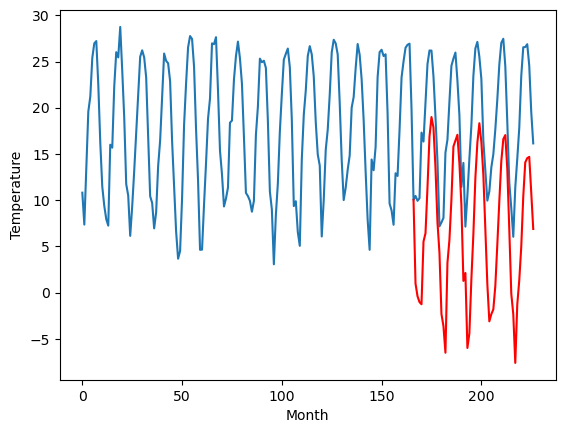

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		0.03		-1.16
-0.23		-1.35		-1.12
0.52		-1.99		-2.51
-0.01		-2.22		-2.21
7.63		4.57		-3.06
7.51		5.46		-2.05
11.26		10.43		-0.83
14.04		15.91		1.87
15.69		18.03		2.34
15.93		16.88		0.95
12.52		12.56		0.04
7.98		6.67		-1.31
5.08		3.34		-1.74
-1.10		-3.27		-2.17
-1.20		-4.58		-3.38
-2.79		-7.46		-4.67
4.58		2.25		-2.33
6.92		4.75		-2.17
10.81		9.13		-1.68
14.70		14.85		0.15
14.58		15.48		0.90
15.55		16.11		0.56
12.54		12.99		0.45
9.85		8.50		-1.35
2.69		0.31		-2.38
6.06		1.17		-4.89
-1.99		-6.95		-4.96
-2.46		-5.36		-2.90
3.38		0.52		-2.86
9.38		5.37		-4.01
13.81		11.44		-2.37
16.81		15.26		-1.55
17.75		17.36		-0.39
16.11		15.34		-0.77
13.34		11.77		-1.57
7.78		5.90		-1.88
2.73		-0.05		-2.78
0.64		-4.06		-4.70
1.35		-3.29		-4.64
2.35		-2.77		-5.12
6.18		-0.24		-6.42
7.02		4.25		-2.77
11.61		8.92		-2.69
15.76		13.26		-2.50
17.48		15.64		-1.84
19.45		16.08		-3.37
16.37		12.41		-3.96
9.11		5.8

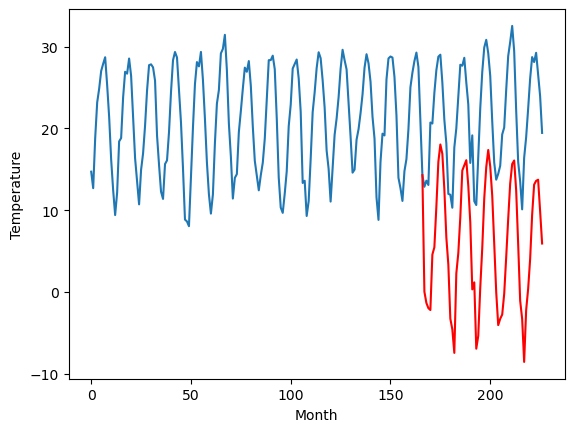

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		4.27		-1.33
3.71		2.89		-0.82
4.52		2.25		-2.27
4.14		2.02		-2.12
12.18		8.81		-3.37
11.92		9.70		-2.22
15.72		14.67		-1.05
18.75		20.15		1.40
20.79		22.27		1.48
21.03		21.12		0.09
17.45		16.80		-0.65
12.51		10.91		-1.60
9.41		7.58		-1.83
3.05		0.97		-2.08
3.04		-0.34		-3.38
1.34		-3.22		-4.56
8.95		6.49		-2.46
11.25		8.99		-2.26
15.37		13.37		-2.00
18.84		19.09		0.25
18.93		19.72		0.79
19.90		20.35		0.45
16.32		17.23		0.91
13.28		12.74		-0.54
5.73		4.55		-1.18
9.61		5.40		-4.21
1.13		-2.71		-3.84
0.82		-1.13		-1.95
6.60		4.76		-1.84
12.87		9.61		-3.26
17.49		15.68		-1.81
20.86		19.50		-1.36
21.95		21.60		-0.35
19.94		19.58		-0.36
16.76		16.01		-0.75
11.37		10.13		-1.24
6.37		4.19		-2.18
4.35		0.18		-4.17
4.83		0.95		-3.88
6.01		1.47		-4.54
9.83		4.00		-5.83
10.79		8.49		-2.30
15.43		13.16		-2.27
20.32		17.50		-2.82
22.27		19.88		-2.39
23.70		20.32		-3.38
19.85		16.65		-3.20
12.45		10.0

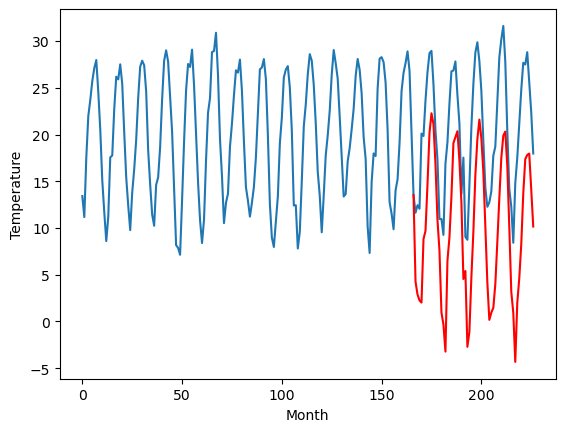

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		0.42		-2.31
0.70		-0.96		-1.66
0.04		-1.60		-1.64
-0.48		-1.83		-1.35
6.87		4.96		-1.91
9.66		5.85		-3.81
14.85		10.82		-4.03
17.57		16.30		-1.27
20.27		18.42		-1.85
20.12		17.27		-2.85
12.59		12.95		0.36
9.75		7.05		-2.70
6.03		3.73		-2.30
-0.72		-2.88		-2.16
-2.23		-4.19		-1.96
-1.85		-7.07		-5.22
5.49		2.65		-2.84
7.76		5.14		-2.62
13.35		9.52		-3.83
17.62		15.24		-2.38
16.96		15.87		-1.09
16.37		16.50		0.13
16.01		13.38		-2.63
11.69		8.89		-2.80
5.22		0.69		-4.53
5.48		1.55		-3.93
-1.84		-6.56		-4.72
-1.95		-4.98		-3.03
5.00		0.90		-4.10
11.91		5.76		-6.15
17.31		11.83		-5.48
19.37		15.65		-3.72
20.29		17.75		-2.54
17.44		15.72		-1.72
14.39		12.16		-2.23
8.31		6.28		-2.03
1.35		0.34		-1.01
0.23		-3.68		-3.91
0.69		-2.91		-3.60
0.83		-2.39		-3.22
5.89		0.15		-5.74
9.05		4.63		-4.42
13.66		9.31		-4.35
20.35		13.64		-6.71
21.45		16.03		-5.42
20.64		16.46		-4.18
18.36		12.79		-5.57
10.7

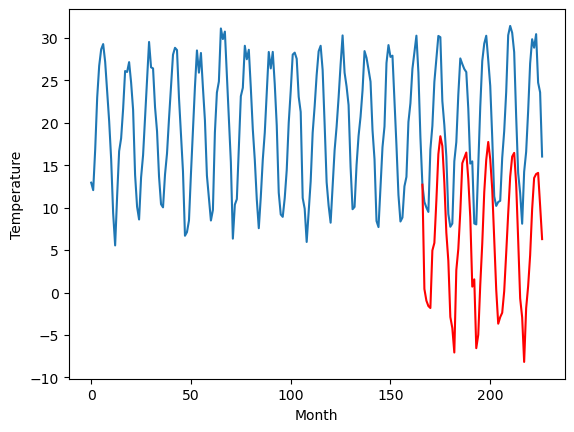

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		2.89		1.14
1.02		1.51		0.49
0.21		0.87		0.66
0.28		0.64		0.36
5.95		7.43		1.48
7.58		8.32		0.74
10.36		13.29		2.93
15.03		18.77		3.74
18.21		20.89		2.68
16.58		19.74		3.16
13.16		15.42		2.26
9.67		9.52		-0.15
5.52		6.20		0.68
-1.69		-0.41		1.28
-1.89		-1.72		0.17
-1.11		-4.60		-3.49
5.17		5.11		-0.06
7.74		7.61		-0.13
11.51		11.99		0.48
15.52		17.71		2.19
16.88		18.34		1.46
17.14		18.97		1.83
13.81		15.85		2.04
9.86		11.36		1.50
2.26		3.17		0.91
3.78		4.02		0.24
-2.61		-4.09		-1.48
1.20		-2.51		-3.71
5.04		3.37		-1.67
7.80		8.23		0.43
13.72		14.30		0.58
17.30		18.12		0.82
18.04		20.22		2.18
16.54		18.19		1.65
13.65		14.63		0.98
7.31		8.75		1.44
4.42		2.81		-1.61
-1.59		-1.21		0.38
0.54		-0.43		-0.97
4.13		0.09		-4.04
4.80		2.62		-2.18
8.06		7.10		-0.96
11.06		11.78		0.72
14.34		16.12		1.78
17.79		18.50		0.71
17.37		18.94		1.57
14.20		15.26		1.06
9.19		8.71		-0.48
3.50		1.79		-1.71
0.76	

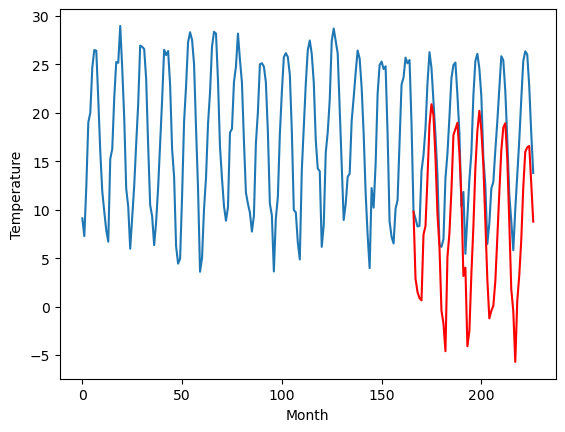

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		6.78		0.27
5.89		5.40		-0.49
5.04		4.76		-0.28
5.72		4.53		-1.19
12.64		11.32		-1.32
13.78		12.21		-1.57
18.28		17.18		-1.10
23.84		22.66		-1.18
26.38		24.78		-1.60
24.36		23.63		-0.73
21.06		19.31		-1.75
14.29		13.42		-0.87
10.62		10.09		-0.53
4.02		3.48		-0.54
3.71		2.17		-1.54
0.71		-0.71		-1.42
12.03		9.00		-3.03
13.74		11.50		-2.24
18.40		15.88		-2.52
24.48		21.60		-2.88
25.47		22.23		-3.24
26.69		22.86		-3.83
22.98		19.74		-3.24
17.78		15.25		-2.53
8.48		7.06		-1.42
10.89		7.91		-2.98
2.06		-0.20		-2.26
4.11		1.38		-2.73
10.06		7.27		-2.79
15.25		12.12		-3.13
20.72		18.19		-2.53
24.78		22.01		-2.77
28.91		24.11		-4.80
26.04		22.09		-3.95
22.20		18.52		-3.68
15.53		12.64		-2.89
8.93		6.70		-2.23
5.19		2.68		-2.51
6.38		3.46		-2.92
7.88		3.98		-3.90
10.71		6.51		-4.20
15.11		11.00		-4.11
20.46		15.67		-4.79
24.27		20.01		-4.26
26.57		22.39		-4.18
27.07		22.83		-4.24
23.45		19.16		-4

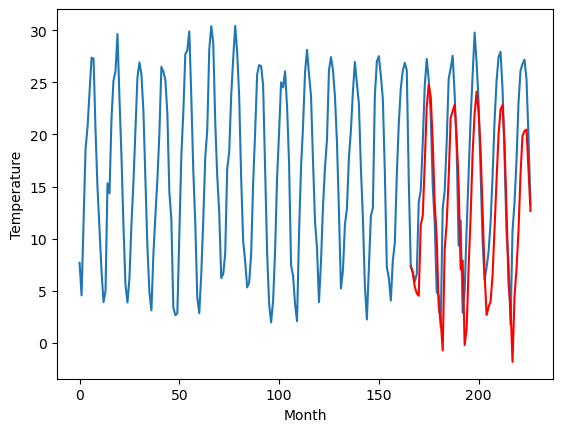

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		5.49		-0.68
4.32		4.11		-0.21
4.50		3.47		-1.03
3.99		3.24		-0.75
11.82		10.03		-1.79
13.20		10.92		-2.28
19.31		15.89		-3.42
24.42		21.37		-3.05
26.96		23.49		-3.47
26.03		22.34		-3.69
19.38		18.02		-1.36
13.20		12.12		-1.08
10.32		8.80		-1.52
3.64		2.19		-1.45
3.29		0.88		-2.41
-1.49		-2.01		-0.52
11.07		7.72		-3.35
12.87		10.21		-2.66
17.68		14.59		-3.09
23.71		20.31		-3.40
25.22		20.94		-4.28
25.61		21.57		-4.04
23.10		18.45		-4.65
16.85		13.96		-2.89
9.10		5.76		-3.34
8.29		6.62		-1.67
0.67		-1.50		-2.17
1.65		0.09		-1.56
8.90		5.97		-2.93
16.01		10.83		-5.18
21.37		16.90		-4.47
25.66		20.72		-4.94
29.81		22.82		-6.99
27.14		20.79		-6.35
23.31		17.23		-6.08
15.08		11.35		-3.73
7.23		5.41		-1.82
3.60		1.39		-2.21
4.46		2.16		-2.30
4.83		2.68		-2.15
9.26		5.22		-4.04
13.59		9.70		-3.89
19.28		14.38		-4.90
24.21		18.71		-5.50
27.09		21.10		-5.99
28.90		21.53		-7.37
24.26		17.86		-6.40

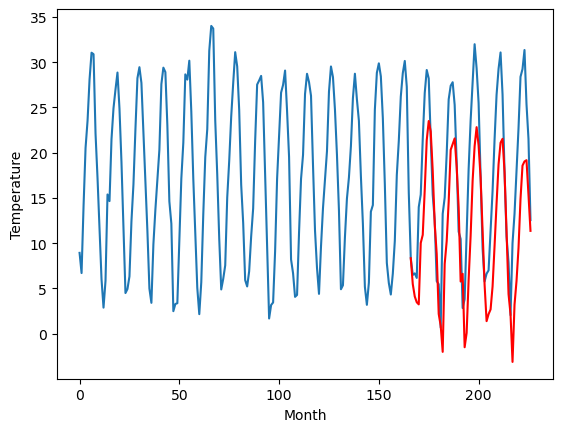

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		5.02		-3.68
7.34		3.64		-3.70
6.89		3.00		-3.89
5.65		2.77		-2.88
13.61		9.55		-4.06
15.92		10.45		-5.47
22.45		15.42		-7.03
28.83		20.90		-7.93
30.41		23.02		-7.39
29.18		21.87		-7.31
22.43		17.55		-4.88
15.83		11.65		-4.18
12.65		8.33		-4.32
5.38		1.72		-3.66
5.49		0.40		-5.09
1.12		-2.48		-3.60
11.83		7.25		-4.58
15.59		9.74		-5.85
20.14		14.12		-6.02
27.25		19.84		-7.41
27.92		20.47		-7.45
27.77		21.10		-6.67
25.82		17.98		-7.84
18.38		13.49		-4.89
12.13		5.29		-6.84
10.52		6.15		-4.37
3.60		-1.97		-5.57
3.66		-0.38		-4.04
10.59		5.50		-5.09
17.07		10.36		-6.71
22.52		16.43		-6.09
27.09		20.24		-6.85
30.69		22.35		-8.34
27.86		20.32		-7.54
25.45		16.76		-8.69
16.91		10.88		-6.03
7.92		4.94		-2.98
5.57		0.92		-4.65
5.85		1.69		-4.16
7.00		2.21		-4.79
10.73		4.75		-5.98
16.08		9.23		-6.85
21.19		13.90		-7.29
24.42		18.24		-6.18
29.04		20.62		-8.42
29.44		21.06		-8.38
25.92		17.38		-8

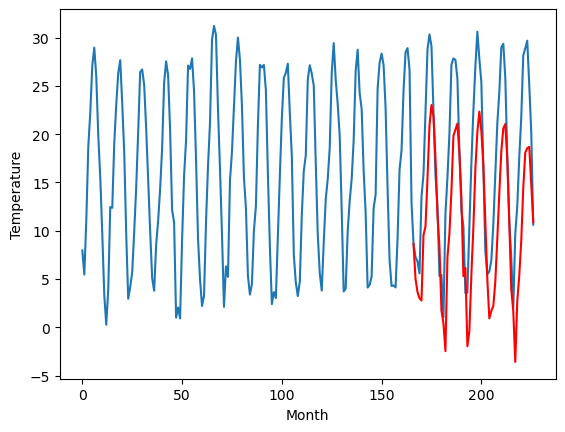

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		1.19		1.59
-3.21		-0.19		3.02
-2.87		-0.83		2.04
-2.13		-1.06		1.07
2.19		5.73		3.54
3.82		6.62		2.80
9.28		11.59		2.31
16.60		17.07		0.47
20.47		19.19		-1.28
18.28		18.04		-0.24
13.75		13.72		-0.03
8.21		7.82		-0.39
4.01		4.50		0.49
-3.00		-2.11		0.89
-4.84		-3.42		1.42
-5.80		-6.31		-0.51
1.42		3.42		2.00
6.07		5.91		-0.16
10.61		10.29		-0.32
16.70		16.01		-0.69
18.93		16.64		-2.29
18.71		17.27		-1.44
15.01		14.15		-0.86
10.59		9.66		-0.93
1.27		1.46		0.19
0.50		2.32		1.82
-6.52		-5.80		0.72
-2.62		-4.21		-1.59
1.94		1.67		-0.27
5.29		6.53		1.24
12.27		12.60		0.33
16.66		16.41		-0.25
20.60		18.52		-2.08
20.06		16.49		-3.57
15.15		12.93		-2.22
7.05		7.05		0.00
3.54		1.11		-2.43
-3.61		-2.91		0.70
-0.65		-2.14		-1.49
-0.97		-1.62		-0.65
0.15		0.92		0.77
7.37		5.40		-1.97
9.93		10.07		0.14
14.30		14.41		0.11
19.44		16.79		-2.65
17.70		17.23		-0.47
14.51		13.56		-0.95
9.16		7.00		-2.16


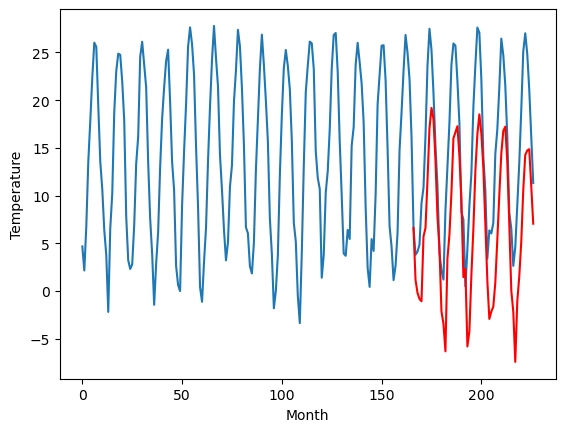

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[1.1854063224792473, -0.24468236923217734, 0.9951998519897458, 0.025228462219238246, 4.265281391143798, 0.41559514999389613, 2.8853614997863772, 6.7752928352355966, 5.48568717956543, 5.015832138061523, 1.185745830535888]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   1.185406
1                 1   -0.99  -0.244682
2                 2   -0.90   0.995200
3                 3    1.19   0.025228
4                 4    5.60   4.265281
5                 5    2.73   0.415595
6                 6    1.75   2.885361
7                 7    6.51   6.775293
8                 8    6.17   5.485687
9                 9    8.70   5.015832
10               10   -0.40   1.185746


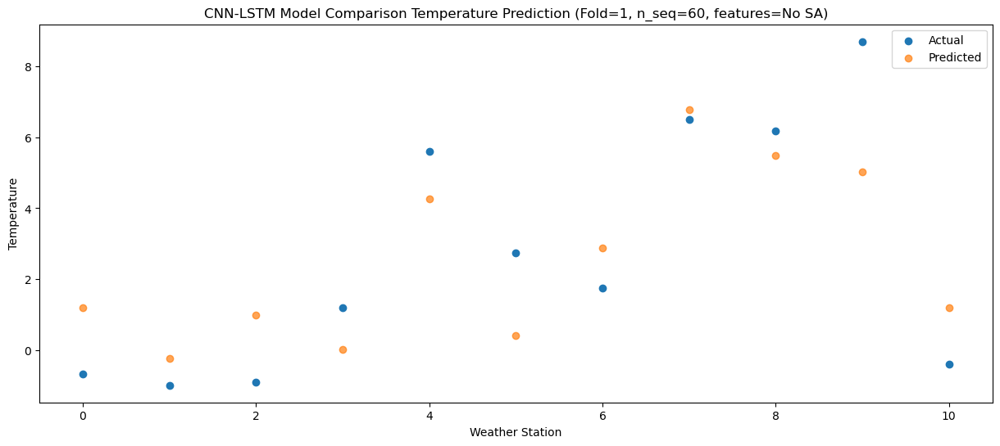

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.191076
1                 1   -1.90  -1.621390
2                 2   -0.47  -0.381799
3                 3   -0.23  -1.351712
4                 4    3.71   2.888484
5                 5    0.70  -0.960412
6                 6    1.02   1.508760
7                 7    5.89   5.398525
8                 8    4.32   4.109905
9                 9    7.34   3.640420
10               10   -3.21  -0.189886


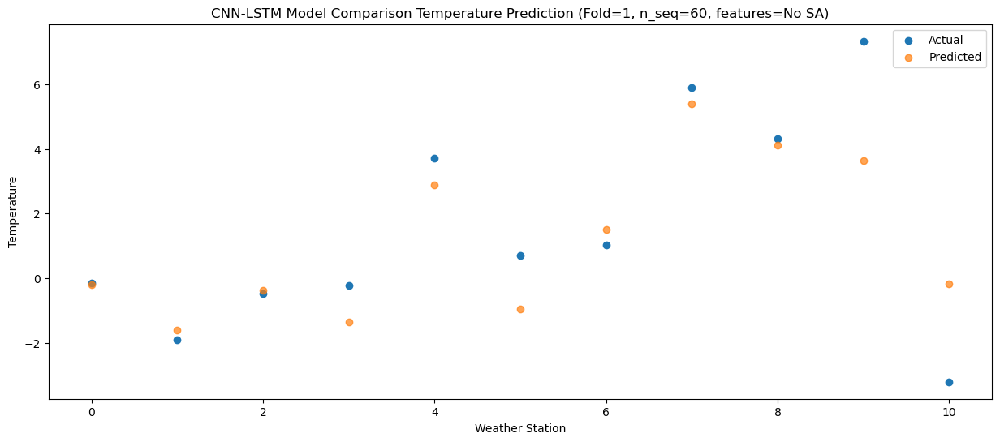

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -0.827670
1                 1   -3.01  -2.257653
2                 2   -1.00  -1.017631
3                 3    0.52  -1.987640
4                 4    4.52   2.252355
5                 5    0.04  -1.597708
6                 6    0.21   0.872338
7                 7    5.04   4.762356
8                 8    4.50   3.472272
9                 9    6.89   3.002239
10               10   -2.87  -0.827742


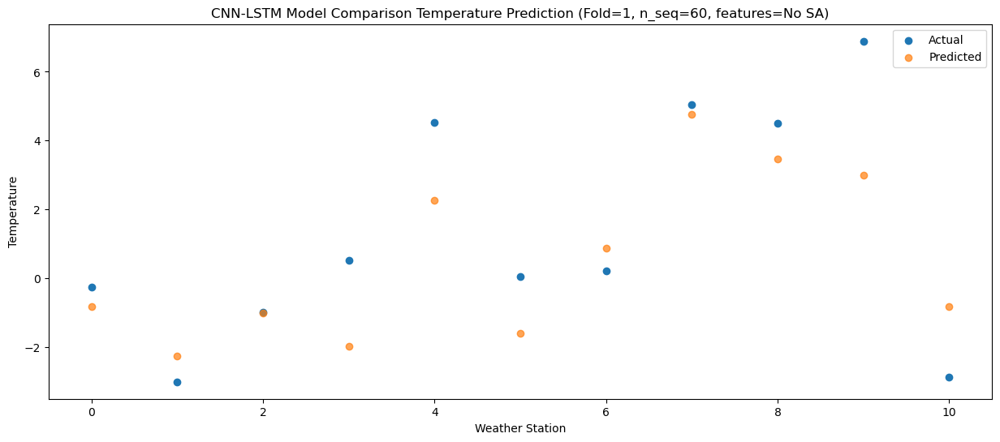

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -1.058484
1                 1   -2.92  -2.488013
2                 2   -0.72  -1.247407
3                 3   -0.01  -2.217539
4                 4    4.14   2.022175
5                 5   -0.48  -1.829468
6                 6    0.28   0.641761
7                 7    5.72   4.532120
8                 8    3.99   3.240060
9                 9    5.65   2.769281
10               10   -2.13  -1.060253


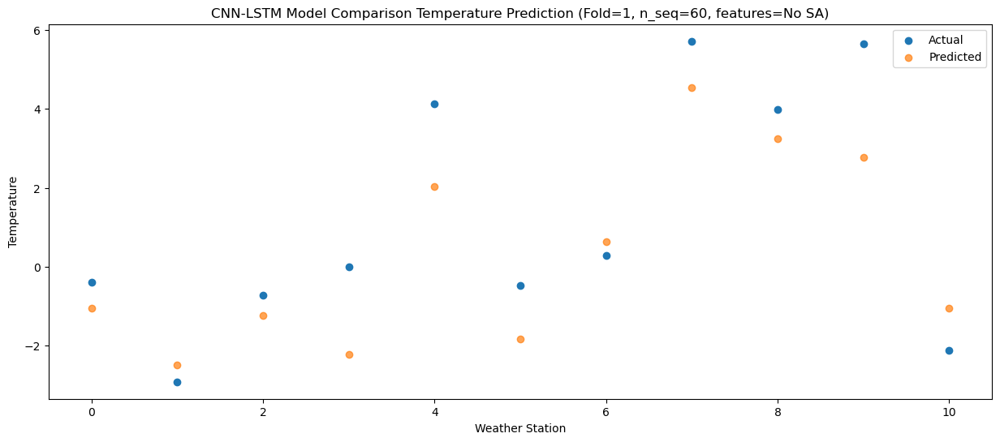

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   5.727387
1                 1    3.08   4.297924
2                 2    6.38   5.538603
3                 3    7.63   4.568454
4                 4   12.18   8.808135
5                 5    6.87   4.956271
6                 6    5.95   7.427662
7                 7   12.64  11.318070
8                 8   11.82  10.025733
9                 9   13.61   9.554855
10               10    2.19   5.725377


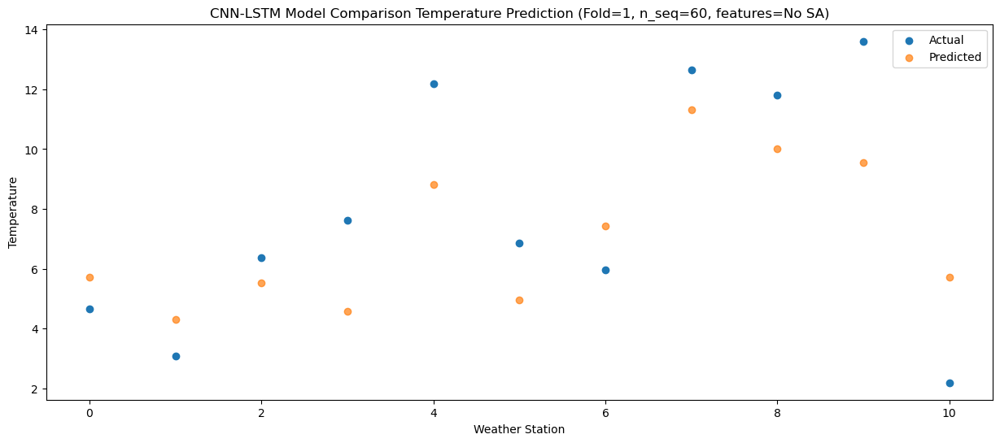

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.616930
1                 1    4.30   5.187002
2                 2    5.41   6.427070
3                 3    7.51   5.457053
4                 4   11.92   9.697026
5                 5    9.66   5.846800
6                 6    7.58   8.316962
7                 7   13.78  12.207014
8                 8   13.20  10.916730
9                 9   15.92  10.446623
10               10    3.82   6.616689


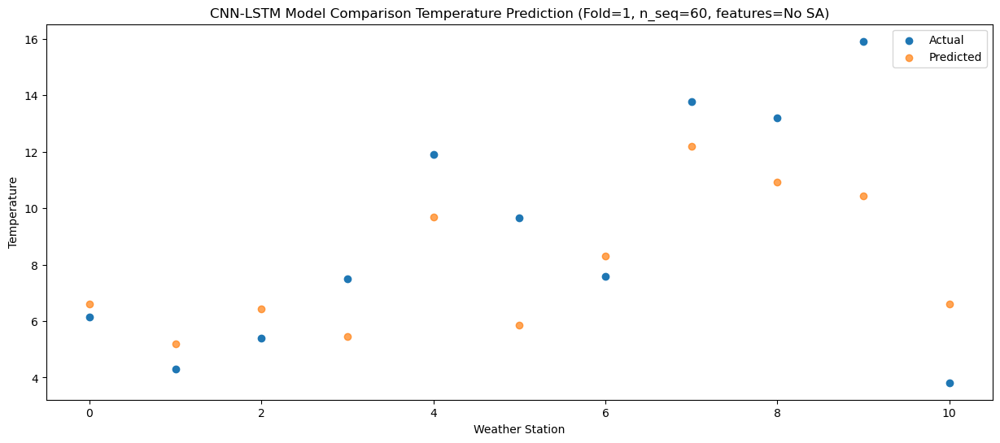

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  11.593713
1                 1    7.65  10.164100
2                 2    9.56  11.404577
3                 3   11.26  10.434474
4                 4   15.72  14.674249
5                 5   14.85  10.822914
6                 6   10.36  13.293910
7                 7   18.28  17.184195
8                 8   19.31  15.892523
9                 9   22.45  15.421895
10               10    9.28  11.592275


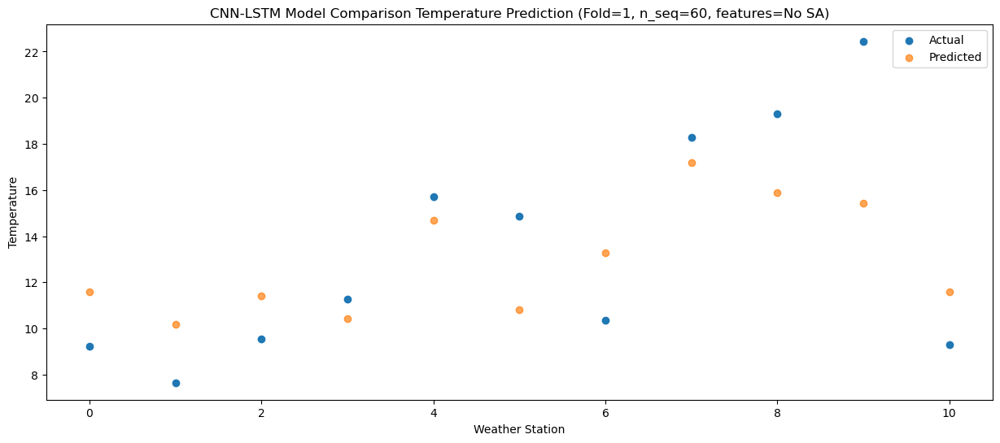

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  17.074677
1                 1   12.00  15.644656
2                 2   13.79  16.884615
3                 3   14.04  15.914624
4                 4   18.75  20.154648
5                 5   17.57  16.304719
6                 6   15.03  18.774654
7                 7   23.84  22.664640
8                 8   24.42  21.374726
9                 9   28.83  20.904761
10               10   16.60  17.074743


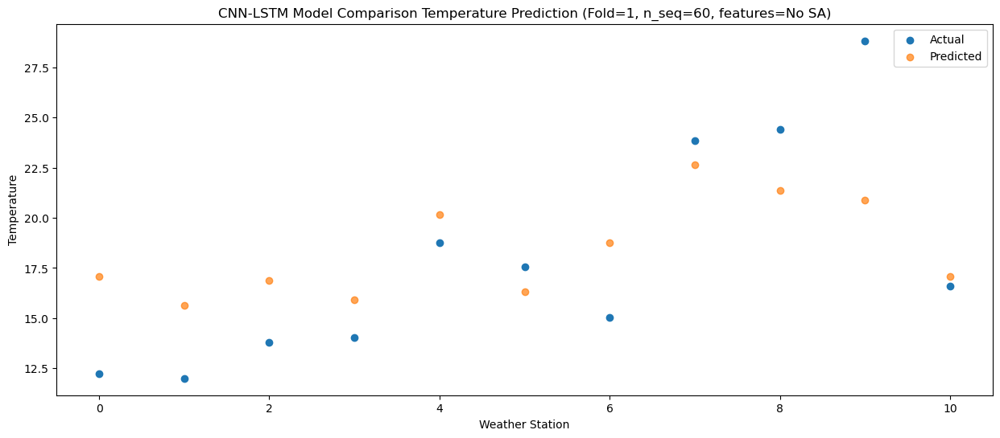

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  19.193181
1                 1   15.37  17.763270
2                 2   15.26  19.003366
3                 3   15.69  18.033346
4                 4   20.79  22.273301
5                 5   20.27  18.423012
6                 6   18.21  20.893221
7                 7   26.38  24.783285
8                 8   26.96  23.492907
9                 9   30.41  23.022774
10               10   20.47  19.192856


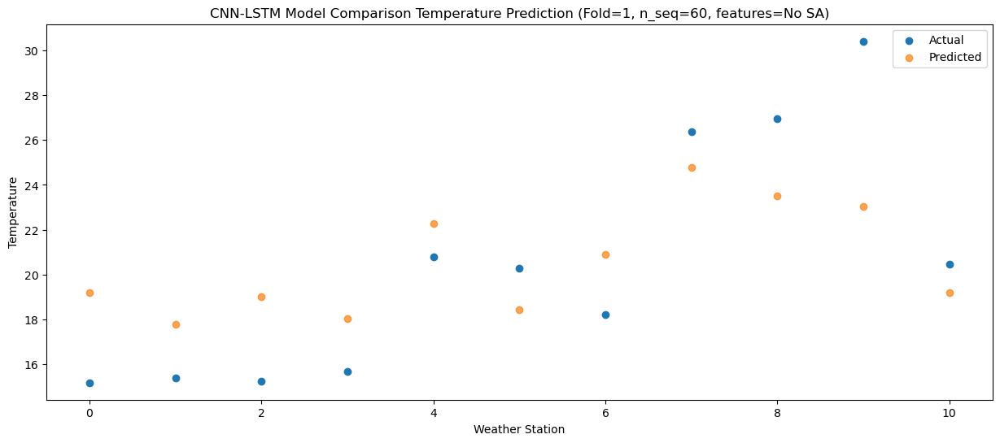

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  18.042844
1                 1   13.96  16.613192
2                 2   15.25  17.853622
3                 3   15.93  16.883529
4                 4   21.03  21.123328
5                 5   20.12  17.272131
6                 6   16.58  19.743021
7                 7   24.36  23.633275
8                 8   26.03  22.341764
9                 9   29.18  21.871203
10               10   18.28  18.041539


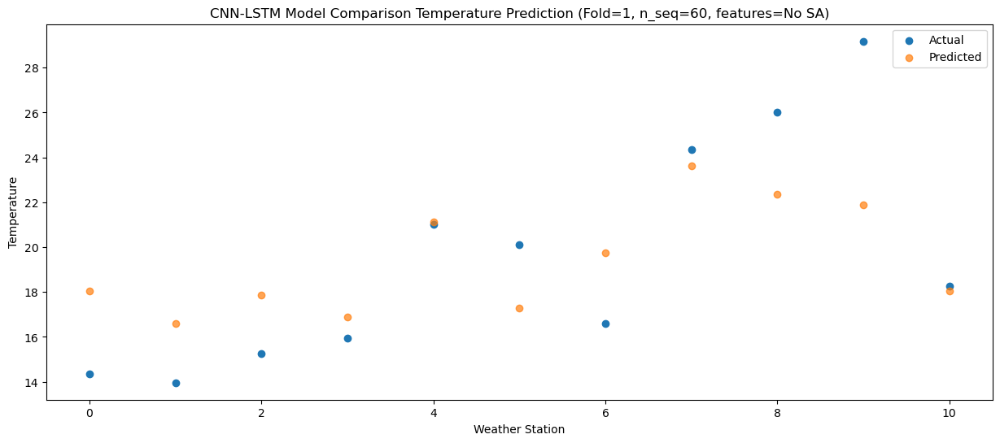

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  13.719502
1                 1   10.42  12.290121
2                 2   12.45  13.530909
3                 3   12.52  12.560734
4                 4   17.45  16.800367
5                 5   12.59  12.948211
6                 6   13.16  15.419821
7                 7   21.06  19.310279
8                 8   19.38  18.017572
9                 9   22.43  17.546557
10               10   13.75  13.717163


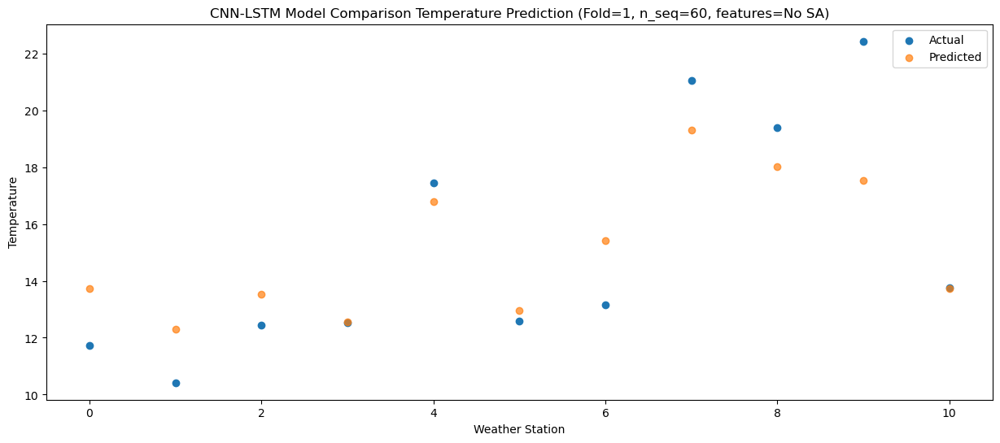

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   7.824265
1                 1    6.70   6.395013
2                 2    8.10   7.635978
3                 3    7.98   6.665764
4                 4   12.51  10.905315
5                 5    9.75   7.052696
6                 6    9.67   9.524655
7                 7   14.29  13.415212
8                 8   13.20  12.121923
9                 9   15.83  11.650688
10               10    8.21   7.821424


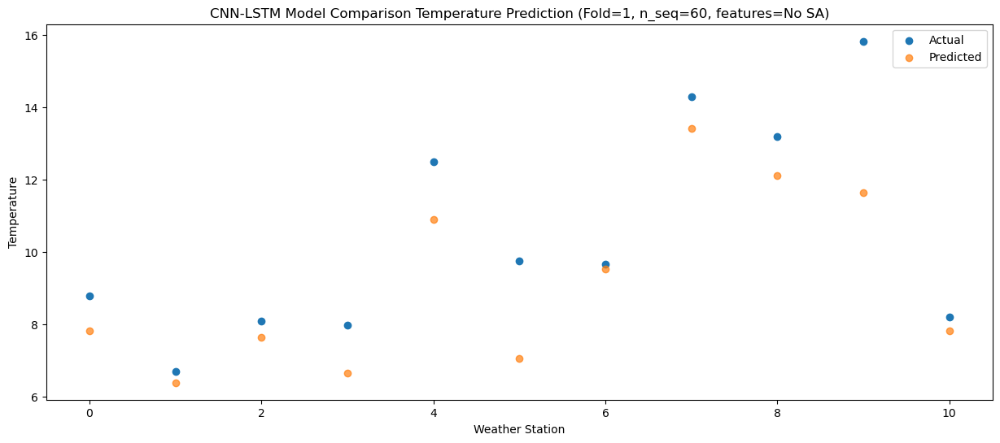

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   4.501396
1                 1    2.60   3.071899
2                 2    3.30   4.312540
3                 3    5.08   3.342396
4                 4    9.41   7.582102
5                 5    6.03   3.730349
6                 6    5.52   6.201659
7                 7   10.62  10.092029
8                 8   10.32   8.799820
9                 9   12.65   8.328992
10               10    4.01   4.499482


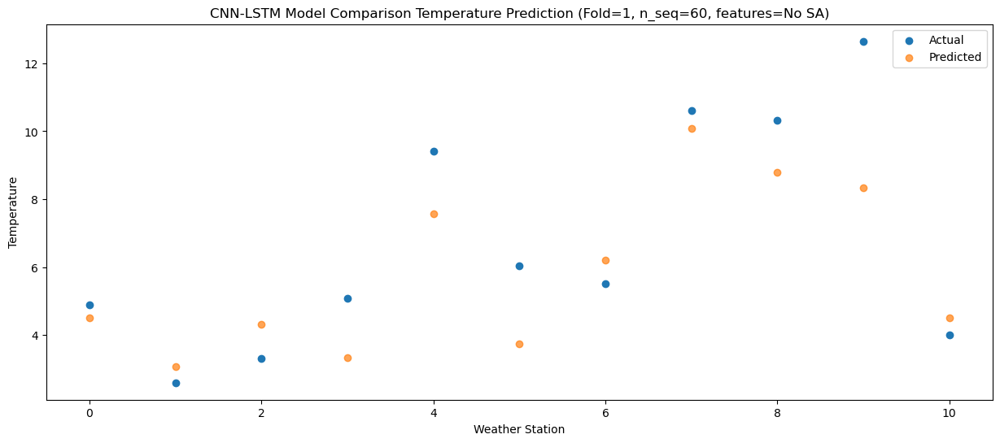

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -2.112923
1                 1   -4.29  -3.542574
2                 2   -3.76  -2.302134
3                 3   -1.10  -3.272236
4                 4    3.05   0.967566
5                 5   -0.72  -2.883638
6                 6   -1.69  -0.412741
7                 7    4.02   3.477512
8                 8    3.64   2.185988
9                 9    5.38   1.715414
10               10   -3.00  -2.114247


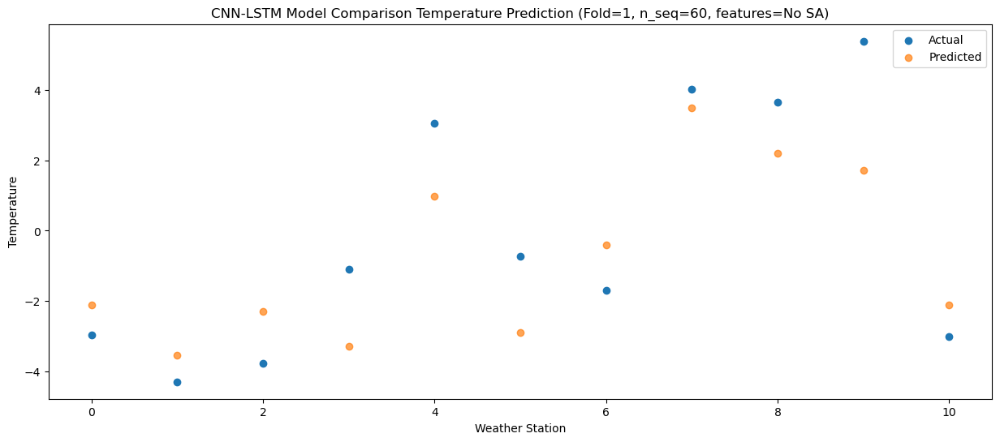

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -3.422789
1                 1   -4.49  -4.852308
2                 2   -3.34  -3.611696
3                 3   -1.20  -4.581835
4                 4    3.04  -0.342109
5                 5   -2.23  -4.193766
6                 6   -1.89  -1.722535
7                 7    3.71   2.167817
8                 8    3.29   0.875721
9                 9    5.49   0.404940
10               10   -4.84  -3.424594


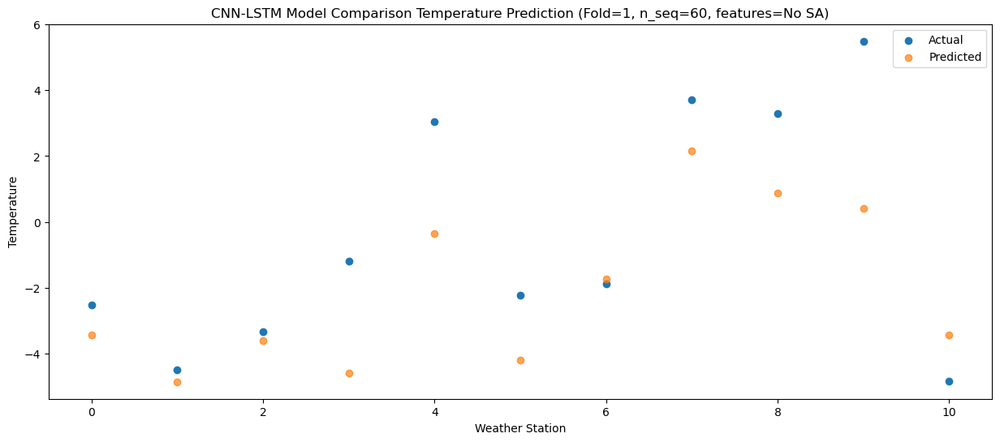

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -6.303240
1                 1   -3.83  -7.732494
2                 2   -2.85  -6.491540
3                 3   -2.79  -7.461755
4                 4    1.34  -3.222191
5                 5   -1.85  -7.074780
6                 6   -1.11  -4.602850
7                 7    0.71  -0.712300
8                 8   -1.49  -2.005557
9                 9    1.12  -2.476778
10               10   -5.80  -6.306053


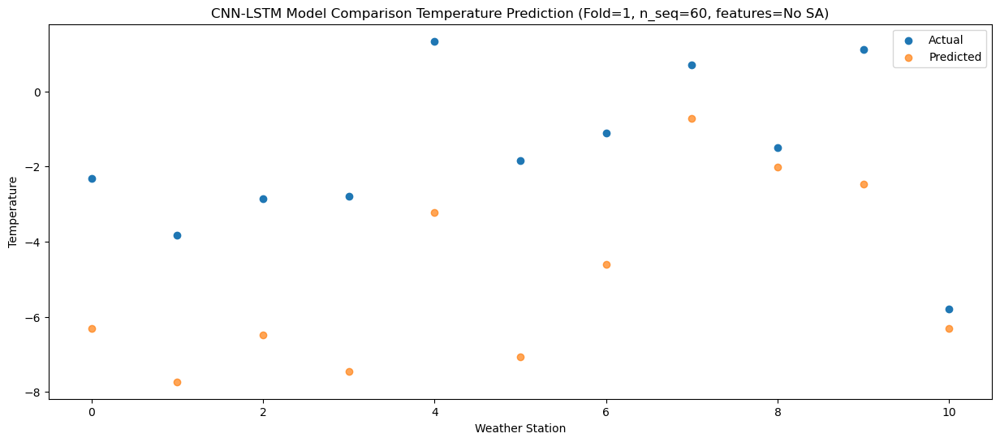

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   3.415056
1                 1    2.94   1.984928
2                 2    4.21   3.224734
3                 3    4.58   2.254768
4                 4    8.95   6.494880
5                 5    5.49   2.645387
6                 6    5.17   5.114990
7                 7   12.03   9.004877
8                 8   11.07   7.715487
9                 9   11.83   7.245710
10               10    1.42   3.415576


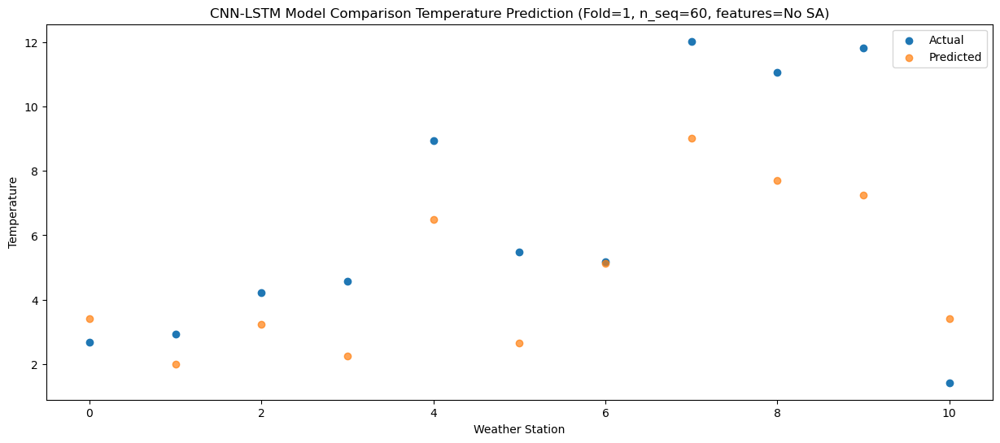

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   5.911510
1                 1    5.08   4.481807
2                 2    5.61   5.722173
3                 3    6.92   4.752082
4                 4   11.25   8.991932
5                 5    7.76   5.140936
6                 6    7.74   7.611674
7                 7   13.74  11.501875
8                 8   12.87  10.210609
9                 9   15.59   9.740116
10               10    6.07   5.910408


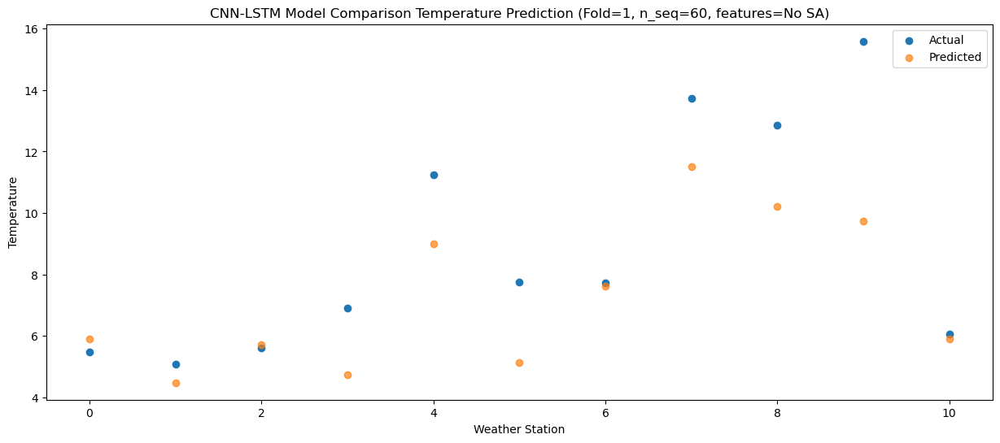

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  10.292878
1                 1    8.81   8.863178
2                 2    9.73  10.103554
3                 3   10.81   9.133463
4                 4   15.37  13.373311
5                 5   13.35   9.522286
6                 6   11.51  11.993042
7                 7   18.40  15.883247
8                 8   17.68  14.591949
9                 9   20.14  14.121446
10               10   10.61  10.291743


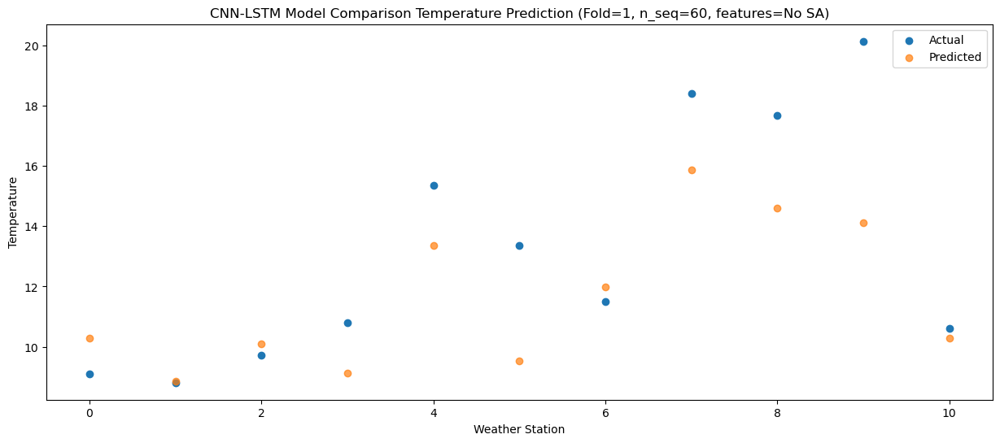

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  16.010744
1                 1   12.95  14.581078
2                 2   13.61  15.821498
3                 3   14.70  14.851398
4                 4   18.84  19.091226
5                 5   17.62  15.240076
6                 6   15.52  17.710925
7                 7   24.48  21.601154
8                 8   23.71  20.309706
9                 9   27.25  19.839148
10               10   16.70  16.009474


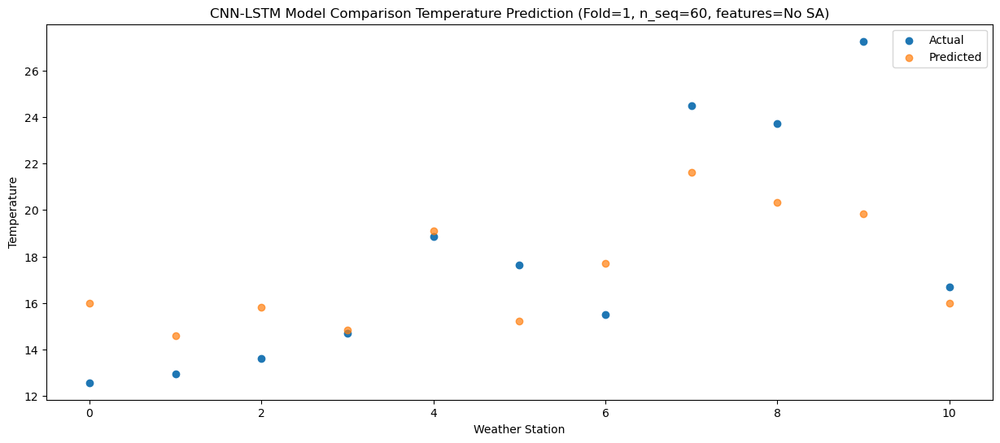

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  16.642859
1                 1   14.33  15.213267
2                 2   14.38  16.453782
3                 3   14.58  15.483662
4                 4   18.93  19.723443
5                 5   16.96  15.872034
6                 6   16.88  18.343080
7                 7   25.47  22.233364
8                 8   25.22  20.941590
9                 9   27.92  20.470912
10               10   18.93  16.641309


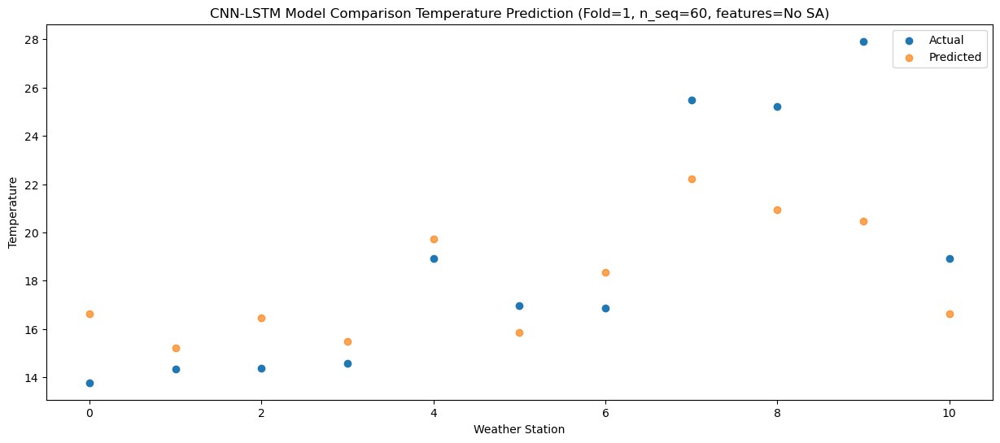

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  17.274548
1                 1   14.60  15.844639
2                 2   15.04  17.084729
3                 3   15.55  16.114693
4                 4   19.90  20.354678
5                 5   16.37  16.504408
6                 6   17.14  18.974602
7                 7   26.69  22.864638
8                 8   25.61  21.574295
9                 9   27.77  21.104150
10               10   18.71  17.274227


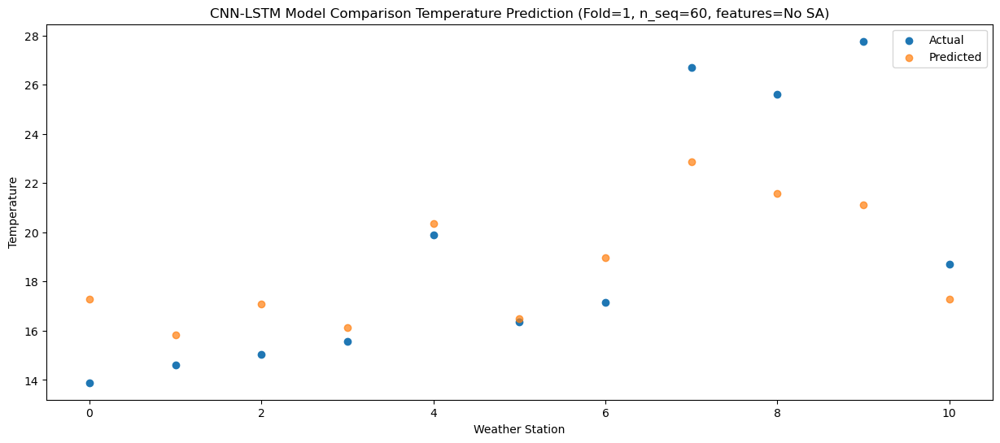

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  14.151729
1                 1   10.86  12.722579
2                 2   12.02  13.963659
3                 3   12.54  12.993405
4                 4   16.32  17.232925
5                 5   16.01  13.379986
6                 6   13.81  15.852183
7                 7   22.98  19.742788
8                 8   23.10  18.449111
9                 9   25.82  17.977709
10               10   15.01  14.148536


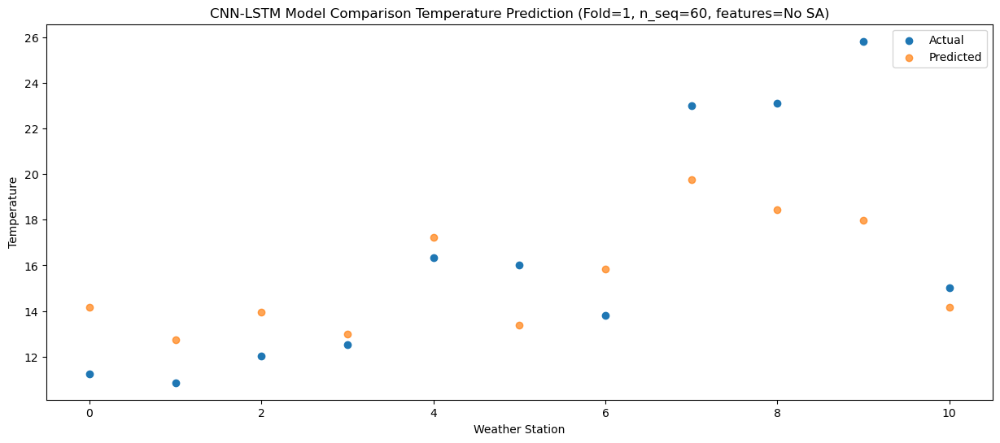

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54   9.661712
1                 1    7.08   8.232051
2                 2    8.24   9.472466
3                 3    9.85   8.502355
4                 4   13.28  12.742192
5                 5   11.69   8.891051
6                 6    9.86  11.361898
7                 7   17.78  15.252117
8                 8   16.85  13.960689
9                 9   18.38  13.490131
10               10   10.59   9.660454


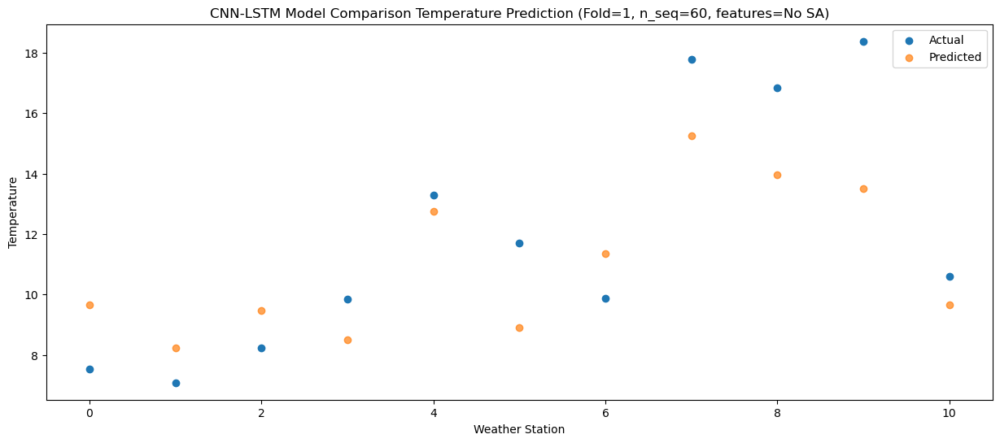

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   1.466898
1                 1   -0.58   0.037913
2                 2    0.50   1.279203
3                 3    2.69   0.308904
4                 4    5.73   4.548324
5                 5    5.22   0.694810
6                 6    2.26   3.167440
7                 7    8.48   7.058167
8                 8    9.10   5.763769
9                 9   12.13   5.292094
10               10    1.27   1.463082


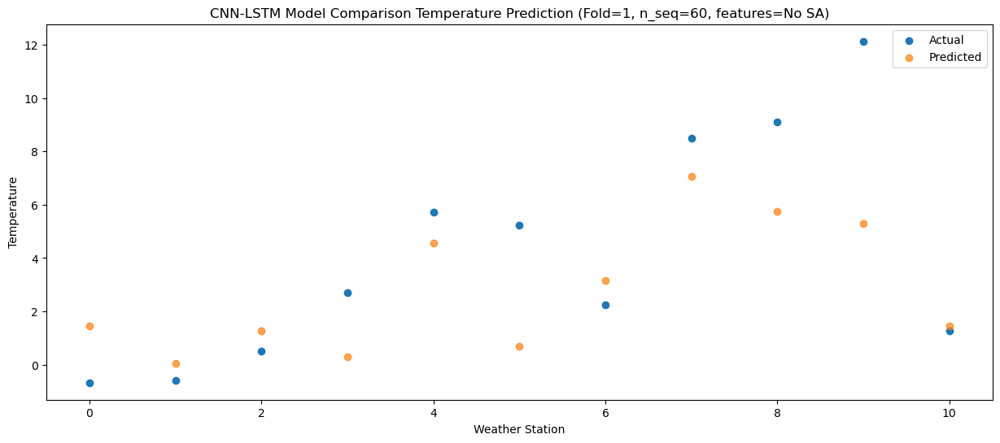

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   2.322705
1                 1    1.05   0.893990
2                 2    3.10   2.135630
3                 3    6.06   1.165253
4                 4    9.61   5.404505
5                 5    5.48   1.550054
6                 6    3.78   4.023392
7                 7   10.89   7.914319
8                 8    8.29   6.618743
9                 9   10.52   6.146620
10               10    0.50   2.317876


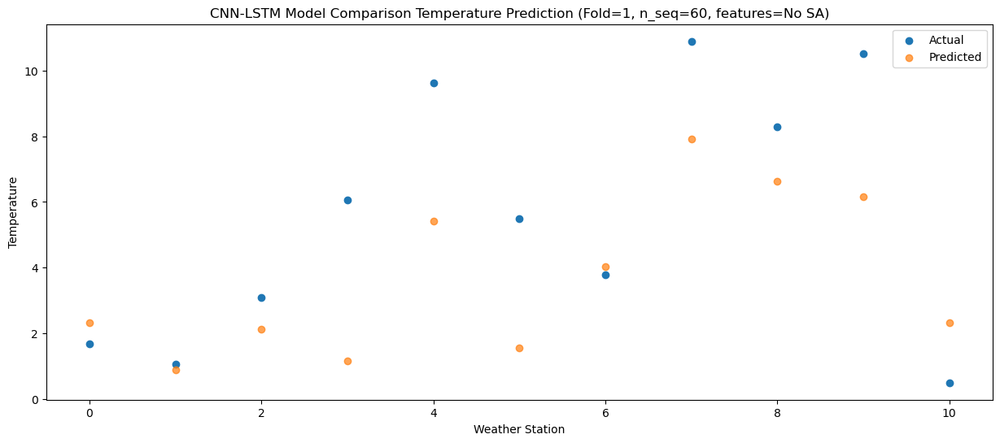

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -5.791831
1                 1   -5.68  -7.220399
2                 2   -3.79  -5.978566
3                 3   -1.99  -6.948986
4                 4    1.13  -2.709822
5                 5   -1.84  -6.564796
6                 6   -2.61  -4.091068
7                 7    2.06  -0.200029
8                 8    0.67  -1.496255
9                 9    3.60  -1.968619
10               10   -6.52  -5.797220


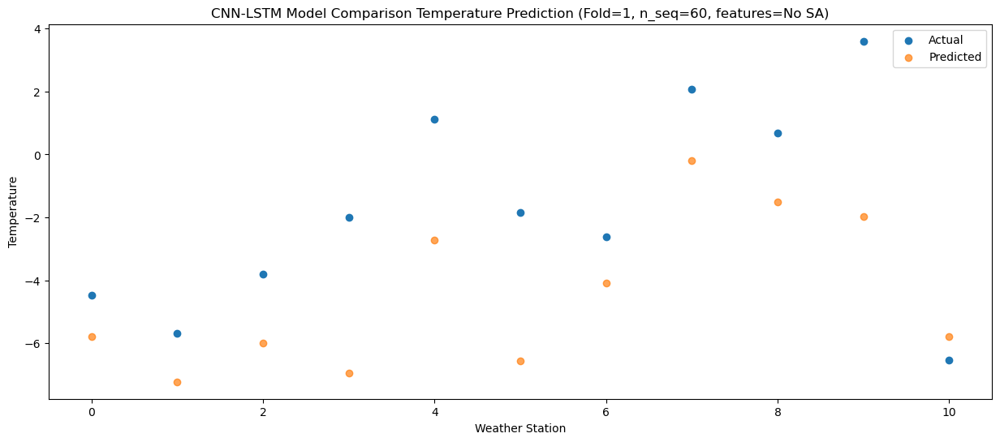

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -4.207543
1                 1   -1.45  -5.636226
2                 2   -0.44  -4.394548
3                 3   -2.46  -5.364932
4                 4    0.82  -1.125698
5                 5   -1.95  -4.980259
6                 6    1.20  -2.506842
7                 7    4.11   1.384110
8                 8    1.65   0.088400
9                 9    3.66  -0.383777
10               10   -2.62  -4.212491


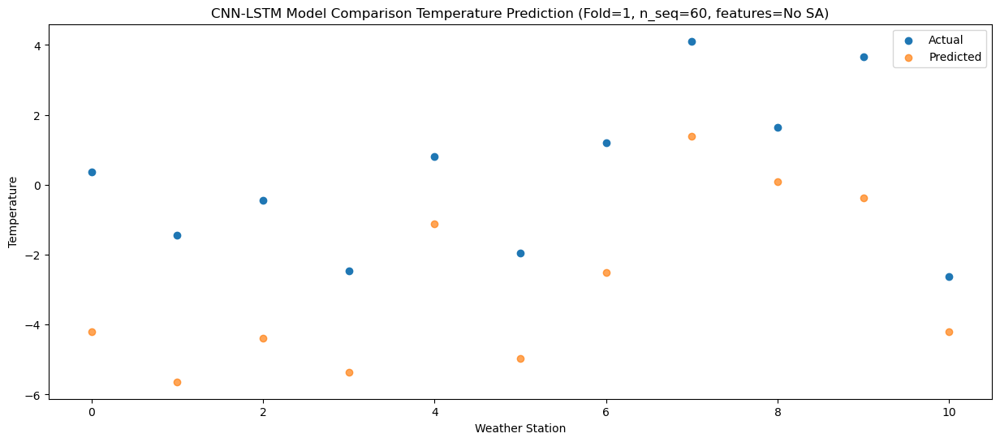

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   1.673440
1                 1    2.12   0.244698
2                 2    3.56   1.486292
3                 3    3.38   0.515924
4                 4    6.60   4.755198
5                 5    5.00   0.900859
6                 6    5.04   3.374113
7                 7   10.06   7.265017
8                 8    8.90   5.969574
9                 9   10.59   5.497505
10               10    1.94   1.668730


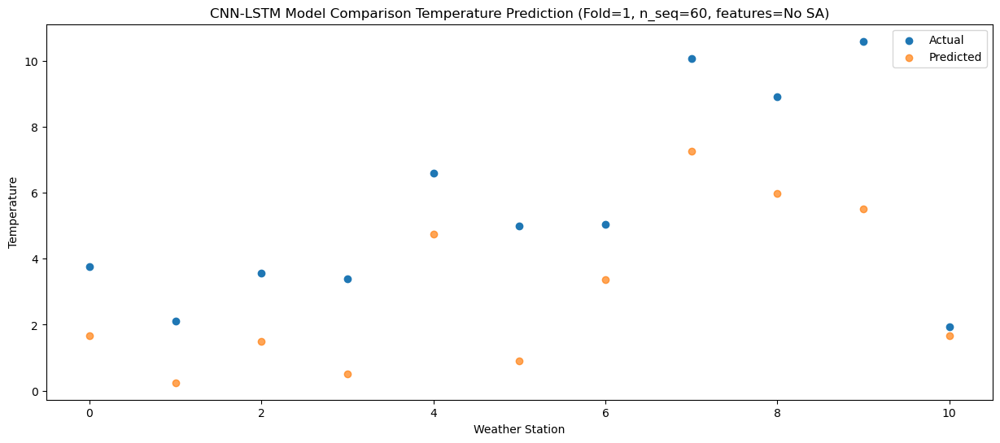

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   6.529941
1                 1    5.12   5.100857
2                 2    7.15   6.342016
3                 3    9.38   5.371740
4                 4   12.87   9.611226
5                 5   11.91   5.758065
6                 6    7.80   8.230432
7                 7   15.25  12.121086
8                 8   16.01  10.827117
9                 9   17.07  10.355603
10               10    5.29   6.526503


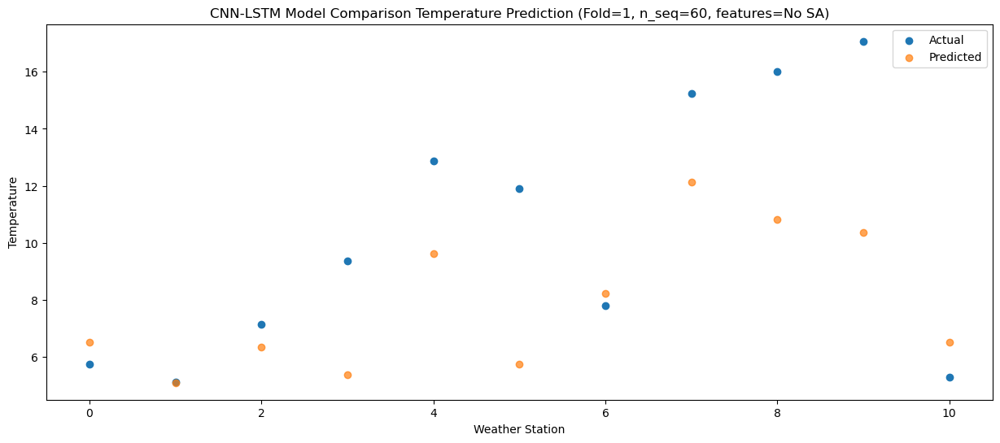

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  12.601340
1                 1   11.00  11.171743
2                 2   12.51  12.412243
3                 3   13.81  11.442106
4                 4   17.49  15.681909
5                 5   17.31  11.830536
6                 6   13.72  14.301565
7                 7   20.72  18.191827
8                 8   21.37  16.900110
9                 9   22.52  16.429435
10               10   12.27  12.599838


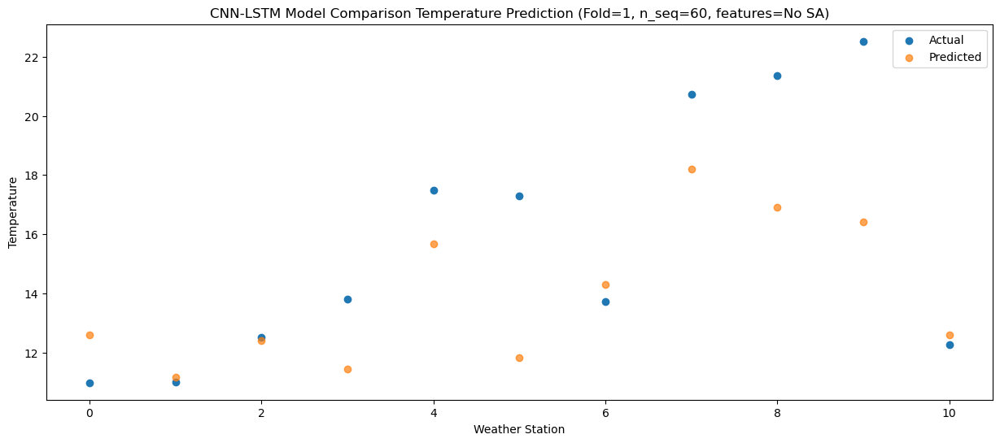

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  16.418077
1                 1   14.97  14.988902
2                 2   15.48  16.229953
3                 3   16.81  15.259694
4                 4   20.86  19.499237
5                 5   19.37  15.646375
6                 6   17.30  18.118522
7                 7   24.78  22.009102
8                 8   25.66  20.715523
9                 9   27.09  20.244145
10               10   16.66  16.414964


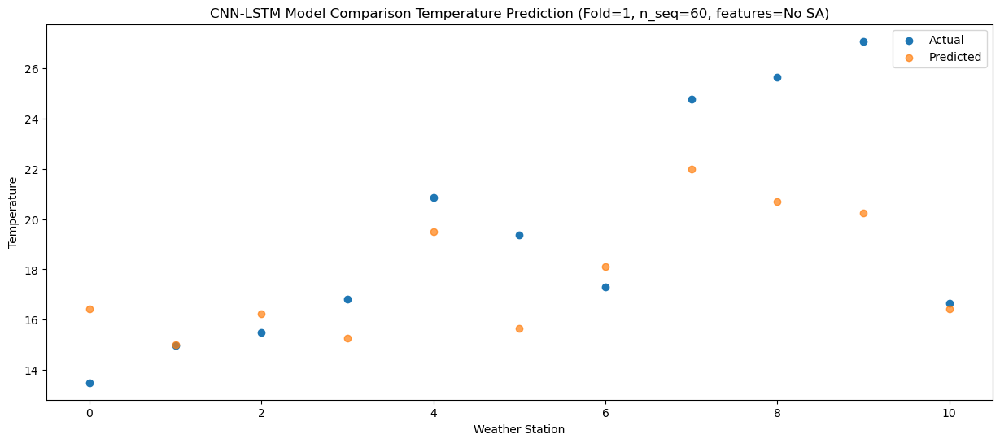

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  18.520315
1                 1   15.47  17.091420
2                 2   16.19  18.332840
3                 3   17.75  17.362503
4                 4   21.95  21.601872
5                 5   20.29  17.748016
6                 6   18.04  20.220908
7                 7   28.91  24.111698
8                 8   29.81  22.816875
9                 9   30.69  22.345034
10               10   20.60  18.516127


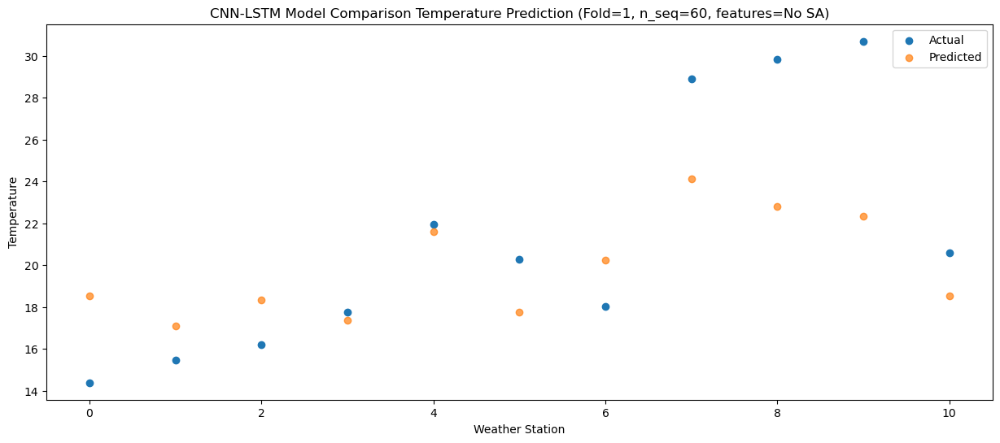

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  16.493894
1                 1   14.01  15.065156
2                 2   14.58  16.306779
3                 3   16.11  15.336397
4                 4   19.94  19.575671
5                 5   17.44  15.721270
6                 6   16.54  18.194569
7                 7   26.04  22.085479
8                 8   27.14  20.789969
9                 9   27.86  20.317873
10               10   20.06  16.489124


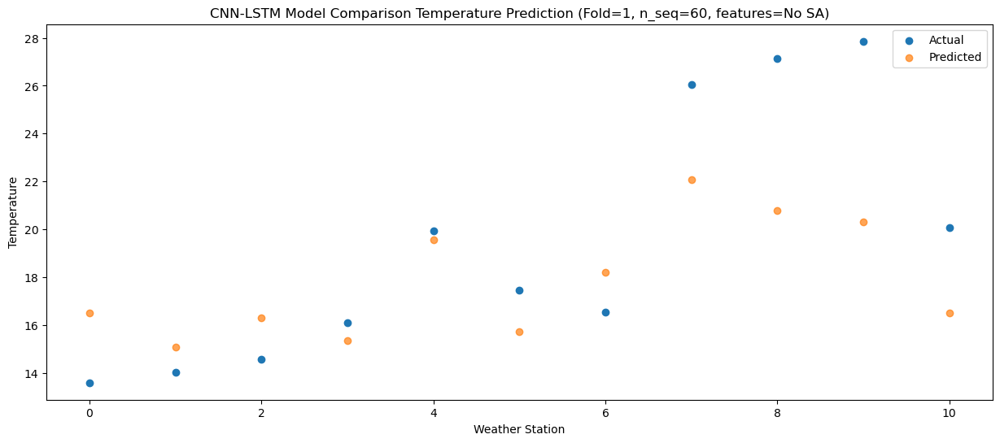

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  12.931980
1                 1   10.92  11.502708
2                 2   12.19  12.743625
3                 3   13.34  11.773395
4                 4   16.76  16.013004
5                 5   14.39  12.160495
6                 6   13.65  14.632374
7                 7   22.20  18.522873
8                 8   23.31  17.229733
9                 9   25.45  16.758523
10               10   15.15  12.929253


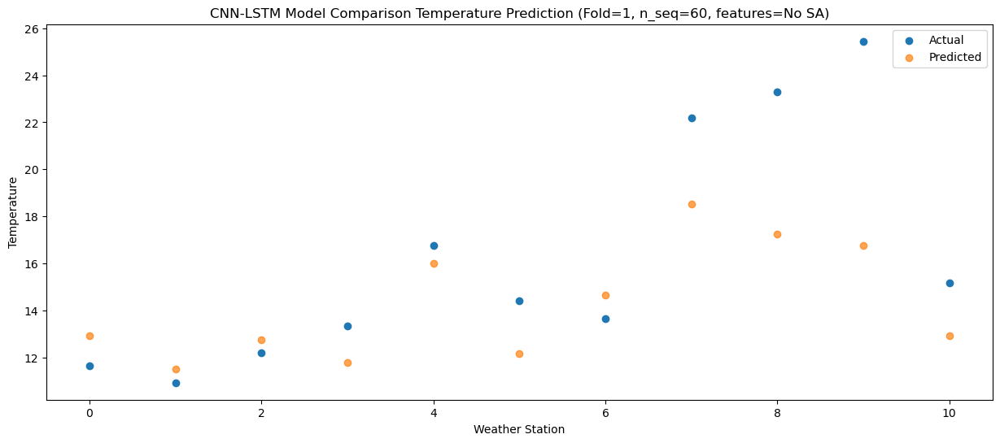

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08   7.054010
1                 1    4.58   5.624530
2                 2    5.50   6.865181
3                 3    7.78   5.895008
4                 4   11.37  10.134745
5                 5    8.31   6.282960
6                 6    7.31   8.754297
7                 7   15.53  12.644641
8                 8   15.08  11.352402
9                 9   16.91  10.881534
10               10    7.05   7.052061


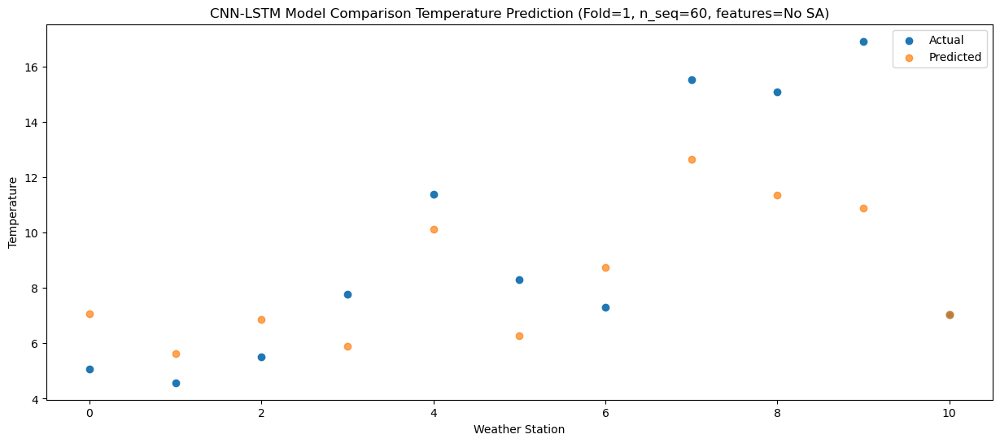

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   1.112615
1                 1    1.58  -0.316559
2                 2    2.18   0.924497
3                 3    2.73  -0.045763
4                 4    6.37   4.193783
5                 5    1.35   0.340908
6                 6    4.42   2.813064
7                 7    8.93   6.703640
8                 8    7.23   5.410039
9                 9    7.92   4.938659
10               10    3.54   1.109491


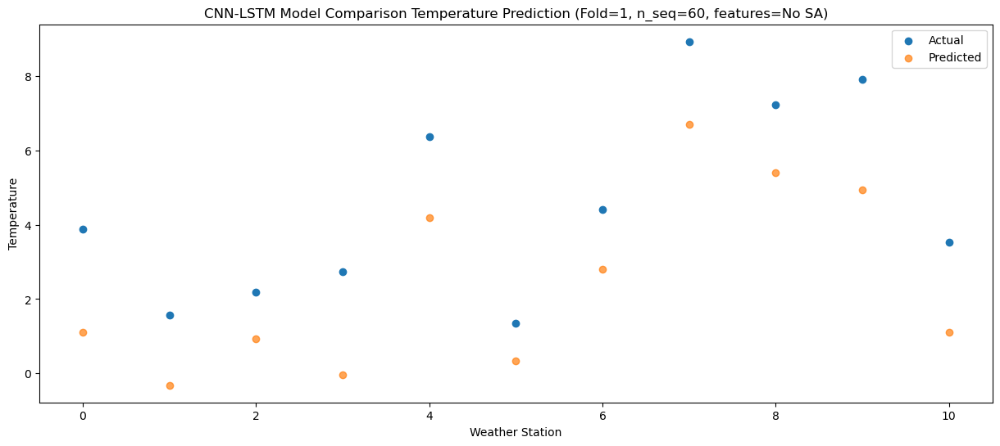

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88  -2.906789
1                 1   -4.23  -4.335512
2                 2   -0.98  -3.093866
3                 3    0.64  -4.064255
4                 4    4.35   0.175012
5                 5    0.23  -3.679451
6                 6   -1.59  -1.206105
7                 7    5.19   2.684814
8                 8    3.60   1.389225
9                 9    5.57   0.917100
10               10   -3.61  -2.911624


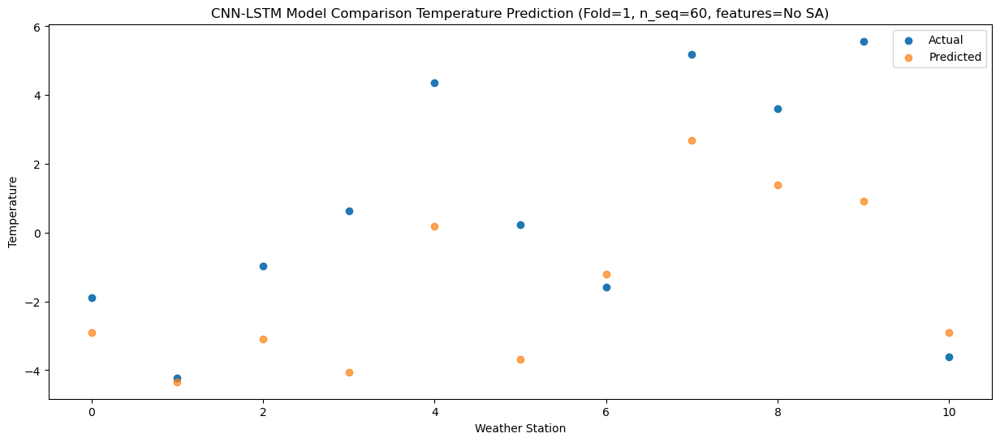

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23  -2.132869
1                 1   -2.04  -3.561825
2                 2    0.02  -2.320476
3                 3    1.35  -3.290802
4                 4    4.83   0.948605
5                 5    0.69  -2.905047
6                 6    0.54  -0.432308
7                 7    6.38   3.458439
8                 8    4.46   2.163859
9                 9    5.85   1.692114
10               10   -0.65  -2.136837


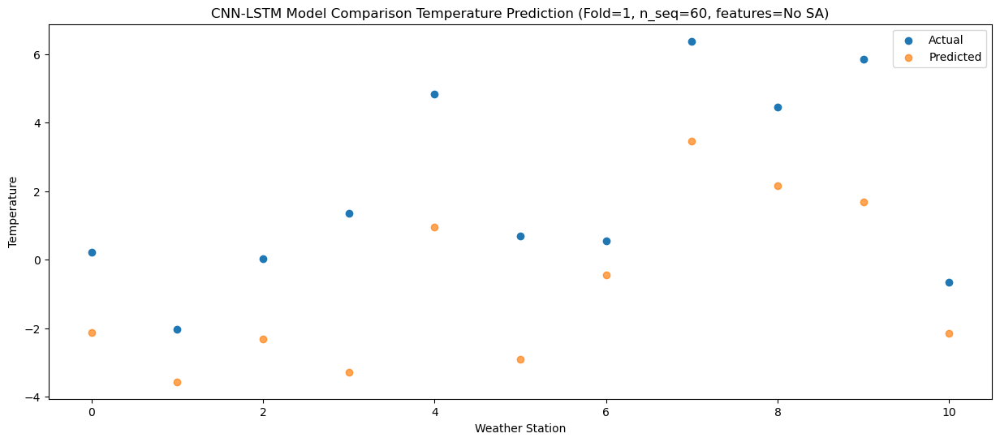

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14  -1.614362
1                 1    1.33  -3.043543
2                 2    2.61  -1.802496
3                 3    2.35  -2.772754
4                 4    6.01   1.466791
5                 5    0.83  -2.386059
6                 6    4.13   0.086079
7                 7    7.88   3.976656
8                 8    4.83   2.683072
9                 9    7.00   2.211700
10               10   -0.97  -1.617476


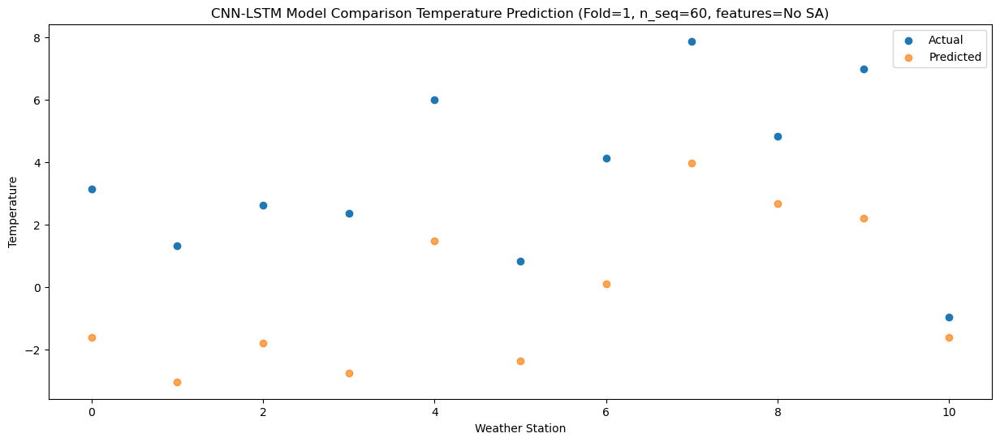

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   0.922524
1                 1    2.10  -0.506360
2                 2    4.04   0.735068
3                 3    6.18  -0.235270
4                 4    9.83   4.004092
5                 5    5.89   0.150205
6                 6    4.80   2.623118
7                 7   10.71   6.513924
8                 8    9.26   5.219041
9                 9   10.73   4.747184
10               10    0.15   0.918293


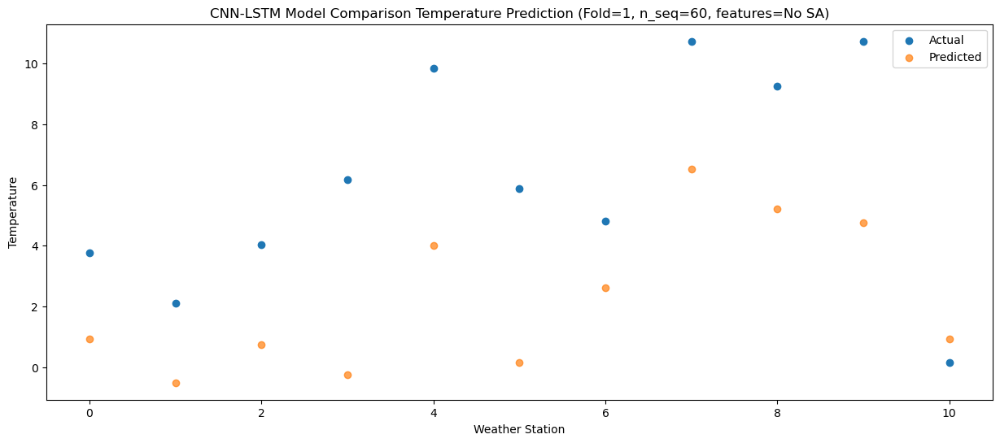

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28   5.404277
1                 1    5.37   3.974921
2                 2    6.73   5.215728
3                 3    7.02   4.245523
4                 4   10.79   8.485181
5                 5    9.05   4.632961
6                 6    8.06   7.104627
7                 7   15.11  10.995075
8                 8   13.59   9.702265
9                 9   16.08   9.231184
10               10    7.37   5.401828


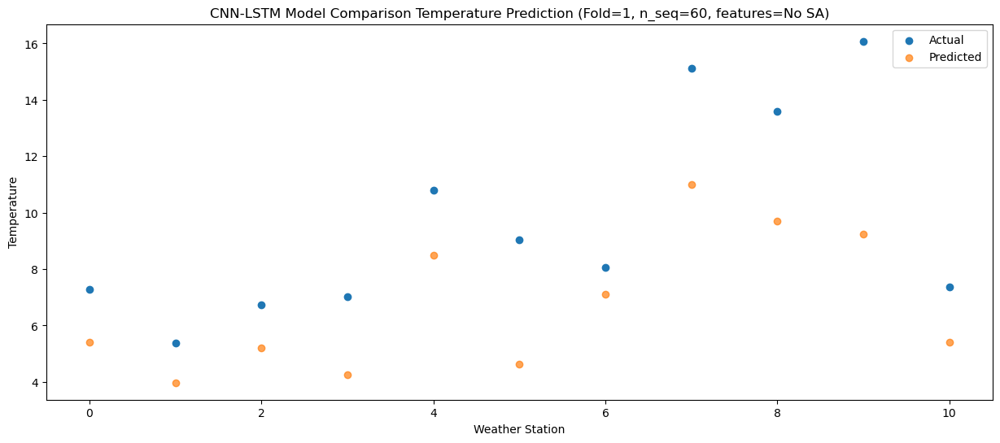

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  10.078255
1                 1    8.65   8.649150
2                 2    9.97   9.890290
3                 3   11.61   8.920014
4                 4   15.43  13.159512
5                 5   13.66   9.306398
6                 6   11.06  11.778737
7                 7   20.46  15.669377
8                 8   19.28  14.375445
9                 9   21.19  13.903942
10               10    9.93  10.074836


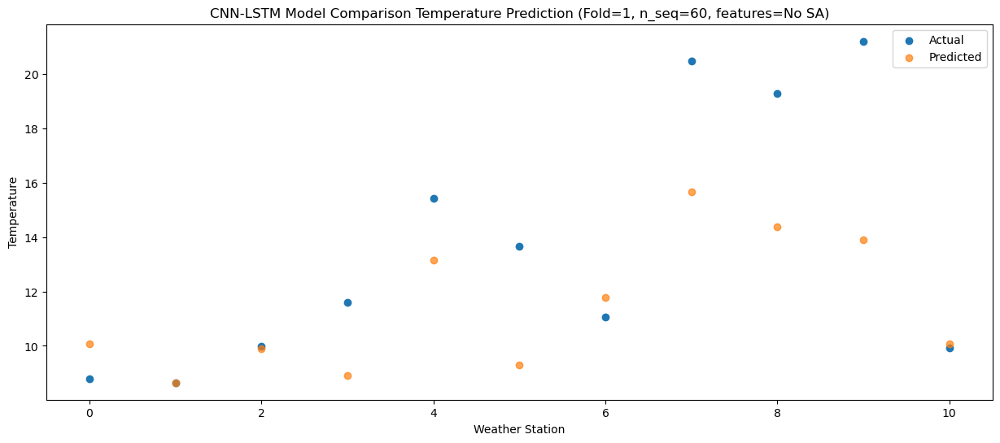

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  14.415491
1                 1   11.84  12.986071
2                 2   13.72  14.226796
3                 3   15.76  13.256612
4                 4   20.32  17.496307
5                 5   20.35  13.644295
6                 6   14.34  16.115808
7                 7   24.27  20.006215
8                 8   24.21  18.713653
9                 9   24.42  18.242667
10               10   14.30  14.413256


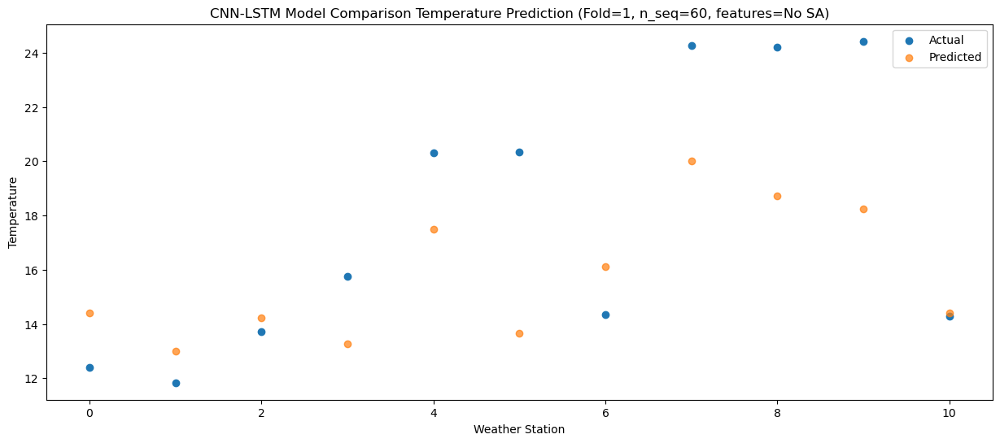

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  16.799589
1                 1   15.44  15.370941
2                 2   16.09  16.612671
3                 3   17.48  15.642271
4                 4   22.27  19.881491
5                 5   21.45  16.026755
6                 6   17.79  18.500313
7                 7   26.57  22.391301
8                 8   27.09  21.095332
9                 9   29.04  20.623066
10               10   19.44  16.794415


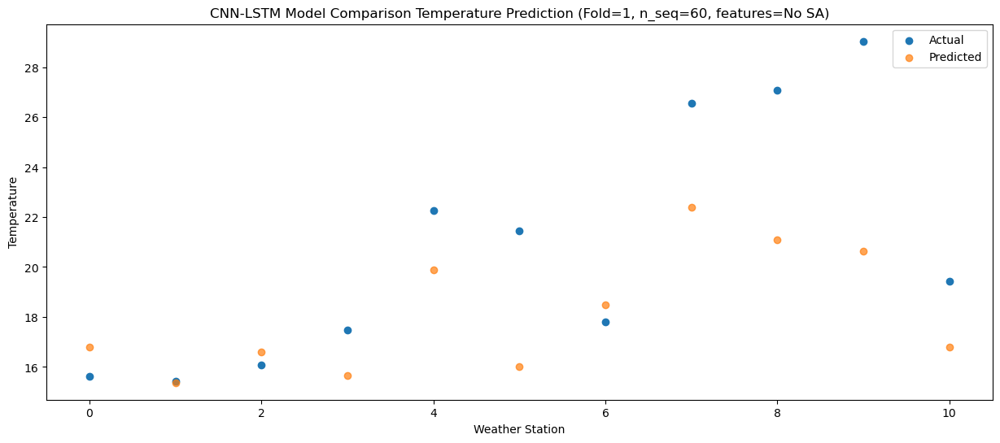

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  17.234682
1                 1   14.90  15.806246
2                 2   16.53  17.048243
3                 3   19.45  16.077789
4                 4   23.70  20.316879
5                 5   20.64  16.461407
6                 6   17.37  18.935516
7                 7   27.07  22.826662
8                 8   28.90  21.529774
9                 9   29.44  21.057163
10               10   17.70  17.228719


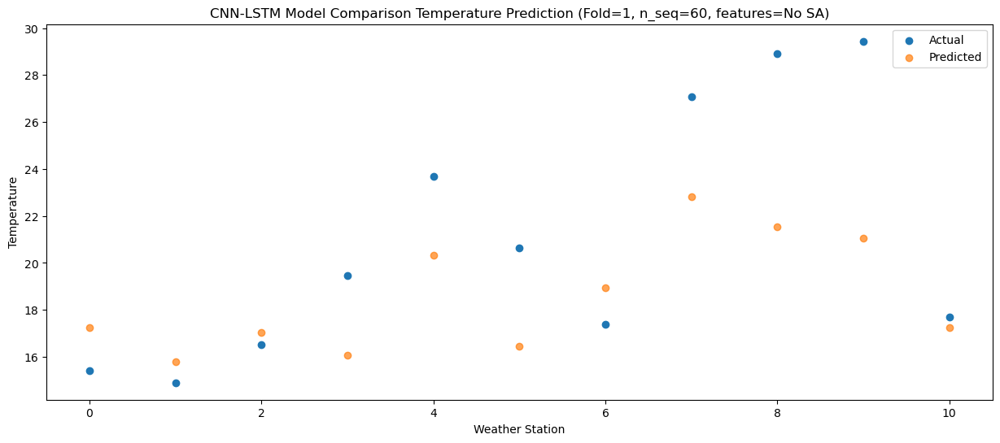

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  13.563644
1                 1   11.39  12.135567
2                 2   13.57  13.378032
3                 3   16.37  12.407478
4                 4   19.85  16.646346
5                 5   18.36  12.789610
6                 6   14.20  15.264669
7                 7   23.45  19.156086
8                 8   24.26  17.857616
9                 9   25.92  17.384408
10               10   14.51  13.556319


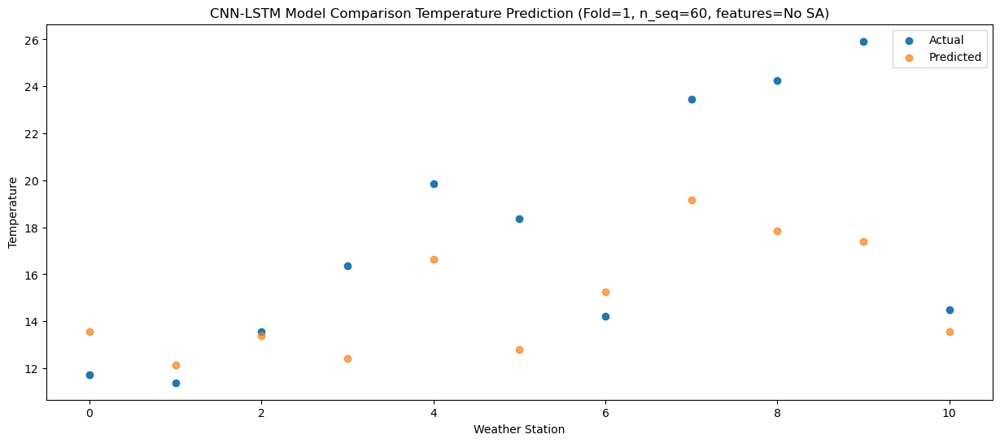

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.004965
1                 1    6.38   5.576569
2                 2    7.53   6.818617
3                 3    9.11   5.848151
4                 4   12.45  10.087217
5                 5   10.76   6.231607
6                 6    9.19   8.705821
7                 7   17.14  12.596999
8                 8   15.68  11.299937
9                 9   17.82  10.827253
10               10    9.16   6.998852


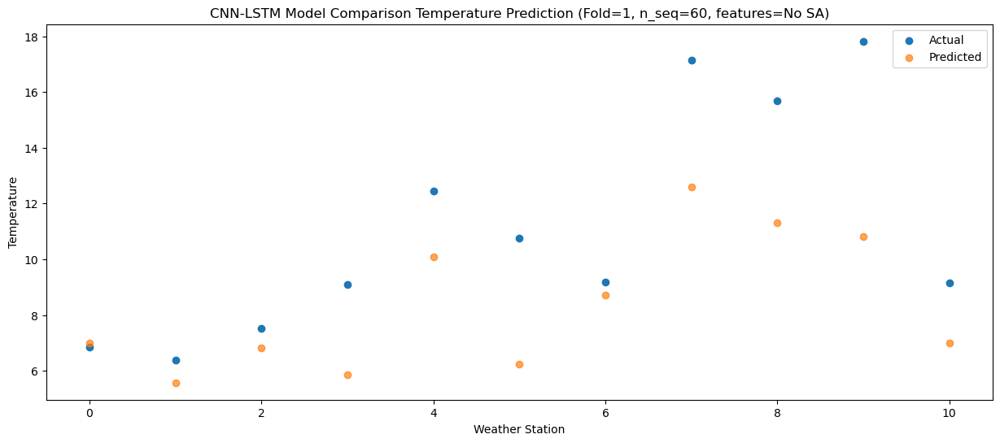

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   0.084247
1                 1    0.76  -1.344026
2                 2    0.97  -0.101816
3                 3    2.83  -1.072315
4                 4    6.25   3.166672
5                 5    4.10  -0.689372
6                 6    3.50   1.785168
7                 7    9.74   5.676439
8                 8    8.56   4.378833
9                 9   11.07   3.905943
10               10    1.22   0.077665


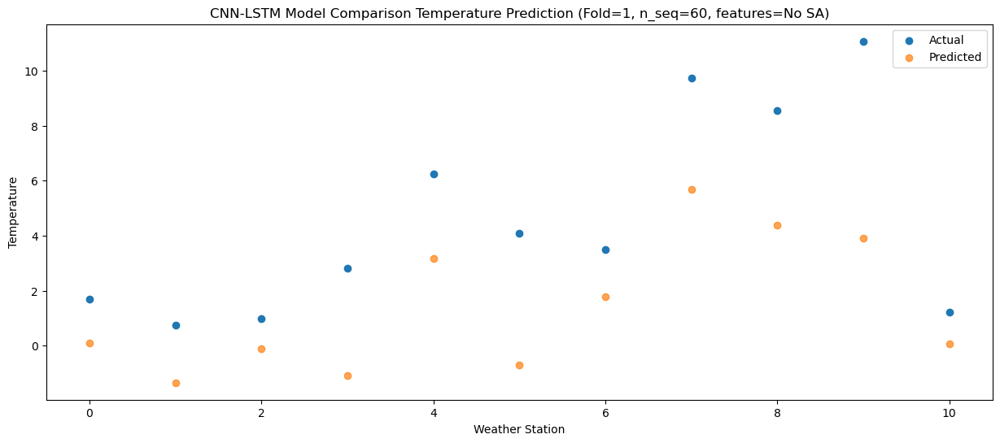

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33  -2.146447
1                 1   -2.38  -3.574620
2                 2   -1.81  -2.332283
3                 3    0.43  -3.302809
4                 4    4.35   0.936116
5                 5    1.74  -2.920279
6                 6    0.76  -0.445473
7                 7    6.82   3.445871
8                 8    5.71   2.147824
9                 9    7.24   1.674770
10               10   -0.47  -2.153408


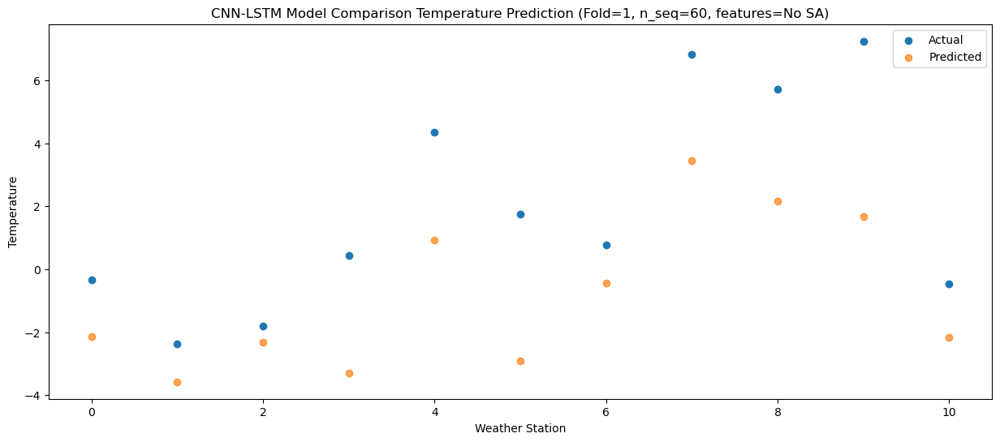

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -7.409756
1                 1   -5.66  -8.837500
2                 2   -4.89  -7.594606
3                 3   -2.99  -8.565252
4                 4    0.50  -4.326594
5                 5   -1.87  -8.184492
6                 6   -2.24  -5.708557
7                 7    0.89  -1.816888
8                 8   -0.12  -3.116818
9                 9    2.07  -3.590576
10               10   -4.37  -7.418336


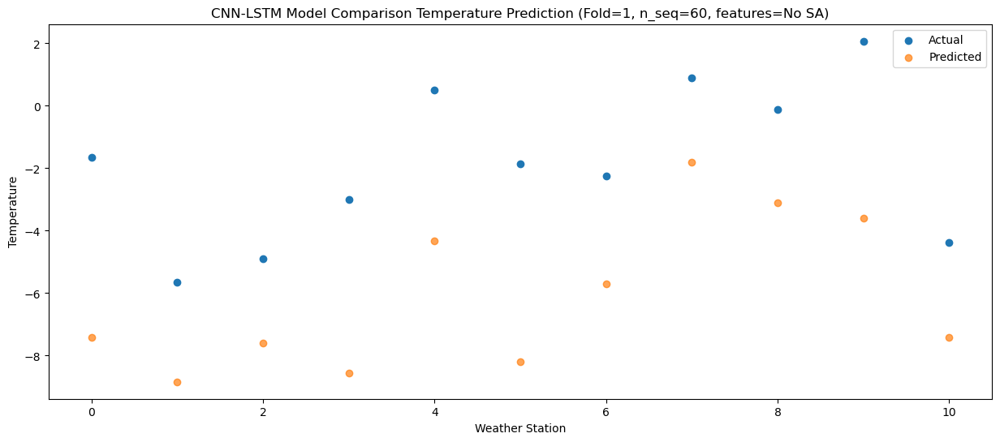

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27  -1.083148
1                 1   -0.58  -2.510607
2                 2    0.45  -1.267335
3                 3    3.32  -2.238060
4                 4    6.87   2.000421
5                 5    4.25  -1.858489
6                 6    1.97   0.618207
7                 7    9.89   4.510087
8                 8    7.83   3.208893
9                 9    9.78   2.734656
10               10   -2.42  -1.092817


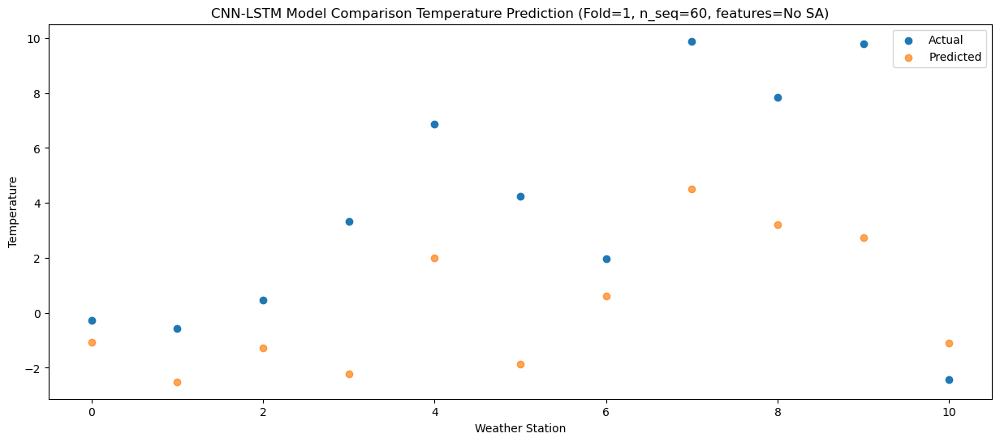

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   1.527046
1                 1    2.64   0.099778
2                 2    3.55   1.343300
3                 3    5.83   0.372525
4                 4    9.61   4.610885
5                 5    6.60   0.751295
6                 6    5.63   3.228499
7                 7   12.61   7.120522
8                 8   11.07   5.818485
9                 9   12.61   5.343935
10               10    1.98   1.516644


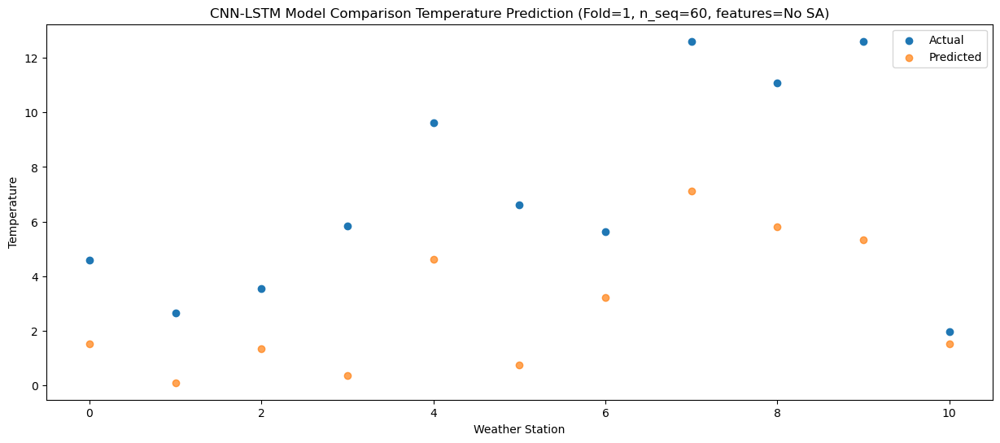

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98   5.178172
1                 1    6.31   3.750829
2                 2    6.89   4.994249
3                 3    9.31   4.023501
4                 4   13.17   8.261909
5                 5   11.40   4.402583
6                 6    9.10   6.879594
7                 7   16.65  10.771552
8                 8   15.75   9.469849
9                 9   17.68   8.995420
10               10    6.37   5.168057


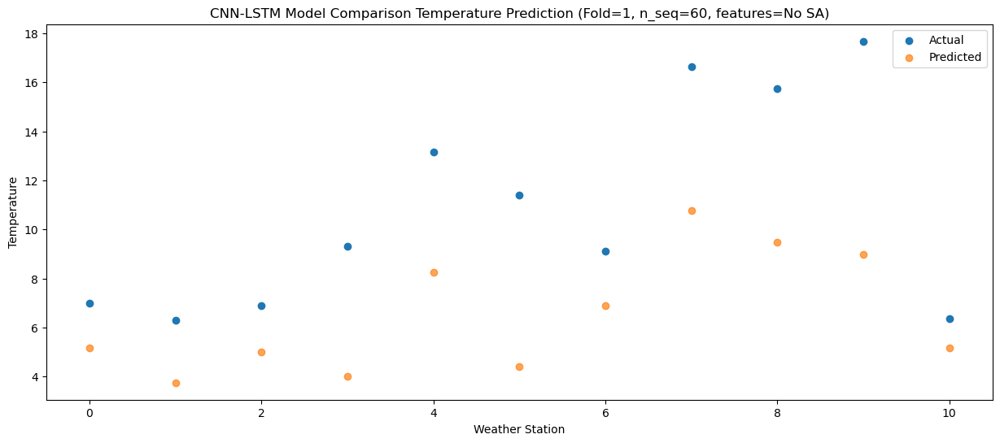

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  10.579309
1                 1   10.88   9.151750
2                 2   12.50  10.394891
3                 3   13.01   9.424206
4                 4   16.87  13.662745
5                 5   17.02   9.804174
6                 6   13.34  12.280619
7                 7   22.19  16.172417
8                 8   20.51  14.871652
9                 9   21.82  14.397575
10               10   11.96  10.570003


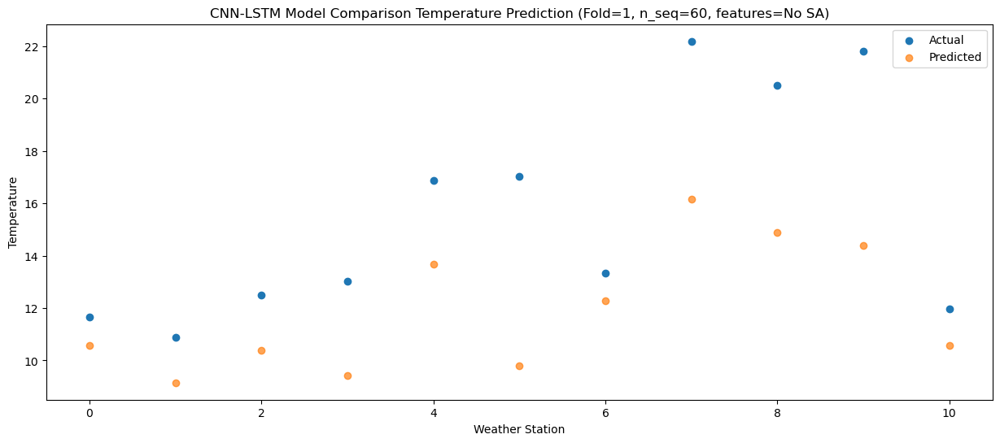

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  14.280860
1                 1   14.64  12.853906
2                 2   15.61  14.097829
3                 3   15.64  13.126970
4                 4   19.76  17.365139
5                 5   19.88  13.504451
6                 6   17.27  15.982481
7                 7   25.26  19.874735
8                 8   26.21  18.571322
9                 9   28.23  18.096249
10               10   18.07  14.269266


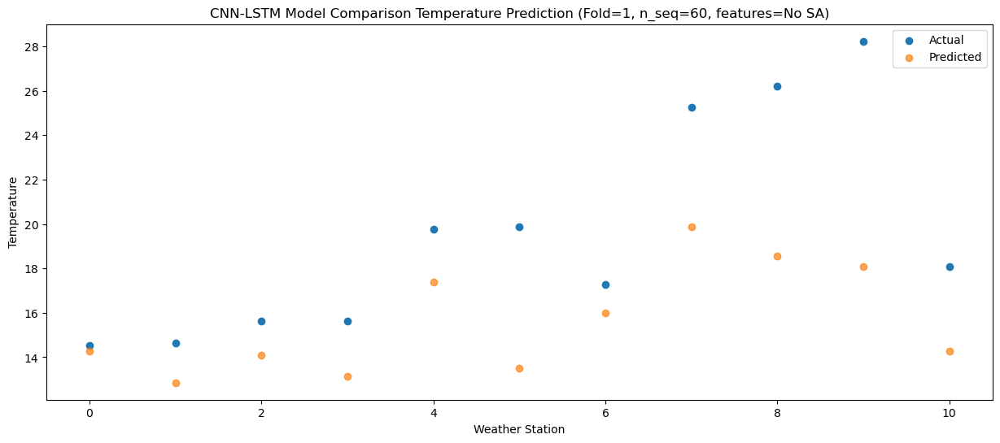

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  14.740210
1                 1   15.57  13.313291
2                 2   15.63  14.557261
3                 3   15.03  13.586390
4                 4   19.57  17.824536
5                 5   18.88  13.963722
6                 6   18.30  16.441846
7                 7   25.90  20.334125
8                 8   27.06  19.030556
9                 9   28.96  18.555425
10               10   20.00  14.728477


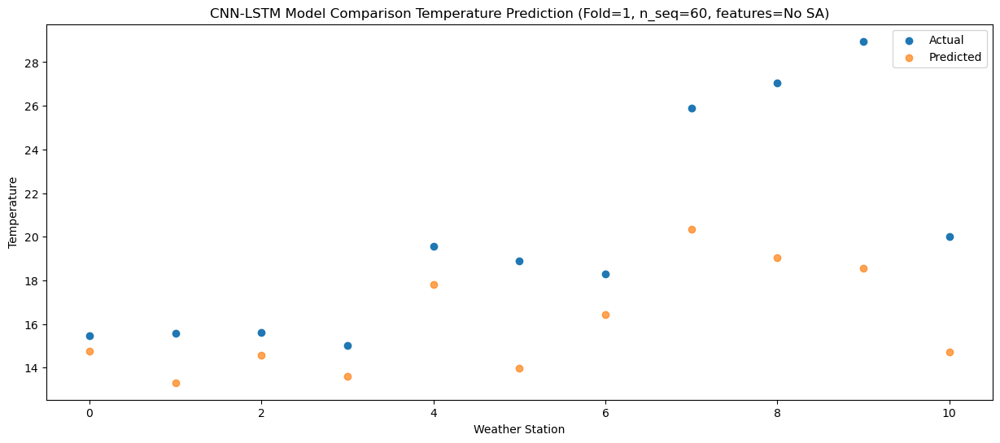

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  14.879703
1                 1   15.29  13.453170
2                 2   15.94  14.697651
3                 3   16.16  13.726671
4                 4   20.89  17.964577
5                 5   20.48  14.102378
6                 6   17.97  16.581540
7                 7   26.31  20.474116
8                 8   29.17  19.168825
9                 9   29.76  18.693042
10               10   17.85  14.866479


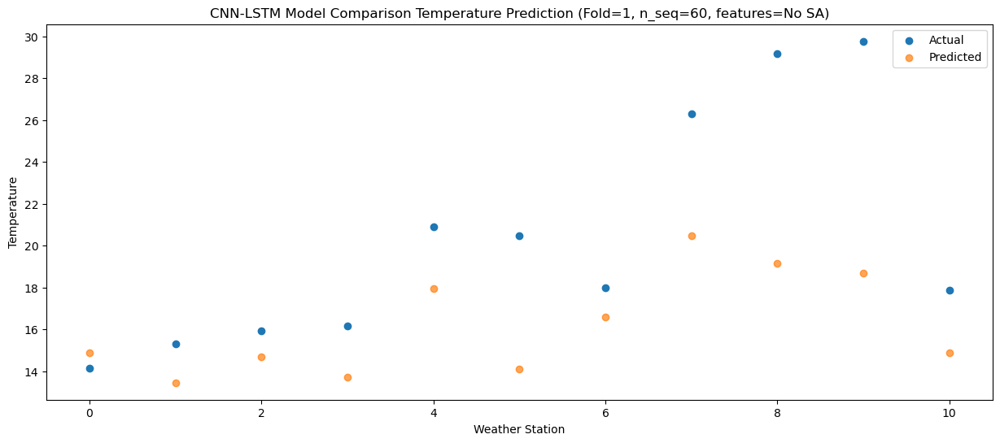

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  11.038934
1                 1   11.57   9.612489
2                 2   13.63  10.857089
3                 3   13.56   9.886081
4                 4   17.60  14.123934
5                 5   14.77  10.261423
6                 6   14.67  12.740821
7                 7   24.44  16.633464
8                 8   23.20  15.327778
9                 9   25.20  14.851844
10               10   14.12  11.025371


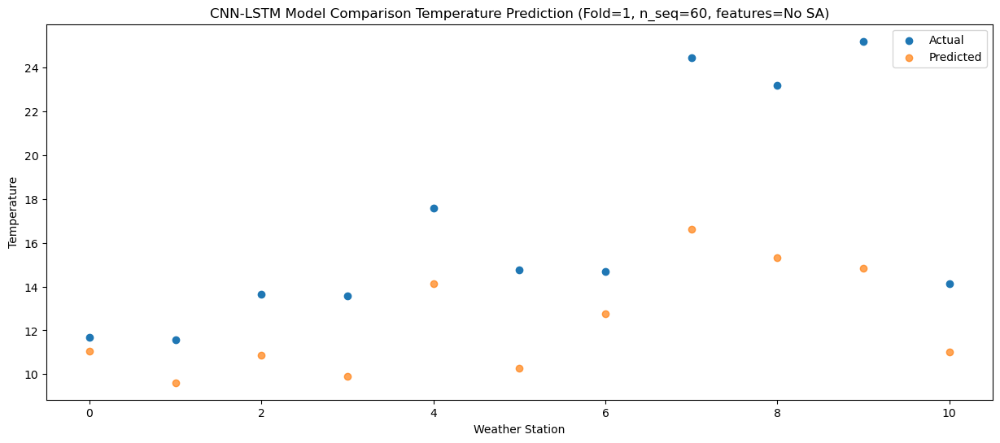

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81   7.072631
1                 1    7.12   5.646217
2                 2    8.63   6.890860
3                 3   10.87   5.919843
4                 4   14.45  10.157677
5                 5   13.62   6.295051
6                 6    9.87   8.774536
7                 7   18.97  12.667204
8                 8   19.34  11.361373
9                 9   20.35  10.885383
10               10    9.25   7.058943


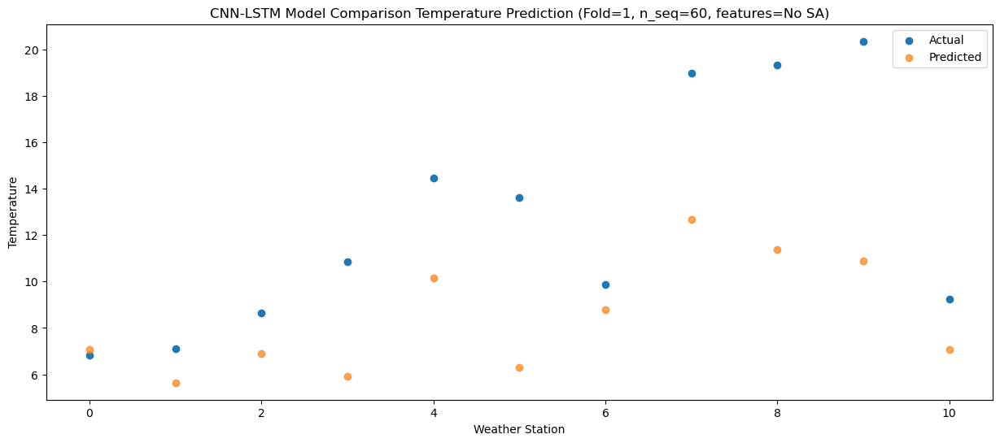

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 256)            464896    
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 256)           0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 256)            0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 1024)           5246976   
                                                                 
 dropout_10 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_7 (LSTM)               (None, 1024)              8392704   
                                                      

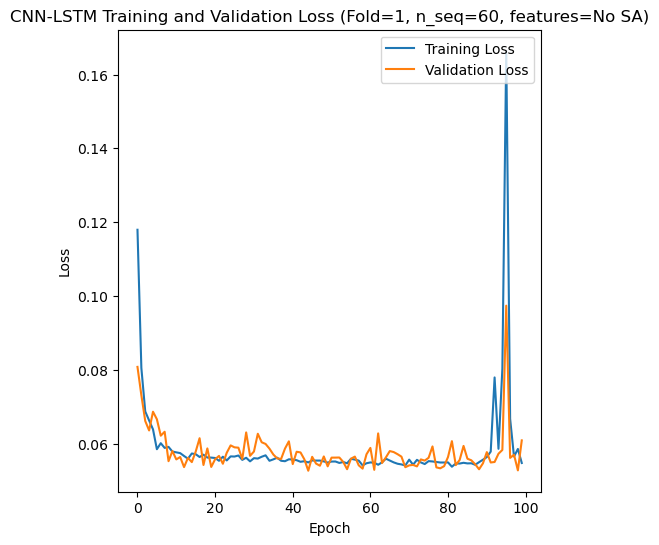

Epoch 1/100
84/84 [==============================] - 9s 58ms/step - loss: 0.1229 - accuracy: 0.2976 - mae: 0.1024 - rmse: 0.1229 - mape: inf - pearson: 0.6686 - val_loss: 0.0549 - val_accuracy: 0.6000 - val_mae: 0.0437 - val_rmse: 0.0549 - val_mape: 9.2922 - val_pearson: 0.8966
Epoch 2/100
84/84 [==============================] - 4s 45ms/step - loss: 0.0736 - accuracy: 0.3690 - mae: 0.0588 - rmse: 0.0736 - mape: inf - pearson: 0.7994 - val_loss: 0.0846 - val_accuracy: 0.6000 - val_mae: 0.0710 - val_rmse: 0.0846 - val_mape: 13.6380 - val_pearson: 0.9068
Epoch 3/100
84/84 [==============================] - 4s 45ms/step - loss: 0.0729 - accuracy: 0.5238 - mae: 0.0589 - rmse: 0.0729 - mape: inf - pearson: 0.8214 - val_loss: 0.0445 - val_accuracy: 0.6000 - val_mae: 0.0357 - val_rmse: 0.0445 - val_mape: 7.9638 - val_pearson: 0.9163
Epoch 4/100
84/84 [==============================] - 4s 45ms/step - loss: 0.0651 - accuracy: 0.5714 - mae: 0.0521 - rmse: 0.0651 - mape: inf - pearson: 0.8360 - v

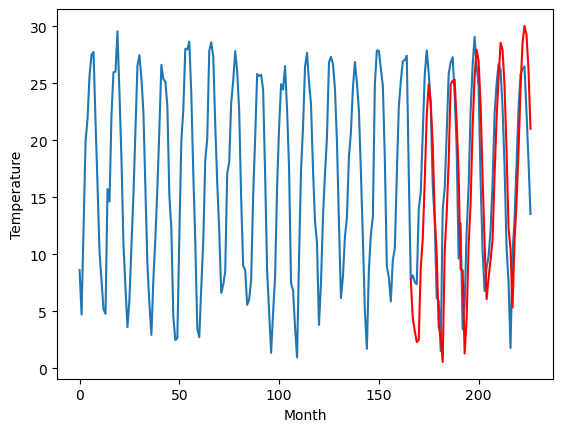

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-0.97		-2.54
-0.71		-2.10		-1.39
-0.95		-3.08		-2.13
-1.68		-2.89		-1.21
6.33		3.42		-2.91
8.56		5.96		-2.60
15.36		11.05		-4.31
22.56		16.83		-5.73
22.59		19.53		-3.06
21.26		17.97		-3.29
15.13		14.28		-0.85
8.14		8.08		-0.06
5.02		4.51		-0.51
-1.61		-1.66		-0.05
-1.69		-2.55		-0.86
-5.73		-4.82		0.91
4.46		4.84		0.38
8.22		8.17		-0.05
13.40		12.77		-0.63
20.65		19.53		-1.12
21.34		19.84		-1.50
22.10		19.93		-2.17
19.86		16.28		-3.58
11.60		11.61		0.01
4.89		3.29		-1.60
2.50		3.22		0.72
-2.19		-4.08		-1.89
-2.20		-1.04		1.16
4.78		5.40		0.62
11.46		9.13		-2.33
17.26		15.79		-1.47
21.06		20.24		-0.82
24.30		22.56		-1.74
21.99		21.57		-0.42
19.23		17.81		-1.42
10.85		11.36		0.51
0.86		5.66		4.80
-1.85		0.70		2.55
-2.10		2.53		4.63
-0.50		4.14		4.64
3.57		5.93		2.36
9.43		11.59		2.16
14.92		16.51		1.59
17.53		19.99		2.46
21.63		23.17		1.54
22.12		22.55		0.43
19.25		19.40		0.15
10.21		13.7

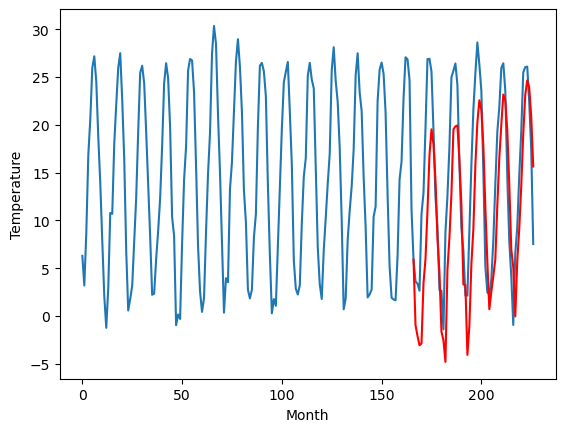

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		4.30		-1.36
4.54		3.17		-1.37
3.39		2.19		-1.20
4.43		2.38		-2.05
8.05		8.69		0.64
9.44		11.23		1.79
10.75		16.32		5.57
13.34		22.10		8.76
13.98		24.80		10.82
13.67		23.24		9.57
12.41		19.55		7.14
11.14		13.35		2.21
7.72		9.78		2.06
0.73		3.61		2.88
1.39		2.72		1.33
4.12		0.45		-3.67
5.93		10.11		4.18
7.74		13.44		5.70
11.32		18.04		6.72
12.54		24.80		12.26
13.33		25.11		11.78
13.38		25.20		11.82
12.10		21.55		9.45
10.96		16.88		5.92
4.11		8.56		4.45
5.01		8.49		3.48
0.75		1.19		0.44
3.08		4.23		1.15
6.55		10.67		4.12
8.36		14.40		6.04
11.12		21.06		9.94
12.93		25.51		12.58
13.11		27.83		14.72
12.54		26.84		14.30
11.13		23.08		11.95
8.50		16.63		8.13
6.74		10.93		4.19
2.64		5.97		3.33
2.44		7.80		5.36
5.50		9.41		3.91
6.52		11.20		4.68
9.06		16.86		7.80
10.04		21.78		11.74
12.45		25.26		12.81
14.36		28.44		14.08
14.54		27.82		13.28
12.59		24.67		12.08
9.01		19.01		10.00
5.03		12.25		7.2

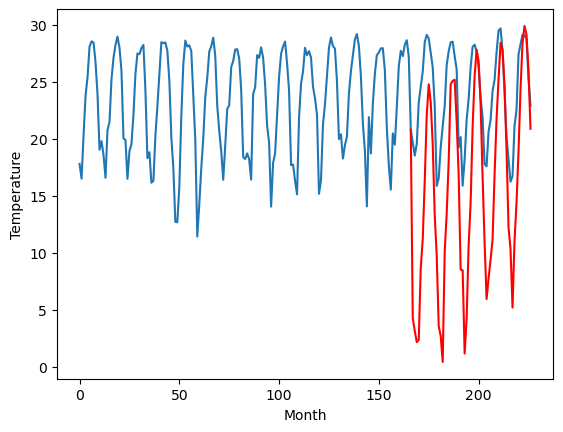

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		0.83		0.84
-3.07		-0.30		2.77
-2.80		-1.28		1.52
-2.65		-1.09		1.56
0.90		5.22		4.32
2.13		7.76		5.63
8.02		12.85		4.83
14.08		18.63		4.55
18.36		21.33		2.97
16.51		19.77		3.26
11.93		16.08		4.15
6.71		9.88		3.17
2.75		6.31		3.56
-4.08		0.14		4.22
-7.16		-0.75		6.41
-7.14		-3.02		4.12
-3.03		6.64		9.67
1.47		9.97		8.50
6.73		14.57		7.84
12.30		21.33		9.03
14.30		21.64		7.34
15.36		21.73		6.37
12.19		18.08		5.89
8.36		13.41		5.05
0.28		5.09		4.81
-1.64		5.02		6.66
-7.79		-2.28		5.51
-5.47		0.76		6.23
-1.61		7.20		8.81
2.83		10.93		8.10
8.17		17.59		9.42
12.41		22.04		9.63
17.03		24.36		7.33
16.95		23.37		6.42
11.91		19.61		7.70
6.47		13.16		6.69
2.67		7.46		4.79
-3.50		2.50		6.00
-2.21		4.33		6.54
-4.09		5.94		10.03
-1.65		7.73		9.38
4.07		13.39		9.32
7.70		18.31		10.61
11.49		21.79		10.30
17.06		24.97		7.91
15.05		24.35		9.30
12.63		21.20		8.57
7.61		15.54		7.93
-0.37		8.78		9.15
-1.11

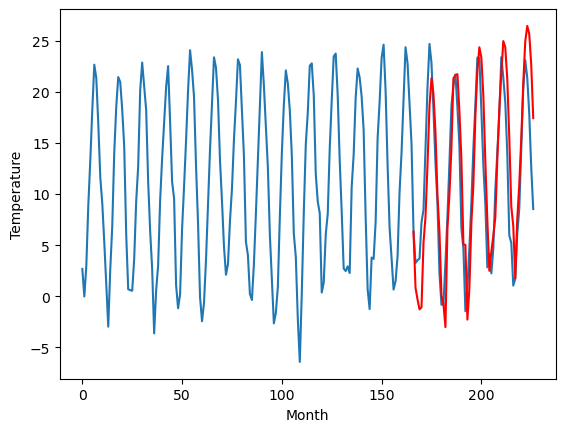

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		0.87		1.19
0.03		-0.26		-0.29
0.37		-1.24		-1.61
1.01		-1.05		-2.06
7.70		5.26		-2.44
7.17		7.80		0.63
10.14		12.89		2.75
13.18		18.67		5.49
13.92		21.37		7.45
14.29		19.81		5.52
11.94		16.12		4.18
8.25		9.92		1.67
4.13		6.35		2.22
-2.17		0.18		2.35
-1.82		-0.71		1.11
-2.56		-2.98		-0.42
4.77		6.68		1.91
5.64		10.01		4.37
10.11		14.61		4.50
13.59		21.37		7.78
14.18		21.68		7.50
14.35		21.77		7.42
11.81		18.12		6.31
9.07		13.45		4.38
0.80		5.13		4.33
4.21		5.06		0.85
-3.52		-2.24		1.28
-0.38		0.80		1.18
3.38		7.24		3.86
7.18		10.97		3.79
12.34		17.63		5.29
14.93		22.08		7.15
14.76		24.40		9.64
13.94		23.41		9.47
11.97		19.65		7.68
5.78		13.20		7.42
2.71		7.50		4.79
0.20		2.54		2.34
1.37		4.37		3.00
3.50		5.98		2.48
5.33		7.77		2.44
7.25		13.43		6.18
11.28		18.35		7.07
14.93		21.83		6.90
16.37		25.01		8.64
17.67		24.39		6.72
13.24		21.24		8.00
7.08		15.58		8.50
1.97		8.82		6.85
-0.63		6.

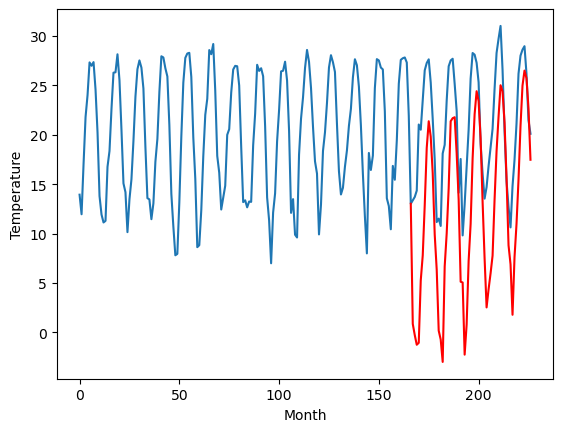

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-1.46		-1.07
-1.82		-2.59		-0.77
-1.45		-3.57		-2.12
-2.21		-3.38		-1.17
5.88		2.93		-2.95
5.85		5.47		-0.38
9.69		10.56		0.87
13.30		16.34		3.04
15.00		19.04		4.04
15.30		17.48		2.18
10.90		13.79		2.89
6.43		7.59		1.16
3.75		4.02		0.27
-2.36		-2.15		0.21
-2.95		-3.04		-0.09
-5.30		-5.31		-0.01
3.08		4.35		1.27
5.20		7.68		2.48
9.24		12.28		3.04
13.79		19.04		5.25
13.87		19.35		5.48
14.98		19.44		4.46
12.24		15.79		3.55
8.94		11.12		2.18
1.30		2.80		1.50
4.54		2.73		-1.81
-3.89		-4.57		-0.68
-4.27		-1.53		2.74
1.85		4.91		3.06
8.00		8.64		0.64
12.60		15.30		2.70
16.32		19.75		3.43
17.68		22.07		4.39
14.96		21.08		6.12
12.30		17.32		5.02
6.73		10.87		4.14
0.85		5.17		4.32
-1.38		0.21		1.59
-0.62		2.04		2.66
0.57		3.65		3.08
4.37		5.44		1.07
5.29		11.10		5.81
10.37		16.02		5.65
15.29		19.50		4.21
17.45		22.68		5.23
19.15		22.06		2.91
14.67		18.91		4.24
6.78		13.25		6.47
0.50		6.49		5.99


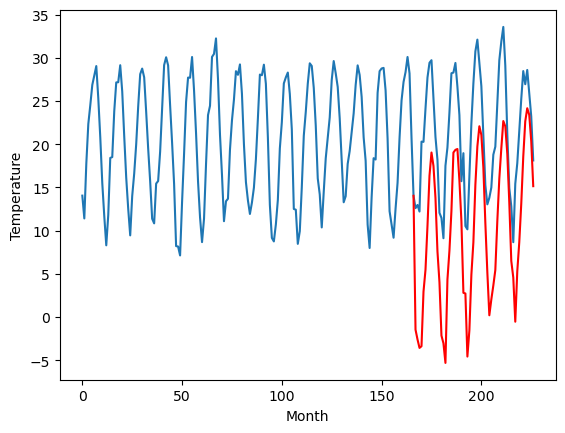

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		10.08		-0.34
8.61		8.95		0.34
8.96		7.97		-0.99
8.40		8.16		-0.24
16.05		14.47		-1.58
16.36		17.01		0.65
21.26		22.10		0.84
26.00		27.88		1.88
27.18		30.58		3.40
27.41		29.02		1.61
21.47		25.33		3.86
15.99		19.13		3.14
13.50		15.56		2.06
7.04		9.39		2.35
6.34		8.50		2.16
3.23		6.23		3.00
13.60		15.89		2.29
15.30		19.22		3.92
19.38		23.82		4.44
24.94		30.58		5.64
25.83		30.89		5.06
26.39		30.98		4.59
24.12		27.33		3.21
19.61		22.66		3.05
11.64		14.34		2.70
13.93		14.27		0.34
5.45		6.97		1.52
5.28		10.01		4.73
11.86		16.45		4.59
18.13		20.18		2.05
23.15		26.84		3.69
27.86		31.29		3.43
30.65		33.61		2.96
27.84		32.62		4.78
24.01		28.86		4.85
17.63		22.41		4.78
10.96		16.71		5.75
8.34		11.75		3.41
9.22		13.58		4.36
9.41		15.19		5.78
14.06		16.98		2.92
15.88		22.64		6.76
21.62		27.56		5.94
25.77		31.04		5.27
28.33		34.22		5.89
30.67		33.60		2.93
25.89		30.45		4.56
17.17		24.79		7.62
11.83		

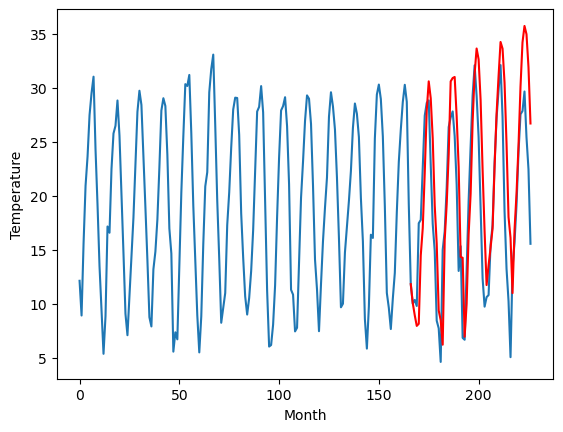

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.06		-1.63
-7.96		-6.19		1.77
-6.71		-7.17		-0.46
-5.90		-6.98		-1.08
-1.40		-0.67		0.73
3.58		1.87		-1.71
9.87		6.96		-2.91
13.39		12.74		-0.65
15.49		15.44		-0.05
15.93		13.88		-2.05
9.68		10.19		0.51
4.08		3.99		-0.09
-1.48		0.42		1.90
-9.13		-5.75		3.38
-8.59		-6.64		1.95
-5.67		-8.91		-3.24
-2.57		0.75		3.32
4.09		4.08		-0.01
9.10		8.68		-0.42
14.09		15.44		1.35
12.89		15.75		2.86
12.37		15.84		3.47
10.19		12.19		2.00
3.63		7.52		3.89
-1.77		-0.80		0.97
-5.12		-0.87		4.25
-8.12		-8.17		-0.05
-7.15		-5.13		2.02
-2.09		1.31		3.40
5.10		5.04		-0.06
9.80		11.70		1.90
13.66		16.15		2.49
14.80		18.47		3.67
11.78		17.48		5.70
10.05		13.72		3.67
1.84		7.27		5.43
-5.05		1.57		6.62
-7.22		-3.39		3.83
-7.93		-1.56		6.37
-6.72		0.05		6.77
-2.02		1.84		3.86
3.62		7.50		3.88
8.27		12.42		4.15
12.93		15.90		2.97
17.68		19.08		1.40
14.68		18.46		3.78
12.02		15.31		3.29
5.28		9.65		4.37
-1.83		2

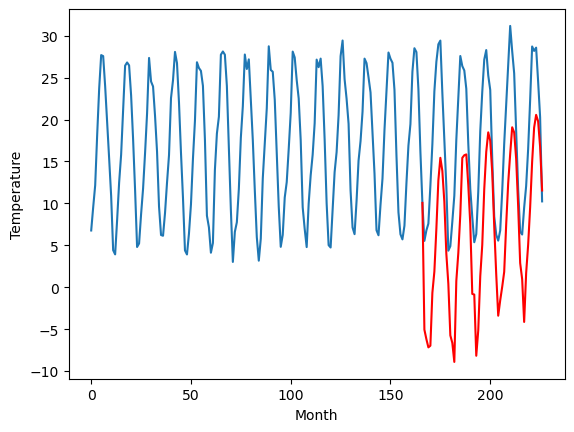

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		6.20		-3.14
5.80		5.07		-0.73
6.34		4.09		-2.25
8.45		4.28		-4.17
8.52		10.59		2.07
11.73		13.13		1.40
15.78		18.22		2.44
17.07		24.00		6.93
19.48		26.70		7.22
21.88		25.14		3.26
20.28		21.45		1.17
17.04		15.25		-1.79
10.32		11.68		1.36
8.27		5.51		-2.76
8.21		4.62		-3.59
7.29		2.35		-4.94
6.89		12.01		5.12
10.75		15.34		4.59
12.97		19.94		6.97
17.21		26.70		9.49
20.19		27.01		6.82
19.79		27.10		7.31
18.01		23.45		5.44
13.03		18.78		5.75
11.77		10.46		-1.31
5.26		10.39		5.13
7.67		3.09		-4.58
8.54		6.13		-2.41
10.33		12.57		2.24
12.45		16.30		3.85
13.41		22.96		9.55
18.33		27.41		9.08
19.14		29.73		10.59
21.18		28.74		7.56
20.77		24.98		4.21
14.50		18.53		4.03
8.27		12.83		4.56
5.57		7.87		2.30
5.23		9.70		4.47
4.91		11.31		6.40
5.92		13.10		7.18
9.76		18.76		9.00
10.97		23.68		12.71
12.93		27.16		14.23
19.85		30.34		10.49
19.48		29.72		10.24
15.98		26.57		10.59
14.39		20.91		6.52
10.00

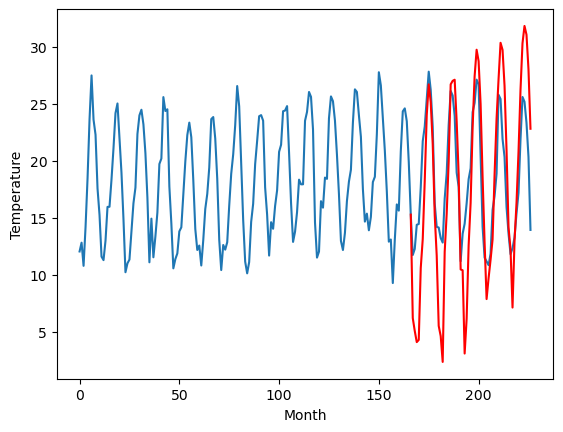

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		6.31		2.26
3.64		5.18		1.54
3.35		4.20		0.85
4.39		4.39		0.00
9.62		10.70		1.08
10.92		13.24		2.32
13.52		18.33		4.81
18.81		24.11		5.30
21.80		26.81		5.01
20.80		25.25		4.45
16.77		21.56		4.79
12.85		15.36		2.51
8.24		11.79		3.55
1.24		5.62		4.38
0.83		4.73		3.90
1.33		2.46		1.13
8.21		12.12		3.91
11.00		15.45		4.45
15.02		20.05		5.03
19.31		26.81		7.50
20.88		27.12		6.24
20.97		27.21		6.24
16.86		23.56		6.70
13.58		18.89		5.31
4.67		10.57		5.90
6.59		10.50		3.91
0.11		3.20		3.09
4.13		6.24		2.11
8.24		12.68		4.44
11.53		16.41		4.88
16.38		23.07		6.69
20.14		27.52		7.38
21.58		29.84		8.26
20.20		28.85		8.65
16.89		25.09		8.20
9.58		18.64		9.06
7.46		12.94		5.48
0.93		7.98		7.05
4.13		9.81		5.68
7.15		11.42		4.27
7.60		13.21		5.61
11.12		18.87		7.75
13.90		23.79		9.89
17.56		27.27		9.71
21.15		30.45		9.30
20.60		29.83		9.23
16.64		26.68		10.04
11.35		21.02		9.67
5.45		14.26		8.81
2.98	

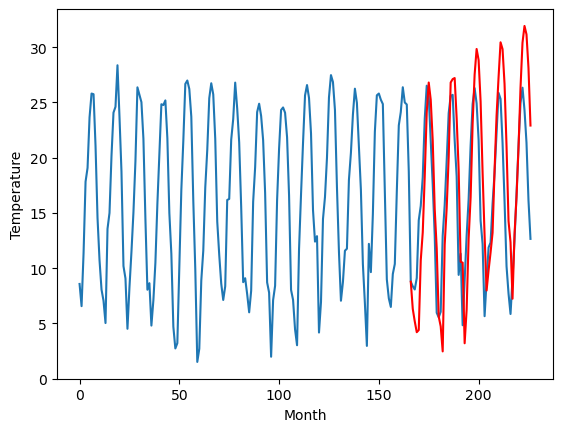

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		4.40		2.75
2.25		3.27		1.02
1.81		2.29		0.48
1.61		2.48		0.87
7.65		8.79		1.14
8.08		11.33		3.25
12.12		16.42		4.30
17.49		22.20		4.71
20.78		24.90		4.12
19.52		23.34		3.82
15.57		19.65		4.08
10.91		13.45		2.54
5.86		9.88		4.02
-1.20		3.71		4.91
-0.87		2.82		3.69
0.48		0.55		0.07
6.69		10.21		3.52
8.66		13.54		4.88
13.57		18.14		4.57
18.98		24.90		5.92
20.29		25.21		4.92
20.37		25.30		4.93
15.88		21.65		5.77
12.12		16.98		4.86
1.90		8.66		6.76
4.00		8.59		4.59
-2.87		1.29		4.16
1.72		4.33		2.61
6.27		10.77		4.50
9.43		14.50		5.07
15.67		21.16		5.49
19.32		25.61		6.29
20.67		27.93		7.26
19.42		26.94		7.52
15.27		23.18		7.91
7.99		16.73		8.74
5.54		11.03		5.49
0.08		6.07		5.99
2.00		7.90		5.90
4.79		9.51		4.72
5.32		11.30		5.98
10.21		16.96		6.75
13.56		21.88		8.32
16.47		25.36		8.89
20.02		28.54		8.52
19.31		27.92		8.61
16.53		24.77		8.24
10.48		19.11		8.63
4.27		12.35		8.08
1.42		10.43

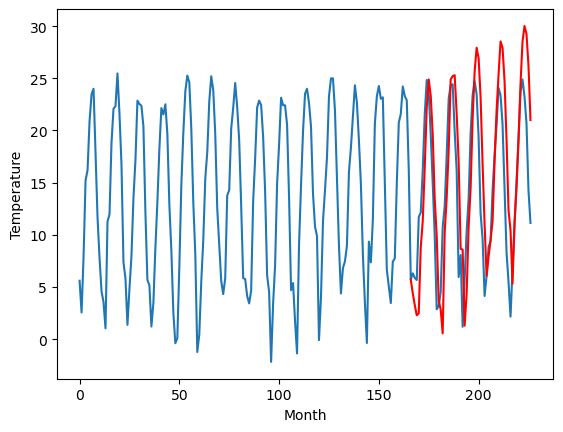

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[4.4006081962585455, -0.9693908500671391, 4.3006091499328605, 0.8306091499328616, 0.8706091499328608, -1.4593918037414548, 10.080610103607178, -5.059388942718506, 6.200610103607177, 6.310609149932862, 4.400609149932862]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.400608
1                 1    1.57  -0.969391
2                 2    5.66   4.300609
3                 3   -0.01   0.830609
4                 4   -0.32   0.870609
5                 5   -0.39  -1.459392
6                 6   10.42  10.080610
7                 7   -3.43  -5.059389
8                 8    9.34   6.200610
9                 9    4.05   6.310609
10               10    1.65   4.400609


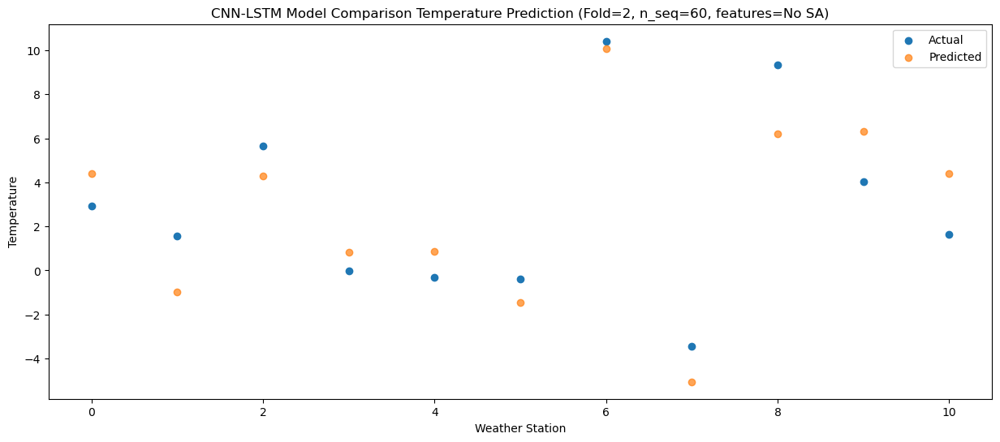

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   3.266719
1                 1   -0.71  -2.103287
2                 2    4.54   3.166727
3                 3   -3.07  -0.303281
4                 4    0.03  -0.263271
5                 5   -1.82  -2.593278
6                 6    8.61   8.946719
7                 7   -7.96  -6.193278
8                 8    5.80   5.066722
9                 9    3.64   5.176723
10               10    2.25   3.266722


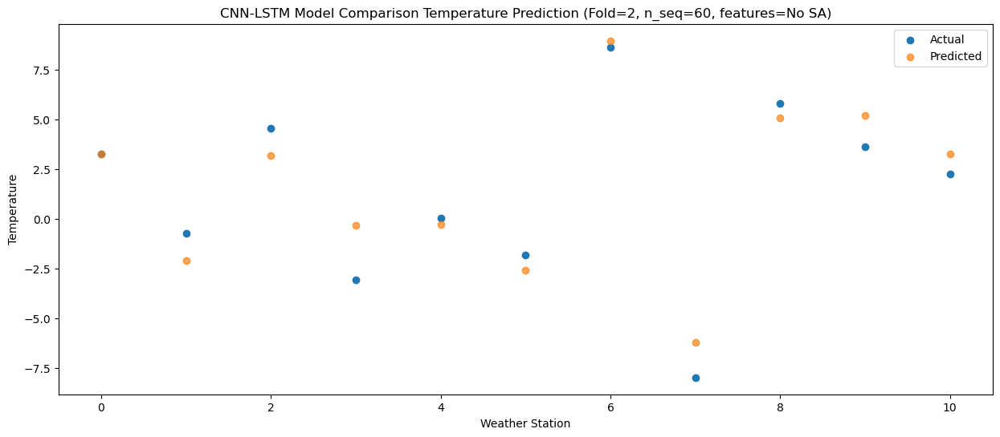

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.290049
1                 1   -0.95  -3.079955
2                 2    3.39   2.190062
3                 3   -2.80  -1.279951
4                 4    0.37  -1.239936
5                 5   -1.45  -3.569948
6                 6    8.96   7.970050
7                 7   -6.71  -7.169945
8                 8    6.34   4.090053
9                 9    3.35   4.200054
10               10    1.81   2.290053


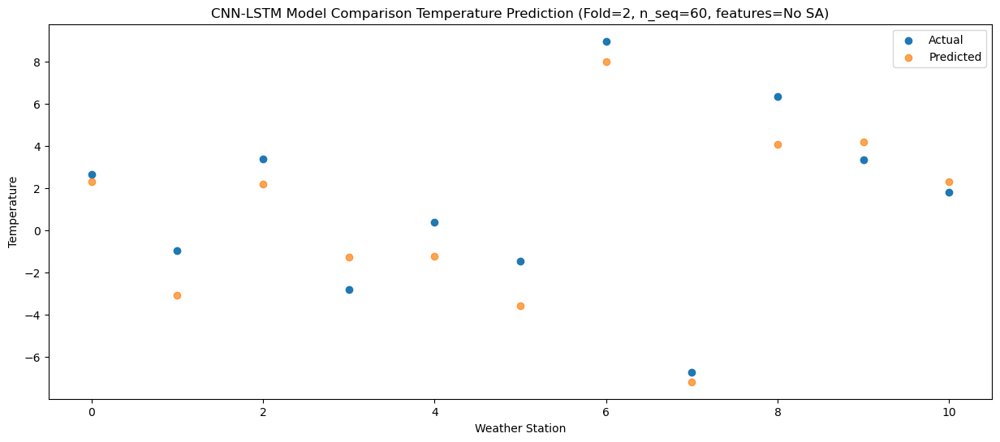

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.484225
1                 1   -1.68  -2.885771
2                 2    4.43   2.384238
3                 3   -2.65  -1.085775
4                 4    1.01  -1.045760
5                 5   -2.21  -3.375770
6                 6    8.40   8.164226
7                 7   -5.90  -6.975769
8                 8    8.45   4.284229
9                 9    4.39   4.394232
10               10    1.61   2.484231


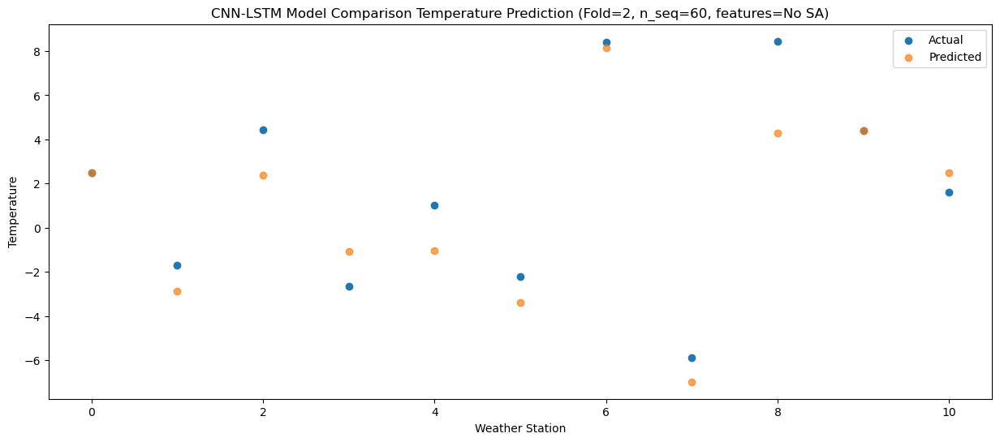

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.794865
1                 1    6.33   3.424876
2                 2    8.05   8.694879
3                 3    0.90   5.224865
4                 4    7.70   5.264883
5                 5    5.88   2.934872
6                 6   16.05  14.474868
7                 7   -1.40  -0.665127
8                 8    8.52  10.594871
9                 9    9.62  10.704872
10               10    7.65   8.794873


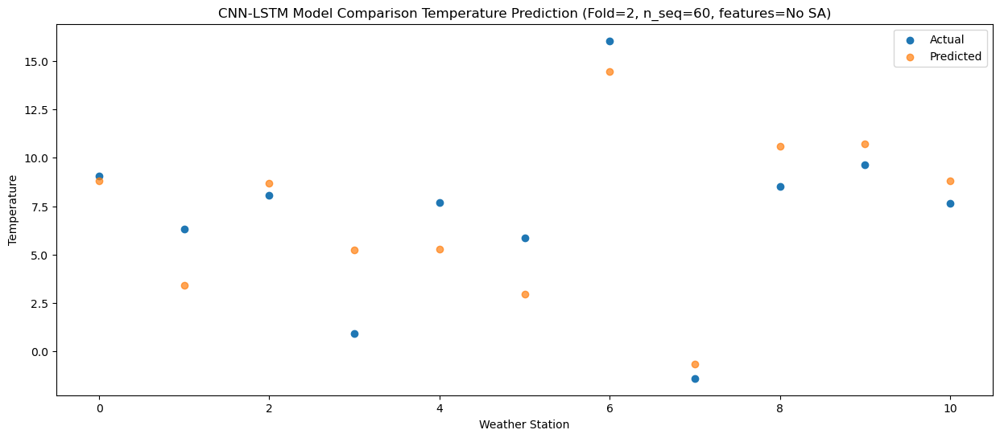

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.329700
1                 1    8.56   5.959717
2                 2    9.44  11.229714
3                 3    2.13   7.759700
4                 4    7.17   7.799718
5                 5    5.85   5.469710
6                 6   16.36  17.009704
7                 7    3.58   1.869709
8                 8   11.73  13.129707
9                 9   10.92  13.239708
10               10    8.08  11.329709


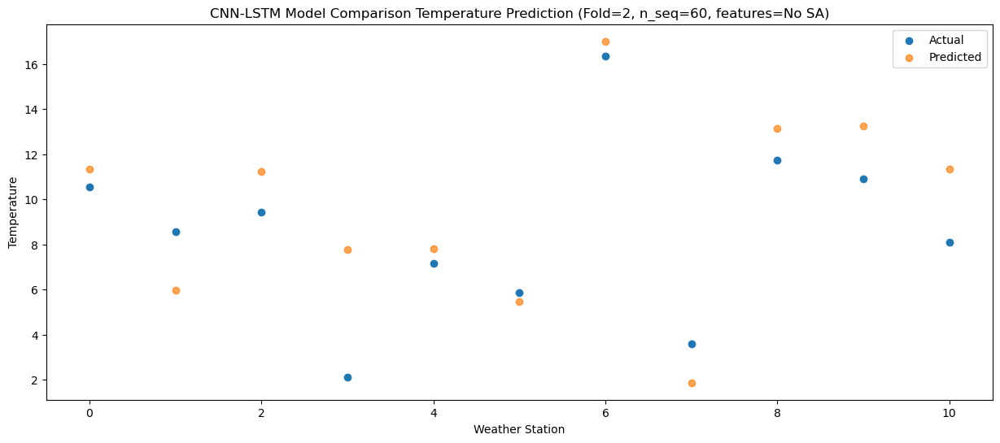

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  16.423646
1                 1   15.36  11.053655
2                 2   10.75  16.323658
3                 3    8.02  12.853644
4                 4   10.14  12.893660
5                 5    9.69  10.563656
6                 6   21.26  22.103650
7                 7    9.87   6.963657
8                 8   15.78  18.223655
9                 9   13.52  18.333652
10               10   12.12  16.423655


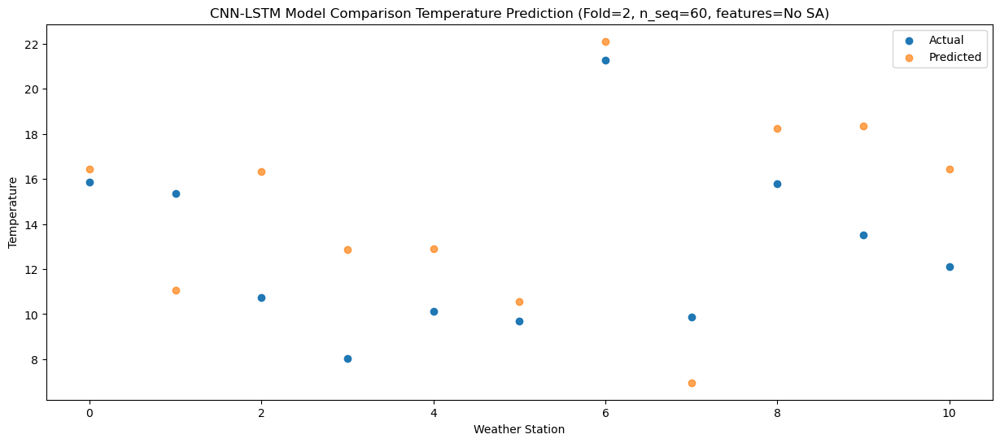

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  22.199568
1                 1   22.56  16.829578
2                 2   13.34  22.099577
3                 3   14.08  18.629566
4                 4   13.18  18.669581
5                 5   13.30  16.339579
6                 6   26.00  27.879573
7                 7   13.39  12.739578
8                 8   17.07  23.999576
9                 9   18.81  24.109573
10               10   17.49  22.199578


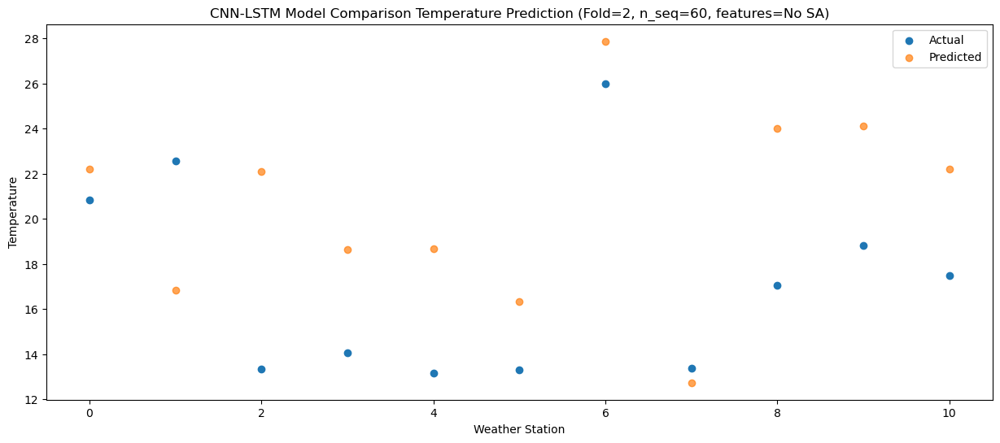

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  24.898081
1                 1   22.59  19.528088
2                 2   13.98  24.798084
3                 3   18.36  21.328077
4                 4   13.92  21.368089
5                 5   15.00  19.038088
6                 6   27.18  30.578084
7                 7   15.49  15.438088
8                 8   19.48  26.698085
9                 9   21.80  26.808080
10               10   20.78  24.898088


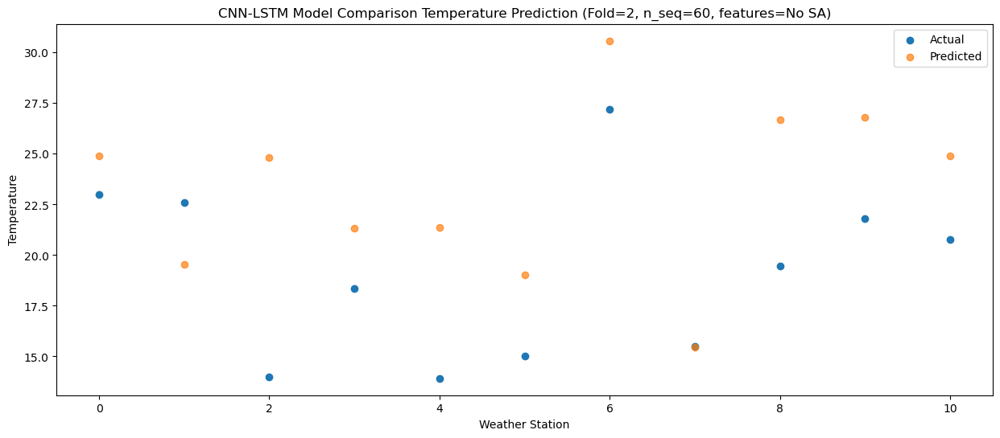

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  23.339406
1                 1   21.26  17.969409
2                 2   13.67  23.239413
3                 3   16.51  19.769402
4                 4   14.29  19.809418
5                 5   15.30  17.479412
6                 6   27.41  29.019408
7                 7   15.93  13.879413
8                 8   21.88  25.139409
9                 9   20.80  25.249407
10               10   19.52  23.339413


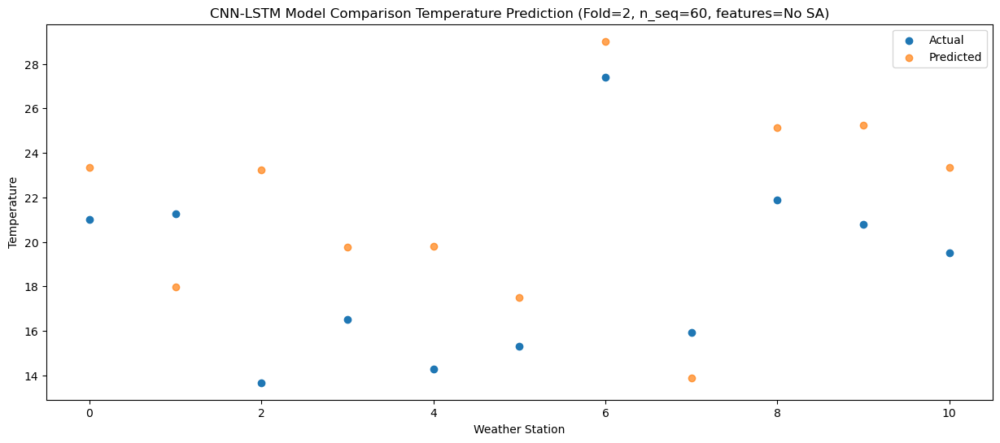

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  19.647298
1                 1   15.13  14.277295
2                 2   12.41  19.547309
3                 3   11.93  16.077294
4                 4   11.94  16.117314
5                 5   10.90  13.787308
6                 6   21.47  25.327300
7                 7    9.68  10.187307
8                 8   20.28  21.447303
9                 9   16.77  21.557303
10               10   15.57  19.647307


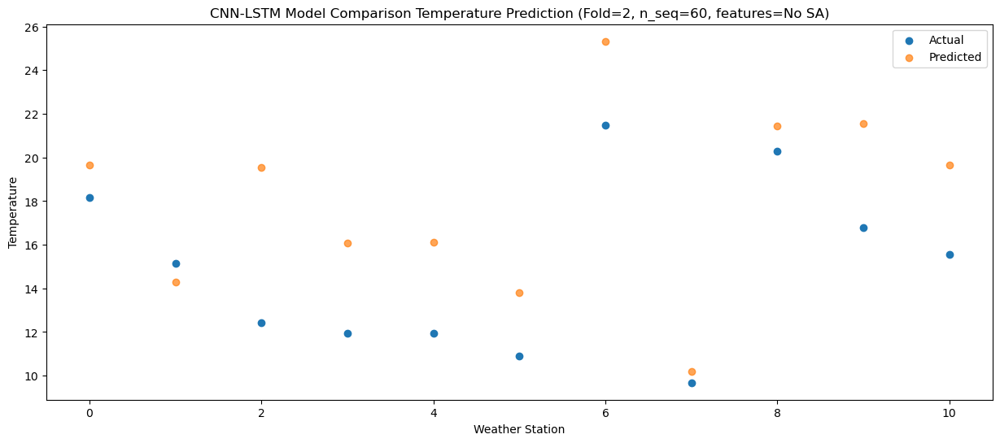

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  13.447411
1                 1    8.14   8.077405
2                 2   11.14  13.347425
3                 3    6.71   9.877408
4                 4    8.25   9.917431
5                 5    6.43   7.587424
6                 6   15.99  19.127416
7                 7    4.08   3.987423
8                 8   17.04  15.247419
9                 9   12.85  15.357417
10               10   10.91  13.447423


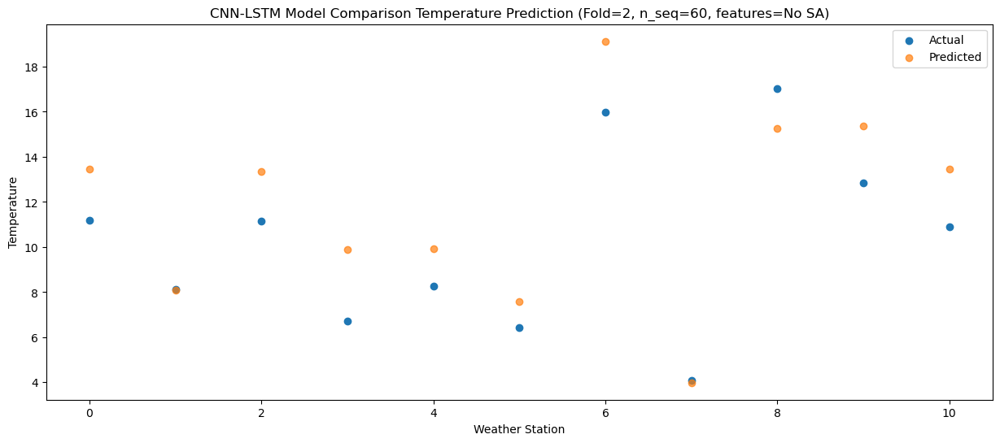

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   9.882139
1                 1    5.02   4.512131
2                 2    7.72   9.782157
3                 3    2.75   6.312138
4                 4    4.13   6.352163
5                 5    3.75   4.022156
6                 6   13.50  15.562146
7                 7   -1.48   0.422155
8                 8   10.32  11.682149
9                 9    8.24  11.792149
10               10    5.86   9.882152


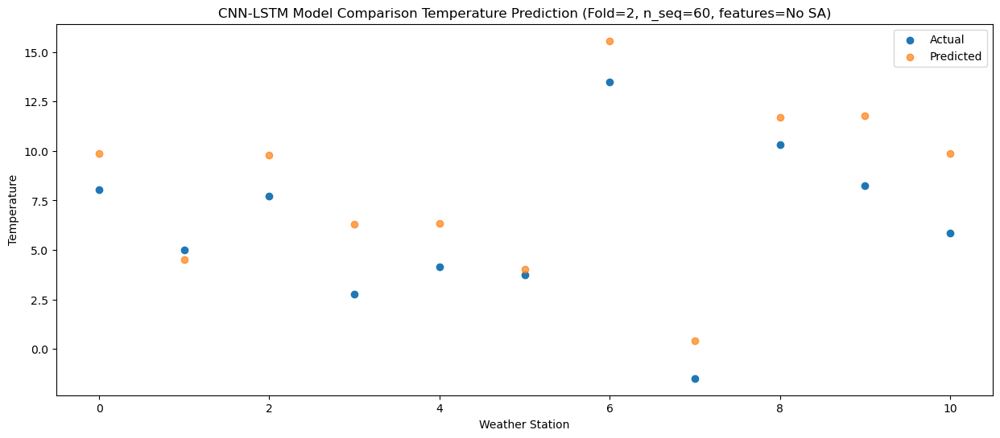

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   3.713616
1                 1   -1.61  -1.656392
2                 2    0.73   3.613640
3                 3   -4.08   0.143615
4                 4   -2.17   0.183647
5                 5   -2.36  -2.146362
6                 6    7.04   9.393624
7                 7   -9.13  -5.746363
8                 8    8.27   5.513631
9                 9    1.24   5.623632
10               10   -1.20   3.713635


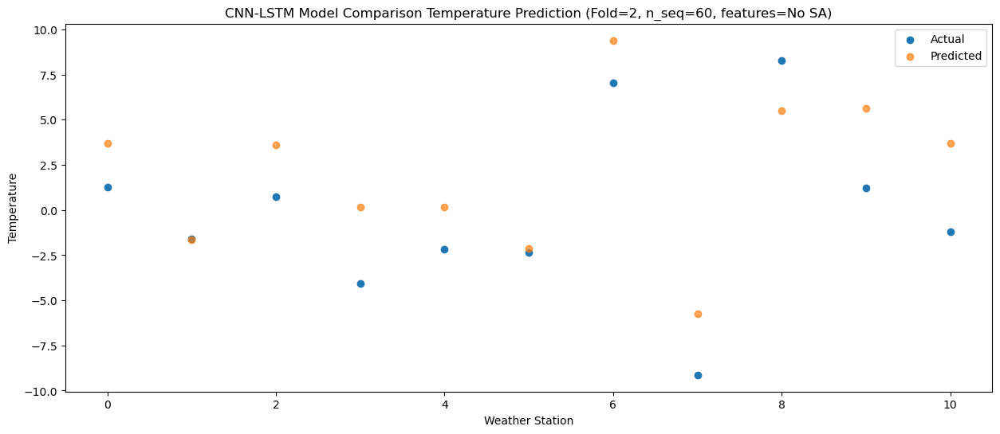

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   2.820340
1                 1   -1.69  -2.549667
2                 2    1.39   2.720365
3                 3   -7.16  -0.749662
4                 4   -1.82  -0.709630
5                 5   -2.95  -3.039637
6                 6    6.34   8.500347
7                 7   -8.59  -6.639638
8                 8    8.21   4.620356
9                 9    0.83   4.730355
10               10   -0.87   2.820360


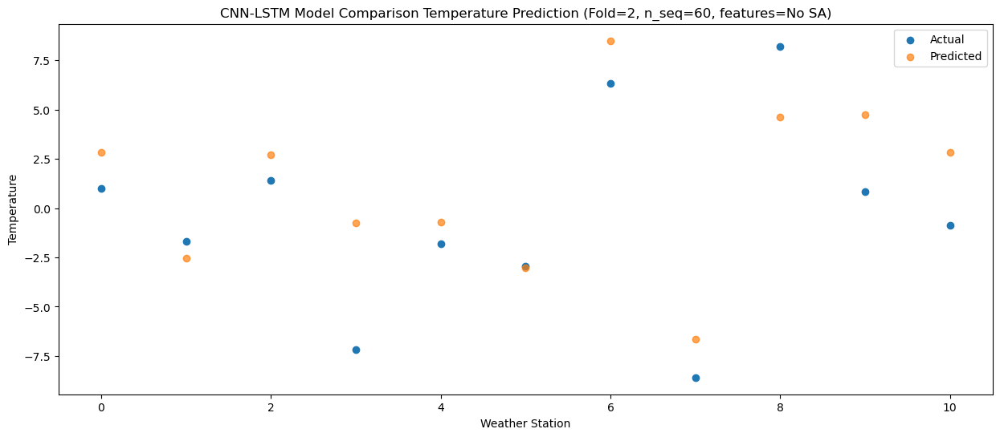

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38   0.552652
1                 1   -5.73  -4.817352
2                 2    4.12   0.452680
3                 3   -7.14  -3.017349
4                 4   -2.56  -2.977318
5                 5   -5.30  -5.307322
6                 6    3.23   6.232660
7                 7   -5.67  -8.907323
8                 8    7.29   2.352671
9                 9    1.33   2.462666
10               10    0.48   0.552675


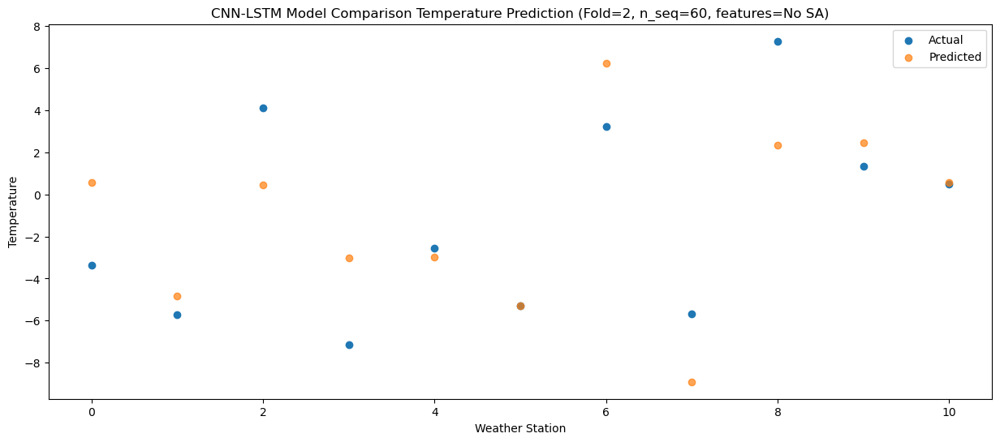

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04  10.210974
1                 1    4.46   4.840967
2                 2    5.93  10.111001
3                 3   -3.03   6.640972
4                 4    4.77   6.681006
5                 5    3.08   4.350999
6                 6   13.60  15.890985
7                 7   -2.57   0.751002
8                 8    6.89  12.010994
9                 9    8.21  12.120990
10               10    6.69  10.210998


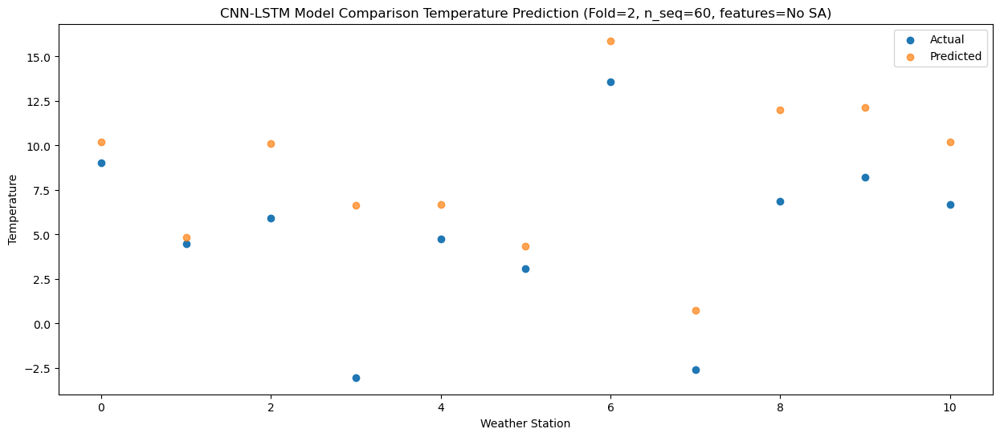

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  13.540509
1                 1    8.22   8.170503
2                 2    7.74  13.440537
3                 3    1.47   9.970508
4                 4    5.64  10.010543
5                 5    5.20   7.680535
6                 6   15.30  19.220520
7                 7    4.09   4.080536
8                 8   10.75  15.340530
9                 9   11.00  15.450527
10               10    8.66  13.540533


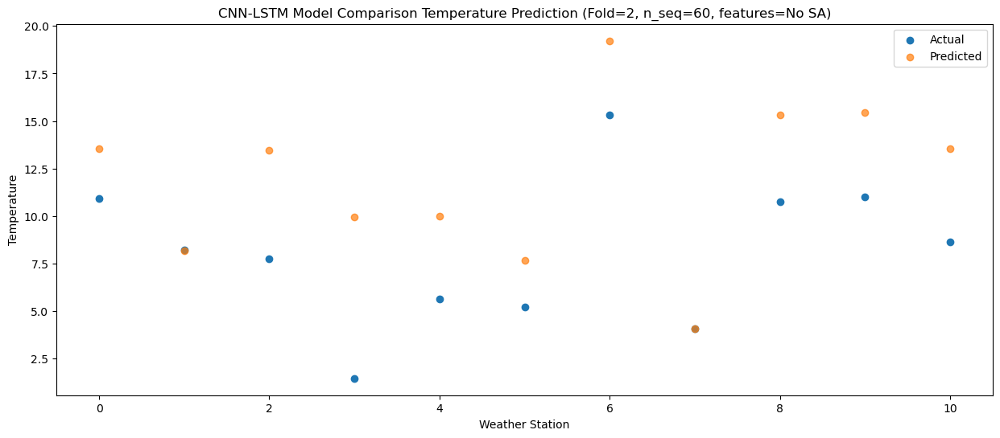

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  18.139195
1                 1   13.40  12.769189
2                 2   11.32  18.039227
3                 3    6.73  14.569194
4                 4   10.11  14.609234
5                 5    9.24  12.279225
6                 6   19.38  23.819209
7                 7    9.10   8.679226
8                 8   12.97  19.939220
9                 9   15.02  20.049217
10               10   13.57  18.139224


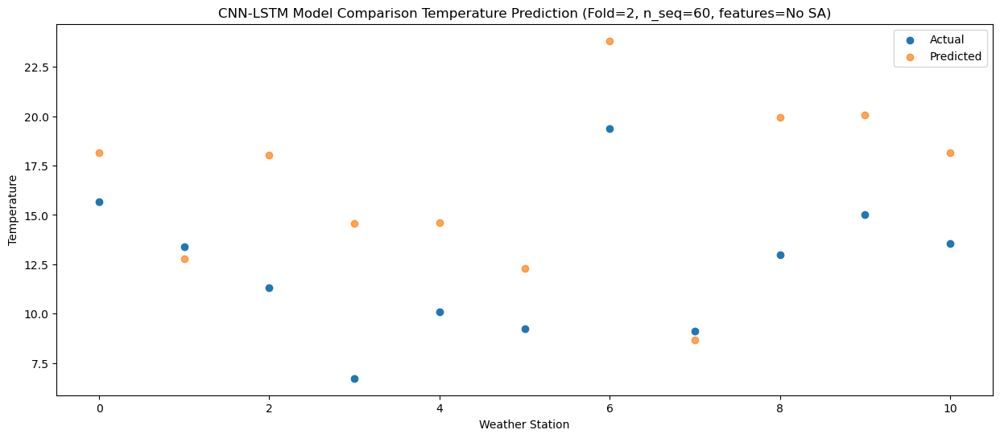

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  24.896976
1                 1   20.65  19.526973
2                 2   12.54  24.797004
3                 3   12.30  21.326975
4                 4   13.59  21.367010
5                 5   13.79  19.037009
6                 6   24.94  30.576989
7                 7   14.09  15.437003
8                 8   17.21  26.697001
9                 9   19.31  26.806998
10               10   18.98  24.897004


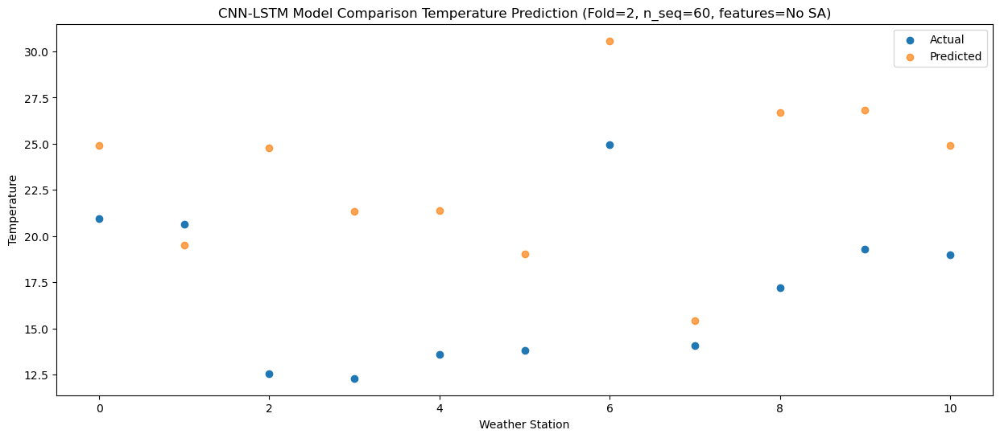

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  25.207038
1                 1   21.34  19.837040
2                 2   13.33  25.107061
3                 3   14.30  21.637037
4                 4   14.18  21.677071
5                 5   13.87  19.347070
6                 6   25.83  30.887052
7                 7   12.89  15.747065
8                 8   20.19  27.007063
9                 9   20.88  27.117059
10               10   20.29  25.207067


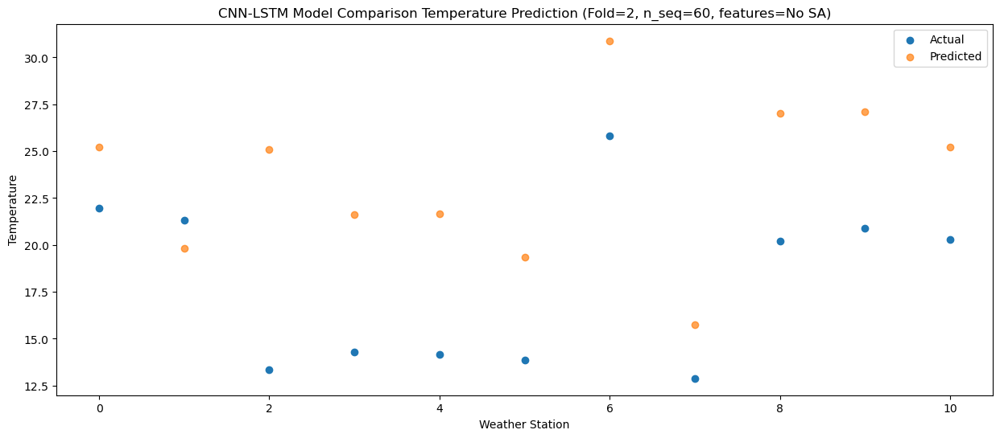

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  25.302538
1                 1   22.10  19.932549
2                 2   13.38  25.202553
3                 3   15.36  21.732537
4                 4   14.35  21.772565
5                 5   14.98  19.442570
6                 6   26.39  30.982554
7                 7   12.37  15.842567
8                 8   19.79  27.102563
9                 9   20.97  27.212556
10               10   20.37  25.302567


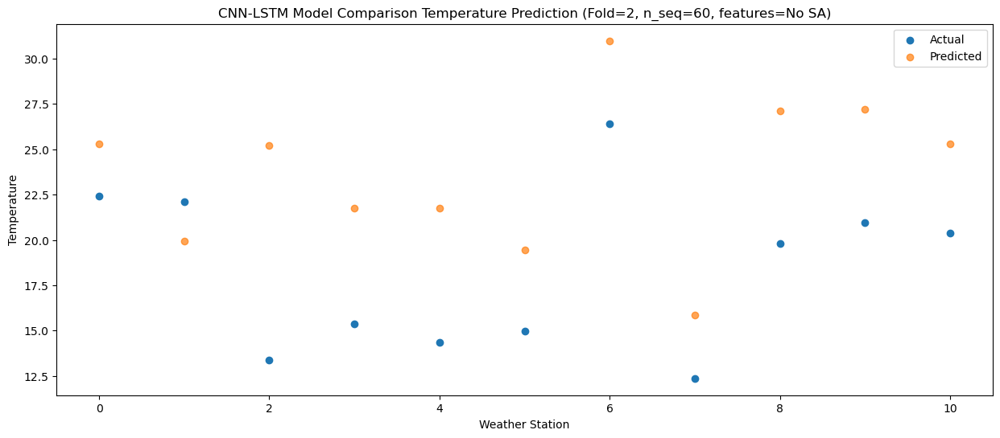

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  21.649318
1                 1   19.86  16.279332
2                 2   12.10  21.549327
3                 3   12.19  18.079316
4                 4   11.81  18.119341
5                 5   12.24  15.789348
6                 6   24.12  27.329331
7                 7   10.19  12.189347
8                 8   18.01  23.449343
9                 9   16.86  23.559334
10               10   15.88  21.649345


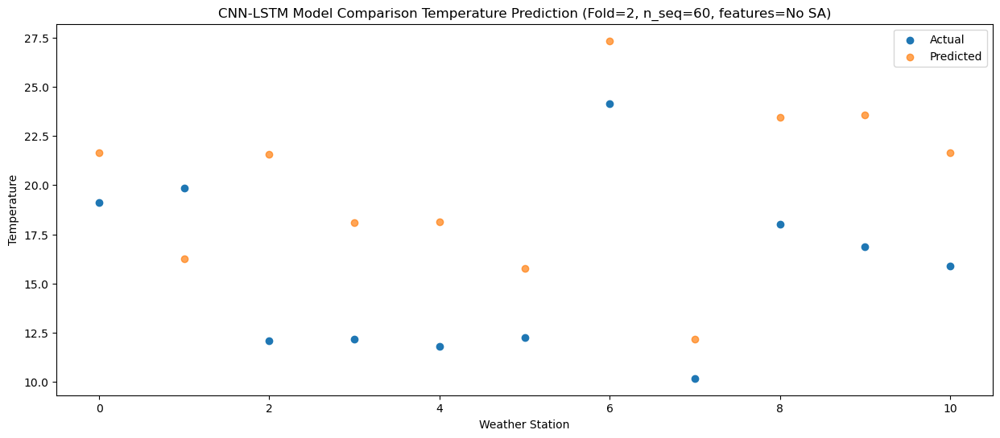

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  16.984276
1                 1   11.60  11.614290
2                 2   10.96  16.884287
3                 3    8.36  13.414274
4                 4    9.07  13.454302
5                 5    8.94  11.124309
6                 6   19.61  22.664291
7                 7    3.63   7.524307
8                 8   13.03  18.784303
9                 9   13.58  18.894294
10               10   12.12  16.984306


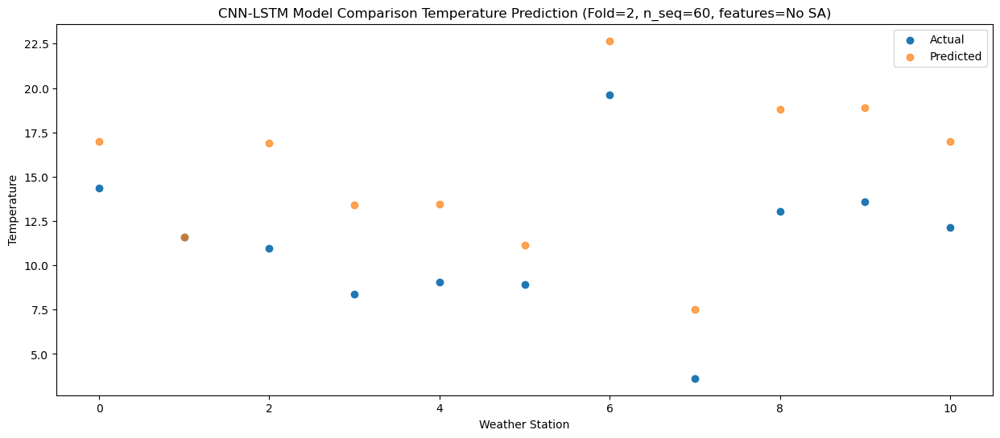

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   8.664318
1                 1    4.89   3.294329
2                 2    4.11   8.564332
3                 3    0.28   5.094317
4                 4    0.80   5.134346
5                 5    1.30   2.804353
6                 6   11.64  14.344333
7                 7   -1.77  -0.795652
8                 8   11.77  10.464345
9                 9    4.67  10.574339
10               10    1.90   8.664349


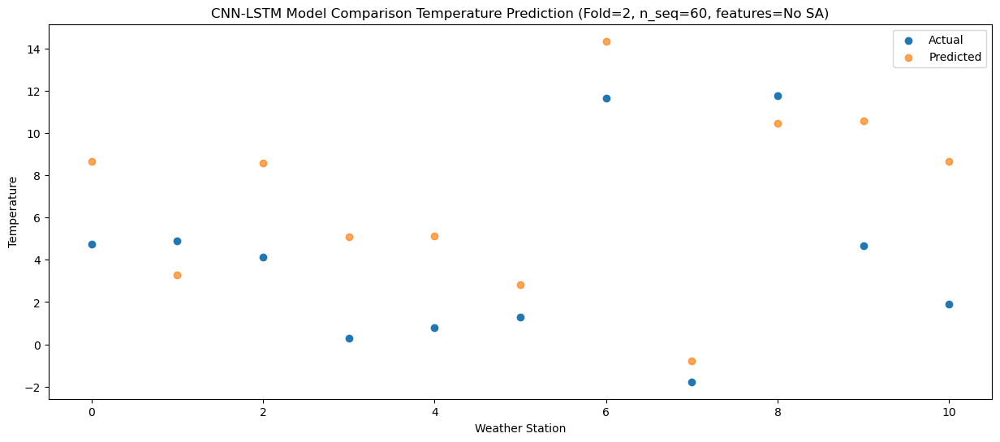

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   8.587946
1                 1    2.50   3.217955
2                 2    5.01   8.487954
3                 3   -1.64   5.017945
4                 4    4.21   5.057972
5                 5    4.54   2.727977
6                 6   13.93  14.267961
7                 7   -5.12  -0.872026
8                 8    5.26  10.387969
9                 9    6.59  10.497965
10               10    4.00   8.587973


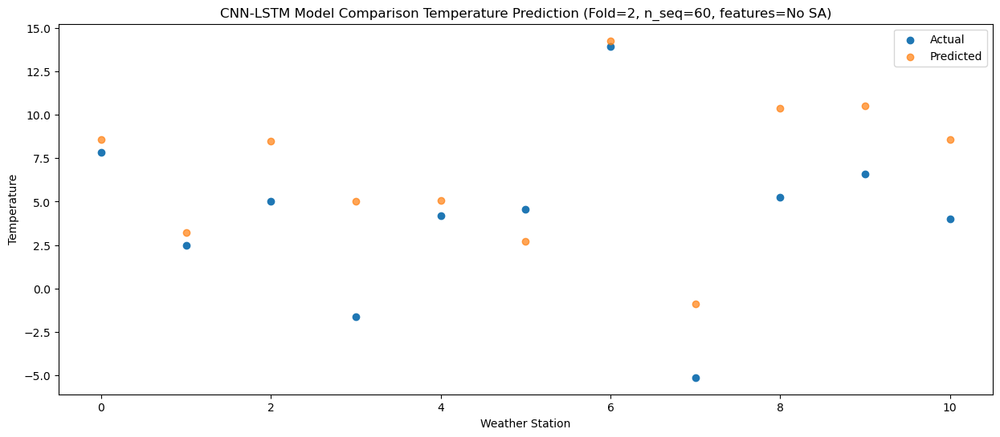

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48   1.288345
1                 1   -2.19  -4.081643
2                 2    0.75   1.188349
3                 3   -7.79  -2.281657
4                 4   -3.52  -2.241632
5                 5   -3.89  -4.571626
6                 6    5.45   6.968358
7                 7   -8.12  -8.171629
8                 8    7.67   3.088366
9                 9    0.11   3.198361
10               10   -2.87   1.288370


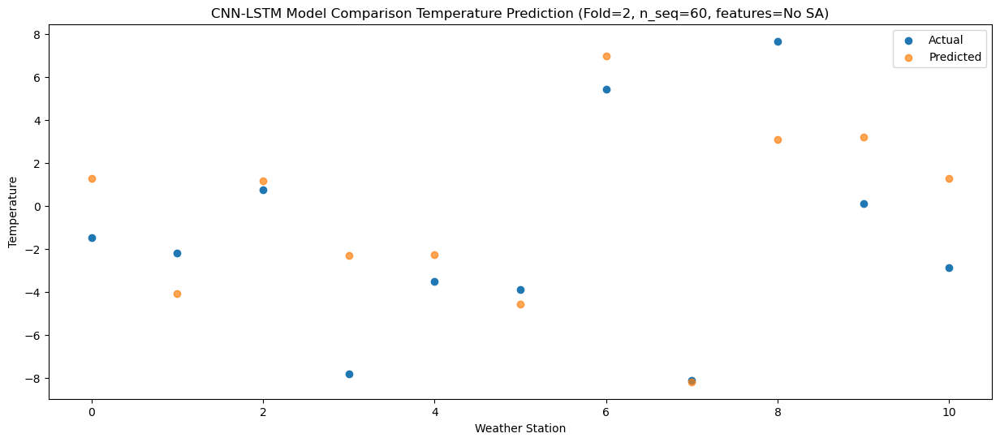

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   4.330644
1                 1   -2.20  -1.039344
2                 2    3.08   4.230644
3                 3   -5.47   0.760642
4                 4   -0.38   0.800665
5                 5   -4.27  -1.529329
6                 6    5.28  10.010657
7                 7   -7.15  -5.129332
8                 8    8.54   6.130661
9                 9    4.13   6.240656
10               10    1.72   4.330665


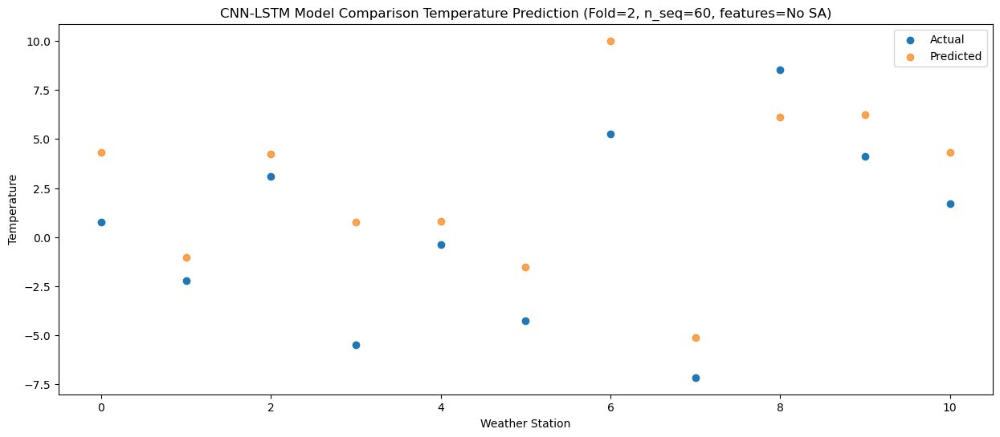

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05  10.766348
1                 1    4.78   5.396362
2                 2    6.55  10.666347
3                 3   -1.61   7.196346
4                 4    3.38   7.236370
5                 5    1.85   4.906370
6                 6   11.86  16.446362
7                 7   -2.09   1.306367
8                 8   10.33  12.566360
9                 9    8.24  12.676357
10               10    6.27  10.766364


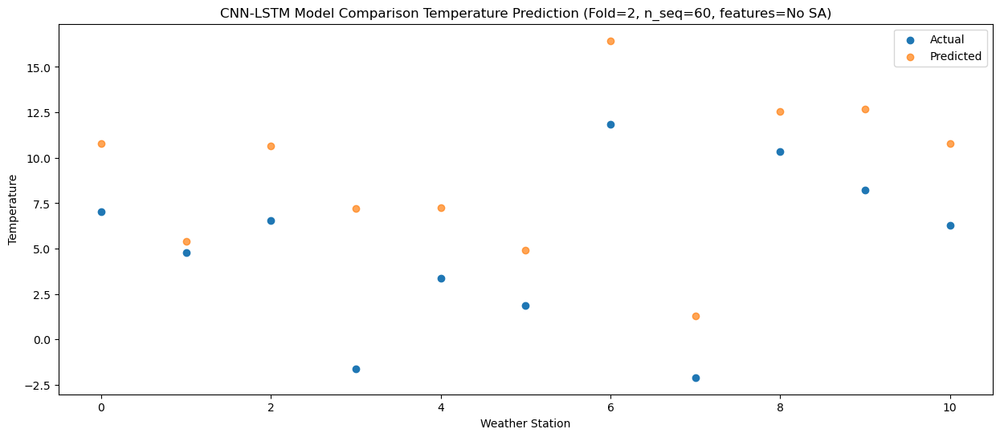

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  14.504853
1                 1   11.46   9.134871
2                 2    8.36  14.404849
3                 3    2.83  10.934851
4                 4    7.18  10.974874
5                 5    8.00   8.644874
6                 6   18.13  20.184868
7                 7    5.10   5.044873
8                 8   12.45  16.304866
9                 9   11.53  16.414861
10               10    9.43  14.504870


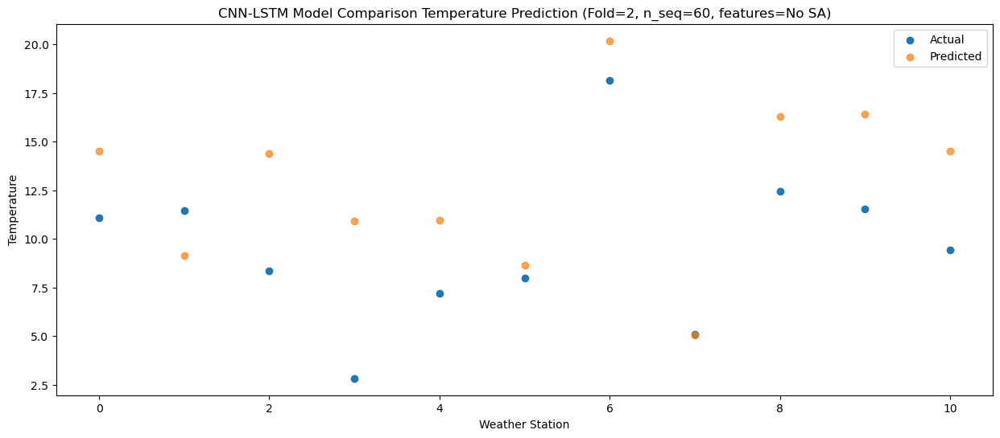

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  21.160553
1                 1   17.26  15.790571
2                 2   11.12  21.060549
3                 3    8.17  17.590549
4                 4   12.34  17.630576
5                 5   12.60  15.300574
6                 6   23.15  26.840566
7                 7    9.80  11.700573
8                 8   13.41  22.960566
9                 9   16.38  23.070563
10               10   15.67  21.160570


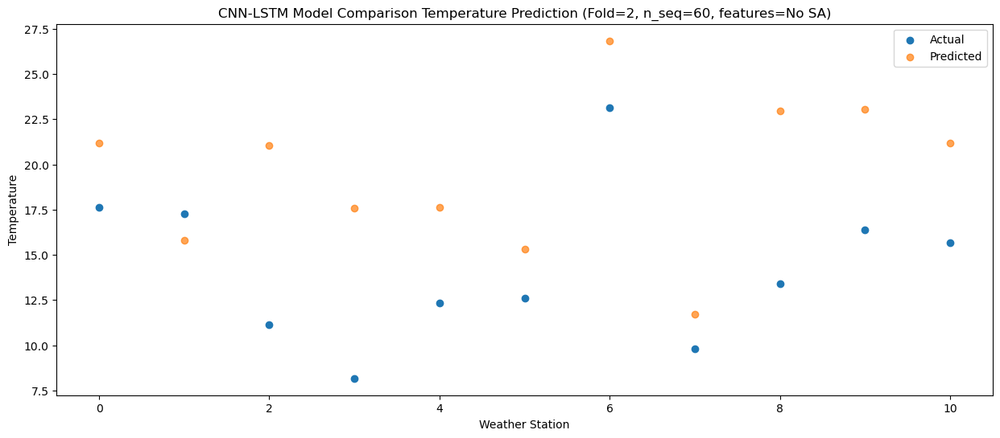

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  25.606515
1                 1   21.06  20.236533
2                 2   12.93  25.506507
3                 3   12.41  22.036509
4                 4   14.93  22.076533
5                 5   16.32  19.746531
6                 6   27.86  31.286525
7                 7   13.66  16.146531
8                 8   18.33  27.406523
9                 9   20.14  27.516520
10               10   19.32  25.606525


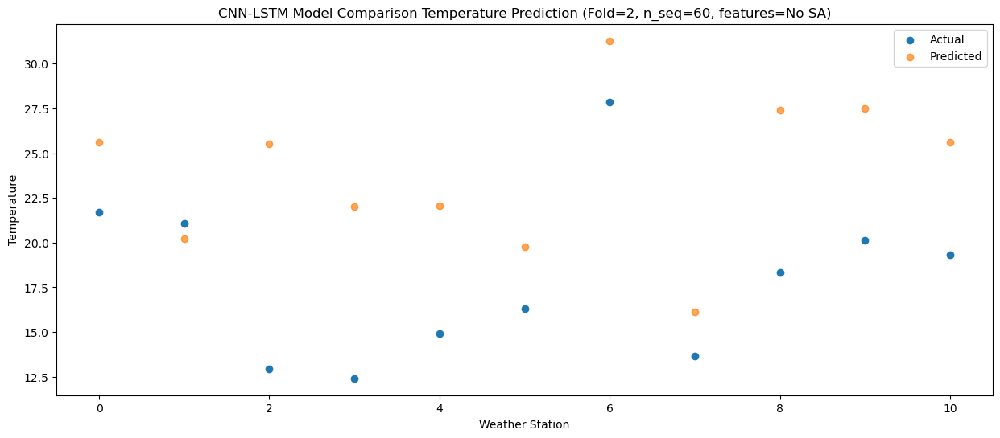

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  27.934304
1                 1   24.30  22.564316
2                 2   13.11  27.834298
3                 3   17.03  24.364300
4                 4   14.76  24.404322
5                 5   17.68  22.074322
6                 6   30.65  33.614316
7                 7   14.80  18.474322
8                 8   19.14  29.734314
9                 9   21.58  29.844311
10               10   20.67  27.934316


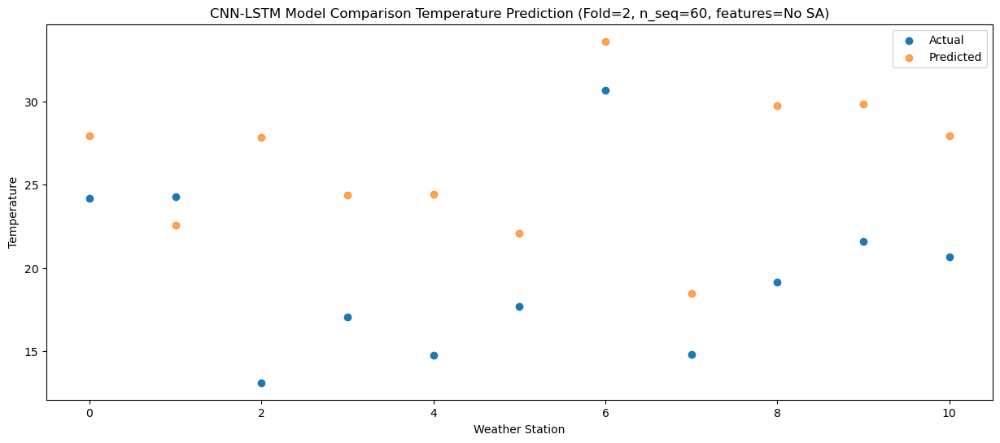

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  26.935864
1                 1   21.99  21.565880
2                 2   12.54  26.835848
3                 3   16.95  23.365860
4                 4   13.94  23.405874
5                 5   14.96  21.075878
6                 6   27.84  32.615876
7                 7   11.78  17.475880
8                 8   21.18  28.735870
9                 9   20.20  28.845864
10               10   19.42  26.935872


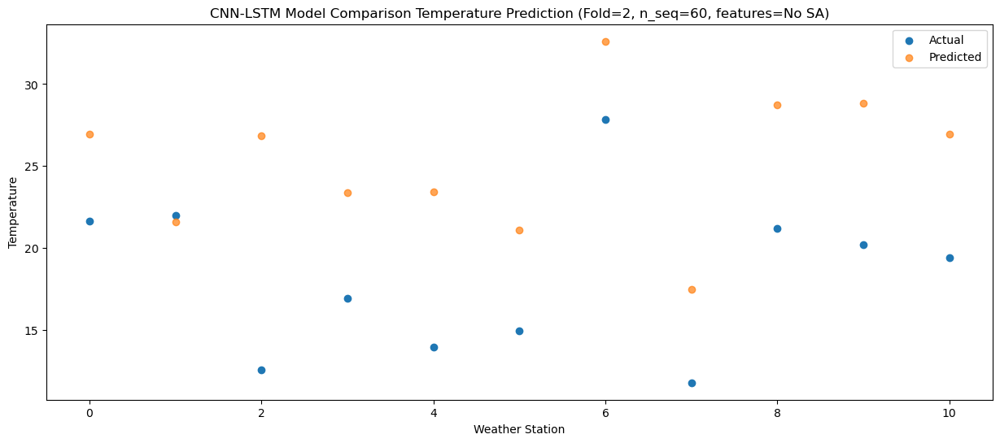

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  23.177309
1                 1   19.23  17.807326
2                 2   11.13  23.077292
3                 3   11.91  19.607303
4                 4   11.97  19.647319
5                 5   12.30  17.317322
6                 6   24.01  28.857320
7                 7   10.05  13.717322
8                 8   20.77  24.977315
9                 9   16.89  25.087307
10               10   15.27  23.177316


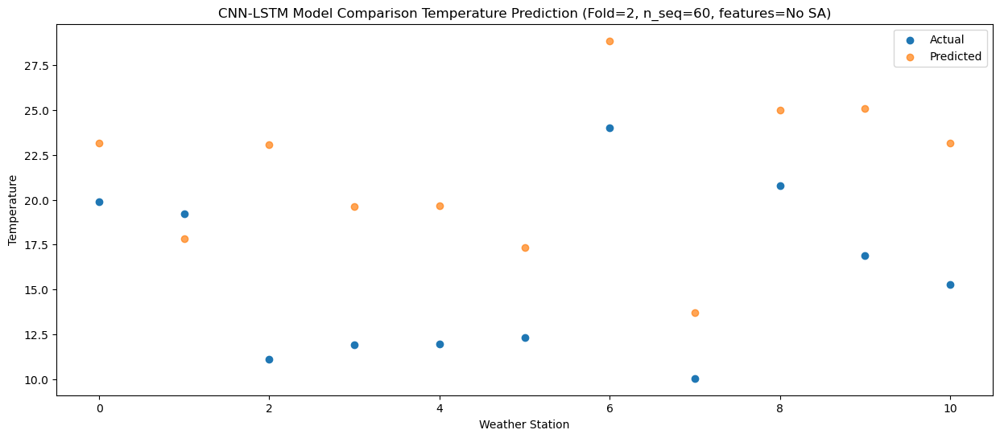

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  16.734497
1                 1   10.85  11.364516
2                 2    8.50  16.634479
3                 3    6.47  13.164492
4                 4    5.78  13.204504
5                 5    6.73  10.874508
6                 6   17.63  22.414509
7                 7    1.84   7.274511
8                 8   14.50  18.534502
9                 9    9.58  18.644493
10               10    7.99  16.734503


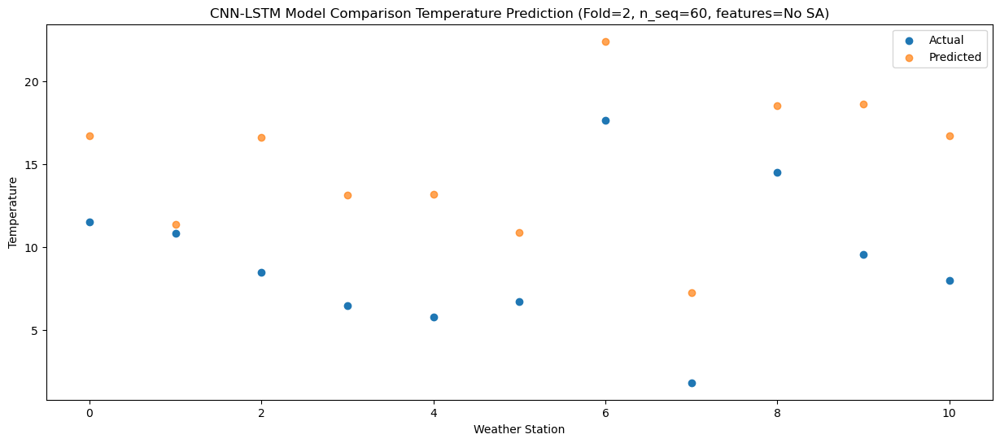

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41  11.027772
1                 1    0.86   5.657792
2                 2    6.74  10.927749
3                 3    2.67   7.457765
4                 4    2.71   7.497774
5                 5    0.85   5.167780
6                 6   10.96  16.707783
7                 7   -5.05   1.567783
8                 8    8.27  12.827774
9                 9    7.46  12.937764
10               10    5.54  11.027775


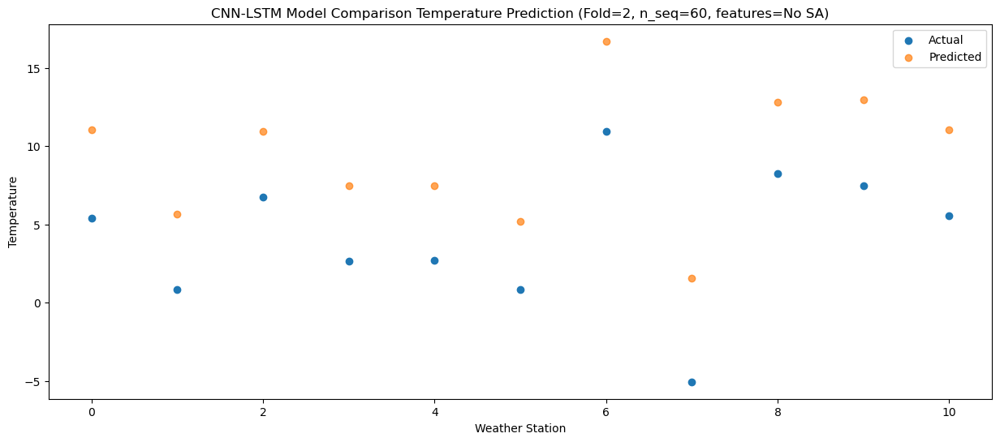

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   6.065225
1                 1   -1.85   0.695251
2                 2    2.64   5.965200
3                 3   -3.50   2.495219
4                 4    0.20   2.535225
5                 5   -1.38   0.205235
6                 6    8.34  11.745237
7                 7   -7.22  -3.394763
8                 8    5.57   7.865229
9                 9    0.93   7.975217
10               10    0.08   6.065230


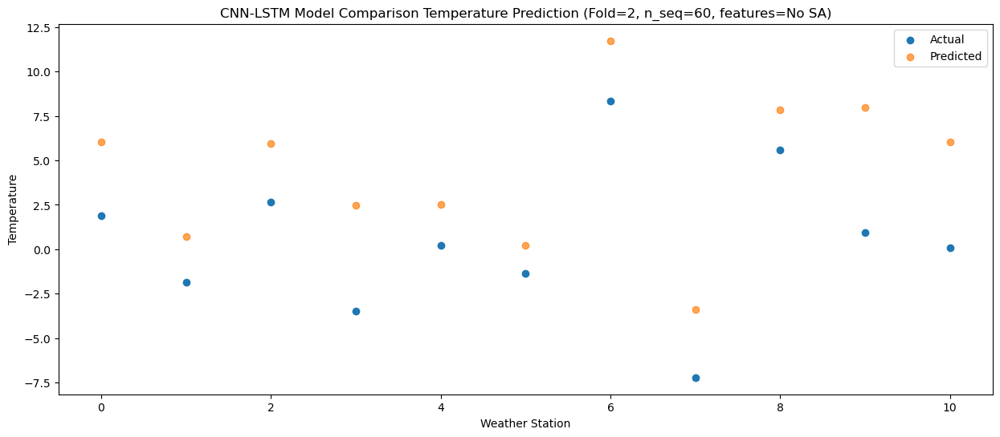

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   7.902513
1                 1   -2.10   2.532537
2                 2    2.44   7.802488
3                 3   -2.21   4.332507
4                 4    1.37   4.372513
5                 5   -0.62   2.042523
6                 6    9.22  13.582525
7                 7   -7.93  -1.557475
8                 8    5.23   9.702517
9                 9    4.13   9.812505
10               10    2.00   7.902518


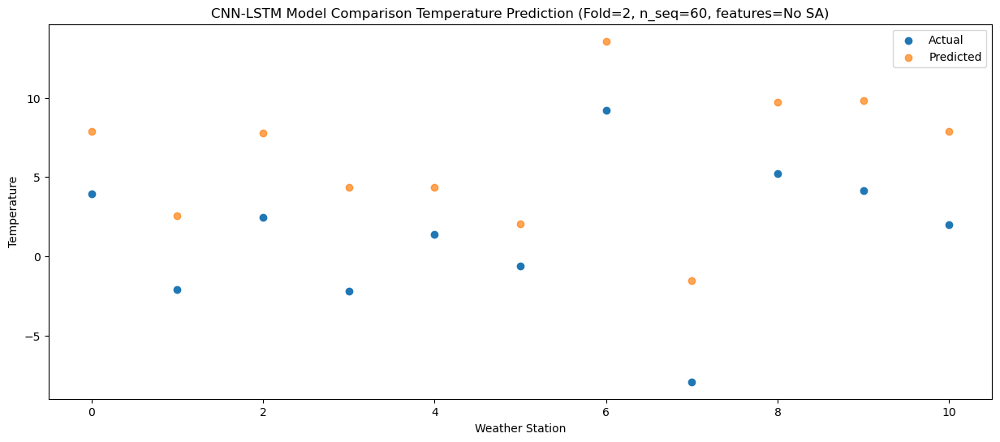

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   9.514197
1                 1   -0.50   4.144217
2                 2    5.50   9.414170
3                 3   -4.09   5.944193
4                 4    3.50   5.984193
5                 5    0.57   3.654206
6                 6    9.41  15.194210
7                 7   -6.72   0.054209
8                 8    4.91  11.314199
9                 9    7.15  11.424189
10               10    4.79   9.514200


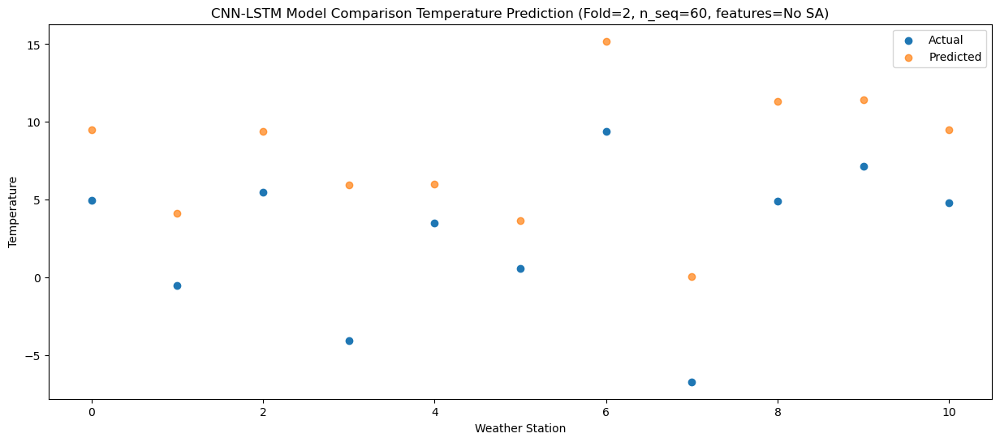

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21  11.298171
1                 1    3.57   5.928182
2                 2    6.52  11.198146
3                 3   -1.65   7.728164
4                 4    5.33   7.768169
5                 5    4.37   5.438182
6                 6   14.06  16.978182
7                 7   -2.02   1.838182
8                 8    5.92  13.098174
9                 9    7.60  13.208164
10               10    5.32  11.298175


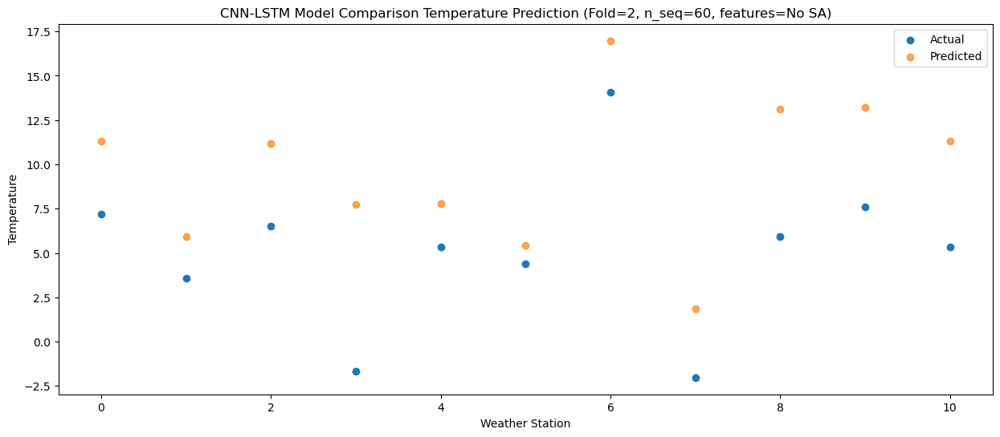

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  16.964213
1                 1    9.43  11.594221
2                 2    9.06  16.864194
3                 3    4.07  13.394207
4                 4    7.25  13.434215
5                 5    5.29  11.104230
6                 6   15.88  22.644224
7                 7    3.62   7.504228
8                 8    9.76  18.764223
9                 9   11.12  18.874211
10               10   10.21  16.964224


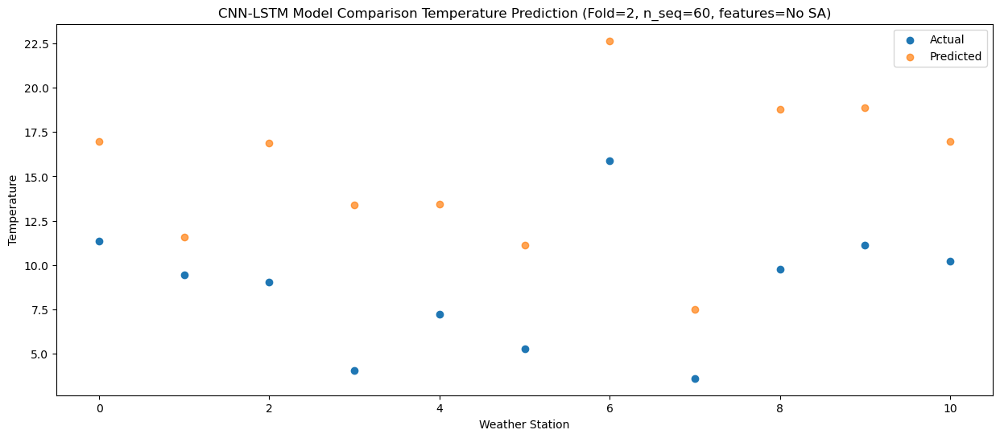

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  21.879337
1                 1   14.92  16.509345
2                 2   10.04  21.779311
3                 3    7.70  18.309329
4                 4   11.28  18.349333
5                 5   10.37  16.019352
6                 6   21.62  27.559348
7                 7    8.27  12.419352
8                 8   10.97  23.679345
9                 9   13.90  23.789331
10               10   13.56  21.879346


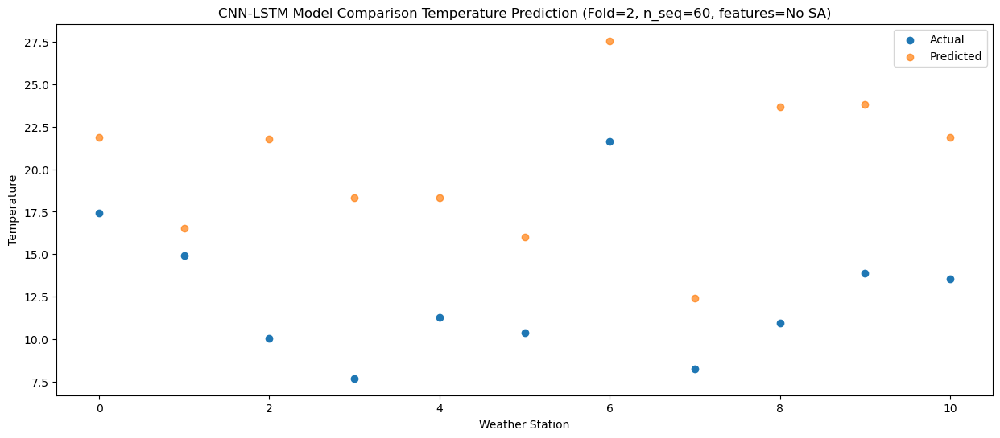

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  25.363934
1                 1   17.53  19.993950
2                 2   12.45  25.263908
3                 3   11.49  21.793926
4                 4   14.93  21.833930
5                 5   15.29  19.503952
6                 6   25.77  31.043947
7                 7   12.93  15.903953
8                 8   12.93  27.163944
9                 9   17.56  27.273930
10               10   16.47  25.363943


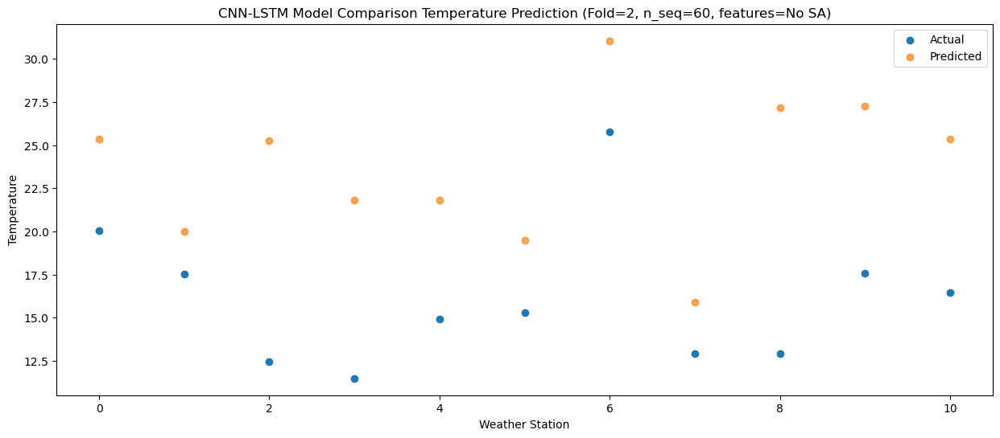

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  28.541508
1                 1   21.63  23.171518
2                 2   14.36  28.441487
3                 3   17.06  24.971500
4                 4   16.37  25.011506
5                 5   17.45  22.681528
6                 6   28.33  34.221523
7                 7   17.68  19.081529
8                 8   19.85  30.341520
9                 9   21.15  30.451506
10               10   20.02  28.541519


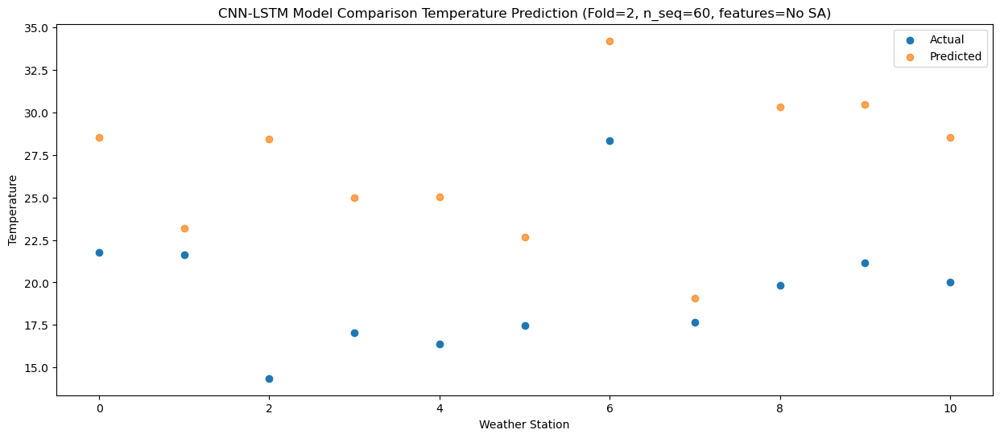

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  27.922056
1                 1   22.12  22.552062
2                 2   14.54  27.822038
3                 3   15.05  24.352048
4                 4   17.67  24.392057
5                 5   19.15  22.062077
6                 6   30.67  33.602071
7                 7   14.68  18.462080
8                 8   19.48  29.722069
9                 9   20.60  29.832056
10               10   19.31  27.922069


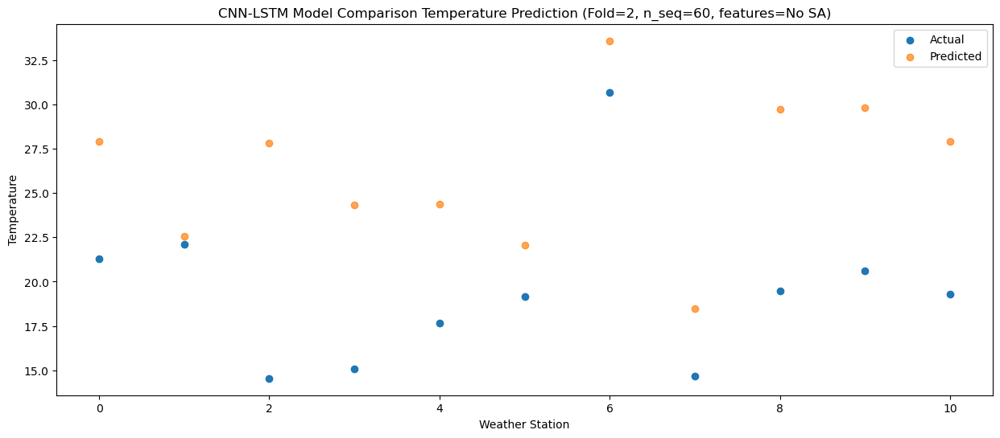

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  24.766528
1                 1   19.25  19.396531
2                 2   12.59  24.666518
3                 3   12.63  21.196520
4                 4   13.24  21.236534
5                 5   14.67  18.906552
6                 6   25.89  30.446544
7                 7   12.02  15.306553
8                 8   15.98  26.566543
9                 9   16.64  26.676532
10               10   16.53  24.766543


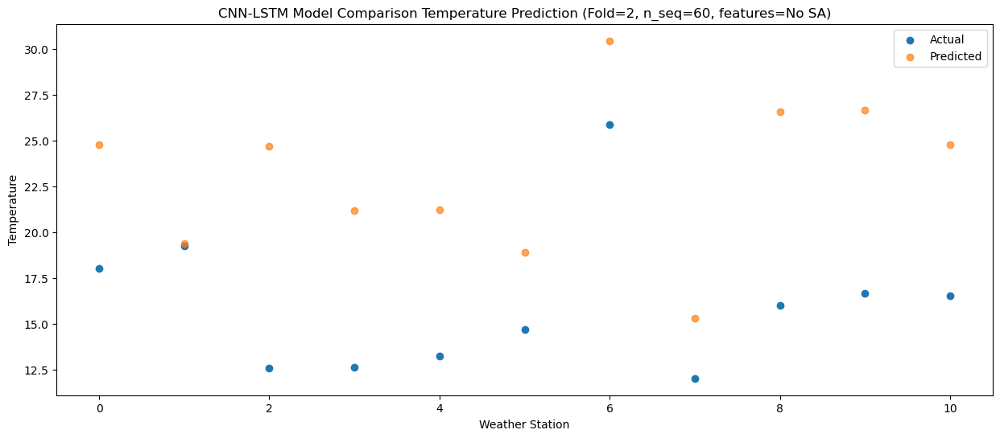

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  19.112685
1                 1   10.21  13.742688
2                 2    9.01  19.012672
3                 3    7.61  15.542676
4                 4    7.08  15.582691
5                 5    6.78  13.252706
6                 6   17.17  24.792700
7                 7    5.28   9.652707
8                 8   14.39  20.912698
9                 9   11.35  21.022687
10               10   10.48  19.112697


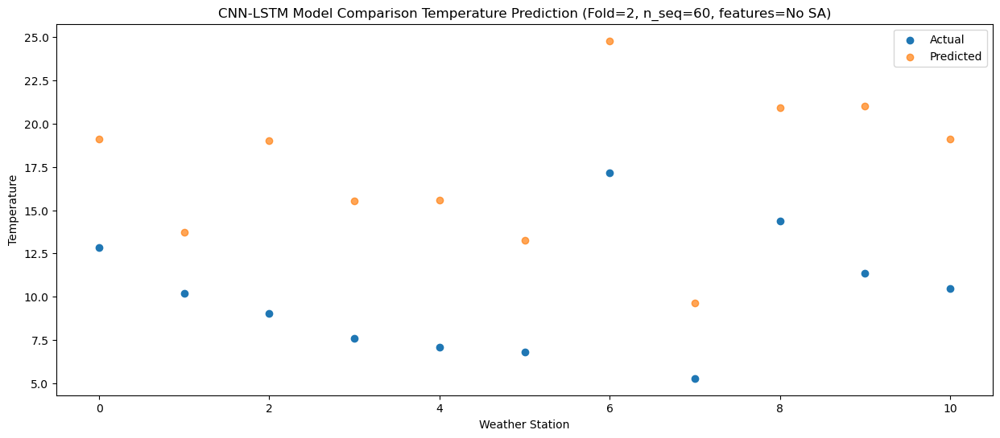

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74  12.350640
1                 1    3.49   6.980647
2                 2    5.03  12.250625
3                 3   -0.37   8.780632
4                 4    1.97   8.820644
5                 5    0.50   6.490662
6                 6   11.83  18.030656
7                 7   -1.83   2.890663
8                 8   10.00  14.150653
9                 9    5.45  14.260642
10               10    4.27  12.350653


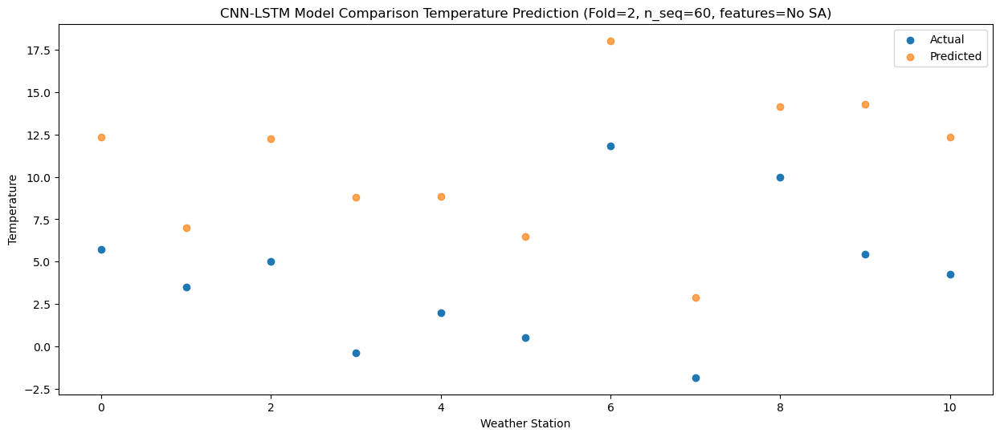

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68  10.430656
1                 1   -0.18   5.060665
2                 2    3.10  10.330641
3                 3   -1.11   6.860648
4                 4   -0.63   6.900660
5                 5   -1.61   4.570682
6                 6    8.85  16.110672
7                 7   -6.87   0.970681
8                 8    7.67  12.230671
9                 9    2.98  12.340660
10               10    1.42  10.430671


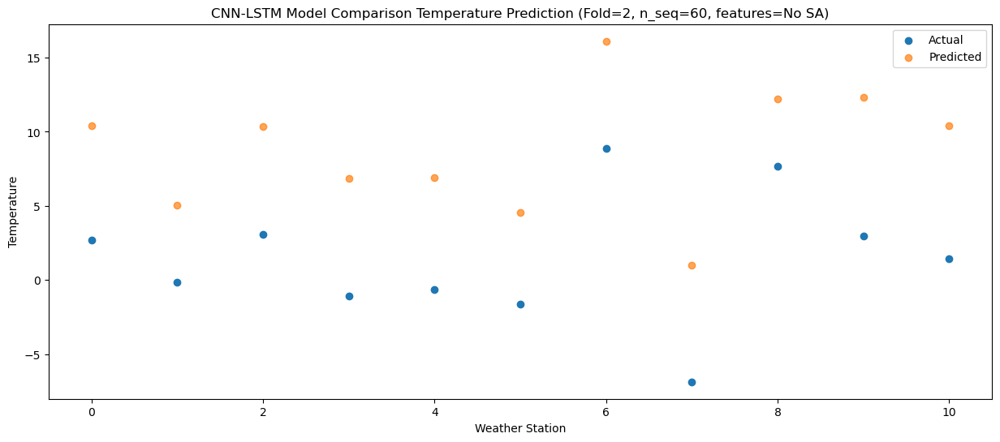

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11   5.320995
1                 1   -5.27  -0.048997
2                 2    1.10   5.220978
3                 3   -5.28   1.750987
4                 4   -2.71   1.790999
5                 5   -5.76  -0.538979
6                 6    3.67  11.001011
7                 7   -7.20  -4.138980
8                 8    5.87   7.121009
9                 9    1.13   7.230999
10               10   -1.90   5.321009


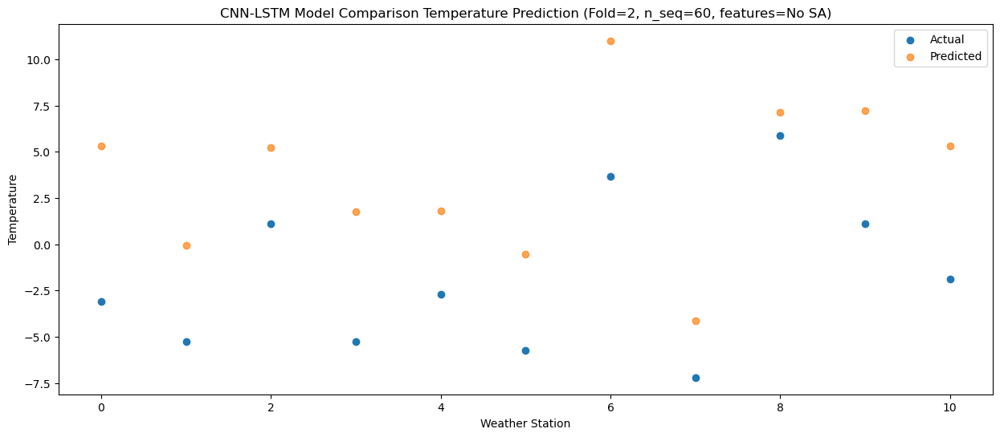

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21  11.143645
1                 1    2.21   5.773652
2                 2    1.58  11.043628
3                 3   -4.60   7.573635
4                 4    1.45   7.613651
5                 5    1.00   5.283669
6                 6   11.93  16.823661
7                 7   -3.99   1.683670
8                 8    6.40  12.943658
9                 9    4.35  13.053647
10               10    2.64  11.143657


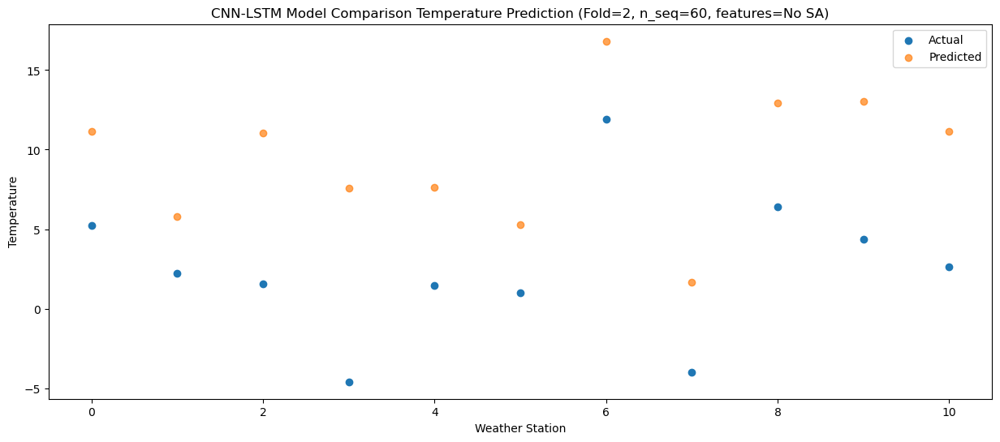

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10  14.512678
1                 1    4.98   9.142686
2                 2    6.00  14.412664
3                 3   -0.20  10.942667
4                 4    4.12  10.982686
5                 5    3.37   8.652699
6                 6   14.28  20.192693
7                 7   -1.42   5.052700
8                 8    7.34  16.312686
9                 9    7.91  16.422680
10               10    6.81  14.512686


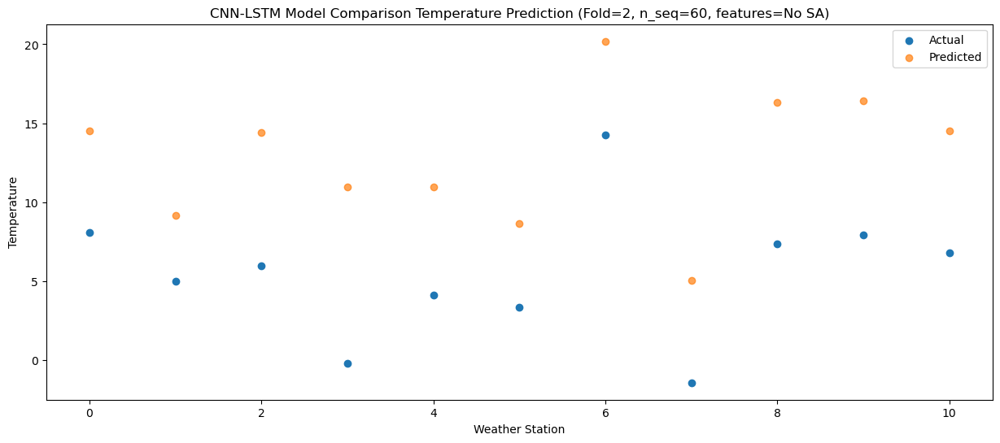

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  18.979223
1                 1   10.39  13.609227
2                 2    7.39  18.879201
3                 3    2.23  15.409213
4                 4    7.78  15.449227
5                 5    7.11  13.119241
6                 6   17.73  24.659238
7                 7    2.99   9.519245
8                 8    9.45  20.779229
9                 9   11.97  20.889219
10               10   10.79  18.979227


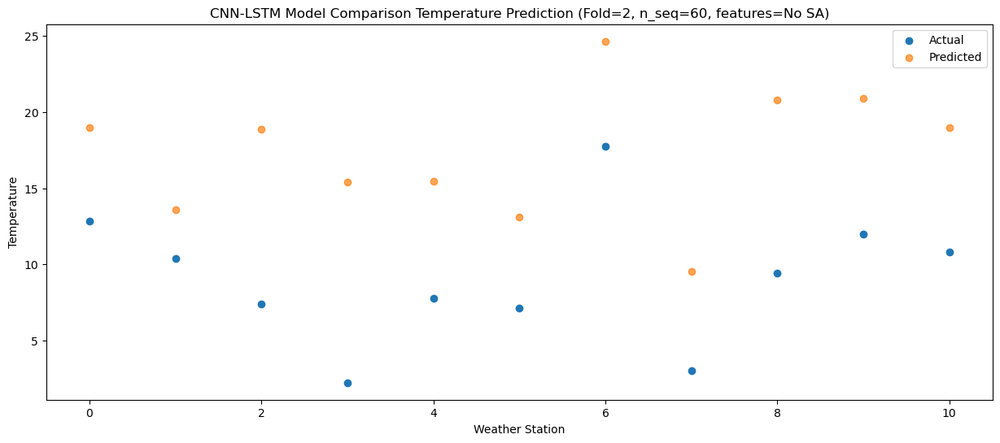

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  24.410711
1                 1   15.00  19.040714
2                 2   12.24  24.310694
3                 3    8.02  20.840701
4                 4   12.83  20.880720
5                 5   10.81  18.550732
6                 6   22.62  30.090727
7                 7    8.81  14.950736
8                 8   11.25  26.210720
9                 9   16.35  26.320708
10               10   15.25  24.410718


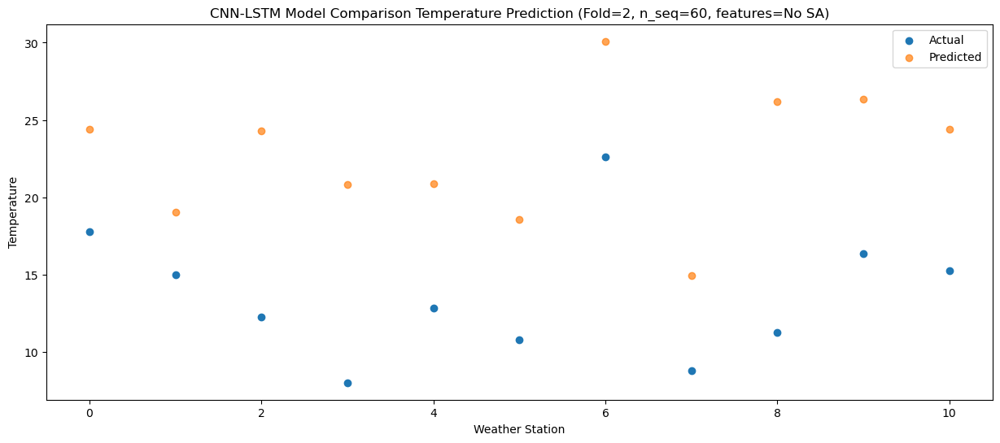

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  28.501857
1                 1   21.17  23.131862
2                 2   13.15  28.401840
3                 3   13.99  24.931849
4                 4   14.66  24.971863
5                 5   14.04  22.641880
6                 6   26.12  34.181875
7                 7   15.23  19.041884
8                 8   15.93  30.301868
9                 9   20.23  30.411855
10               10   19.60  28.501866


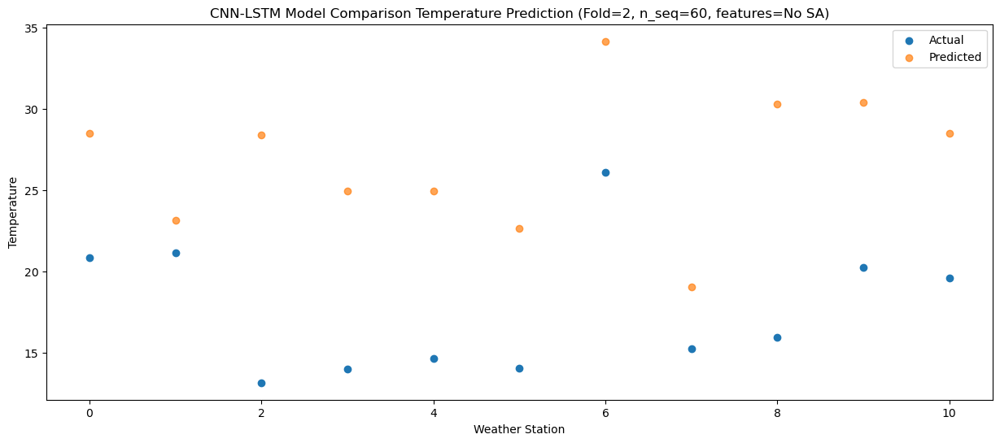

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  30.022393
1                 1   21.72  24.652396
2                 2   13.99  29.922374
3                 3   16.77  26.452385
4                 4   15.27  26.492400
5                 5   12.52  24.162416
6                 6   26.43  35.702411
7                 7   14.70  20.562417
8                 8   19.66  31.822404
9                 9   21.62  31.932392
10               10   20.83  30.022402


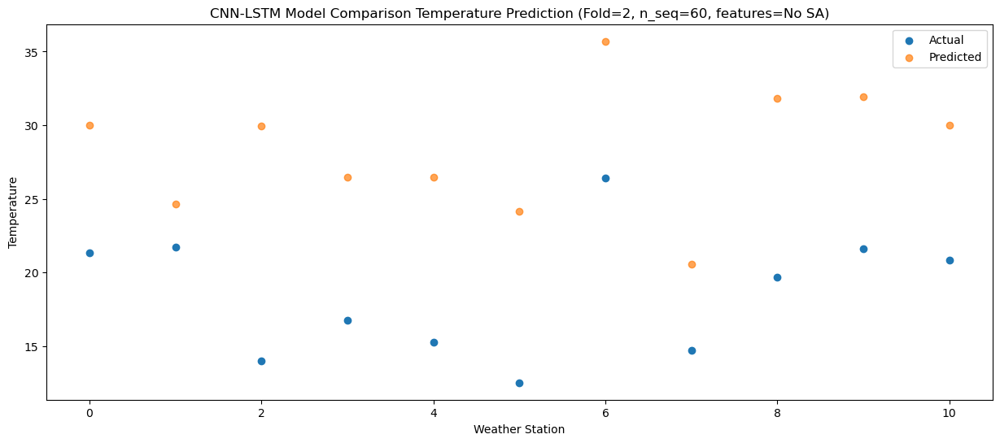

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  29.255661
1                 1   21.77  23.885671
2                 2   13.95  29.155634
3                 3   15.06  25.685653
4                 4   15.62  25.725659
5                 5   14.17  23.395681
6                 6   28.23  34.935679
7                 7   15.09  19.795683
8                 8   19.24  31.055670
9                 9   19.60  31.165654
10               10   19.21  29.255669


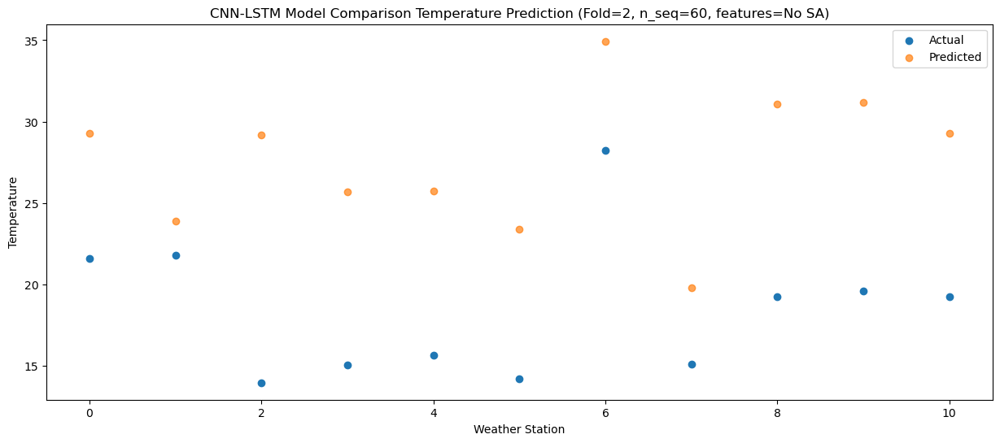

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  26.210717
1                 1   18.04  20.840731
2                 2   13.63  26.110682
3                 3   11.54  22.640707
4                 4   12.82  22.680707
5                 5   11.44  20.350733
6                 6   24.00  31.890733
7                 7   11.06  16.750735
8                 8   17.39  28.010722
9                 9   16.64  28.120704
10               10   16.62  26.210721


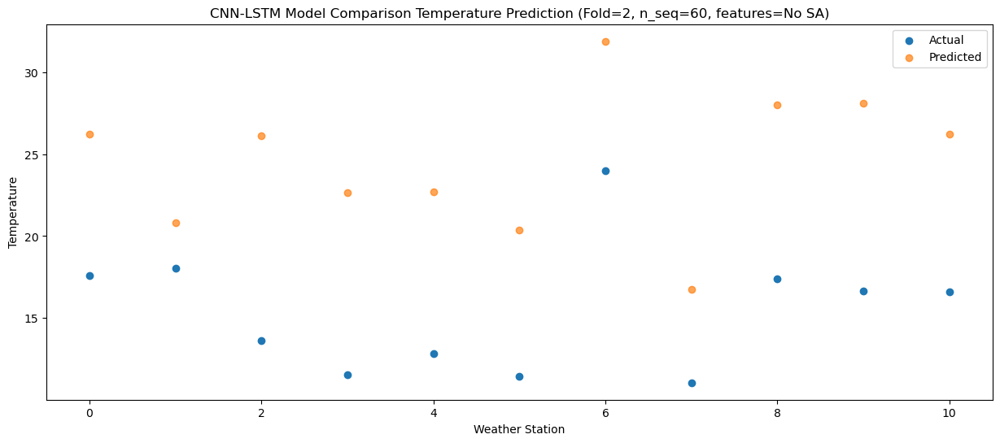

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  21.002723
1                 1   13.07  15.632735
2                 2   10.16  20.902692
3                 3    6.28  17.432713
4                 4    8.13  17.472717
5                 5    8.79  15.142741
6                 6   21.03  26.682739
7                 7    6.80  11.542743
8                 8   14.40  22.802728
9                 9   11.42  22.912712
10               10   10.20  21.002729


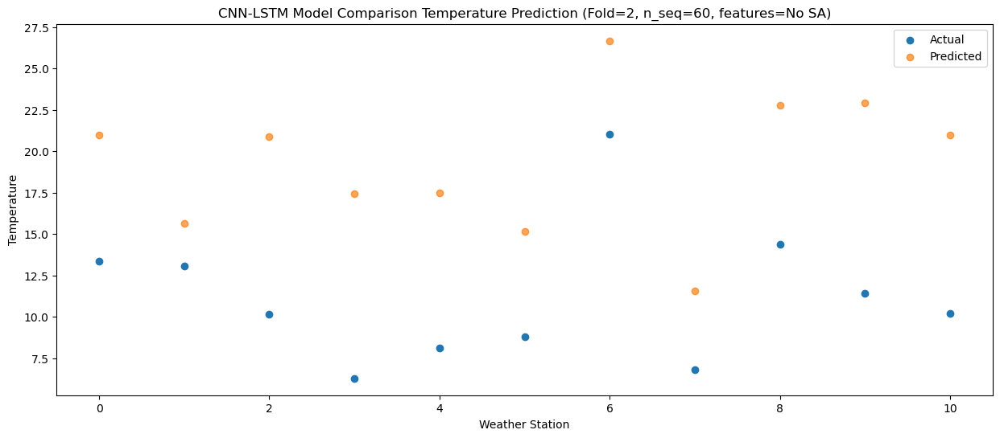

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 256)            464896    
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 256)           0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 256)            0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 1024)           5246976   
                                                                 
 dropout_13 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_9 (LSTM)               (None, 1024)              8392704   
                                                      

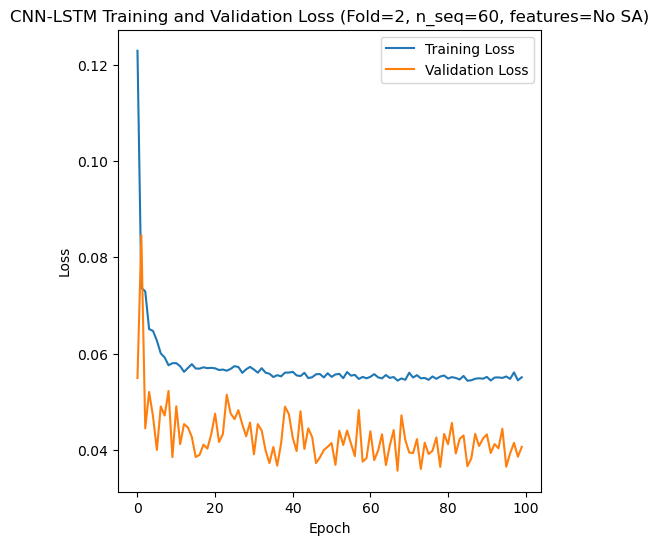

Epoch 1/100
84/84 [==============================] - 10s 62ms/step - loss: 0.1132 - accuracy: 0.3810 - mae: 0.0935 - rmse: 0.1132 - mape: 21.1551 - pearson: 0.7015 - val_loss: 0.0908 - val_accuracy: 0.5000 - val_mae: 0.0740 - val_rmse: 0.0908 - val_mape: 16.9060 - val_pearson: 0.7460
Epoch 2/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0764 - accuracy: 0.4405 - mae: 0.0615 - rmse: 0.0764 - mape: 14.1489 - pearson: 0.8151 - val_loss: 0.0830 - val_accuracy: 0.5000 - val_mae: 0.0663 - val_rmse: 0.0830 - val_mape: 15.3656 - val_pearson: 0.7397
Epoch 3/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0660 - accuracy: 0.5119 - mae: 0.0525 - rmse: 0.0660 - mape: 12.2912 - pearson: 0.8370 - val_loss: 0.0695 - val_accuracy: 0.5000 - val_mae: 0.0546 - val_rmse: 0.0695 - val_mape: 12.3600 - val_pearson: 0.8158
Epoch 4/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0632 - accuracy: 0.4405 - mae: 0.0502 - rmse: 0.0632 - mape: 11.6324 - 

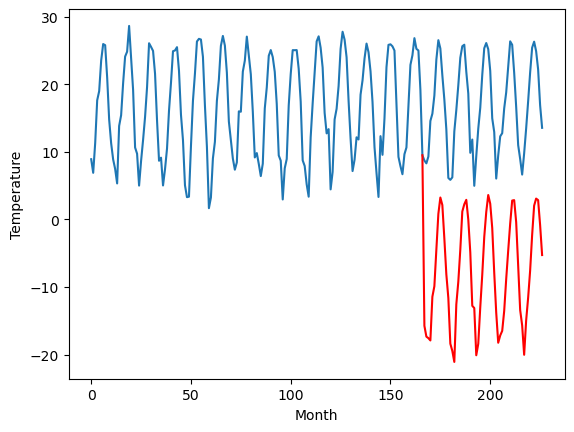

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		2.08		-0.81
1.54		0.48		-1.06
0.70		0.25		-0.45
0.85		-0.09		-0.94
8.34		6.37		-1.97
9.26		7.93		-1.33
13.66		13.35		-0.31
20.76		18.63		-2.13
22.62		21.05		-1.57
20.76		19.93		-0.83
17.09		15.00		-2.09
9.98		9.69		-0.29
7.16		6.19		-0.97
0.61		-0.57		-1.18
-0.54		-1.64		-1.10
-4.26		-3.26		1.00
7.71		5.25		-2.46
9.57		8.60		-0.97
13.79		13.34		-0.45
20.50		18.98		-1.52
21.81		20.05		-1.76
22.38		20.71		-1.67
19.65		17.79		-1.86
13.05		12.94		-0.11
5.34		5.04		-0.30
6.65		4.70		-1.95
-2.18		-2.28		-0.10
-0.96		-0.58		0.38
5.82		4.81		-1.01
10.67		9.63		-1.04
16.10		15.21		-0.89
21.25		18.90		-2.35
25.29		21.42		-3.87
22.21		20.13		-2.08
18.35		16.54		-1.81
11.80		9.95		-1.85
4.57		4.02		-0.55
0.52		-0.42		-0.94
1.22		0.65		-0.57
3.18		1.33		-1.85
5.78		4.28		-1.50
10.83		8.99		-1.84
16.14		13.18		-2.96
20.47		17.19		-3.28
22.73		20.60		-2.13
22.91		20.66		-2.25
18.86		17.41		-1.45
11.92

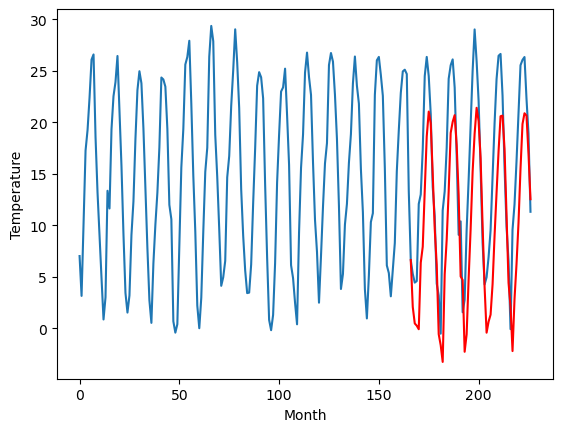

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		1.55		-3.18
2.20		-0.05		-2.25
0.98		-0.28		-1.26
3.40		-0.62		-4.02
5.19		5.84		0.65
9.85		7.40		-2.45
15.04		12.82		-2.22
18.39		18.10		-0.29
21.17		20.52		-0.65
21.70		19.40		-2.30
17.37		14.47		-2.90
11.88		9.16		-2.72
3.23		5.66		2.43
0.03		-1.10		-1.13
1.29		-2.17		-3.46
3.59		-3.79		-7.38
4.74		4.72		-0.02
10.47		8.07		-2.40
15.27		12.81		-2.46
20.12		18.45		-1.67
23.25		19.52		-3.73
21.05		20.18		-0.87
17.74		17.26		-0.48
9.08		12.41		3.33
4.74		4.51		-0.23
0.82		4.17		3.35
0.49		-2.81		-3.30
2.19		-1.11		-3.30
6.90		4.28		-2.62
9.97		9.10		-0.87
14.21		14.68		0.47
19.60		18.37		-1.23
22.17		20.89		-1.28
22.35		19.60		-2.75
19.53		16.01		-3.52
12.35		9.42		-2.93
1.62		3.49		1.87
0.66		-0.95		-1.61
2.05		0.12		-1.93
1.20		0.80		-0.40
4.07		3.75		-0.32
9.70		8.46		-1.24
14.14		12.65		-1.49
16.94		16.66		-0.28
22.60		20.07		-2.53
20.91		20.13		-0.78
17.14		16.88		-0.26
11.83		10.46

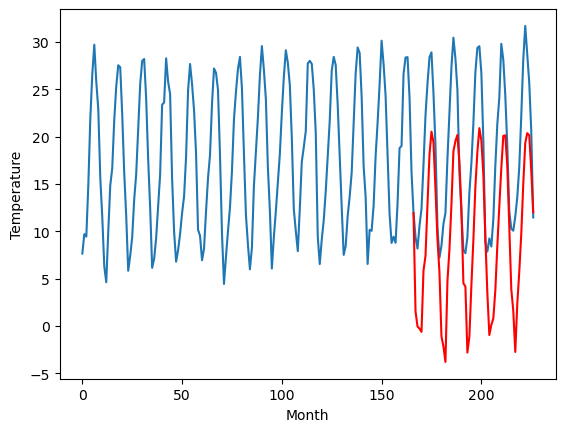

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-4.29		3.02
-7.30		-5.89		1.41
-7.85		-6.12		1.73
-8.20		-6.46		1.74
-1.29		0.00		1.29
-0.65		1.56		2.21
3.92		6.98		3.06
9.74		12.26		2.52
13.54		14.68		1.14
11.12		13.56		2.44
7.06		8.63		1.57
1.64		3.32		1.68
-2.28		-0.18		2.10
-9.48		-6.94		2.54
-10.94		-8.01		2.93
-12.26		-9.63		2.63
-2.05		-1.12		0.93
0.30		2.23		1.93
4.37		6.97		2.60
10.29		12.61		2.32
11.28		13.68		2.40
11.80		14.34		2.54
7.67		11.42		3.75
4.09		6.57		2.48
-5.57		-1.33		4.24
-4.08		-1.67		2.41
-13.03		-8.65		4.38
-8.51		-6.95		1.56
-2.76		-1.56		1.20
0.25		3.26		3.01
7.03		8.84		1.81
10.51		12.53		2.02
12.06		15.05		2.99
10.99		13.76		2.77
7.01		10.17		3.16
-0.26		3.58		3.84
-3.38		-2.35		1.03
-8.65		-6.79		1.86
-6.90		-5.72		1.18
-4.56		-5.04		-0.48
-4.32		-2.09		2.23
1.92		2.62		0.70
4.61		6.81		2.20
8.35		10.82		2.47
11.97		14.23		2.26
10.86		14.29		3.43
8.13		11.04		2.91
2.69		4.62		1.93
-3.70		-1.95		1.75


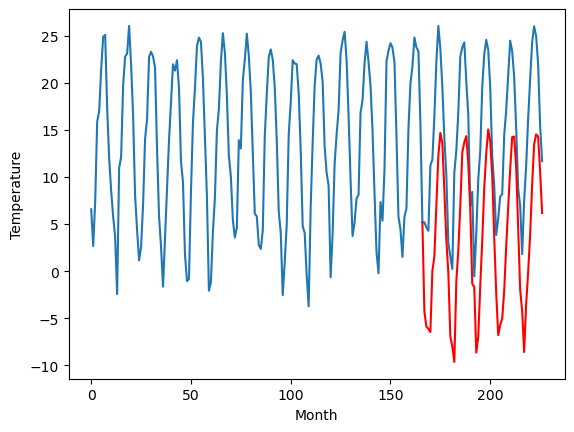

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		1.41		-4.23
2.38		-0.19		-2.57
-0.49		-0.42		0.07
0.66		-0.76		-1.42
8.07		5.70		-2.37
11.10		7.26		-3.84
17.17		12.68		-4.49
24.22		17.96		-6.26
25.68		20.38		-5.30
23.12		19.26		-3.86
19.05		14.33		-4.72
11.32		9.02		-2.30
8.50		5.52		-2.98
1.33		-1.24		-2.57
-0.14		-2.31		-2.17
-4.01		-3.93		0.08
9.07		4.58		-4.49
12.36		7.93		-4.43
16.93		12.67		-4.26
24.41		18.31		-6.10
24.41		19.38		-5.03
24.53		20.04		-4.49
21.17		17.12		-4.05
15.75		12.27		-3.48
6.01		4.37		-1.64
5.65		4.03		-1.62
-3.82		-2.95		0.87
-1.30		-1.25		0.05
7.16		4.14		-3.02
11.29		8.96		-2.33
18.86		14.54		-4.32
24.31		18.23		-6.08
25.43		20.75		-4.68
23.61		19.46		-4.15
19.29		15.87		-3.42
12.02		9.28		-2.74
6.13		3.35		-2.78
0.16		-1.09		-1.25
1.88		-0.02		-1.90
8.40		0.66		-7.74
5.44		3.61		-1.83
12.65		8.32		-4.33
18.65		12.51		-6.14
22.75		16.52		-6.23
24.45		19.93		-4.52
23.16		19.99		-3.17
19.80		16.74		-3.06


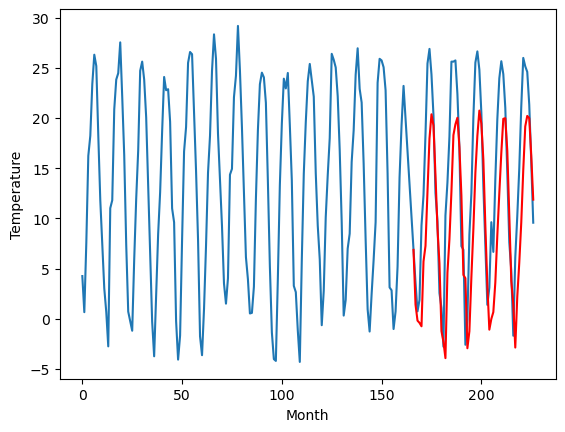

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-0.47		2.58
-2.84		-2.07		0.77
-4.26		-2.30		1.96
-4.67		-2.64		2.03
2.19		3.82		1.63
4.46		5.38		0.92
9.87		10.80		0.93
16.86		16.08		-0.78
18.75		18.50		-0.25
16.24		17.38		1.14
12.61		12.45		-0.16
6.61		7.14		0.53
2.67		3.64		0.97
-4.94		-3.12		1.82
-6.39		-4.19		2.20
-9.11		-5.81		3.30
2.22		2.70		0.48
5.67		6.05		0.38
9.95		10.79		0.84
16.66		16.43		-0.23
17.04		17.50		0.46
17.36		18.16		0.80
14.10		15.24		1.14
9.52		10.39		0.87
-1.33		2.49		3.82
-0.28		2.15		2.43
-9.10		-4.83		4.27
-5.91		-3.13		2.78
1.05		2.26		1.21
4.90		7.08		2.18
12.70		12.66		-0.04
16.64		16.35		-0.29
18.63		18.87		0.24
16.98		17.58		0.60
13.03		13.99		0.96
6.99		7.40		0.41
0.44		1.47		1.03
-5.10		-2.97		2.13
-2.96		-1.90		1.06
-1.24		-1.22		0.02
-0.34		1.73		2.07
5.89		6.44		0.55
11.30		10.63		-0.67
14.76		14.64		-0.12
18.02		18.05		0.03
16.47		18.11		1.64
13.01		14.86		1.85
7.36		8.44		1.08
0.88		1.87		0.9

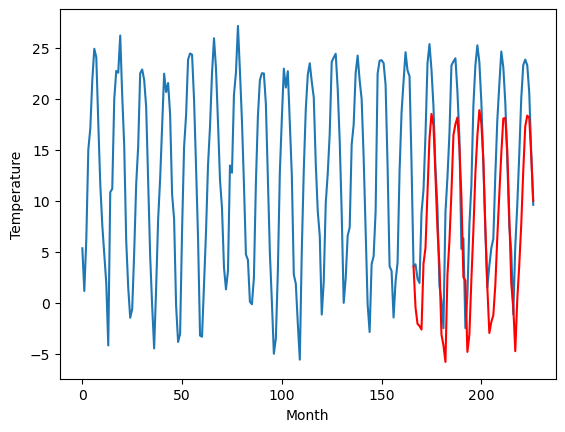

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		0.16		4.30
-9.81		-1.44		8.37
-9.90		-1.67		8.23
-9.71		-2.01		7.70
-4.78		4.45		9.23
-1.80		6.01		7.81
5.31		11.43		6.12
9.52		16.71		7.19
11.51		19.13		7.62
12.26		18.01		5.75
6.76		13.08		6.32
3.02		7.77		4.75
-4.17		4.27		8.44
-9.87		-2.49		7.38
-9.60		-3.56		6.04
-9.50		-5.18		4.32
-6.53		3.33		9.86
-1.75		6.68		8.43
3.30		11.42		8.12
10.69		17.06		6.37
12.53		18.13		5.60
10.61		18.79		8.18
8.74		15.87		7.13
0.77		11.02		10.25
-1.97		3.12		5.09
-6.73		2.78		9.51
-9.02		-4.20		4.82
-10.74		-2.50		8.24
-6.20		2.89		9.09
-1.88		7.71		9.59
4.03		13.29		9.26
9.80		16.98		7.18
11.72		19.50		7.78
10.96		18.21		7.25
8.80		14.62		5.82
0.54		8.03		7.49
-7.14		2.10		9.24
-9.31		-2.34		6.97
-10.04		-1.27		8.77
-10.01		-0.59		9.42
-8.22		2.36		10.58
-2.88		7.07		9.95
4.33		11.26		6.93
8.91		15.27		6.36
15.05		18.68		3.63
12.46		18.74		6.28
8.31		15.49		7.18
2.18		9.07		6.89
-3.68		2.50		6.18
-

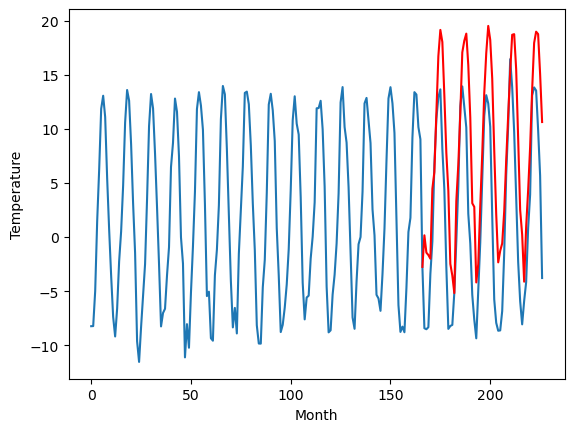

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		-0.92		-2.57
-3.08		-2.52		0.56
-1.92		-2.75		-0.83
-0.41		-3.09		-2.68
2.70		3.37		0.67
8.61		4.93		-3.68
15.88		10.35		-5.53
19.34		15.63		-3.71
23.57		18.05		-5.52
23.68		16.93		-6.75
18.87		12.00		-6.87
11.93		6.69		-5.24
3.12		3.19		0.07
-2.57		-3.57		-1.00
-2.02		-4.64		-2.62
0.83		-6.26		-7.09
2.43		2.25		-0.18
10.40		5.60		-4.80
14.83		10.34		-4.49
22.47		15.98		-6.49
23.55		17.05		-6.50
22.32		17.71		-4.61
18.35		14.79		-3.56
8.00		9.94		1.94
5.48		2.04		-3.44
-1.79		1.70		3.49
-1.86		-5.28		-3.42
0.18		-3.58		-3.76
4.89		1.81		-3.08
9.52		6.63		-2.89
14.19		12.21		-1.98
20.67		15.90		-4.77
22.90		18.42		-4.48
21.31		17.13		-4.18
18.95		13.54		-5.41
11.06		6.95		-4.11
-0.36		1.02		1.38
-2.69		-3.42		-0.73
-3.20		-2.35		0.85
-2.29		-1.67		0.62
0.54		1.28		0.74
8.49		5.99		-2.50
14.29		10.18		-4.11
16.79		14.19		-2.60
25.15		17.60		-7.55
20.52		17.66		-2.86
15.82		14.41		-1.41
10

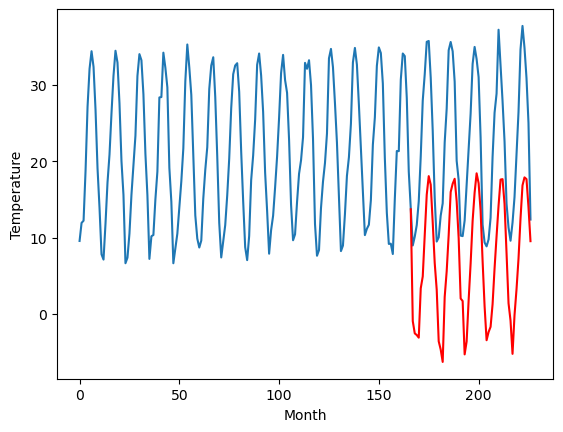

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-3.24		-3.20
-1.29		-4.84		-3.55
-1.92		-5.07		-3.15
0.10		-5.41		-5.51
-0.46		1.05		1.51
3.16		2.61		-0.55
5.56		8.03		2.47
8.10		13.31		5.21
7.29		15.73		8.44
9.17		14.61		5.44
8.59		9.68		1.09
6.37		4.37		-2.00
-0.79		0.87		1.66
-2.84		-5.89		-3.05
-1.62		-6.96		-5.34
-0.69		-8.58		-7.89
-0.91		-0.07		0.84
1.28		3.28		2.00
5.57		8.02		2.45
7.27		13.66		6.39
6.45		14.73		8.28
7.00		15.39		8.39
6.45		12.47		6.02
3.69		7.62		3.93
0.87		-0.28		-1.15
-2.83		-0.62		2.21
-2.21		-7.60		-5.39
-1.25		-5.90		-4.65
0.98		-0.51		-1.49
2.42		4.31		1.89
5.41		9.89		4.48
8.56		13.58		5.02
6.91		16.10		9.19
8.33		14.81		6.48
8.56		11.22		2.66
3.83		4.63		0.80
-1.90		-1.30		0.60
-3.10		-5.74		-2.64
-1.43		-4.67		-3.24
-3.23		-3.99		-0.76
-1.77		-1.04		0.73
2.31		3.67		1.36
3.34		7.86		4.52
5.24		11.87		6.63
8.25		15.28		7.03
9.28		15.34		6.06
6.67		12.09		5.42
5.21		5.67		0.46
1.17		-0.90		-2.07
-0.6

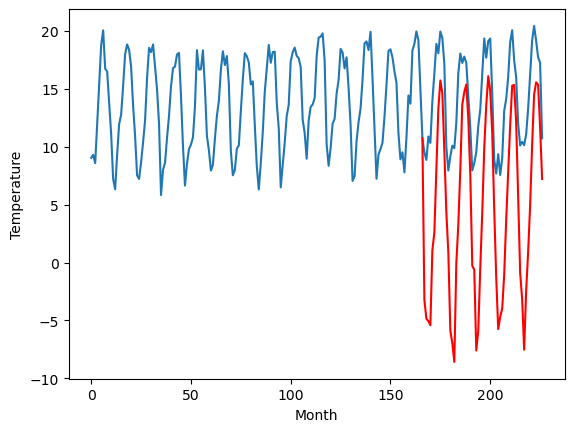

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-2.16		0.92
-5.84		-3.76		2.08
-5.81		-3.99		1.82
-5.37		-4.33		1.04
-1.79		2.13		3.92
-0.35		3.69		4.04
5.21		9.11		3.90
12.19		14.39		2.20
16.14		16.81		0.67
14.96		15.69		0.73
10.62		10.76		0.14
5.30		5.45		0.15
1.23		1.95		0.72
-5.11		-4.81		0.30
-8.13		-5.88		2.25
-8.25		-7.50		0.75
-3.25		1.01		4.26
1.37		4.36		2.99
6.20		9.10		2.90
12.07		14.74		2.67
14.21		15.81		1.60
14.83		16.47		1.64
11.51		13.55		2.04
7.07		8.70		1.63
-1.85		0.80		2.65
-3.45		0.46		3.91
-10.00		-6.52		3.48
-7.24		-4.82		2.42
-3.28		0.57		3.85
1.01		5.39		4.38
6.80		10.97		4.17
11.12		14.66		3.54
15.67		17.18		1.51
15.59		15.89		0.30
10.68		12.30		1.62
4.42		5.71		1.29
0.46		-0.22		-0.68
-5.90		-4.66		1.24
-3.92		-3.59		0.33
-5.65		-2.91		2.74
-3.68		0.04		3.72
2.37		4.75		2.38
6.01		8.94		2.93
10.00		12.95		2.95
15.68		16.36		0.68
13.43		16.42		2.99
10.86		13.17		2.31
5.43		6.75		1.32
-2.42		0.18		2.60
-3.

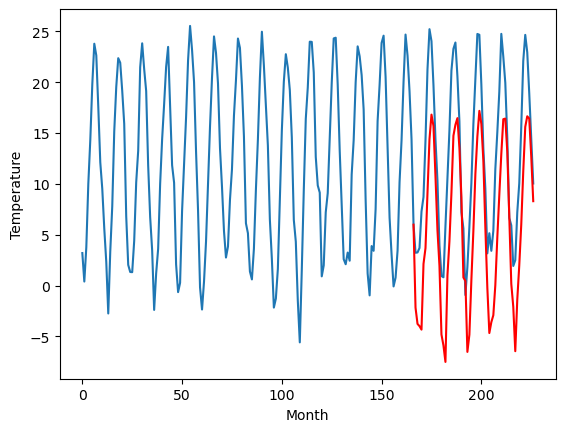

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-15.73		2.17
-20.86		-17.33		3.53
-20.45		-17.56		2.89
-19.53		-17.90		1.63
-15.12		-11.44		3.68
-13.18		-9.88		3.30
-7.41		-4.46		2.95
-0.69		0.82		1.51
3.08		3.24		0.16
1.21		2.12		0.91
-3.76		-2.81		0.95
-9.25		-8.12		1.13
-13.53		-11.62		1.91
-20.35		-18.38		1.97
-21.91		-19.45		2.46
-22.71		-21.07		1.64
-15.52		-12.56		2.96
-10.65		-9.21		1.44
-6.39		-4.47		1.92
-0.22		1.17		1.39
1.42		2.24		0.82
1.15		2.90		1.75
-3.11		-0.02		3.09
-7.23		-4.87		2.36
-17.45		-12.77		4.68
-17.86		-13.11		4.75
-24.84		-20.09		4.75
-21.03		-18.39		2.64
-15.85		-13.00		2.85
-12.03		-8.18		3.85
-5.25		-2.60		2.65
-1.26		1.09		2.35
2.52		3.61		1.09
1.65		2.32		0.67
-3.58		-1.27		2.31
-11.19		-7.86		3.33
-14.31		-13.79		0.52
-21.34		-18.23		3.11
-18.69		-17.16		1.53
-18.48		-16.48		2.00
-16.92		-13.53		3.39
-9.35		-8.82		0.53
-6.88		-4.63		2.25
-2.95		-0.62		2.33
1.89		2.79		0.90
-0.08		2.85		2.93
-3.3

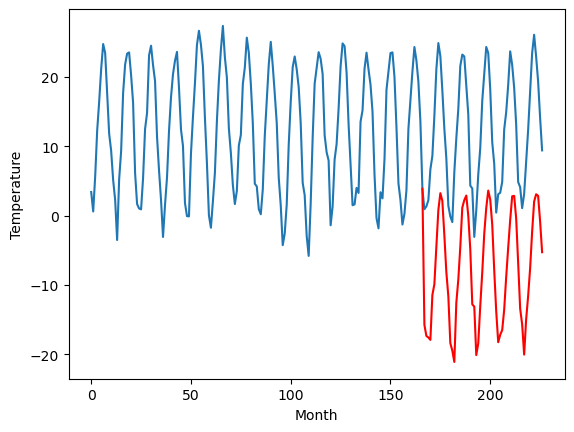

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-15.733117809295655, 2.0768879127502444, 1.5468869590759269, -4.29311351776123, 1.4068898200988773, -0.4731101799011235, 0.1568902969360355, -0.9231120872497556, -3.2431130409240723, -2.163113040924072, -15.733115901947022]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -15.733118
1                 1    2.89   2.076888
2                 2    4.73   1.546887
3                 3   -7.31  -4.293114
4                 4    5.64   1.406890
5                 5   -3.05  -0.473110
6                 6   -4.14   0.156890
7                 7    1.65  -0.923112
8                 8   -0.04  -3.243113
9                 9   -3.08  -2.163113
10               10  -17.90 -15.733116


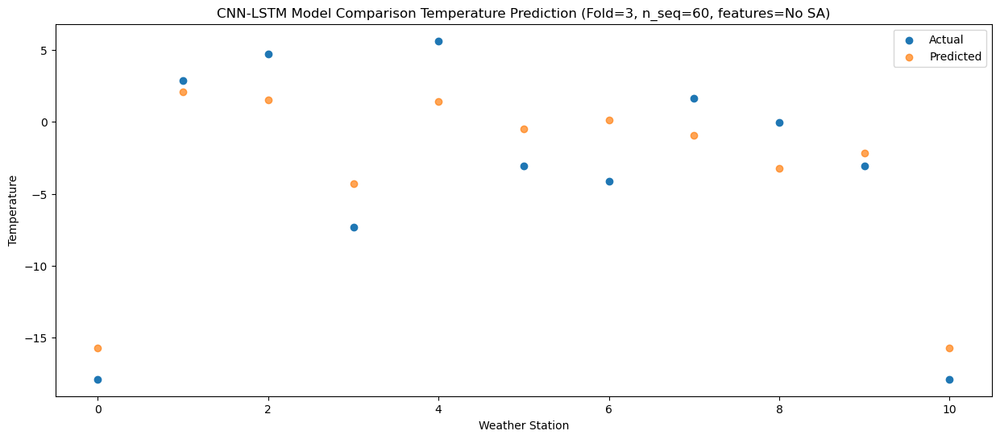

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -17.333788
1                 1    1.54   0.476214
2                 2    2.20  -0.053772
3                 3   -7.30  -5.893783
4                 4    2.38  -0.193786
5                 5   -2.84  -2.073780
6                 6   -9.81  -1.443772
7                 7   -3.08  -2.523773
8                 8   -1.29  -4.843774
9                 9   -5.84  -3.763783
10               10  -20.86 -17.333784


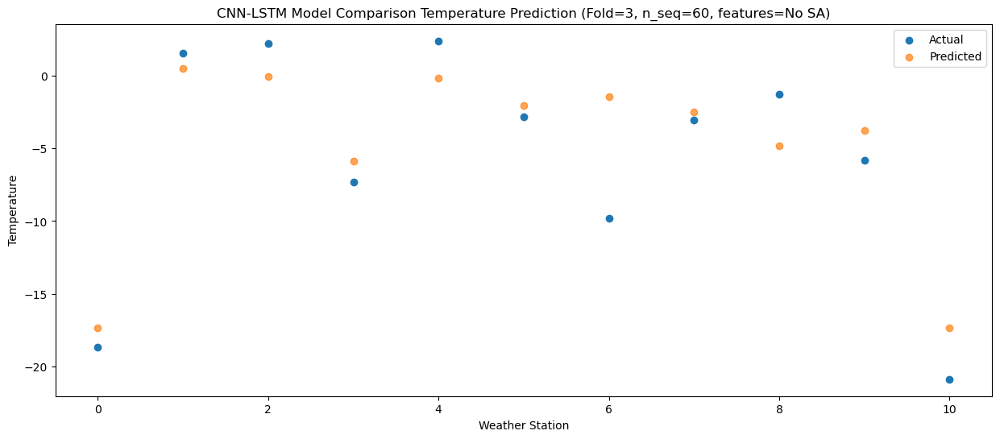

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -17.555070
1                 1    0.70   0.254926
2                 2    0.98  -0.275077
3                 3   -7.85  -6.115063
4                 4   -0.49  -0.415082
5                 5   -4.26  -2.295066
6                 6   -9.90  -1.665073
7                 7   -1.92  -2.745076
8                 8   -1.92  -5.065072
9                 9   -5.81  -3.985067
10               10  -20.45 -17.555070


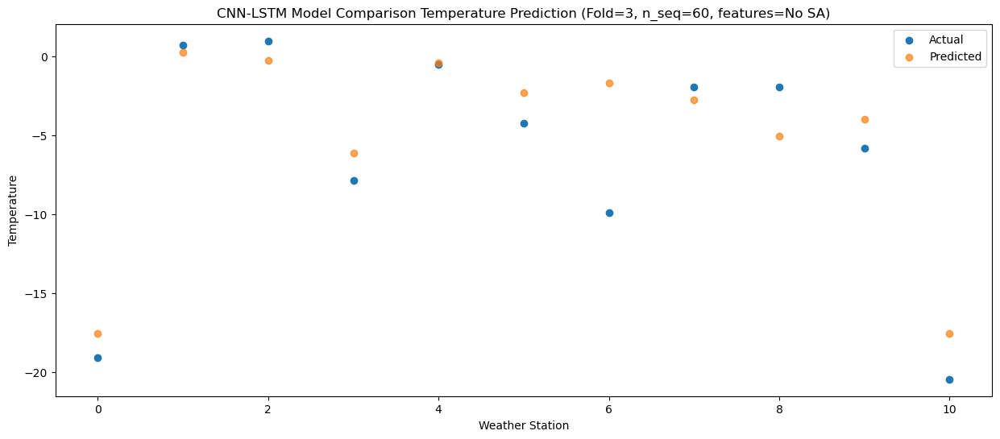

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -17.897527
1                 1    0.85  -0.087523
2                 2    3.40  -0.617498
3                 3   -8.20  -6.457521
4                 4    0.66  -0.757533
5                 5   -4.67  -2.637519
6                 6   -9.71  -2.007506
7                 7   -0.41  -3.087504
8                 8    0.10  -5.407504
9                 9   -5.37  -4.327517
10               10  -19.53 -17.897524


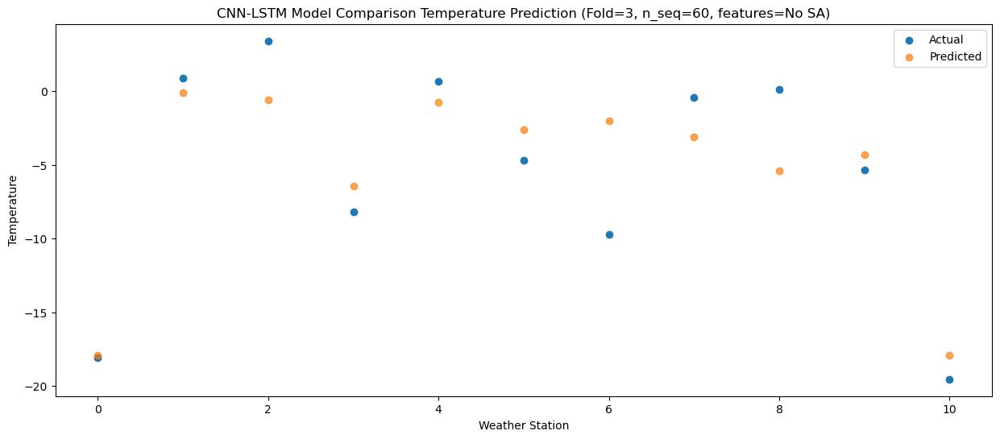

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -11.436990
1                 1    8.34   6.373006
2                 2    5.19   5.843013
3                 3   -1.29   0.003009
4                 4    8.07   5.702989
5                 5    2.19   3.823007
6                 6   -4.78   4.453009
7                 7    2.70   3.373007
8                 8   -0.46   1.053015
9                 9   -1.79   2.133013
10               10  -15.12 -11.436991


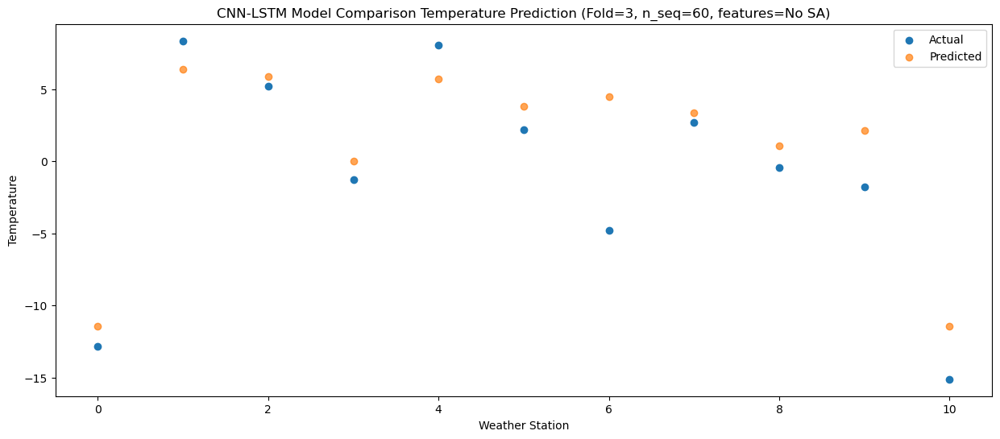

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76  -9.884682
1                 1    9.26   7.925320
2                 2    9.85   7.395328
3                 3   -0.65   1.555322
4                 4   11.10   7.255301
5                 5    4.46   5.375325
6                 6   -1.80   6.005322
7                 7    8.61   4.925321
8                 8    3.16   2.605325
9                 9   -0.35   3.685331
10               10  -13.18  -9.884677


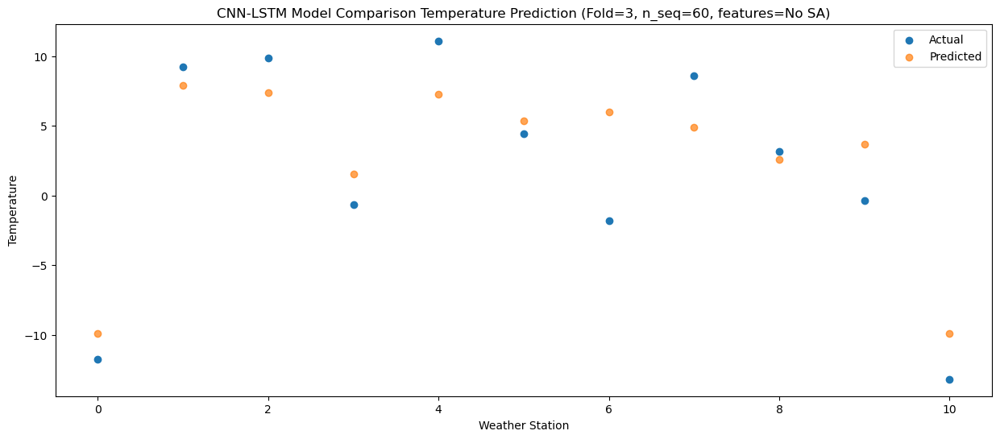

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -4.460400
1                 1   13.66  13.349600
2                 2   15.04  12.819602
3                 3    3.92   6.979602
4                 4   17.17  12.679585
5                 5    9.87  10.799606
6                 6    5.31  11.429594
7                 7   15.88  10.349591
8                 8    5.56   8.029599
9                 9    5.21   9.109608
10               10   -7.41  -4.460397


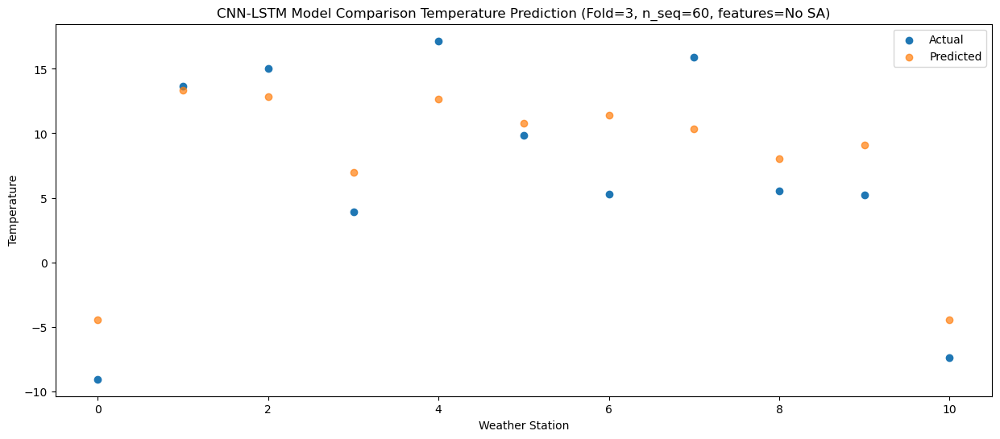

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   0.817578
1                 1   20.76  18.627576
2                 2   18.39  18.097578
3                 3    9.74  12.257584
4                 4   24.22  17.957563
5                 5   16.86  16.077584
6                 6    9.52  16.707565
7                 7   19.34  15.627561
8                 8    8.10  13.307573
9                 9   12.19  14.387588
10               10   -0.69   0.817581


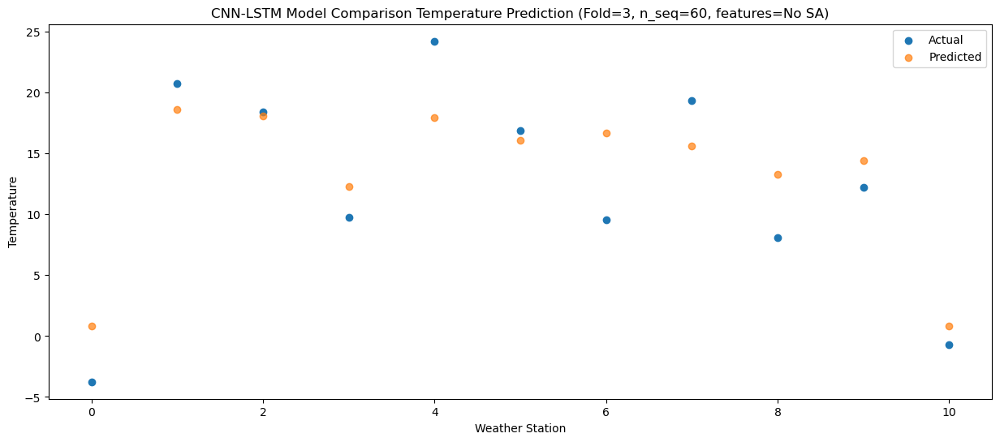

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   3.240191
1                 1   22.62  21.050201
2                 2   21.17  20.520207
3                 3   13.54  14.680205
4                 4   25.68  20.380188
5                 5   18.75  18.500206
6                 6   11.51  19.130193
7                 7   23.57  18.050188
8                 8    7.29  15.730194
9                 9   16.14  16.810213
10               10    3.08   3.240200


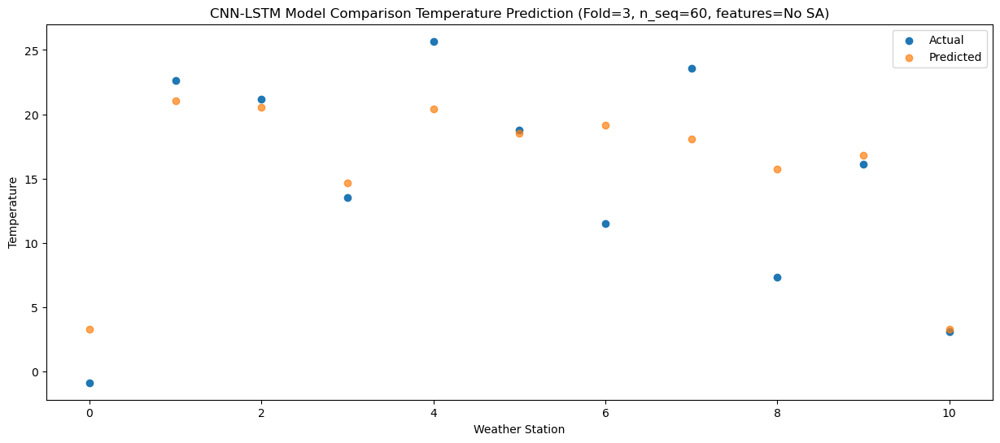

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   2.122394
1                 1   20.76  19.932413
2                 2   21.70  19.402442
3                 3   11.12  13.562413
4                 4   23.12  19.262402
5                 5   16.24  17.382418
6                 6   12.26  18.012422
7                 7   23.68  16.932419
8                 8    9.17  14.612417
9                 9   14.96  15.692423
10               10    1.21   2.122410


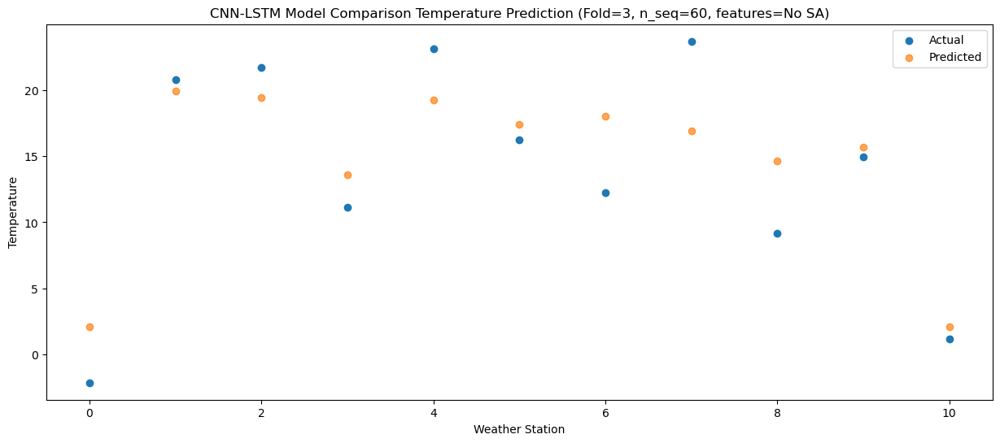

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -2.813081
1                 1   17.09  14.996937
2                 2   17.37  14.466978
3                 3    7.06   8.626940
4                 4   19.05  14.326927
5                 5   12.61  12.446942
6                 6    6.76  13.076955
7                 7   18.87  11.996952
8                 8    8.59   9.676948
9                 9   10.62  10.756951
10               10   -3.76  -2.813061


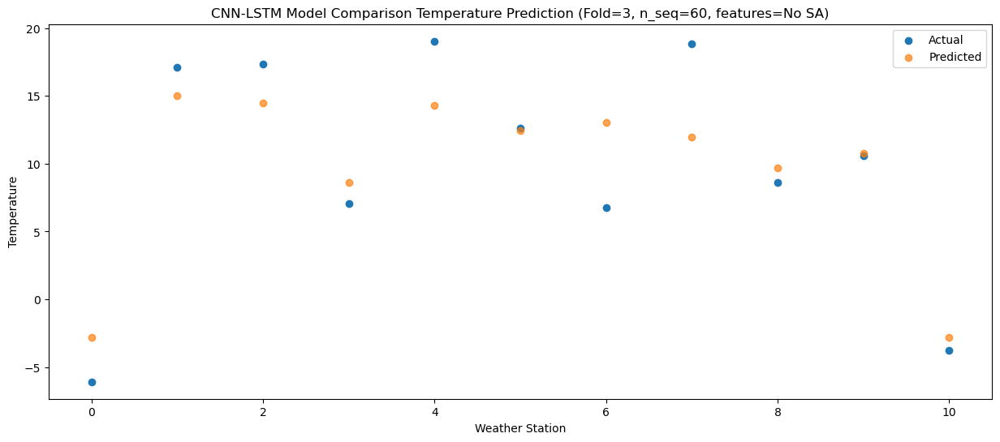

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -8.123378
1                 1    9.98   9.686642
2                 2   11.88   9.156671
3                 3    1.64   3.316645
4                 4   11.32   9.016632
5                 5    6.61   7.136648
6                 6    3.02   7.766655
7                 7   11.93   6.686646
8                 8    6.37   4.366641
9                 9    5.30   5.446654
10               10   -9.25  -8.123356


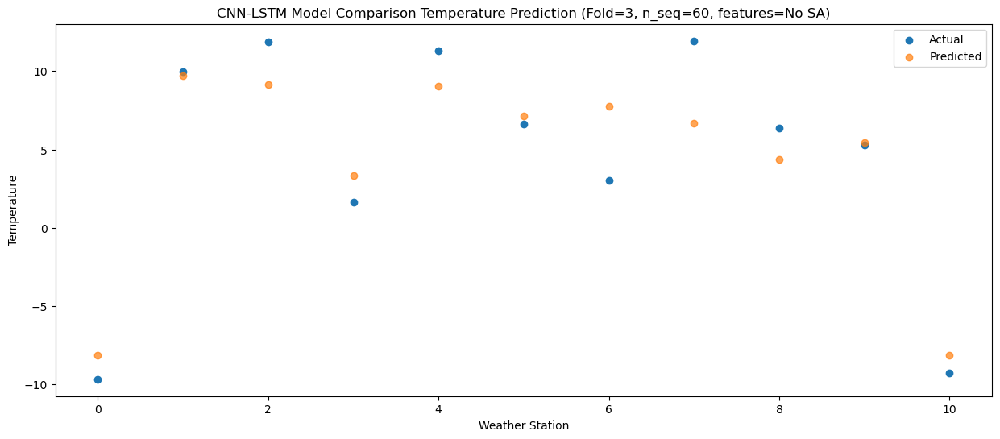

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -11.621973
1                 1    7.16   6.188039
2                 2    3.23   5.658055
3                 3   -2.28  -0.181956
4                 4    8.50   5.518027
5                 5    2.67   3.638046
6                 6   -4.17   4.268041
7                 7    3.12   3.188034
8                 8   -0.79   0.868032
9                 9    1.23   1.948054
10               10  -13.53 -11.621953


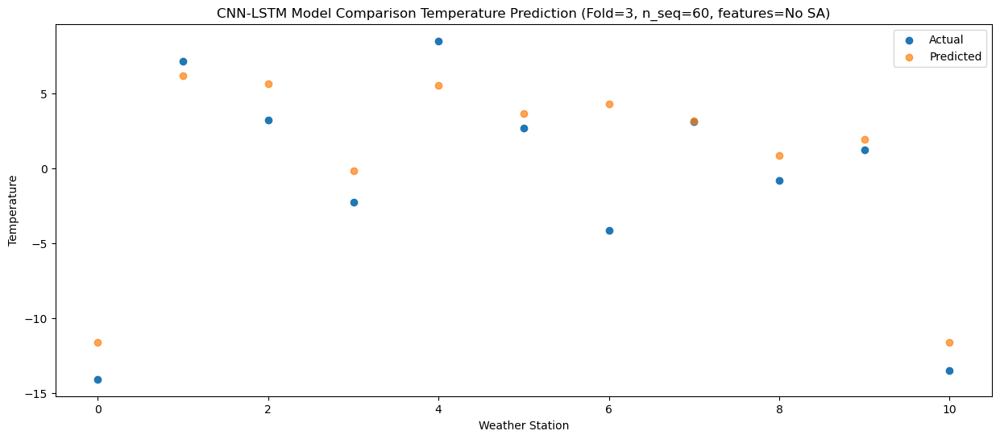

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -18.375546
1                 1    0.61  -0.565553
2                 2    0.03  -1.095561
3                 3   -9.48  -6.935537
4                 4    1.33  -1.235569
5                 5   -4.94  -3.115547
6                 6   -9.87  -2.485572
7                 7   -2.57  -3.565578
8                 8   -2.84  -5.885572
9                 9   -5.11  -4.805535
10               10  -20.35 -18.375535


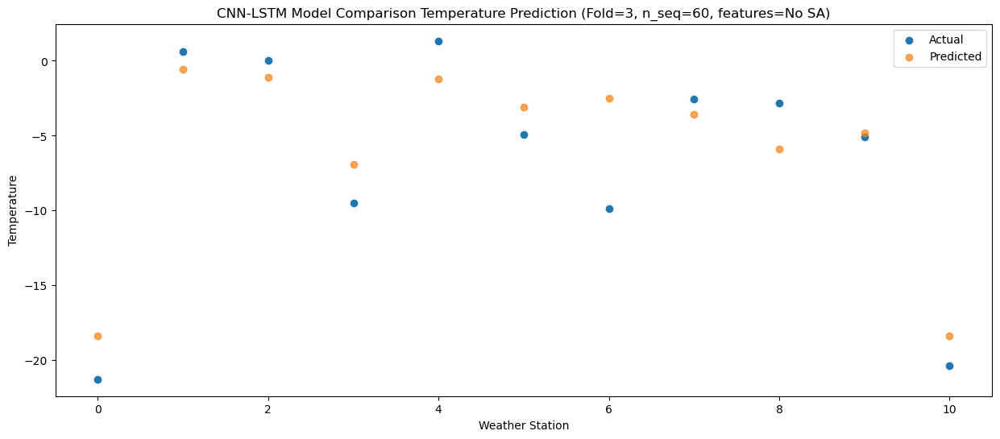

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -19.450960
1                 1   -0.54  -1.640970
2                 2    1.29  -2.170966
3                 3  -10.94  -8.010952
4                 4   -0.14  -2.310985
5                 5   -6.39  -4.190960
6                 6   -9.60  -3.560980
7                 7   -2.02  -4.640984
8                 8   -1.62  -6.960978
9                 9   -8.13  -5.880949
10               10  -21.91 -19.450947


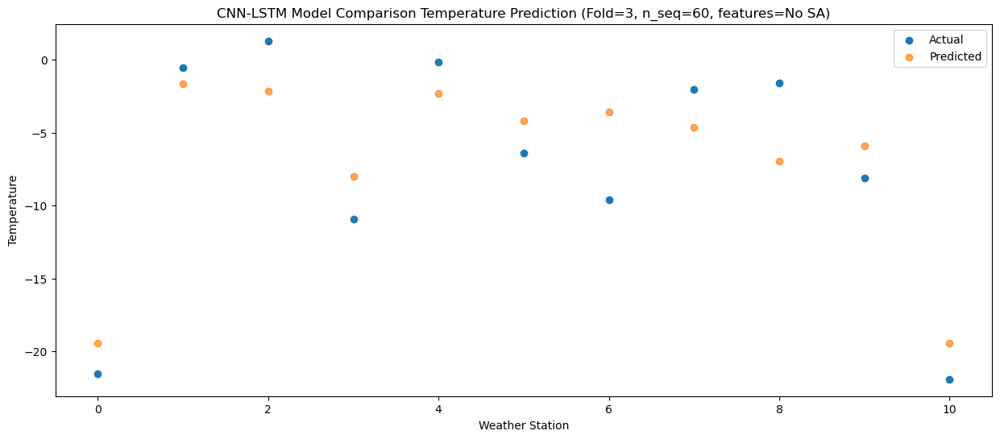

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -21.072131
1                 1   -4.26  -3.262144
2                 2    3.59  -3.792135
3                 3  -12.26  -9.632128
4                 4   -4.01  -3.932160
5                 5   -9.11  -5.812135
6                 6   -9.50  -5.182154
7                 7    0.83  -6.262156
8                 8   -0.69  -8.582148
9                 9   -8.25  -7.502119
10               10  -22.71 -21.072120


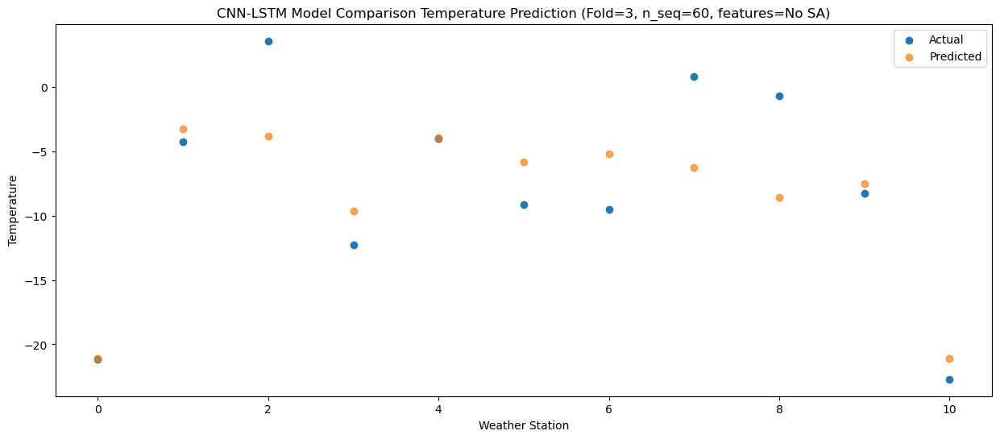

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -12.563006
1                 1    7.71   5.246979
2                 2    4.74   4.716980
3                 3   -2.05  -1.123002
4                 4    9.07   4.576961
5                 5    2.22   2.696991
6                 6   -6.53   3.326959
7                 7    2.43   2.246961
8                 8   -0.91  -0.073027
9                 9   -3.25   1.007005
10               10  -15.52 -12.562995


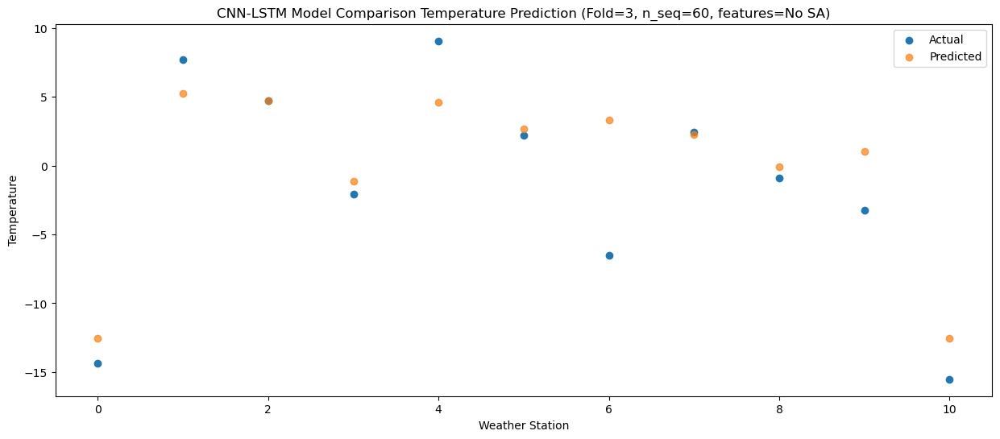

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21  -9.208260
1                 1    9.57   8.601729
2                 2   10.47   8.071745
3                 3    0.30   2.231744
4                 4   12.36   7.931714
5                 5    5.67   6.051743
6                 6   -1.75   6.681716
7                 7   10.40   5.601720
8                 8    1.28   3.281730
9                 9    1.37   4.361757
10               10  -10.65  -9.208246


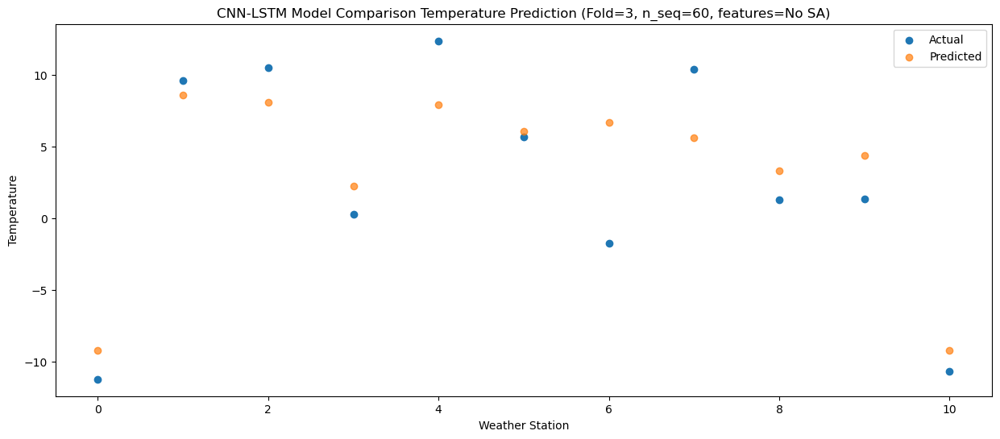

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -4.474408
1                 1   13.79  13.335604
2                 2   15.27  12.805643
3                 3    4.37   6.965608
4                 4   16.93  12.665593
5                 5    9.95  10.785618
6                 6    3.30  11.415608
7                 7   14.83  10.335614
8                 8    5.57   8.015617
9                 9    6.20   9.095629
10               10   -6.39  -4.474380


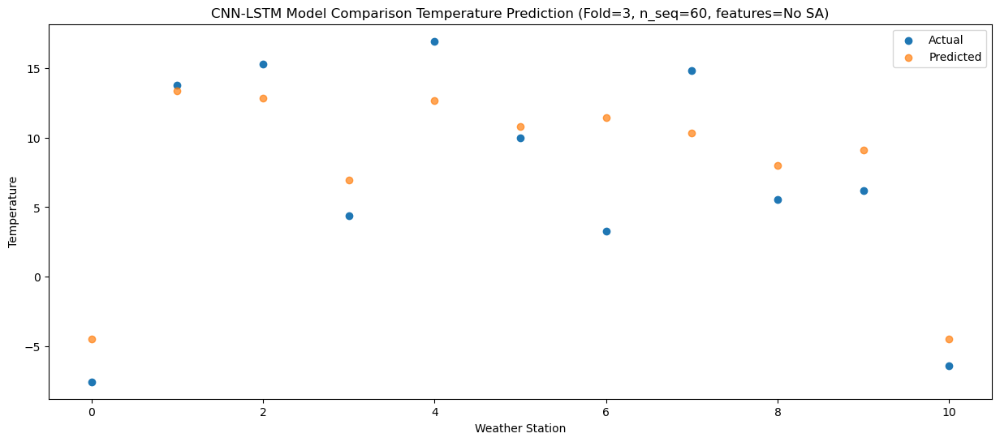

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   1.166117
1                 1   20.50  18.976128
2                 2   20.12  18.446175
3                 3   10.29  12.606133
4                 4   24.41  18.306122
5                 5   16.66  16.426146
6                 6   10.69  17.056140
7                 7   22.47  15.976146
8                 8    7.27  13.656141
9                 9   12.07  14.736153
10               10   -0.22   1.166146


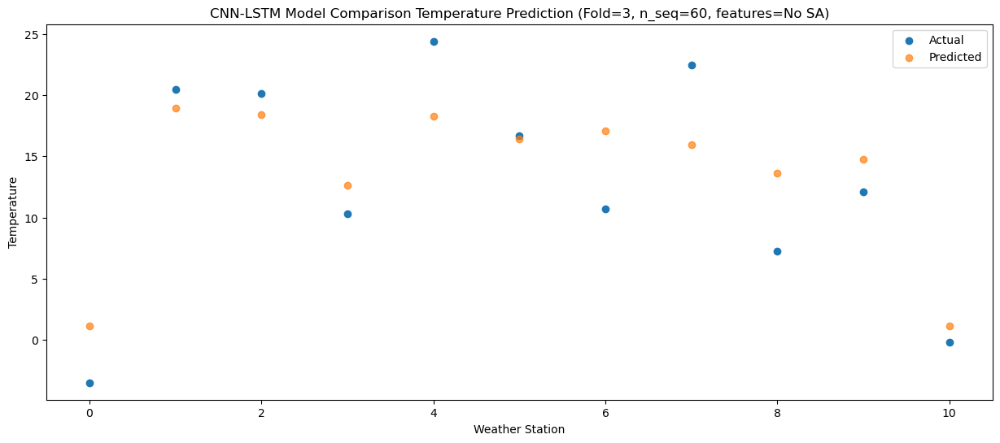

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   2.241549
1                 1   21.81  20.051561
2                 2   23.25  19.521604
3                 3   11.28  13.681562
4                 4   24.41  19.381556
5                 5   17.04  17.501583
6                 6   12.53  18.131573
7                 7   23.55  17.051575
8                 8    6.45  14.731574
9                 9   14.21  15.811586
10               10    1.42   2.241575


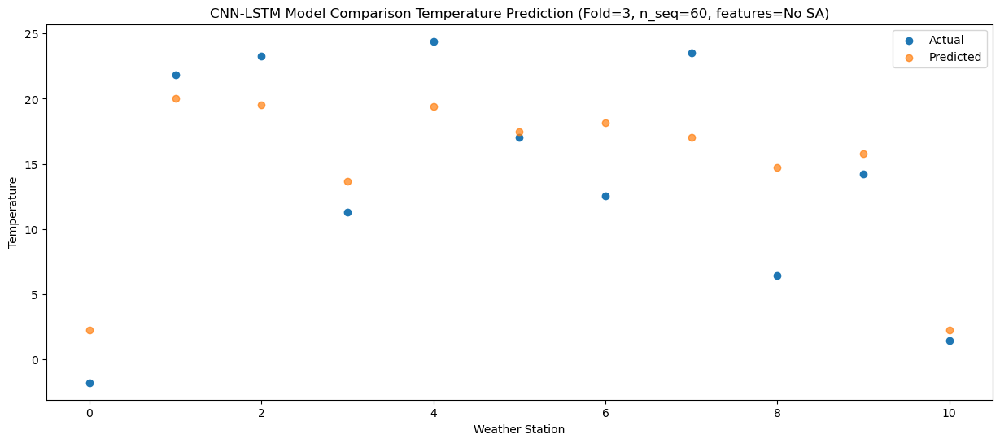

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   2.895600
1                 1   22.38  20.705615
2                 2   21.05  20.175653
3                 3   11.80  14.335614
4                 4   24.53  20.035607
5                 5   17.36  18.155637
6                 6   10.61  18.785624
7                 7   22.32  17.705624
8                 8    7.00  15.385623
9                 9   14.83  16.465638
10               10    1.15   2.895630


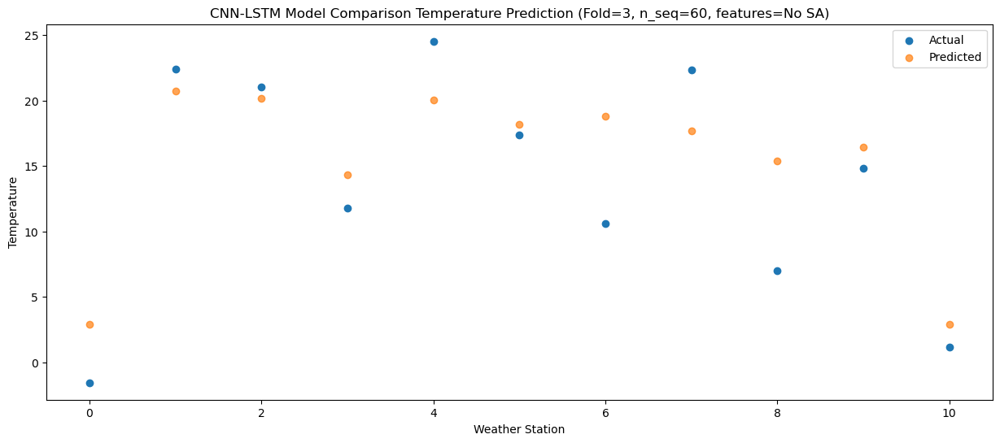

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -0.023045
1                 1   19.65  17.786964
2                 2   17.74  17.256980
3                 3    7.67  11.416969
4                 4   21.17  17.116954
5                 5   14.10  15.236987
6                 6    8.74  15.866957
7                 7   18.35  14.786957
8                 8    6.45  12.466957
9                 9   11.51  13.546987
10               10   -3.11  -0.023014


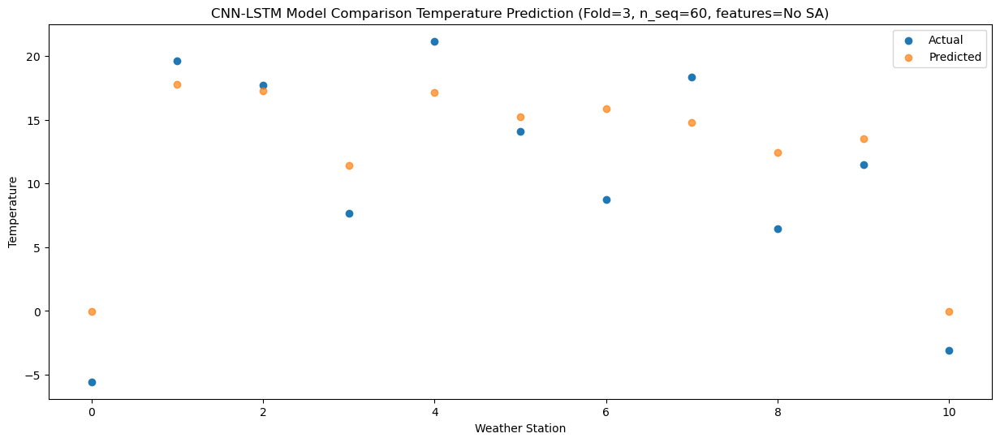

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -4.865259
1                 1   13.05  12.944751
2                 2    9.08  12.414777
3                 3    4.09   6.574754
4                 4   15.75  12.274740
5                 5    9.52  10.394772
6                 6    0.77  11.024750
7                 7    8.00   9.944752
8                 8    3.69   7.624750
9                 9    7.07   8.704774
10               10   -7.23  -4.865226


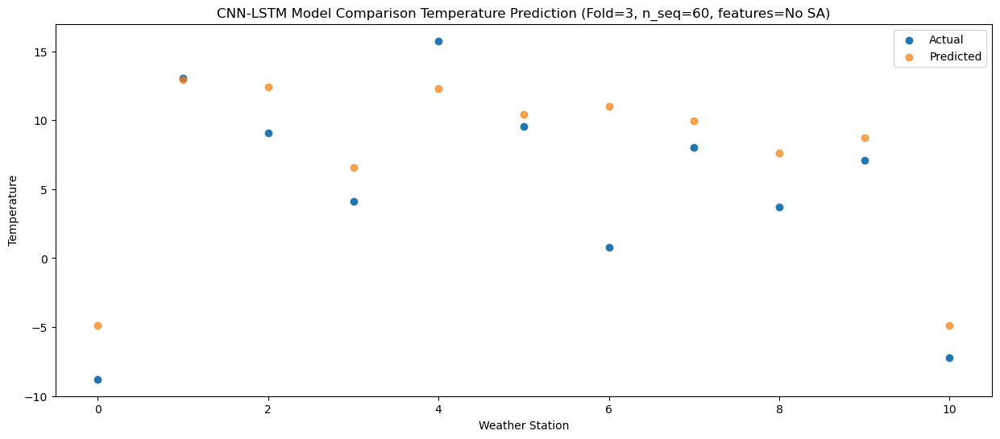

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -12.773658
1                 1    5.34   5.036344
2                 2    4.74   4.506355
3                 3   -5.57  -1.333648
4                 4    6.01   4.366332
5                 5   -1.33   2.486364
6                 6   -1.97   3.116330
7                 7    5.48   2.036334
8                 8    0.87  -0.283665
9                 9   -1.85   0.796369
10               10  -17.45 -12.773630


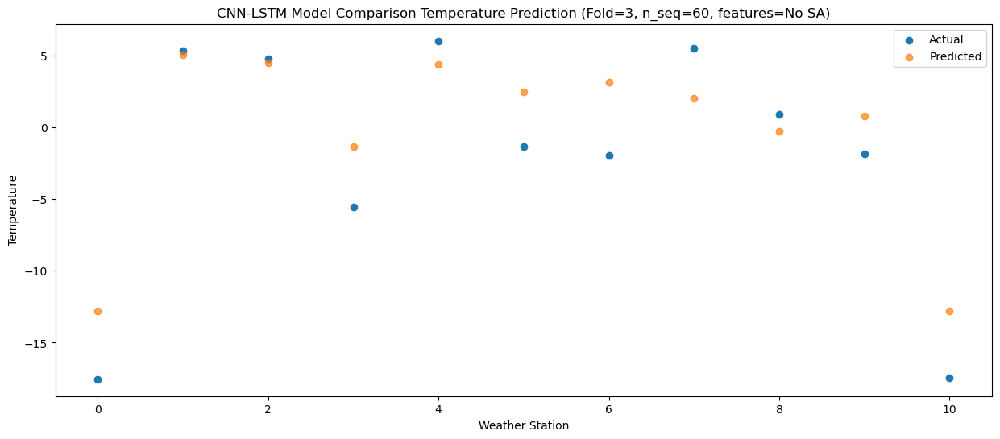

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -13.105928
1                 1    6.65   4.704074
2                 2    0.82   4.174087
3                 3   -4.08  -1.665919
4                 4    5.65   4.034066
5                 5   -0.28   2.154094
6                 6   -6.73   2.784060
7                 7   -1.79   1.704063
8                 8   -2.83  -0.615935
9                 9   -3.45   0.464098
10               10  -17.86 -13.105901


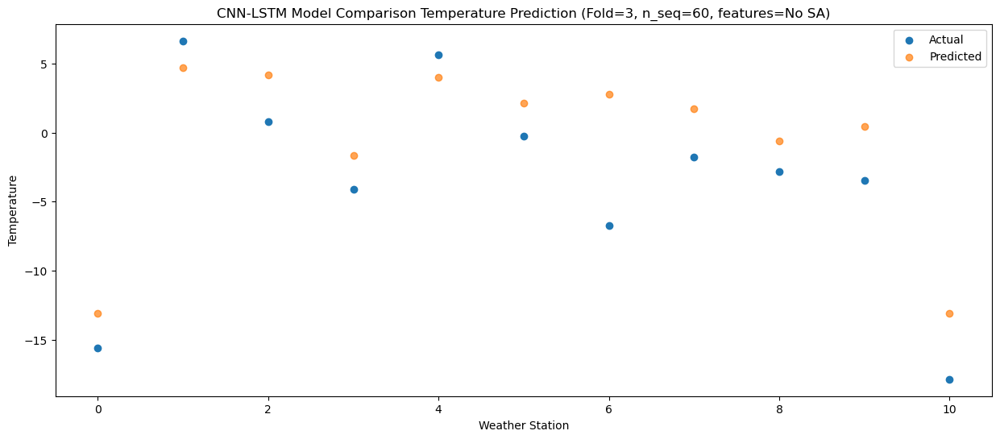

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -20.087398
1                 1   -2.18  -2.277391
2                 2    0.49  -2.807355
3                 3  -13.03  -8.647388
4                 4   -3.82  -2.947401
5                 5   -9.10  -4.827375
6                 6   -9.02  -4.197389
7                 7   -1.86  -5.277386
8                 8   -2.21  -7.597387
9                 9  -10.00  -6.517367
10               10  -24.84 -20.087367


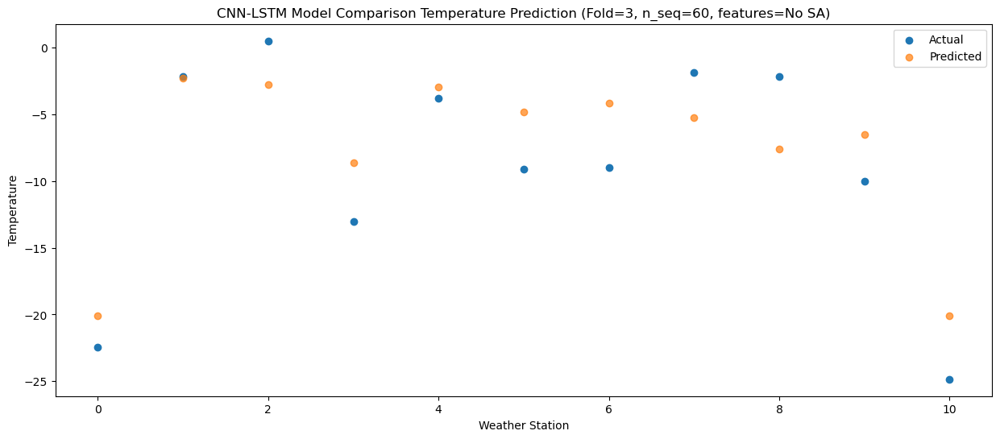

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -18.391891
1                 1   -0.96  -0.581875
2                 2    2.19  -1.111820
3                 3   -8.51  -6.951875
4                 4   -1.30  -1.251884
5                 5   -5.91  -3.131858
6                 6  -10.74  -2.501861
7                 7    0.18  -3.581852
8                 8   -1.25  -5.901858
9                 9   -7.24  -4.821854
10               10  -21.03 -18.391857


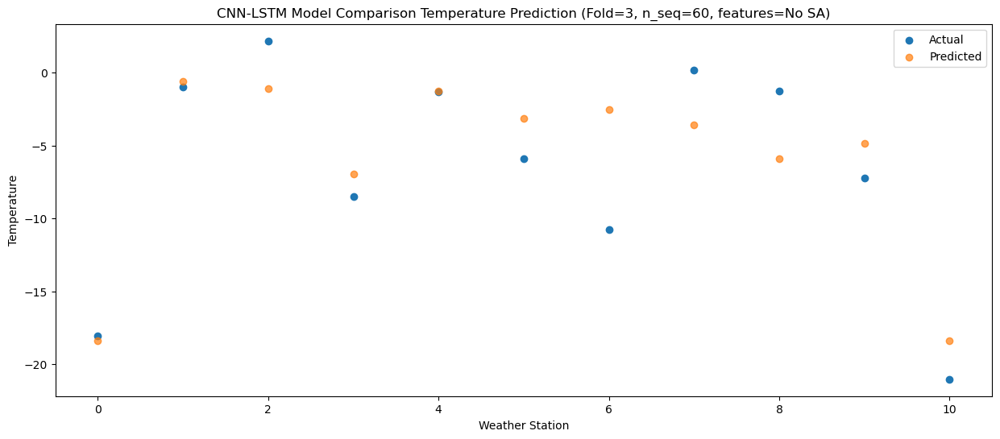

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -13.003971
1                 1    5.82   4.806058
2                 2    6.90   4.276160
3                 3   -2.76  -1.563952
4                 4    7.16   4.136050
5                 5    1.05   2.256072
6                 6   -6.20   2.886107
7                 7    4.89   1.806117
8                 8    0.98  -0.513896
9                 9   -3.28   0.566077
10               10  -15.85 -13.003928


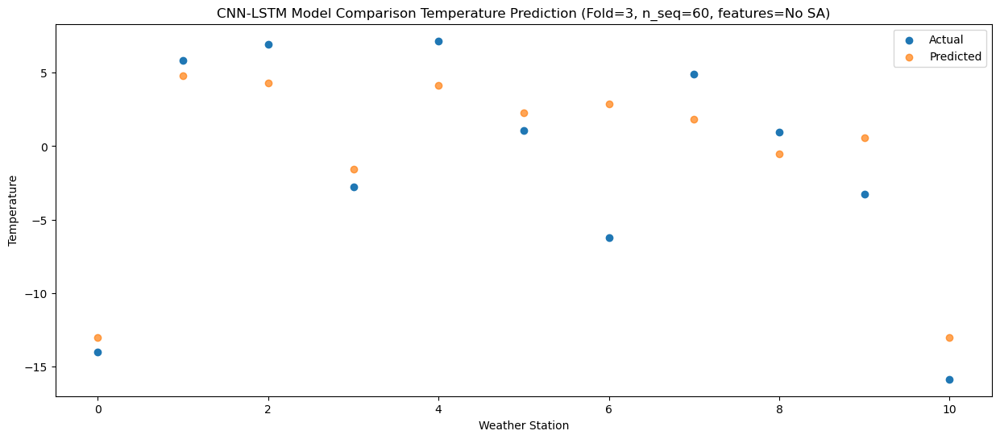

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88  -8.182373
1                 1   10.67   9.627647
2                 2    9.97   9.097734
3                 3    0.25   3.257642
4                 4   11.29   8.957633
5                 5    4.90   7.077659
6                 6   -1.88   7.707685
7                 7    9.52   6.627692
8                 8    2.42   4.307680
9                 9    1.01   5.387664
10               10  -12.03  -8.182340


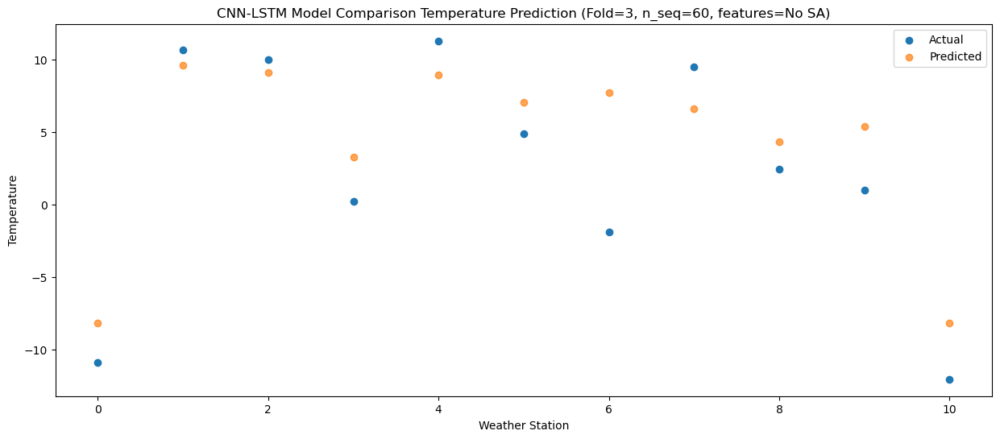

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -2.604715
1                 1   16.10  15.205301
2                 2   14.21  14.675388
3                 3    7.03   8.835291
4                 4   18.86  14.535290
5                 5   12.70  12.655315
6                 6    4.03  13.285345
7                 7   14.19  12.205352
8                 8    5.41   9.885334
9                 9    6.80  10.965324
10               10   -5.25  -2.604683


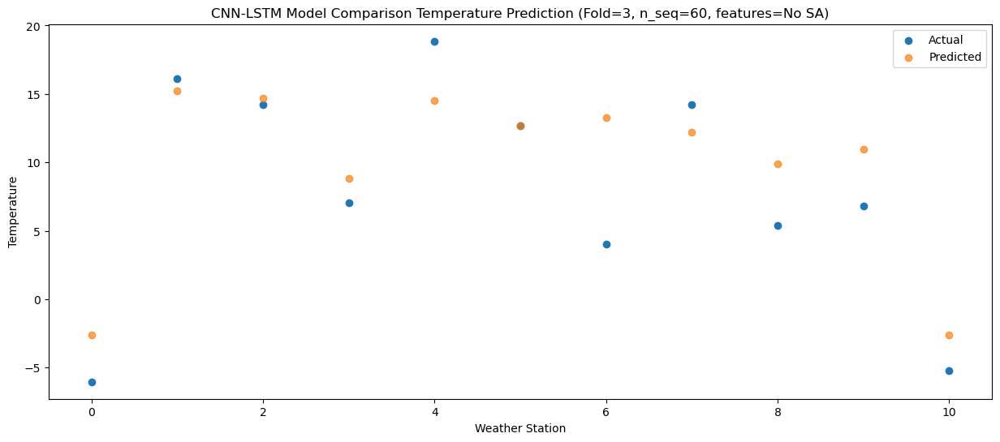

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08   1.089776
1                 1   21.25  18.899801
2                 2   19.60  18.369896
3                 3   10.51  12.529787
4                 4   24.31  18.229786
5                 5   16.64  16.349808
6                 6    9.80  16.979851
7                 7   20.67  15.899862
8                 8    8.56  13.579838
9                 9   11.12  14.659824
10               10   -1.26   1.089811


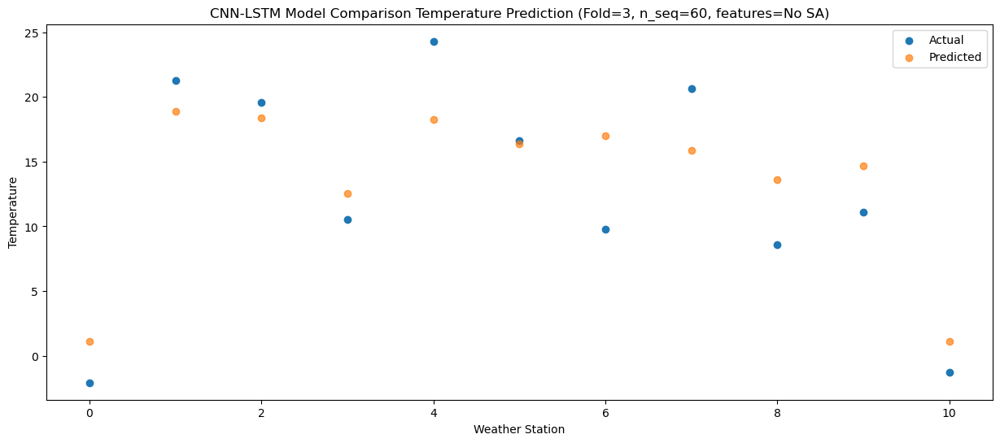

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   3.609325
1                 1   25.29  21.419365
2                 2   22.17  20.889464
3                 3   12.06  15.049344
4                 4   25.43  20.749347
5                 5   18.63  18.869365
6                 6   11.72  19.499413
7                 7   22.90  18.419430
8                 8    6.91  16.099403
9                 9   15.67  17.179383
10               10    2.52   3.609366


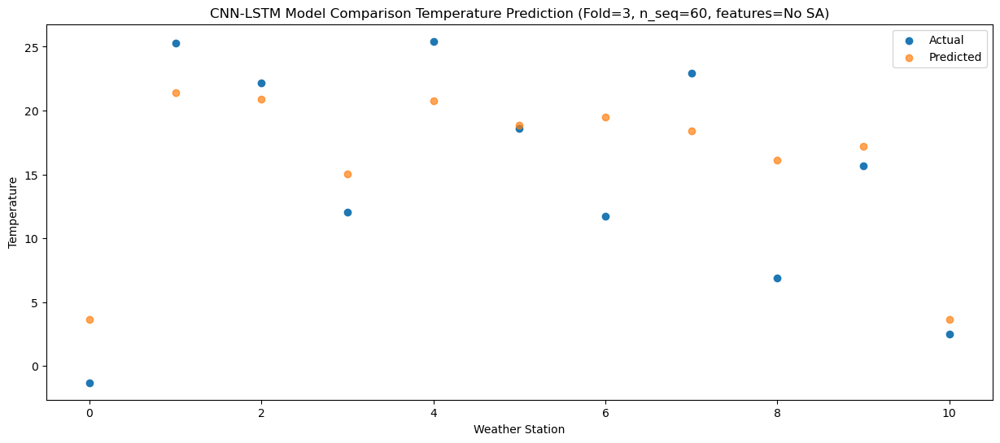

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22   2.318306
1                 1   22.21  20.128350
2                 2   22.35  19.598456
3                 3   10.99  13.758329
4                 4   23.61  19.458335
5                 5   16.98  17.578350
6                 6   10.96  18.208404
7                 7   21.31  17.128421
8                 8    8.33  14.808390
9                 9   15.59  15.888372
10               10    1.65   2.318352


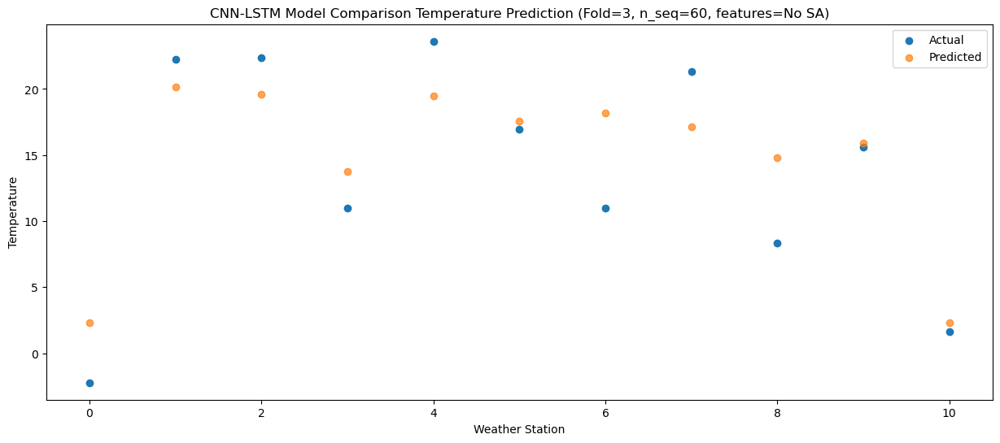

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -1.272627
1                 1   18.35  16.537435
2                 2   19.53  16.007585
3                 3    7.01  10.167402
4                 4   19.29  15.867426
5                 5   13.03  13.987438
6                 6    8.80  14.617524
7                 7   18.95  13.537542
8                 8    8.56  11.217500
9                 9   10.68  12.297454
10               10   -3.58  -1.272573


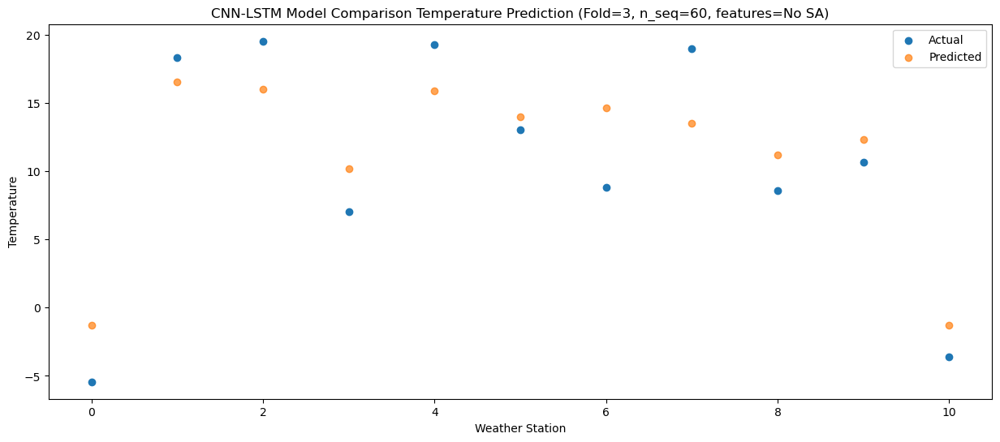

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44  -7.863340
1                 1   11.80   9.946718
2                 2   12.35   9.416856
3                 3   -0.26   3.576689
4                 4   12.02   9.276707
5                 5    6.99   7.396718
6                 6    0.54   8.026799
7                 7   11.06   6.946816
8                 8    3.83   4.626776
9                 9    4.42   5.706739
10               10  -11.19  -7.863289


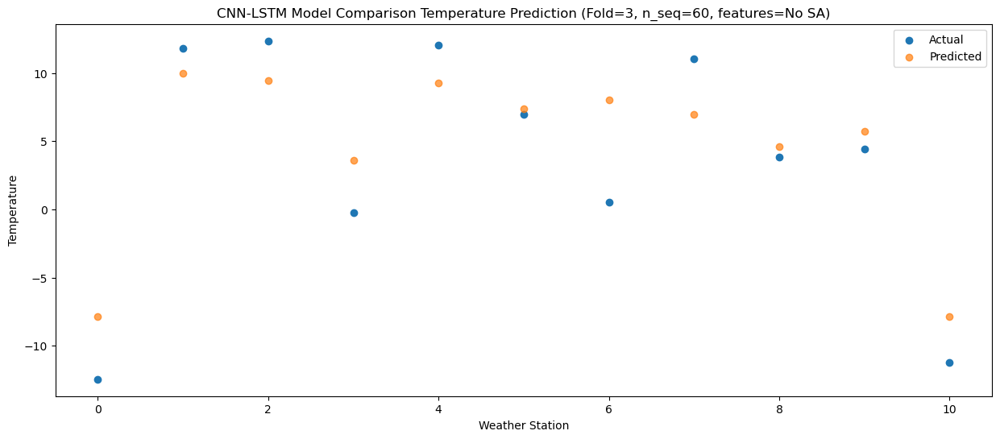

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -13.789493
1                 1    4.57   4.020572
2                 2    1.62   3.490732
3                 3   -3.38  -2.349462
4                 4    6.13   3.350567
5                 5    0.44   1.470573
6                 6   -7.14   2.100670
7                 7   -0.36   1.020688
8                 8   -1.90  -1.299356
9                 9    0.46  -0.219406
10               10  -14.31 -13.789435


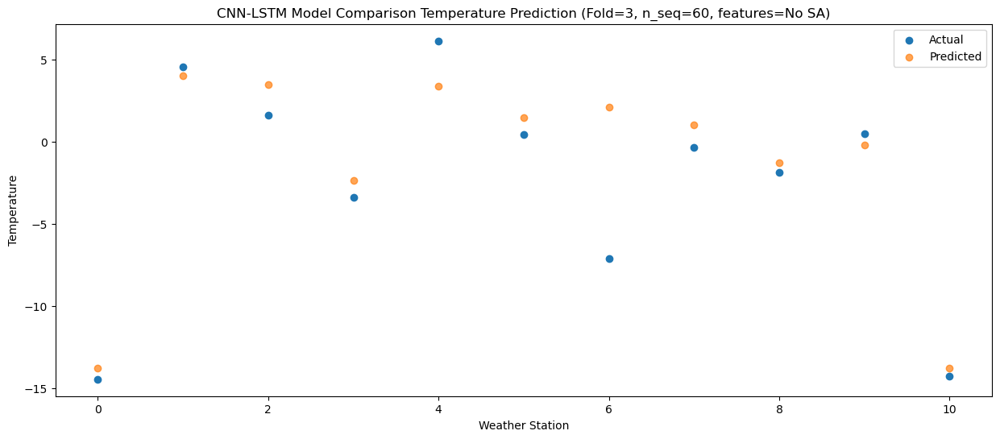

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -18.232194
1                 1    0.52  -0.422122
2                 2    0.66  -0.951938
3                 3   -8.65  -6.792164
4                 4    0.16  -1.092125
5                 5   -5.10  -2.972123
6                 6   -9.31  -2.342007
7                 7   -2.69  -3.421985
8                 8   -3.10  -5.742034
9                 9   -5.90  -4.662103
10               10  -21.34 -18.232133


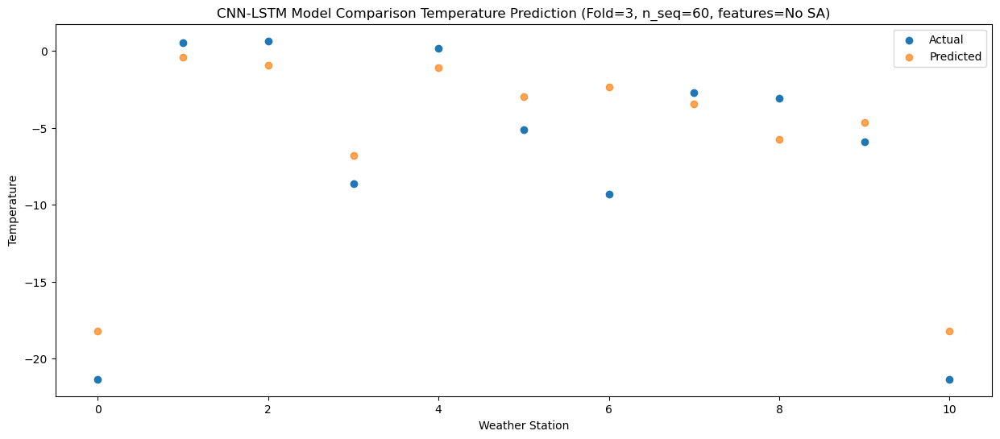

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -17.163589
1                 1    1.22   0.646487
2                 2    2.05   0.116673
3                 3   -6.90  -5.723555
4                 4    1.88  -0.023516
5                 5   -2.96  -1.903516
6                 6  -10.04  -1.273398
7                 7   -3.20  -2.353374
8                 8   -1.43  -4.673425
9                 9   -3.92  -3.593495
10               10  -18.69 -17.163528


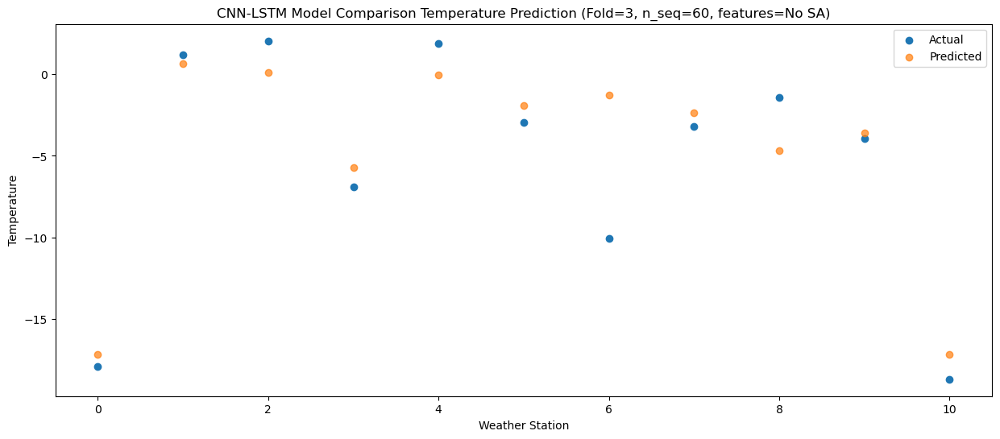

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -16.480647
1                 1    3.18   1.329433
2                 2    1.20   0.799642
3                 3   -4.56  -5.040611
4                 4    8.40   0.659428
5                 5   -1.24  -1.220572
6                 6  -10.01  -0.590439
7                 7   -2.29  -1.670415
8                 8   -3.23  -3.990464
9                 9   -5.65  -2.910552
10               10  -18.48 -16.480582


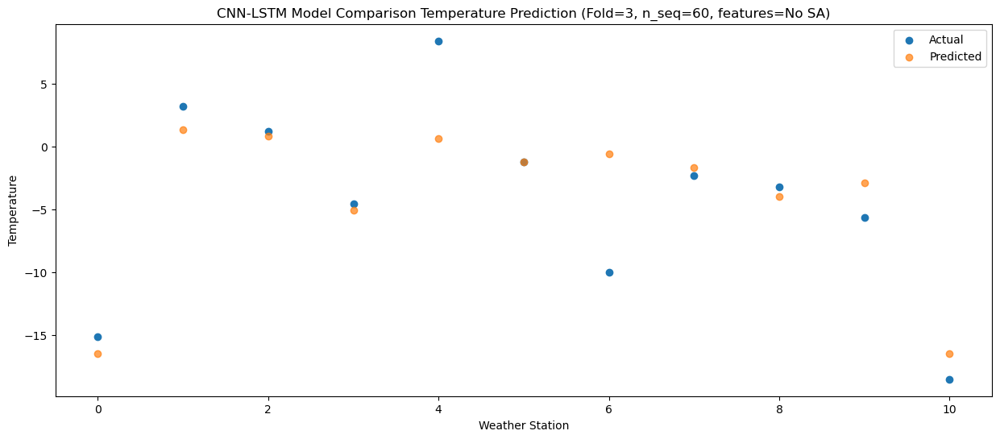

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -13.525868
1                 1    5.78   4.284197
2                 2    4.07   3.754394
3                 3   -4.32  -2.085840
4                 4    5.44   3.614189
5                 5   -0.34   1.734193
6                 6   -8.22   2.364313
7                 7    0.54   1.284338
8                 8   -1.77  -1.035708
9                 9   -3.68   0.044216
10               10  -16.92 -13.525807


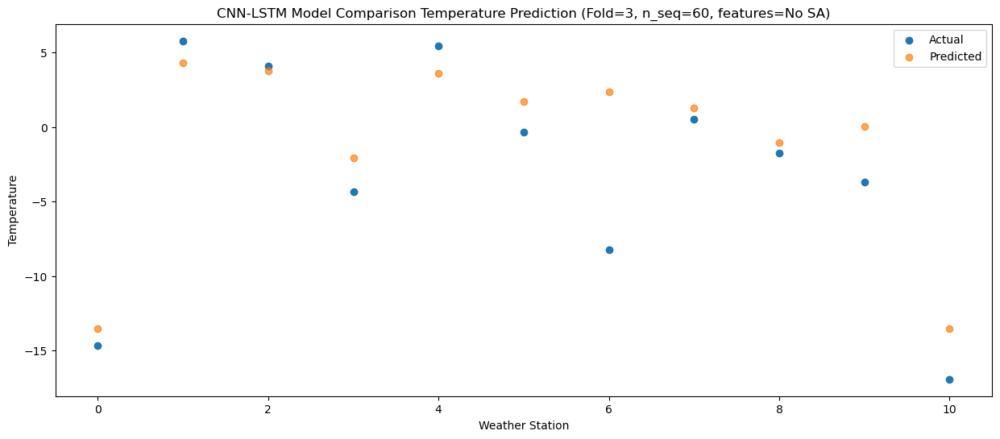

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97  -8.823092
1                 1   10.83   8.986965
2                 2    9.70   8.457142
3                 3    1.92   2.616932
4                 4   12.65   8.316954
5                 5    5.89   6.436961
6                 6   -2.88   7.067065
7                 7    8.49   5.987091
8                 8    2.31   3.667049
9                 9    2.37   4.746988
10               10   -9.35  -8.823032


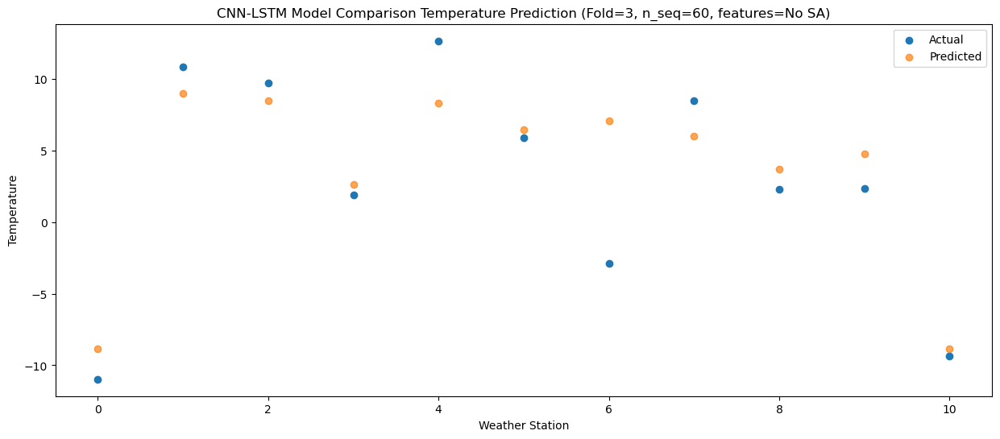

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -4.634831
1                 1   16.14  13.175222
2                 2   14.14  12.645397
3                 3    4.61   6.805193
4                 4   18.65  12.505215
5                 5   11.30  10.625222
6                 6    4.33  11.255320
7                 7   14.29  10.175348
8                 8    3.34   7.855302
9                 9    6.01   8.935249
10               10   -6.88  -4.634767


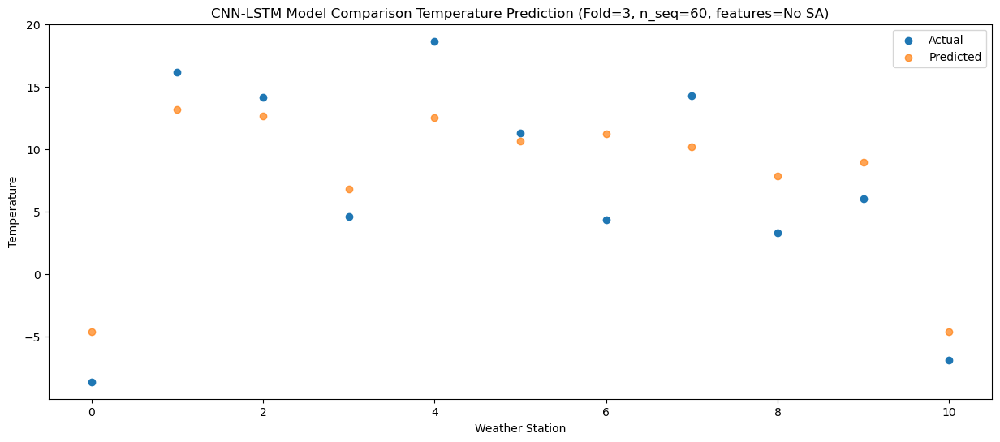

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84  -0.619003
1                 1   20.47  17.191053
2                 2   16.94  16.661222
3                 3    8.35  10.821024
4                 4   22.75  16.521050
5                 5   14.76  14.641057
6                 6    8.91  15.271149
7                 7   16.79  14.191175
8                 8    5.24  11.871127
9                 9   10.00  12.951077
10               10   -2.95  -0.618938


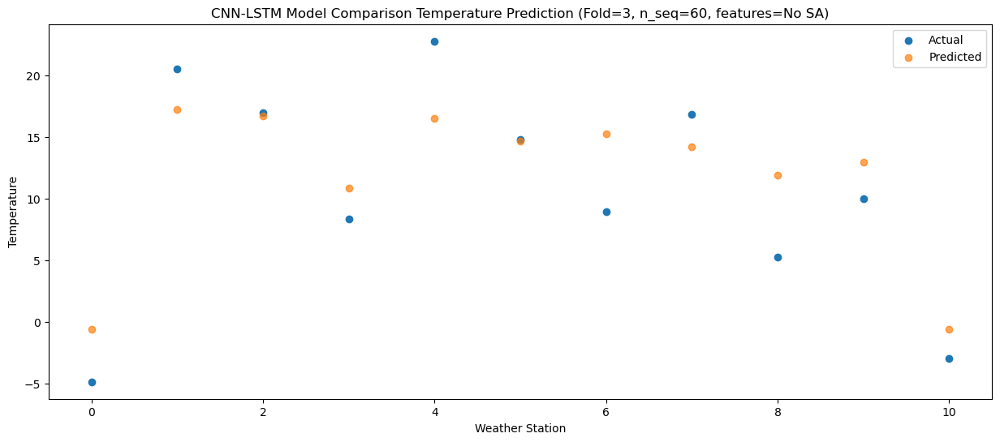

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06   2.790367
1                 1   22.73  20.600416
2                 2   22.60  20.070561
3                 3   11.97  14.230389
4                 4   24.45  19.930410
5                 5   18.02  18.050422
6                 6   15.05  18.680496
7                 7   25.15  17.600518
8                 8    8.25  15.280474
9                 9   15.68  16.360439
10               10    1.89   2.790428


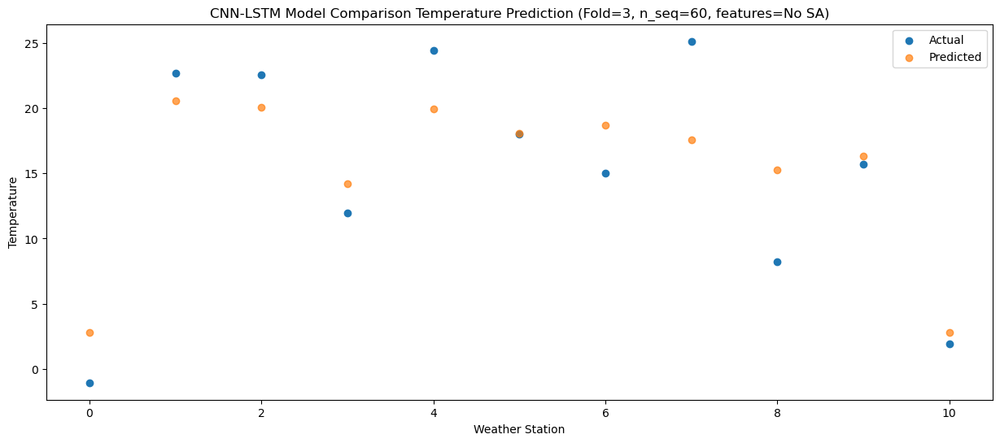

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57   2.850232
1                 1   22.91  20.660300
2                 2   20.91  20.130462
3                 3   10.86  14.290264
4                 4   23.16  19.990297
5                 5   16.47  18.110305
6                 6   12.46  18.740397
7                 7   20.52  17.660416
8                 8    9.28  15.340365
9                 9   13.43  16.420318
10               10   -0.08   2.850302


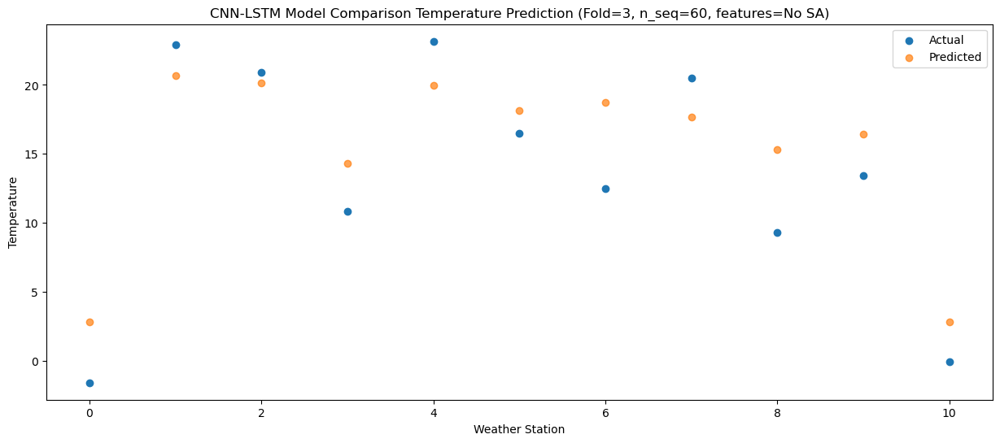

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71  -0.397242
1                 1   18.86  17.412842
2                 2   17.14  16.883019
3                 3    8.13  11.042797
4                 4   19.80  16.742842
5                 5   13.01  14.862849
6                 6    8.31  15.492951
7                 7   15.82  14.412972
8                 8    6.67  12.092910
9                 9   10.86  13.172857
10               10   -3.37  -0.397165


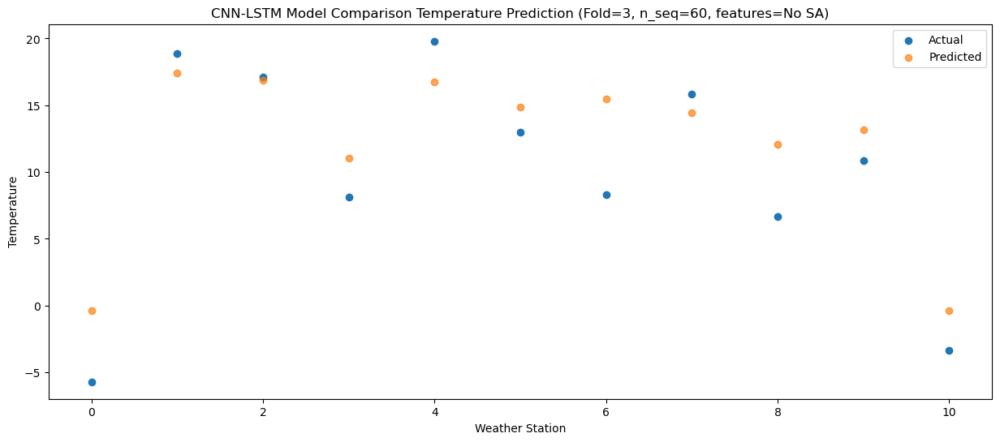

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74  -6.823627
1                 1   11.92  10.986469
2                 2   11.83  10.456665
3                 3    2.69   4.616418
4                 4   13.34  10.316469
5                 5    7.36   8.436473
6                 6    2.18   9.066593
7                 7   10.53   7.986615
8                 8    5.21   5.666548
9                 9    5.43   6.746482
10               10   -8.66  -6.823544


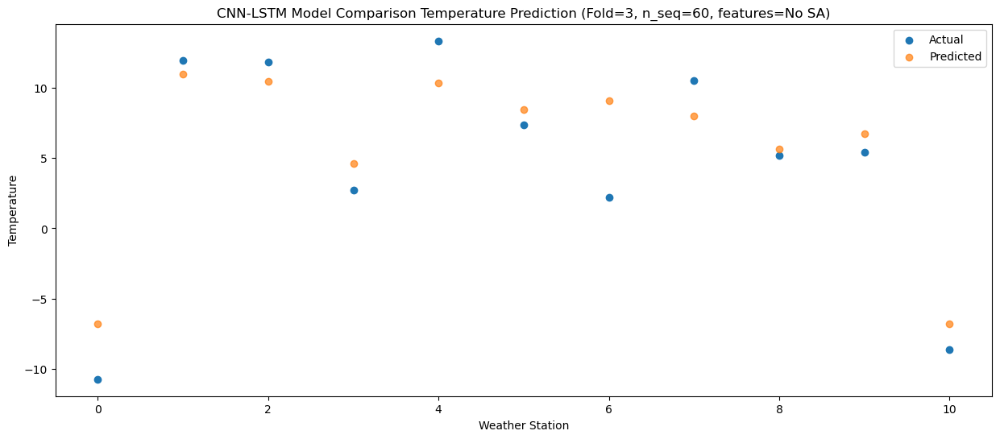

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -13.394286
1                 1    6.14   4.415820
2                 2    4.92   3.886043
3                 3   -3.70  -1.954239
4                 4    6.39   3.745821
5                 5    0.88   1.865822
6                 6   -3.68   2.495965
7                 7    2.39   1.415988
8                 8    1.17  -0.904084
9                 9   -2.42   0.175830
10               10  -16.93 -13.394200


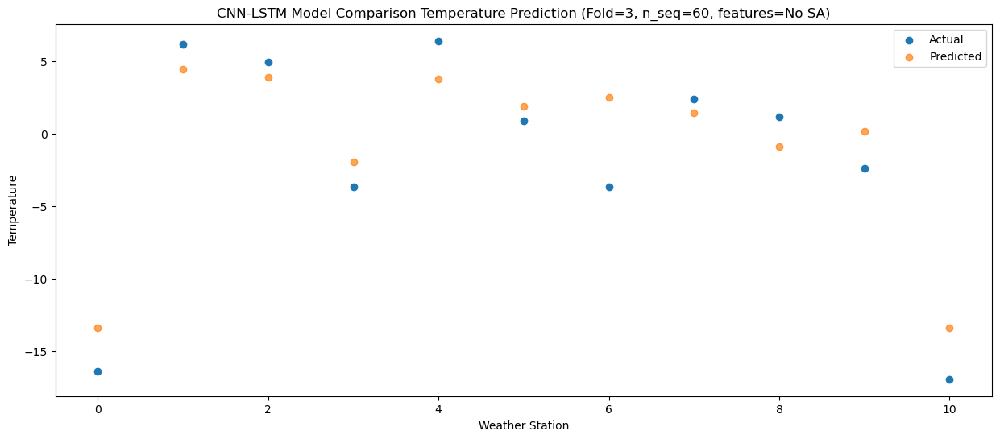

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -15.663229
1                 1    2.79   2.146863
2                 2    3.08   1.617063
3                 3   -5.53  -4.223189
4                 4    3.58   1.476863
5                 5   -1.58  -0.403132
6                 6   -7.31   0.226988
7                 7   -0.74  -0.852992
8                 8   -0.67  -3.173057
9                 9   -3.15  -2.093124
10               10  -17.68 -15.663150


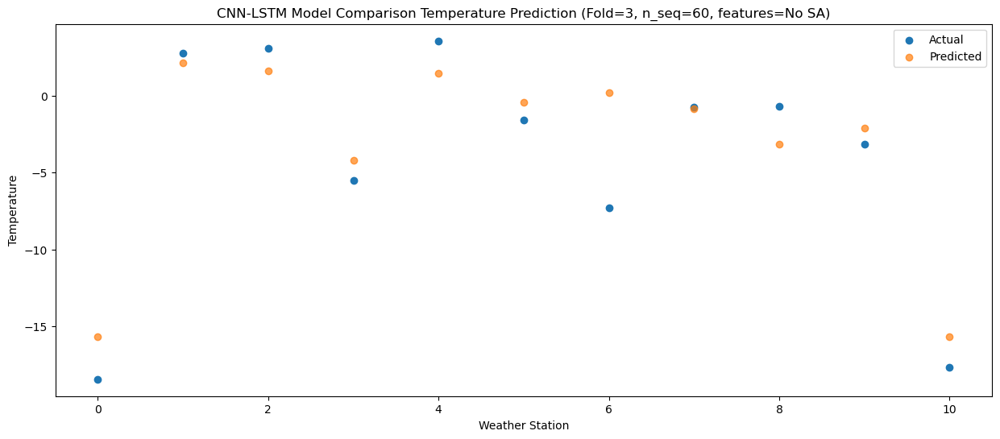

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -20.017885
1                 1   -3.82  -2.207787
2                 2    2.87  -2.737563
3                 3  -10.69  -8.577844
4                 4   -2.92  -2.877784
5                 5   -7.74  -4.757783
6                 6   -9.45  -4.127644
7                 7   -2.46  -5.207623
8                 8   -0.36  -7.527693
9                 9   -7.14  -6.447774
10               10  -20.70 -20.017800


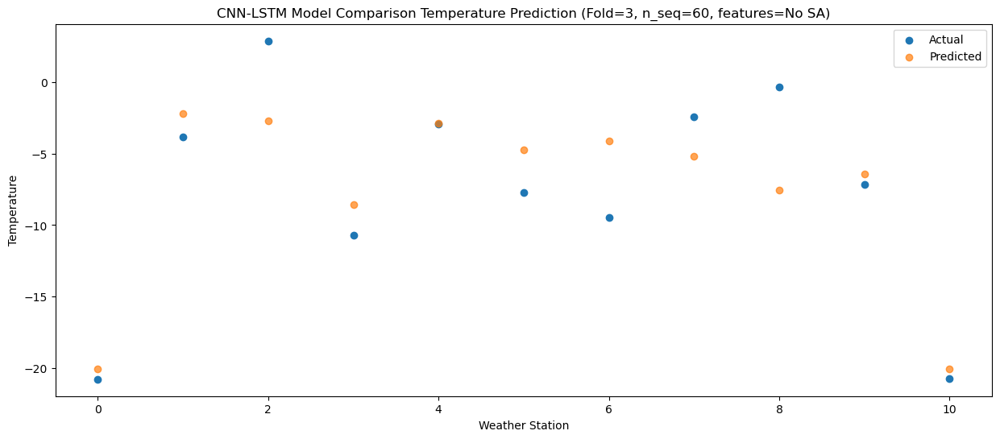

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -14.952483
1                 1    5.83   2.857624
2                 2    4.36   2.327851
3                 3   -5.01  -3.512439
4                 4    4.89   2.187631
5                 5   -1.11   0.307626
6                 6   -7.29   0.937769
7                 7   -0.10  -0.142208
8                 8   -0.65  -2.462284
9                 9   -6.57  -1.382365
10               10  -18.66 -14.952393


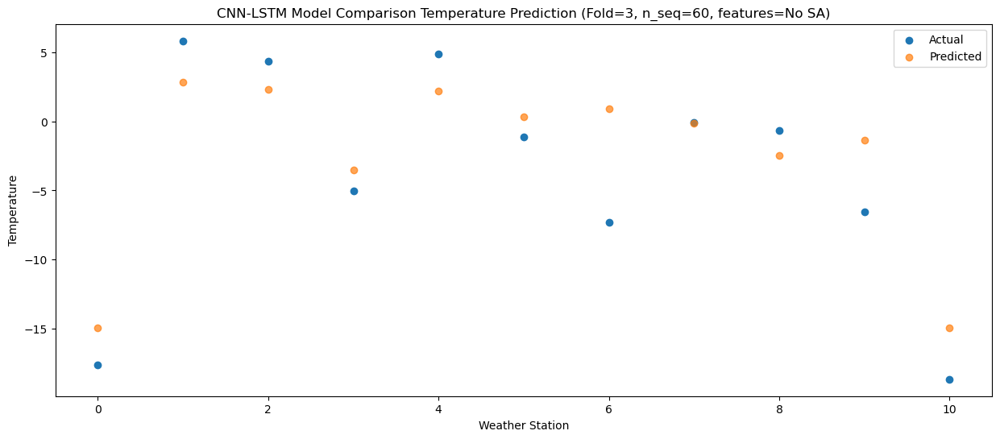

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -11.572840
1                 1    8.31   6.237264
2                 2    6.39   5.707463
3                 3   -1.36  -0.132793
4                 4    9.00   5.567268
5                 5    2.96   3.687266
6                 6   -5.55   4.317389
7                 7    3.26   3.237413
8                 8    0.28   0.917334
9                 9   -1.87   1.997276
10               10  -14.00 -11.572749


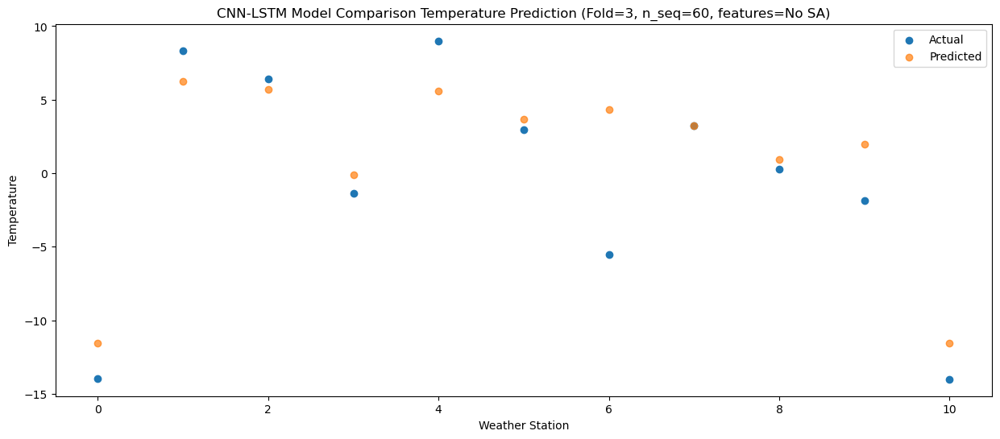

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93  -7.557770
1                 1   12.48  10.252334
2                 2    9.58   9.722522
3                 3    3.70   3.882276
4                 4   13.75   9.582338
5                 5    7.93   7.702338
6                 6   -0.57   8.332452
7                 7    8.76   7.252476
8                 8    2.51   4.932401
9                 9    1.00   6.012342
10               10   -9.42  -7.557677


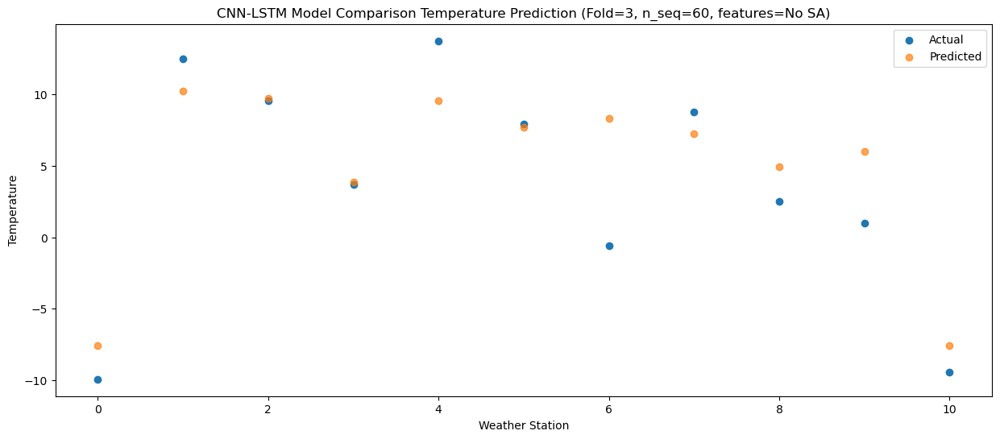

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -2.323859
1                 1   17.25  15.486250
2                 2   14.97  14.956450
3                 3    7.89   9.116190
4                 4   19.91  14.816254
5                 5   13.45  12.936254
6                 6    2.54  13.566370
7                 7   14.39  12.486402
8                 8    5.48  10.166321
9                 9    6.55  11.246255
10               10   -3.75  -2.323761


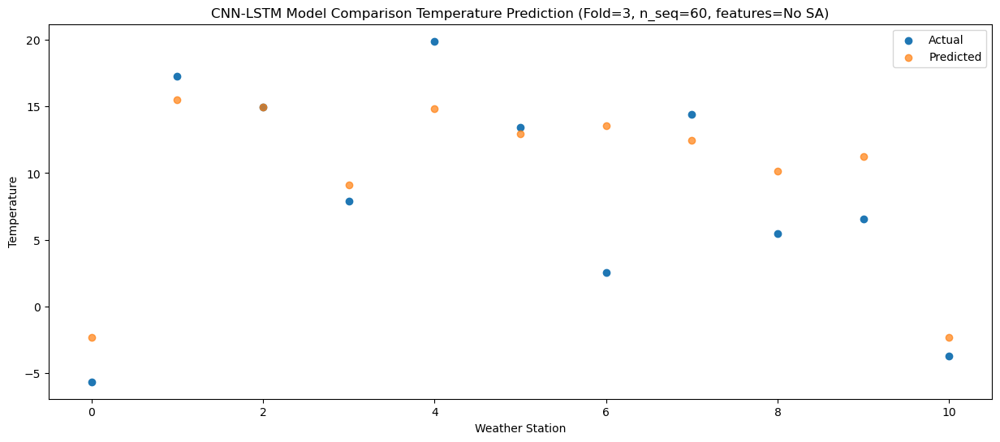

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00   2.033171
1                 1   21.81  19.843279
2                 2   20.92  19.313477
3                 3   11.79  13.473222
4                 4   24.78  19.173280
5                 5   16.68  17.293281
6                 6   11.69  17.923394
7                 7   22.57  16.843426
8                 8    8.39  14.523347
9                 9   13.02  15.603283
10               10    1.62   2.033268


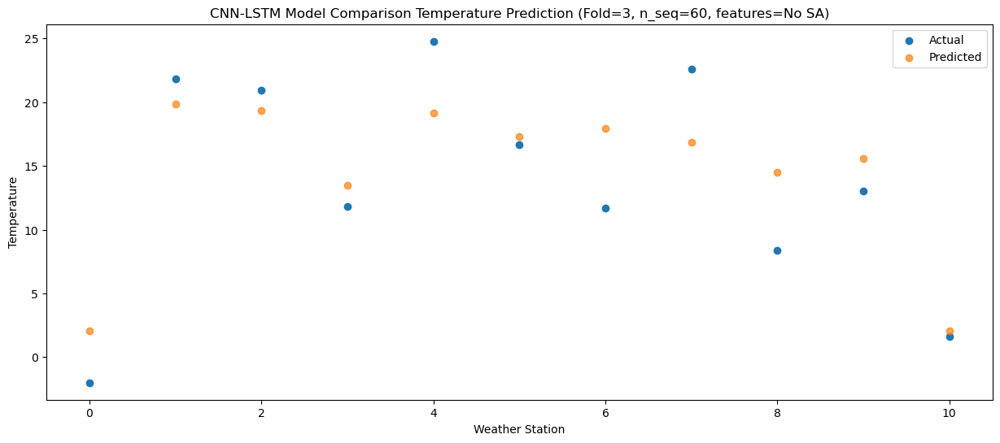

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11   3.077111
1                 1   22.33  20.887208
2                 2   24.49  20.357406
3                 3   13.50  14.517154
4                 4   23.94  20.217208
5                 5   17.23  18.337211
6                 6   12.44  18.967324
7                 7   25.65  17.887356
8                 8    9.65  15.567281
9                 9   15.58  16.647217
10               10    4.28   3.077205


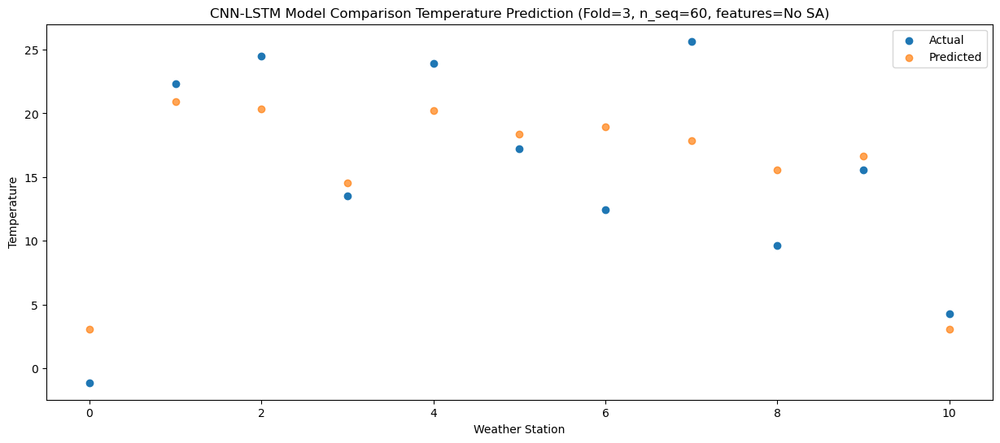

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51   2.854456
1                 1   22.61  20.664537
2                 2   21.52  20.134720
3                 3   12.48  14.294489
4                 4   23.39  19.994532
5                 5   16.68  18.114539
6                 6   12.15  18.744637
7                 7   22.79  17.664672
8                 8    8.37  15.344605
9                 9   13.86  16.424549
10               10    1.14   2.854544


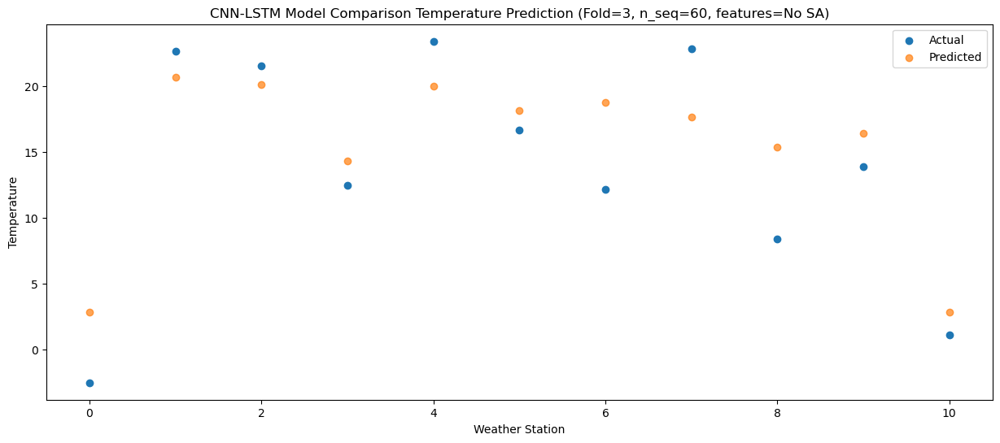

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20  -0.834911
1                 1   18.57  16.975167
2                 2   18.49  16.445354
3                 3    9.51  10.605121
4                 4   20.13  16.305163
5                 5   13.99  14.425170
6                 6    8.53  15.055268
7                 7   18.84  13.975304
8                 8    6.93  11.655237
9                 9    9.85  12.735179
10               10   -2.45  -0.834824


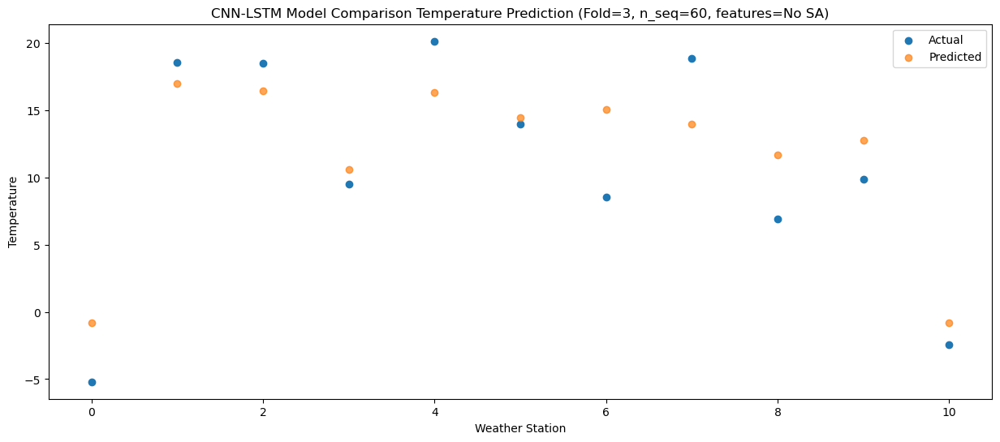

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51  -5.269939
1                 1   15.18  12.540133
2                 2   13.46  12.010318
3                 3    3.01   6.170090
4                 4   14.50  11.870131
5                 5    8.11   9.990137
6                 6    4.30  10.620231
7                 7   12.95   9.540267
8                 8    6.47   7.220202
9                 9    5.32   8.300151
10               10   -7.69  -5.269849


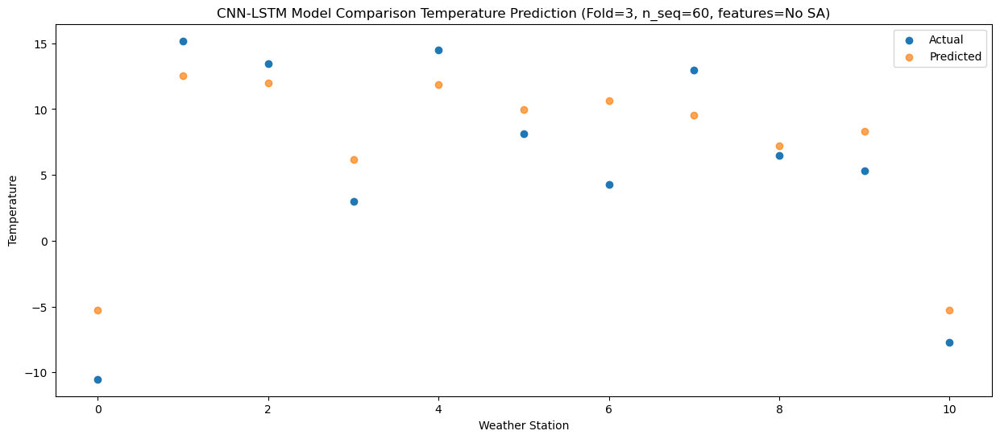

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_5 (Conv1D)           (None, 1, 256)            464896    
                                                                 
 max_pooling1d_5 (MaxPooling  (None, 1, 256)           0         
 1D)                                                             
                                                                 
 dropout_15 (Dropout)        (None, 1, 256)            0         
                                                                 
 lstm_10 (LSTM)              (None, 1, 1024)           5246976   
                                                                 
 dropout_16 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_11 (LSTM)              (None, 1024)              8392704   
                                                      

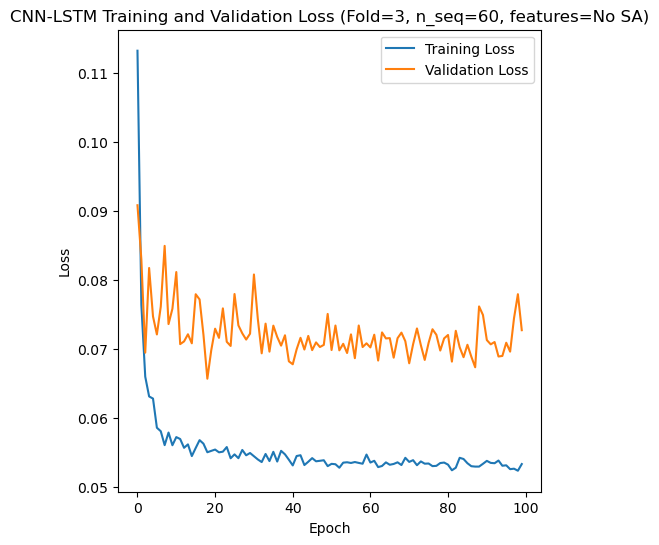

Epoch 1/100
84/84 [==============================] - 9s 60ms/step - loss: 0.1175 - accuracy: 0.2143 - mae: 0.0961 - rmse: 0.1175 - mape: inf - pearson: 0.6541 - val_loss: 0.0875 - val_accuracy: 0.6000 - val_mae: 0.0715 - val_rmse: 0.0875 - val_mape: 15.8079 - val_pearson: 0.7785
Epoch 2/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0755 - accuracy: 0.3690 - mae: 0.0606 - rmse: 0.0755 - mape: inf - pearson: 0.7982 - val_loss: 0.0812 - val_accuracy: 0.0000e+00 - val_mae: 0.0642 - val_rmse: 0.0812 - val_mape: 16.5647 - val_pearson: 0.8060
Epoch 3/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0690 - accuracy: 0.4405 - mae: 0.0552 - rmse: 0.0690 - mape: inf - pearson: 0.8122 - val_loss: 0.0637 - val_accuracy: 0.6000 - val_mae: 0.0511 - val_rmse: 0.0637 - val_mape: 11.8253 - val_pearson: 0.8550
Epoch 4/100
84/84 [==============================] - 4s 52ms/step - loss: 0.0645 - accuracy: 0.4405 - mae: 0.0515 - rmse: 0.0645 - mape: inf - pearson: 0.83

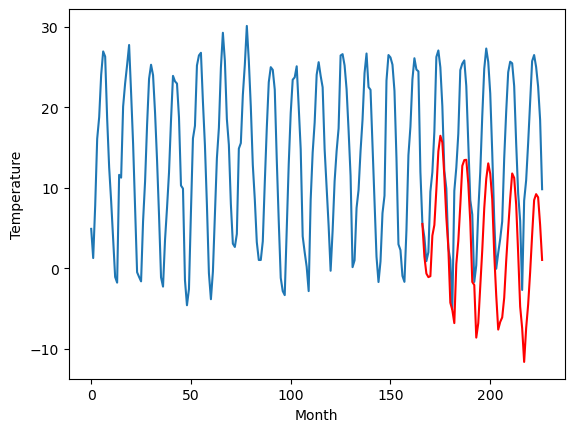

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-0.23		-0.60
0.19		-2.35		-2.54
-1.27		-2.79		-1.52
0.28		-2.67		-2.95
4.35		2.37		-1.98
6.03		3.69		-2.34
7.43		8.09		0.66
9.19		12.85		3.66
9.51		14.79		5.28
9.36		13.95		4.59
8.78		9.78		1.00
7.28		4.62		-2.66
3.89		0.89		-3.00
-3.86		-5.98		-2.12
-3.16		-6.88		-3.72
0.27		-8.51		-8.78
1.87		-1.18		-3.05
3.31		1.71		-1.60
7.35		6.16		-1.19
8.98		11.05		2.07
9.35		11.76		2.41
9.63		11.80		2.17
8.34		8.86		0.52
6.50		4.09		-2.41
-0.66		-3.39		-2.73
1.14		-3.78		-4.92
-3.62		-10.31		-6.69
-0.19		-8.52		-8.33
2.63		-3.94		-6.57
4.97		0.54		-4.43
7.79		5.78		-2.01
9.51		9.42		-0.09
9.88		11.35		1.47
9.83		10.06		0.23
8.39		6.90		-1.49
4.56		0.11		-4.45
3.10		-5.06		-8.16
-1.75		-9.32		-7.57
-1.90		-8.37		-6.47
1.40		-7.81		-9.21
3.12		-5.37		-8.49
5.84		-0.78		-6.62
6.62		3.20		-3.42
8.83		6.95		-1.88
10.44		10.10		-0.34
10.95		9.54		-1.41
8.85		6.22		-2.63
5.20		0.15		-5.05
1.49		-6.46		

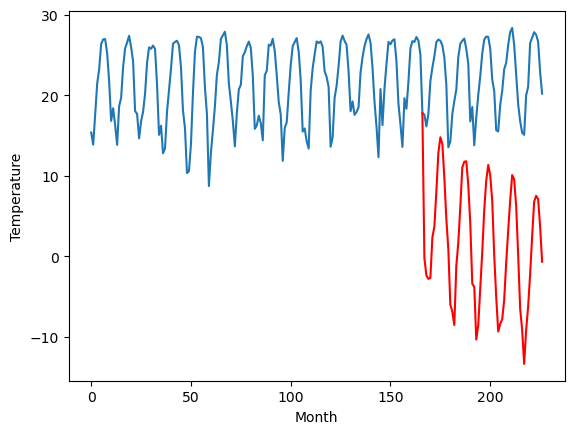

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-3.61		0.76
-4.31		-5.73		-1.42
-4.50		-6.17		-1.67
-4.24		-6.05		-1.81
3.56		-1.01		-4.57
2.61		0.31		-2.30
6.49		4.71		-1.78
10.58		9.47		-1.11
12.15		11.41		-0.74
11.32		10.57		-0.75
9.22		6.40		-2.82
3.88		1.24		-2.64
-0.12		-2.49		-2.37
-6.37		-9.36		-2.99
-6.34		-10.26		-3.92
-8.26		-11.89		-3.63
1.07		-4.56		-5.63
2.14		-1.67		-3.81
6.61		2.78		-3.83
10.87		7.67		-3.20
11.53		8.38		-3.15
12.18		8.42		-3.76
9.06		5.48		-3.58
5.67		0.71		-4.96
-3.00		-6.77		-3.77
0.51		-7.15		-7.66
-7.77		-13.69		-5.92
-5.41		-11.90		-6.49
-0.67		-7.32		-6.65
3.54		-2.84		-6.38
9.34		2.40		-6.94
12.63		6.04		-6.59
12.83		7.97		-4.86
11.29		6.68		-4.61
9.22		3.52		-5.70
3.09		-3.26		-6.35
-1.50		-8.44		-6.94
-3.93		-12.69		-8.76
-3.52		-11.74		-8.22
-1.58		-11.19		-9.61
0.57		-8.75		-9.32
2.32		-4.15		-6.47
7.18		-0.18		-7.36
10.77		3.58		-7.19
12.55		6.72		-5.83
14.63		6.16		-8.47
10.88		2.84		-8.

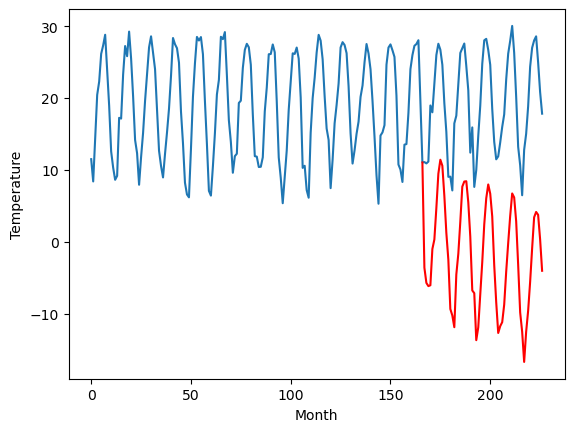

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-4.25		-0.61
-5.29		-6.37		-1.08
-5.05		-6.81		-1.76
-5.38		-6.69		-1.31
2.08		-1.65		-3.73
2.74		-0.33		-3.07
7.87		4.07		-3.80
12.83		8.83		-4.00
14.69		10.77		-3.92
14.44		9.93		-4.51
8.66		5.76		-2.90
2.93		0.60		-2.33
0.32		-3.13		-3.45
-5.96		-10.00		-4.04
-6.88		-10.90		-4.02
-10.34		-12.53		-2.19
0.62		-5.20		-5.82
2.31		-2.31		-4.62
6.47		2.15		-4.32
12.15		7.03		-5.12
13.74		7.74		-6.00
14.11		7.78		-6.33
11.32		4.84		-6.48
6.67		0.07		-6.60
-1.33		-7.41		-6.08
0.67		-7.79		-8.46
-7.80		-14.33		-6.53
-7.54		-12.54		-5.00
-1.36		-7.96		-6.60
4.69		-3.48		-8.17
9.40		1.76		-7.64
13.95		5.40		-8.55
17.25		7.33		-9.92
14.52		6.04		-8.48
11.09		2.88		-8.21
4.22		-3.90		-8.12
-2.83		-9.08		-6.25
-5.52		-13.33		-7.81
-4.53		-12.38		-7.85
-4.47		-11.83		-7.36
0.06		-9.39		-9.45
2.66		-4.79		-7.45
8.34		-0.82		-9.16
12.53		2.94		-9.59
15.08		6.08		-9.00
17.63		5.52		-12.11
12.93		2.20

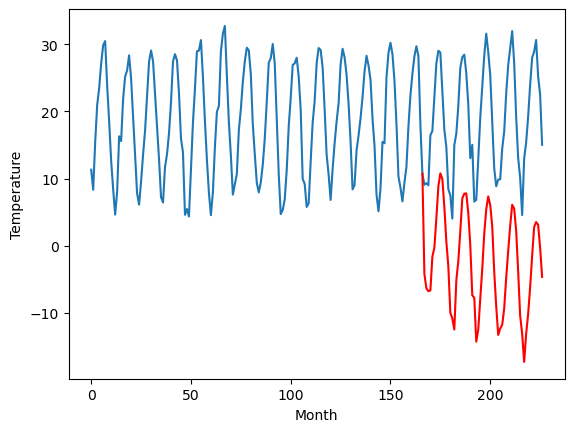

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-2.98		-0.21
-4.55		-5.10		-0.55
-3.93		-5.54		-1.61
-4.31		-5.42		-1.11
3.57		-0.38		-3.95
4.26		0.94		-3.32
9.91		5.34		-4.57
14.62		10.10		-4.52
17.06		12.04		-5.02
16.38		11.20		-5.18
10.08		7.03		-3.05
4.33		1.87		-2.46
1.57		-1.86		-3.43
-5.00		-8.73		-3.73
-5.60		-9.63		-4.03
-9.49		-11.26		-1.77
1.43		-3.93		-5.36
3.61		-1.04		-4.65
7.14		3.42		-3.72
13.99		8.30		-5.69
15.48		9.01		-6.47
15.85		9.05		-6.80
12.42		6.11		-6.31
7.55		1.34		-6.21
-0.29		-6.14		-5.85
1.45		-6.52		-7.97
-7.45		-13.06		-5.61
-6.83		-11.27		-4.44
0.09		-6.69		-6.78
6.78		-2.21		-8.99
11.61		3.03		-8.58
16.28		6.67		-9.61
19.70		8.60		-11.10
16.86		7.31		-9.55
12.77		4.15		-8.62
5.62		-2.63		-8.25
-1.47		-7.81		-6.34
-4.44		-12.06		-7.62
-3.67		-11.11		-7.44
-3.44		-10.56		-7.12
1.41		-8.12		-9.53
4.06		-3.52		-7.58
10.22		0.45		-9.77
15.33		4.21		-11.12
18.41		7.35		-11.06
20.28		6.79		-13.49
15.19		3.

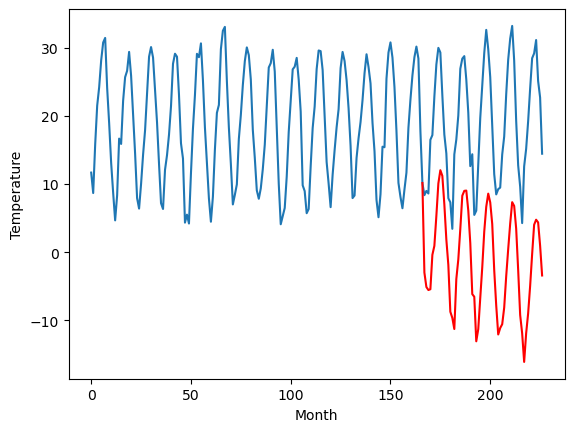

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		7.51		-1.30
7.17		5.39		-1.78
6.44		4.95		-1.49
5.68		5.07		-0.61
13.24		10.11		-3.13
16.21		11.43		-4.78
22.78		15.83		-6.95
26.11		20.59		-5.52
28.94		22.53		-6.41
28.32		21.69		-6.63
20.59		17.52		-3.07
16.63		12.36		-4.27
12.75		8.63		-4.12
5.77		1.76		-4.01
4.67		0.86		-3.81
3.10		-0.77		-3.87
12.35		6.56		-5.79
14.58		9.45		-5.13
20.07		13.90		-6.17
25.03		18.79		-6.24
24.77		19.50		-5.27
25.09		19.54		-5.55
24.40		16.60		-7.80
18.70		11.83		-6.87
11.76		4.35		-7.41
12.17		3.97		-8.20
4.80		-2.57		-7.37
4.60		-0.78		-5.38
11.92		3.80		-8.12
19.43		8.28		-11.15
25.12		13.52		-11.60
27.49		17.16		-10.33
29.39		19.09		-10.30
26.09		17.80		-8.29
23.19		14.64		-8.55
16.38		7.86		-8.52
8.53		2.68		-5.85
6.93		-1.57		-8.50
7.30		-0.62		-7.92
7.47		-0.07		-7.54
12.54		2.37		-10.17
16.76		6.97		-9.79
21.68		10.94		-10.74
28.16		14.70		-13.46
29.62		17.84		-11.78
29.71		17.28		-12.43
26.23	

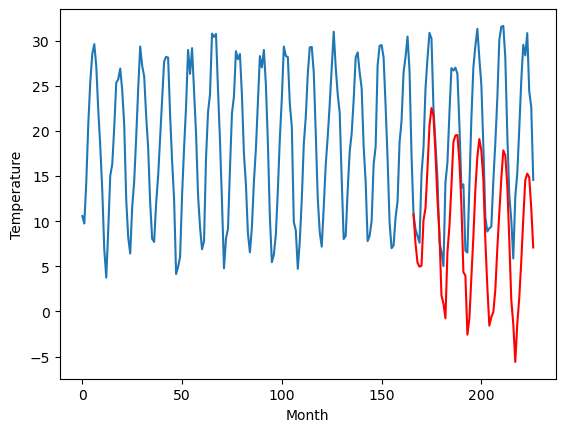

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		3.62		1.83
1.44		1.50		0.06
1.27		1.06		-0.21
1.74		1.18		-0.56
7.35		6.22		-1.13
8.62		7.54		-1.08
11.41		11.94		0.53
16.00		16.70		0.70
19.04		18.64		-0.40
17.84		17.80		-0.04
14.04		13.63		-0.41
10.22		8.47		-1.75
5.91		4.74		-1.17
-1.34		-2.13		-0.79
-1.11		-3.03		-1.92
-0.44		-4.66		-4.22
5.96		2.67		-3.29
8.69		5.56		-3.13
12.14		10.01		-2.13
16.16		14.90		-1.26
17.90		15.61		-2.29
18.03		15.65		-2.38
14.06		12.71		-1.35
10.26		7.94		-2.32
2.10		0.46		-1.64
4.01		0.08		-3.93
-2.05		-6.46		-4.41
2.23		-4.67		-6.90
5.79		-0.09		-5.88
8.45		4.39		-4.06
14.43		9.63		-4.80
17.64		13.27		-4.37
18.91		15.20		-3.71
17.39		13.91		-3.48
14.30		10.75		-3.55
7.43		3.97		-3.46
4.73		-1.21		-5.94
-1.22		-5.46		-4.24
1.80		-4.51		-6.31
5.22		-3.96		-9.18
5.70		-1.52		-7.22
8.81		3.08		-5.73
11.43		7.05		-4.38
15.07		10.81		-4.26
18.94		13.95		-4.99
18.38		13.39		-4.99
14.54		10.07		-4.47
9.10		4

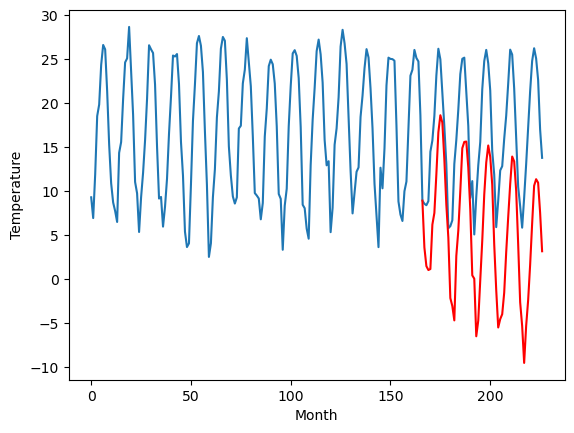

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		3.44		-0.56
3.19		1.32		-1.87
1.54		0.88		-0.66
2.11		1.00		-1.11
9.04		6.04		-3.00
10.62		7.36		-3.26
14.72		11.76		-2.96
21.07		16.52		-4.55
23.61		18.46		-5.15
21.62		17.62		-4.00
18.04		13.45		-4.59
11.11		8.29		-2.82
8.56		4.56		-4.00
2.03		-2.30		-4.33
0.36		-3.21		-3.57
-3.25		-4.84		-1.59
9.02		2.49		-6.53
10.92		5.38		-5.54
14.96		9.84		-5.12
21.26		14.72		-6.54
22.55		15.43		-7.12
23.07		15.47		-7.60
20.03		12.53		-7.50
14.26		7.76		-6.50
6.32		0.28		-6.04
7.78		-0.10		-7.88
-1.29		-6.64		-5.35
0.77		-4.85		-5.62
7.43		-0.27		-7.70
11.29		4.21		-7.08
16.96		9.45		-7.51
22.28		13.09		-9.19
25.98		15.02		-10.96
22.46		13.73		-8.73
18.87		10.57		-8.30
12.50		3.79		-8.71
5.95		-1.38		-7.33
1.10		-5.64		-6.74
2.75		-4.69		-7.44
4.89		-4.14		-9.03
6.61		-1.69		-8.30
12.23		2.90		-9.33
17.01		6.87		-10.14
21.09		10.63		-10.46
23.05		13.77		-9.28
22.86		13.22		-9.64
18.92		9.89		-9.03

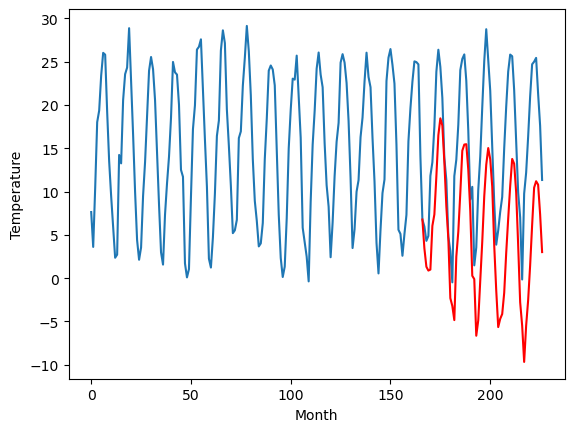

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		3.82		2.41
0.59		1.70		1.11
-0.34		1.26		1.60
-1.17		1.38		2.55
5.65		6.42		0.77
8.64		7.74		-0.90
14.22		12.14		-2.08
21.51		16.90		-4.61
23.55		18.84		-4.71
21.35		18.00		-3.35
17.59		13.83		-3.76
10.75		8.67		-2.08
6.91		4.94		-1.97
-0.60		-1.92		-1.32
-2.18		-2.83		-0.65
-5.54		-4.46		1.08
6.43		2.87		-3.56
10.08		5.76		-4.32
14.49		10.22		-4.27
21.73		15.10		-6.63
22.30		15.81		-6.49
23.16		15.85		-7.31
19.67		12.91		-6.76
14.32		8.14		-6.18
3.46		0.66		-2.80
3.78		0.28		-3.50
-5.06		-6.26		-1.20
-2.04		-4.47		-2.43
5.43		0.11		-5.32
9.21		4.59		-4.62
17.71		9.83		-7.88
22.19		13.47		-8.72
24.13		15.41		-8.72
21.90		14.11		-7.79
17.99		10.95		-7.04
10.50		4.17		-6.33
4.71		-1.00		-5.71
-1.07		-5.26		-4.19
0.89		-4.31		-5.20
2.48		-3.76		-6.24
3.75		-1.31		-5.06
10.25		3.28		-6.97
15.96		7.25		-8.71
19.84		11.01		-8.83
22.57		14.15		-8.42
21.41		13.60		-7.81
18.32		10.27		-8.05
12.1

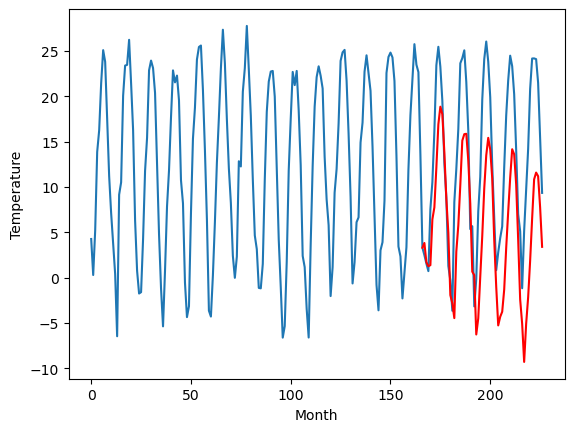

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		2.69		1.27
1.10		0.57		-0.53
-1.34		0.13		1.47
-1.59		0.24		1.83
6.01		5.29		-0.72
9.12		6.61		-2.51
15.00		11.01		-3.99
22.73		15.77		-6.96
23.94		17.71		-6.23
21.34		16.87		-4.47
17.44		12.70		-4.74
10.10		7.54		-2.56
7.46		3.81		-3.65
-0.42		-3.05		-2.63
-2.45		-3.96		-1.51
-6.89		-5.59		1.30
6.97		1.74		-5.23
10.68		4.63		-6.05
15.46		9.09		-6.37
22.85		13.97		-8.88
22.56		14.68		-7.88
22.84		14.72		-8.12
19.73		11.78		-7.95
14.27		7.01		-7.26
3.96		-0.47		-4.43
3.71		-0.85		-4.56
-5.77		-7.39		-1.62
-2.94		-5.60		-2.66
5.27		-1.02		-6.29
9.39		3.46		-5.93
17.92		8.70		-9.22
22.53		12.34		-10.19
23.35		14.28		-9.07
22.05		12.98		-9.07
17.91		9.82		-8.09
10.44		3.04		-7.40
4.90		-2.13		-7.03
-1.83		-6.39		-4.56
0.41		-5.44		-5.85
1.60		-4.88		-6.48
4.14		-2.44		-6.58
11.47		2.15		-9.32
17.23		6.12		-11.11
21.54		9.88		-11.66
23.07		13.02		-10.05
21.81		12.47		-9.34
18.77		9.14		-9.6

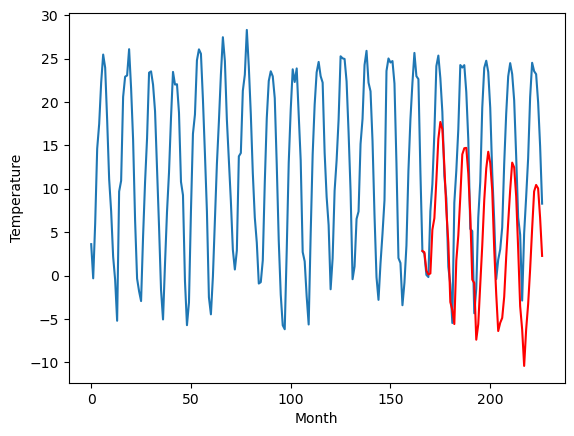

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		1.45		2.54
-1.87		-0.67		1.20
-3.07		-1.11		1.96
-3.88		-0.99		2.89
2.28		4.05		1.77
3.66		5.37		1.71
10.40		9.77		-0.63
16.89		14.53		-2.36
20.33		16.47		-3.86
17.92		15.63		-2.29
13.93		11.46		-2.47
7.77		6.30		-1.47
4.54		2.57		-1.97
-3.02		-4.29		-1.27
-4.94		-5.20		-0.26
-7.18		-6.83		0.35
2.71		0.50		-2.21
6.51		3.39		-3.12
11.04		7.85		-3.19
17.93		12.73		-5.20
18.09		13.44		-4.65
19.29		13.48		-5.81
15.00		10.54		-4.46
11.47		5.77		-5.70
1.07		-1.71		-2.78
0.21		-2.09		-2.30
-8.62		-8.63		-0.01
-5.06		-6.84		-1.78
0.91		-2.26		-3.17
4.91		2.22		-2.69
13.49		7.46		-6.03
16.76		11.10		-5.66
19.36		13.03		-6.33
18.29		11.74		-6.55
14.24		8.58		-5.66
7.38		1.80		-5.58
3.30		-3.37		-6.67
-3.41		-7.63		-4.22
-1.78		-6.68		-4.90
-1.64		-6.13		-4.49
-0.76		-3.68		-2.92
7.71		0.91		-6.80
11.40		4.88		-6.52
15.71		8.64		-7.07
18.80		11.78		-7.02
17.47		11.23		-6.24
15.13		7.90		-7.23
9.

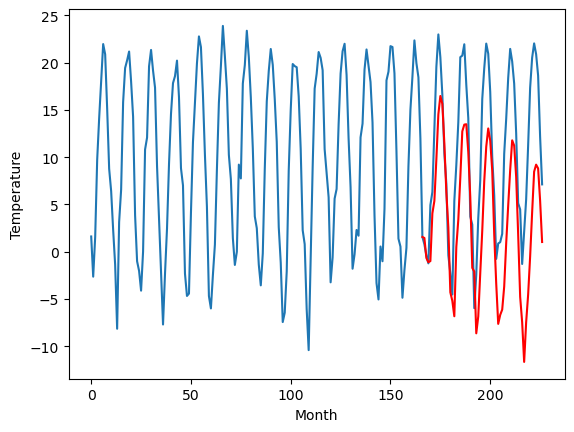

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.4509165954589847, -0.228693828582764, -3.6087891960144045, -4.248858814239502, -2.978869781494141, 7.511181240081788, 3.6212069892883303, 3.4410615539550786, 3.820938053131103, 2.690865573883057, 1.4509781074523929]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   1.450917
1                 1    0.37  -0.228694
2                 2   -4.37  -3.608789
3                 3   -3.64  -4.248859
4                 4   -2.77  -2.978870
5                 5    8.81   7.511181
6                 6    1.79   3.621207
7                 7    4.00   3.441062
8                 8    1.41   3.820938
9                 9    1.42   2.690866
10               10   -1.09   1.450978


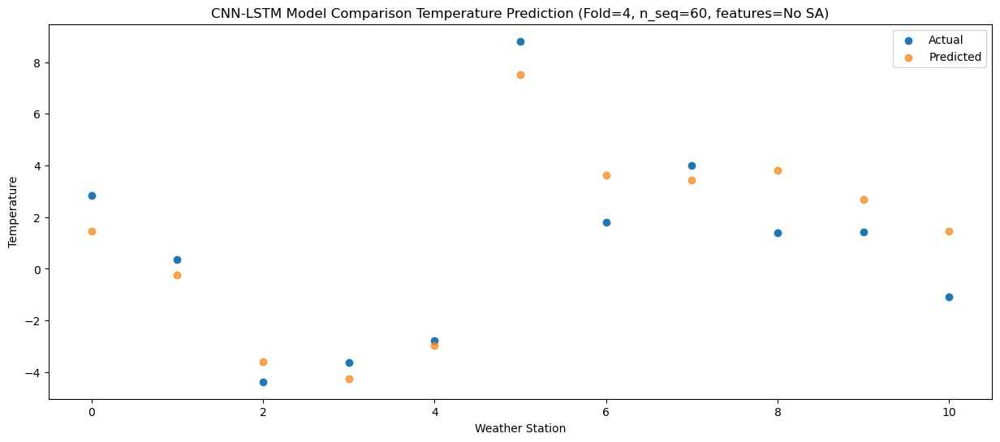

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.668819
1                 1    0.19  -2.348530
2                 2   -4.31  -5.728601
3                 3   -5.29  -6.368651
4                 4   -4.55  -5.098658
5                 5    7.17   5.391381
6                 6    1.44   1.501397
7                 7    3.19   1.321292
8                 8    0.59   1.701196
9                 9    1.10   0.571150
10               10   -1.87  -0.668773


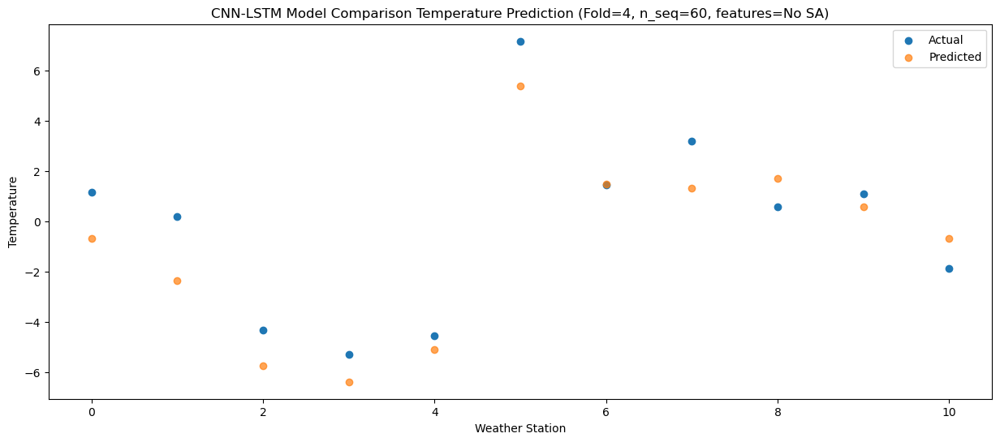

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.111324
1                 1   -1.27  -2.790871
2                 2   -4.50  -6.170984
3                 3   -5.05  -6.811064
4                 4   -3.93  -5.541076
5                 5    6.44   4.948979
6                 6    1.27   1.059018
7                 7    1.54   0.878851
8                 8   -0.34   1.258714
9                 9   -1.34   0.128631
10               10   -3.07  -1.111239


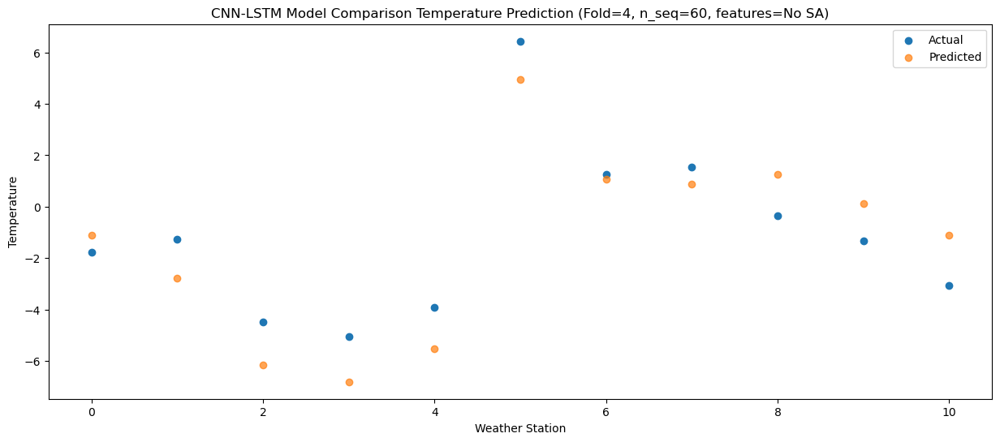

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -0.995027
1                 1    0.28  -2.674688
2                 2   -4.24  -6.054771
3                 3   -5.38  -6.694830
4                 4   -4.31  -5.424836
5                 5    5.68   5.065205
6                 6    1.74   1.175233
7                 7    2.11   0.995109
8                 8   -1.17   1.375009
9                 9   -1.59   0.244945
10               10   -3.88  -0.994956


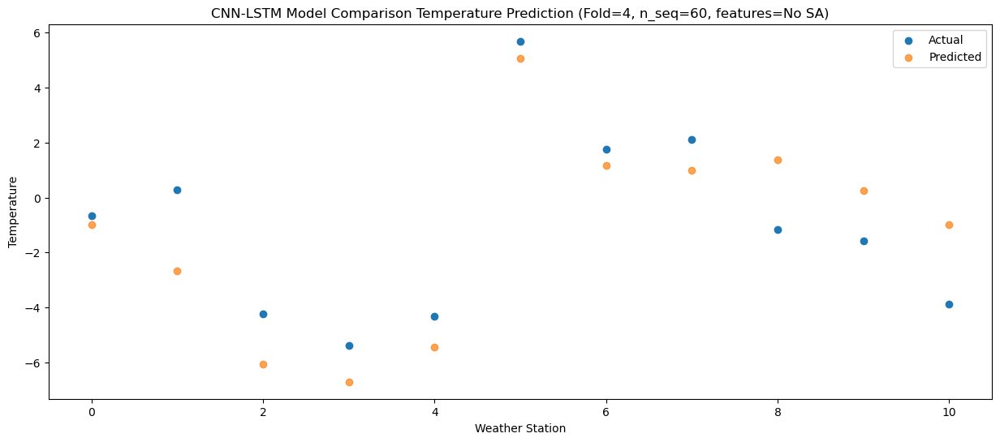

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   4.049978
1                 1    4.35   2.370264
2                 2    3.56  -1.009811
3                 3    2.08  -1.649864
4                 4    3.57  -0.379869
5                 5   13.24  10.110155
6                 6    7.35   6.220201
7                 7    9.04   6.040092
8                 8    5.65   6.420018
9                 9    6.01   5.289966
10               10    2.28   4.050045


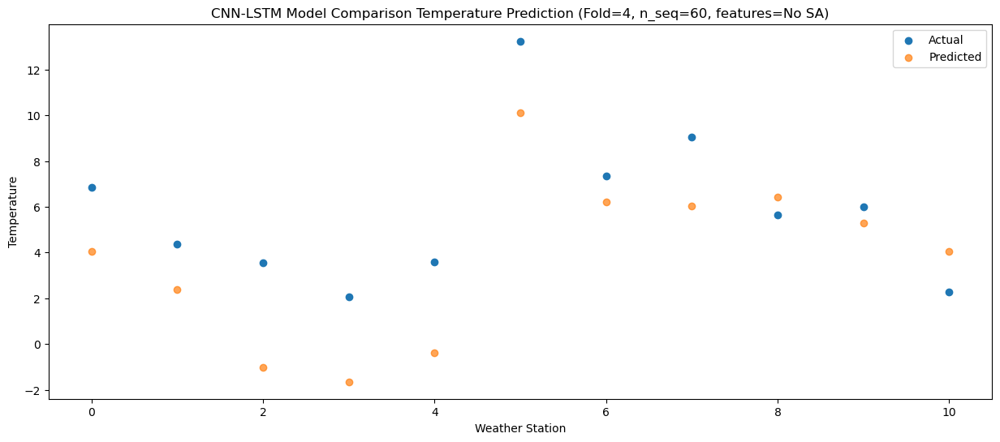

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   5.371541
1                 1    6.03   3.691804
2                 2    2.61   0.311728
3                 3    2.74  -0.328321
4                 4    4.26   0.941679
5                 5   16.21  11.431695
6                 6    8.62   7.541742
7                 7   10.62   7.361644
8                 8    8.64   7.741581
9                 9    9.12   6.611533
10               10    3.66   5.371608


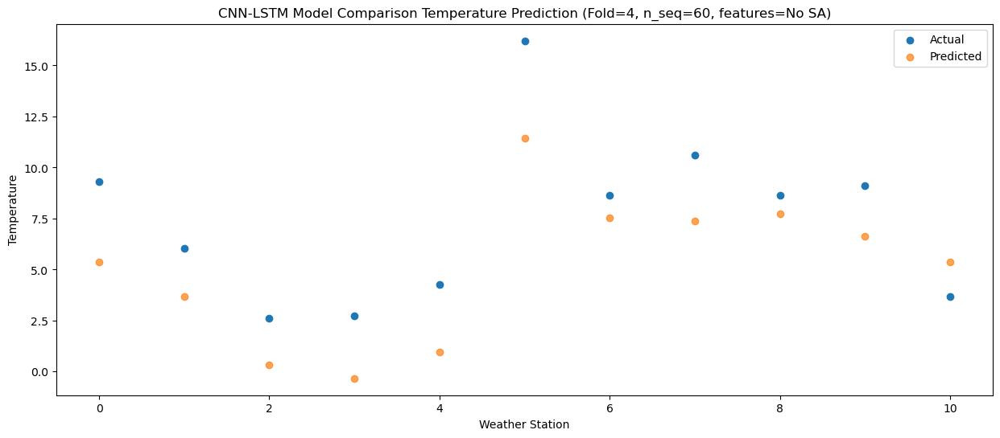

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36   9.768667
1                 1    7.43   8.088890
2                 2    6.49   4.708812
3                 3    7.87   4.068772
4                 4    9.91   5.338770
5                 5   22.78  15.828790
6                 6   11.41  11.938831
7                 7   14.72  11.758745
8                 8   14.22  12.138700
9                 9   15.00  11.008662
10               10   10.40   9.768725


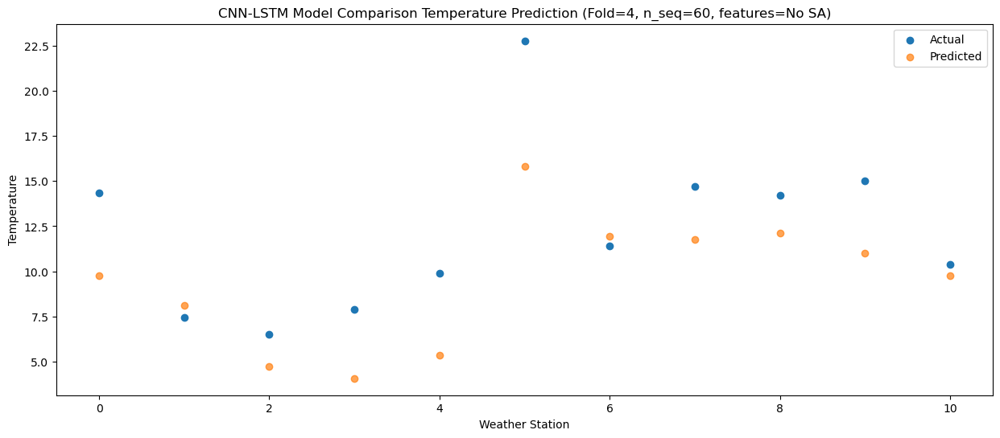

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  14.527458
1                 1    9.19  12.847616
2                 2   10.58   9.467558
3                 3   12.83   8.827530
4                 4   14.62  10.097534
5                 5   26.11  20.587546
6                 6   16.00  16.697575
7                 7   21.07  16.517512
8                 8   21.51  16.897486
9                 9   22.73  15.767459
10               10   16.89  14.527501


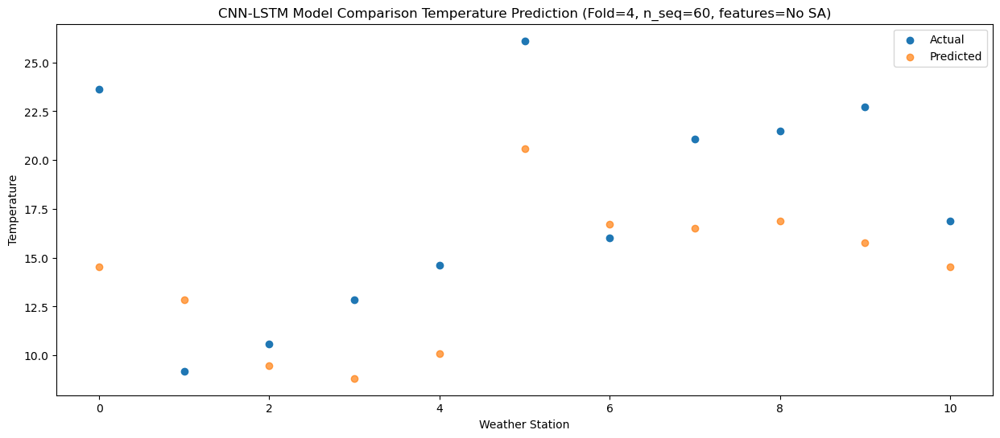

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  16.472023
1                 1    9.51  14.791884
2                 2   12.15  11.411903
3                 3   14.69  10.771938
4                 4   17.06  12.041953
5                 5   28.94  22.531932
6                 6   19.04  18.641916
7                 7   23.61  18.461967
8                 8   23.55  18.842023
9                 9   23.94  17.712051
10               10   20.33  16.472010


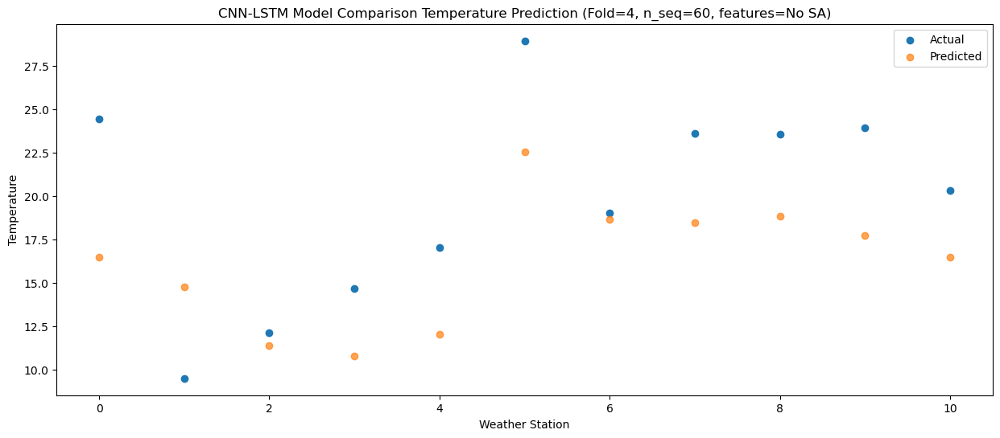

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  15.632451
1                 1    9.36  13.951911
2                 2   11.32  10.572027
3                 3   14.44   9.932151
4                 4   16.38  11.202179
5                 5   28.32  21.692107
6                 6   17.84  17.802037
7                 7   21.62  17.622249
8                 8   21.35  18.002419
9                 9   21.34  16.872523
10               10   17.92  15.632355


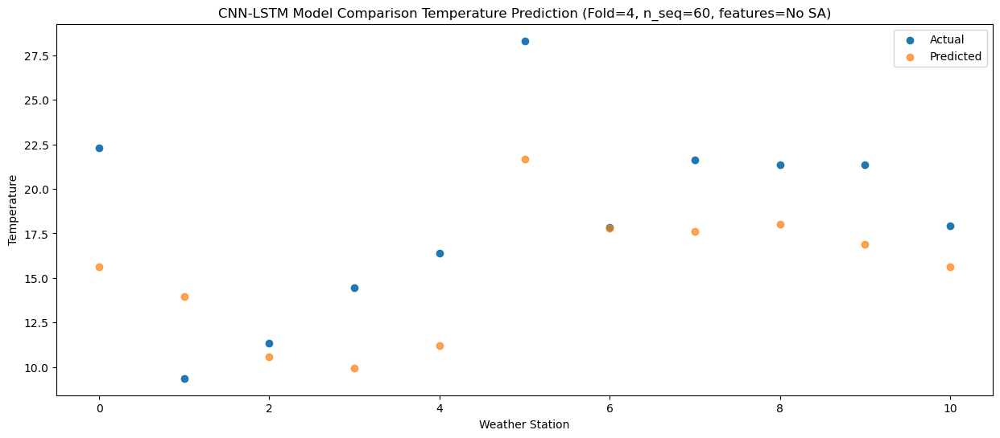

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  11.457748
1                 1    8.78   9.777116
2                 2    9.22   6.397255
3                 3    8.66   5.757396
4                 4   10.08   7.027427
5                 5   20.59  17.517345
6                 6   14.04  13.627262
7                 7   18.04  13.447509
8                 8   17.59  13.827707
9                 9   17.44  12.697831
10               10   13.93  11.457628


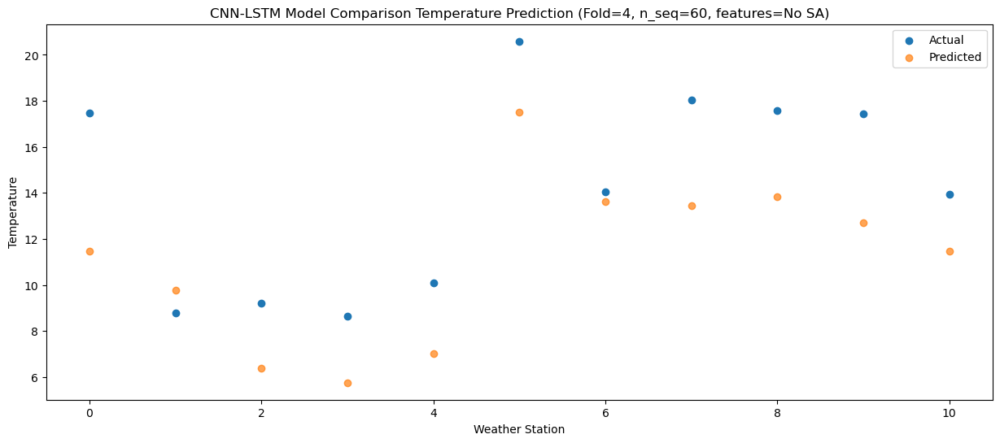

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   6.304046
1                 1    7.28   4.623138
2                 2    3.88   1.243346
3                 3    2.93   0.603542
4                 4    4.33   1.873581
5                 5   16.63  12.363461
6                 6   10.22   8.473355
7                 7   11.11   8.293705
8                 8   10.75   8.673986
9                 9   10.10   7.544163
10               10    7.77   6.303880


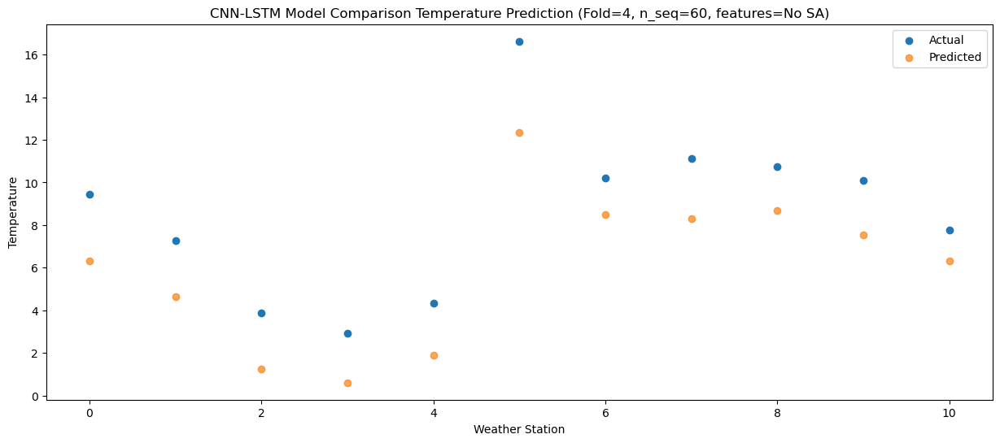

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   2.569696
1                 1    3.89   0.889040
2                 2   -0.12  -2.490817
3                 3    0.32  -3.130670
4                 4    1.57  -1.860640
5                 5   12.75   8.629268
6                 6    5.91   4.739203
7                 7    8.56   4.559449
8                 8    6.91   4.939666
9                 9    7.46   3.809791
10               10    4.54   2.569585


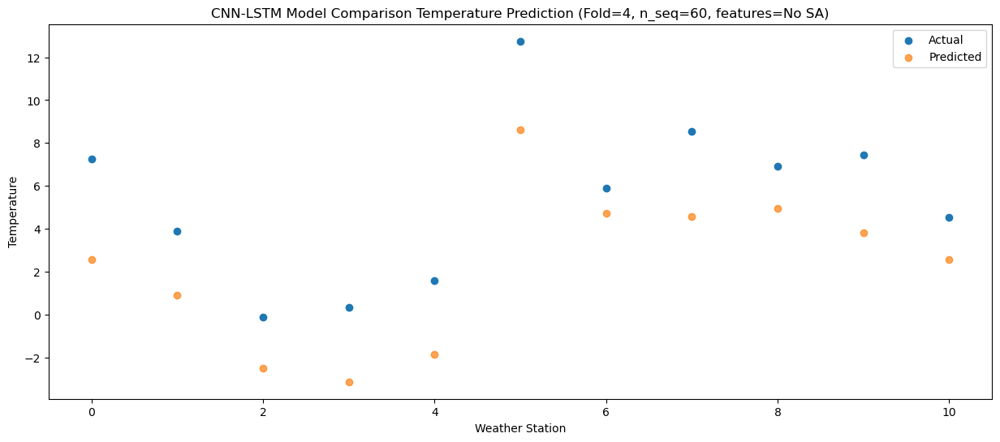

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -4.294467
1                 1   -3.86  -5.975721
2                 2   -6.37  -9.355429
3                 3   -5.96  -9.995165
4                 4   -5.00  -8.725116
5                 5    5.77   1.764716
6                 6   -1.34  -2.125407
7                 7    2.03  -2.304938
8                 8   -0.60  -1.924542
9                 9   -0.42  -3.054300
10               10   -3.02  -4.294687


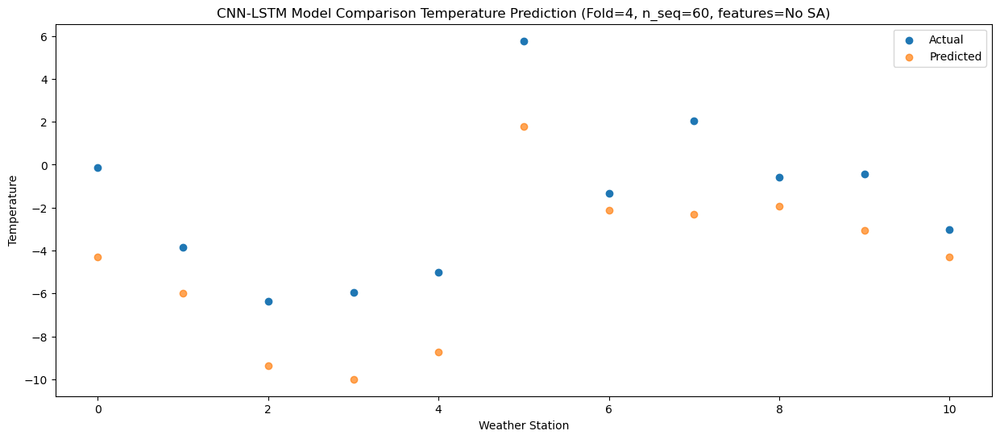

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -5.196762
1                 1   -3.16  -6.878210
2                 2   -6.34 -10.257871
3                 3   -6.88 -10.897566
4                 4   -5.60  -9.627513
5                 5    4.67   0.862299
6                 6   -1.11  -3.027852
7                 7    0.36  -3.207306
8                 8   -2.18  -2.826849
9                 9   -2.45  -3.956577
10               10   -4.94  -5.197020


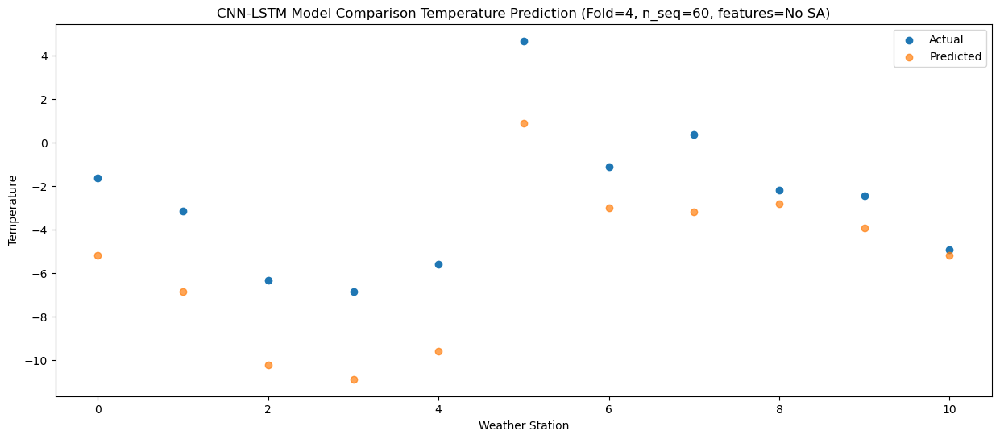

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -6.829093
1                 1    0.27  -8.510261
2                 2   -8.26 -11.889990
3                 3  -10.34 -12.529746
4                 4   -9.49 -11.259707
5                 5    3.10  -0.769860
6                 6   -0.44  -4.659973
7                 7   -3.25  -4.839529
8                 8   -5.54  -4.459148
9                 9   -6.89  -5.588922
10               10   -7.18  -6.829286


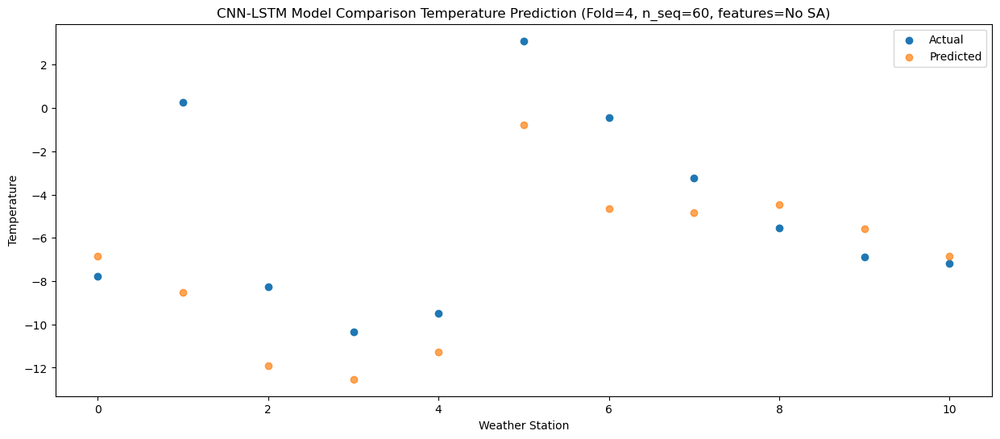

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   0.497199
1                 1    1.87  -1.184377
2                 2    1.07  -4.564008
3                 3    0.62  -5.203685
4                 4    1.43  -3.933639
5                 5   12.35   6.556154
6                 6    5.96   2.666009
7                 7    9.02   2.486614
8                 8    6.43   2.867120
9                 9    6.97   1.737425
10               10    2.71   0.496939


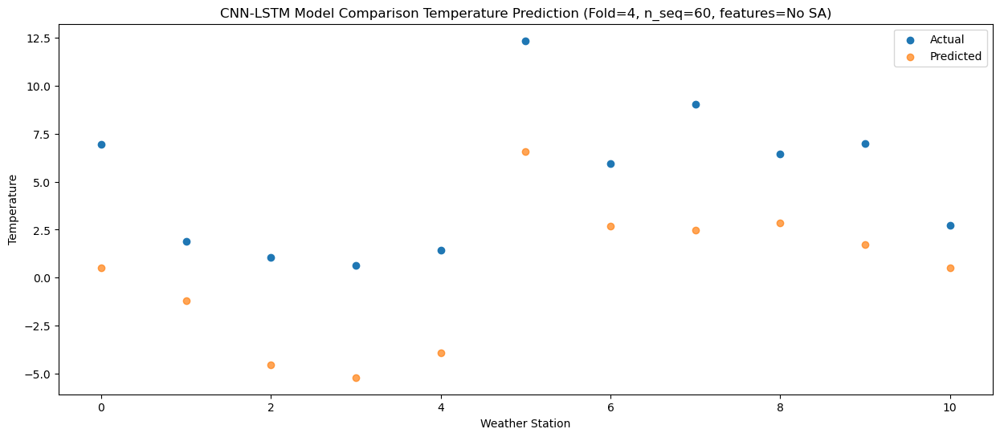

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   3.388002
1                 1    3.31   1.706177
2                 2    2.14  -1.673391
3                 3    2.31  -2.313018
4                 4    3.61  -1.042967
5                 5   14.58   9.446790
6                 6    8.69   5.556621
7                 7   10.92   5.377328
8                 8   10.08   5.757910
9                 9   10.68   4.628261
10               10    6.51   3.387698


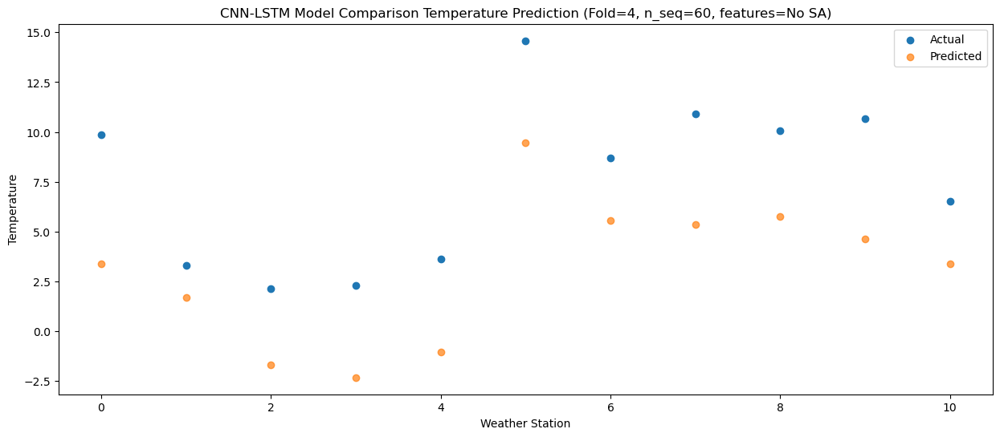

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07   7.846294
1                 1    7.35   6.164304
2                 2    6.61   2.784775
3                 3    6.47   2.145188
4                 4    7.14   3.415240
5                 5   20.07  13.904990
6                 6   12.14  10.014788
7                 7   14.96   9.835560
8                 8   14.49  10.216174
9                 9   15.46   9.086555
10               10   11.04   7.845939


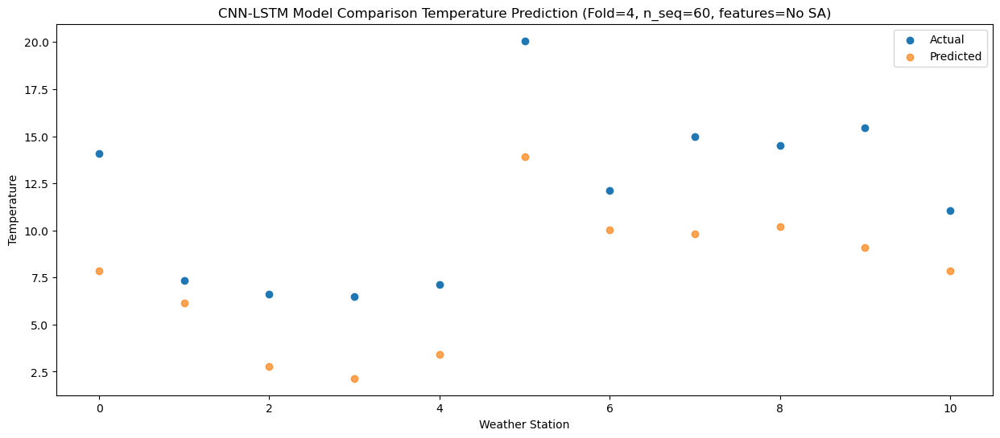

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  12.729120
1                 1    8.98  11.047517
2                 2   10.87   7.667888
3                 3   12.15   7.028220
4                 4   13.99   8.298255
5                 5   25.03  18.788044
6                 6   16.16  14.897909
7                 7   21.26  14.718521
8                 8   21.73  15.099040
9                 9   22.85  13.969346
10               10   17.93  12.728852


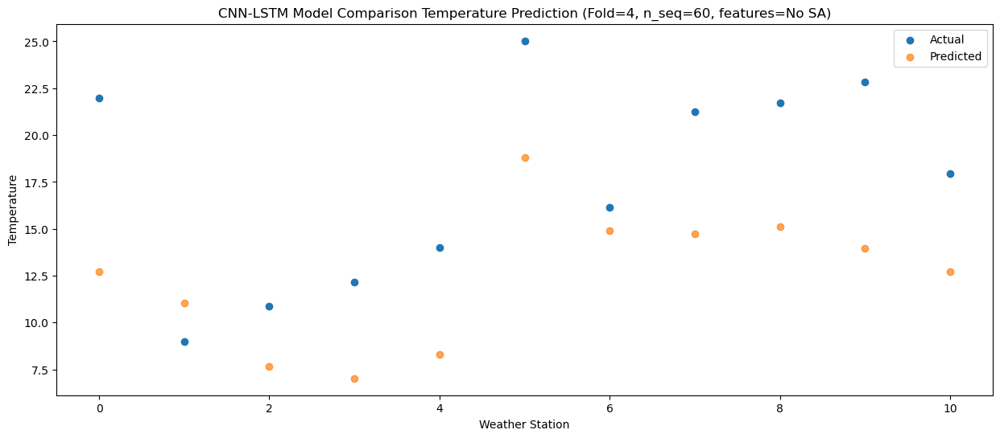

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  13.441011
1                 1    9.35  11.759445
2                 2   11.53   8.379804
3                 3   13.74   7.740121
4                 4   15.48   9.010155
5                 5   24.77  19.499943
6                 6   17.90  15.609831
7                 7   22.55  15.430428
8                 8   22.30  15.810946
9                 9   22.56  14.681238
10               10   18.09  13.440766


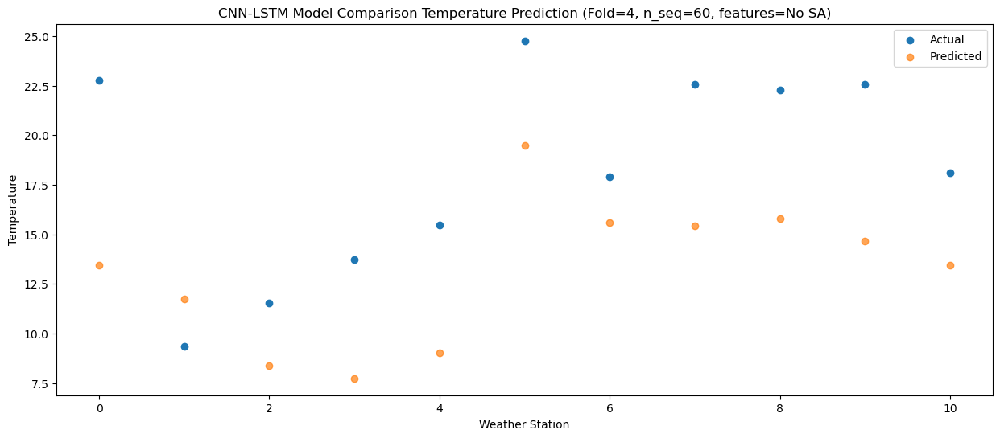

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  13.483280
1                 1    9.63  11.801646
2                 2   12.18   8.422023
3                 3   14.11   7.782351
4                 4   15.85   9.052387
5                 5   25.09  19.542165
6                 6   18.03  15.652045
7                 7   23.07  15.472674
8                 8   23.16  15.853208
9                 9   22.84  14.723520
10               10   19.29  13.483020


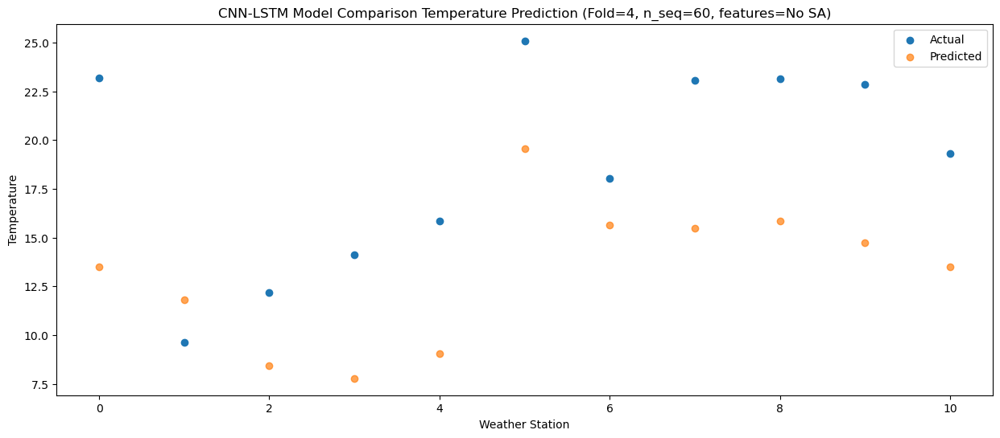

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  10.543074
1                 1    8.34   8.861388
2                 2    9.06   5.481781
3                 3   11.32   4.842119
4                 4   12.42   6.112161
5                 5   24.40  16.601929
6                 6   14.06  12.711803
7                 7   20.03  12.532449
8                 8   19.67  12.912998
9                 9   19.73  11.783317
10               10   15.00  10.542798


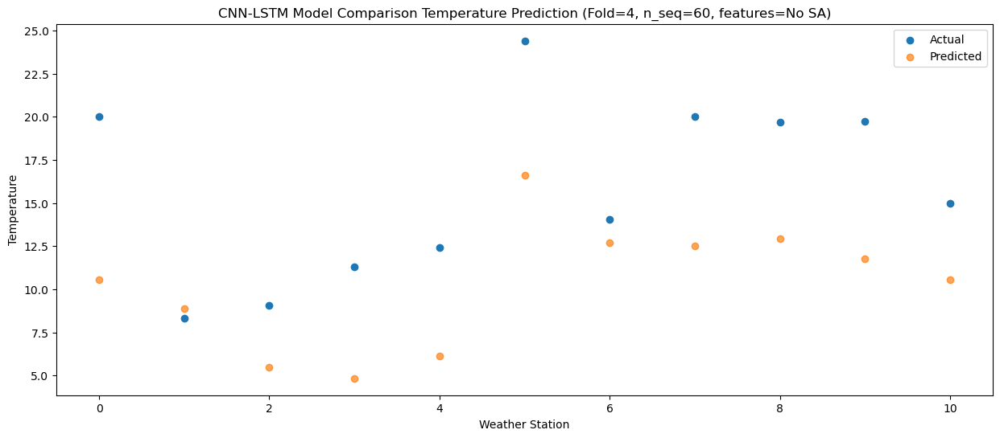

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86   5.771800
1                 1    6.50   4.090216
2                 2    5.67   0.710577
3                 3    6.67   0.070895
4                 4    7.55   1.340933
5                 5   18.70  11.830717
6                 6   10.26   7.940603
7                 7   14.26   7.761208
8                 8   14.32   8.141728
9                 9   14.27   7.012031
10               10   11.47   5.771543


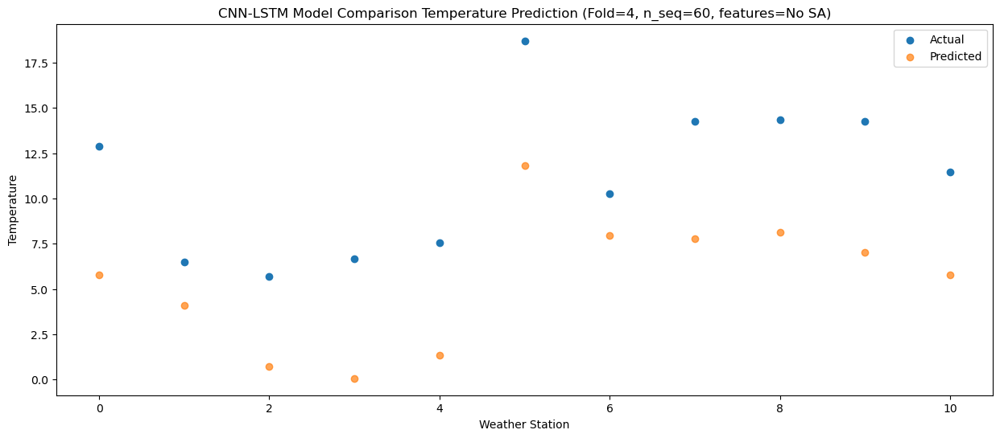

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80  -1.711941
1                 1   -0.66  -3.393434
2                 2   -3.00  -6.773095
3                 3   -1.33  -7.412796
4                 4   -0.29  -6.142762
5                 5   11.76   4.347032
6                 6    2.10   0.456932
7                 7    6.32   0.277502
8                 8    3.46   0.657998
9                 9    3.96  -0.471713
10               10    1.07  -1.712179


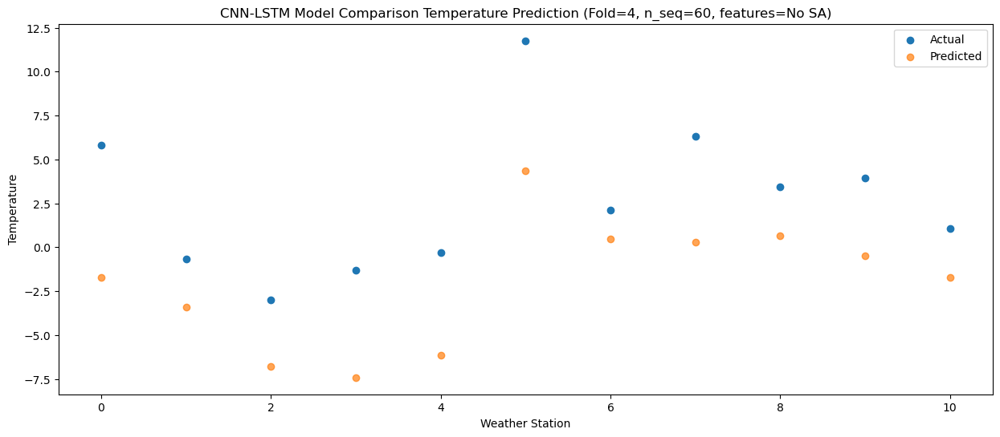

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01  -2.093592
1                 1    1.14  -3.775170
2                 2    0.51  -7.154813
3                 3    0.67  -7.794493
4                 4    1.45  -6.524459
5                 5   12.17   3.965326
6                 6    4.01   0.075217
7                 7    7.78  -0.104182
8                 8    3.78   0.276339
9                 9    3.71  -0.853358
10               10    0.21  -2.093847


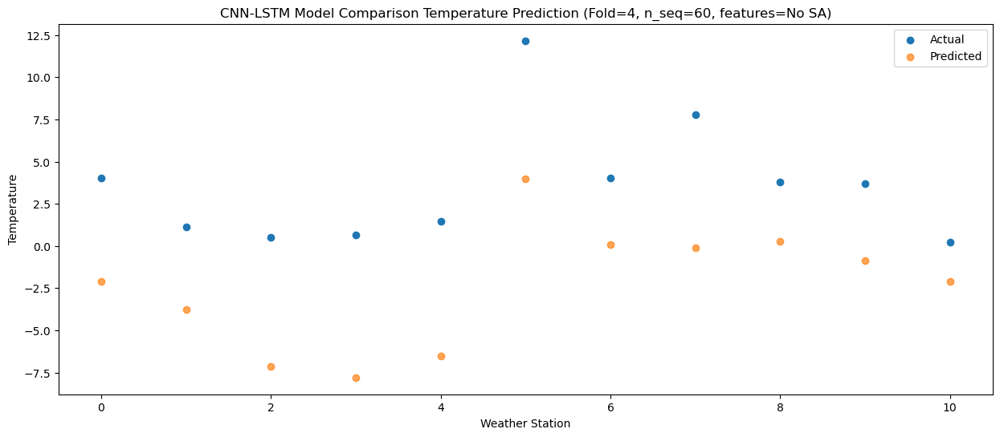

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -8.633381
1                 1   -3.62 -10.314906
2                 2   -7.77 -13.694562
3                 3   -7.80 -14.334254
4                 4   -7.45 -13.064223
5                 5    4.80  -2.574435
6                 6   -2.05  -6.464530
7                 7   -1.29  -6.643952
8                 8   -5.06  -6.263440
9                 9   -5.77  -7.393143
10               10   -8.62  -8.633619


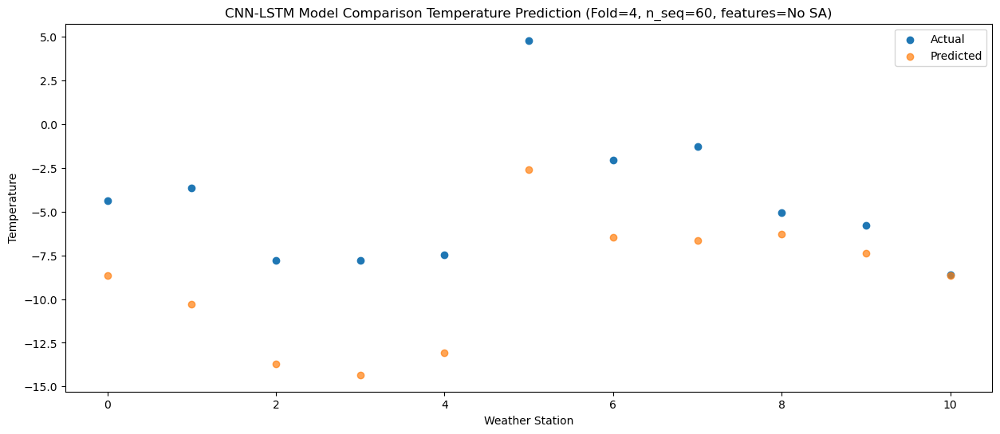

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -6.842347
1                 1   -0.19  -8.523407
2                 2   -5.41 -11.903179
3                 3   -7.54 -12.542964
4                 4   -6.83 -11.272943
5                 5    4.60  -0.783091
6                 6    2.23  -4.673147
7                 7    0.77  -4.852747
8                 8   -2.04  -4.472379
9                 9   -2.94  -5.602177
10               10   -5.06  -6.842515


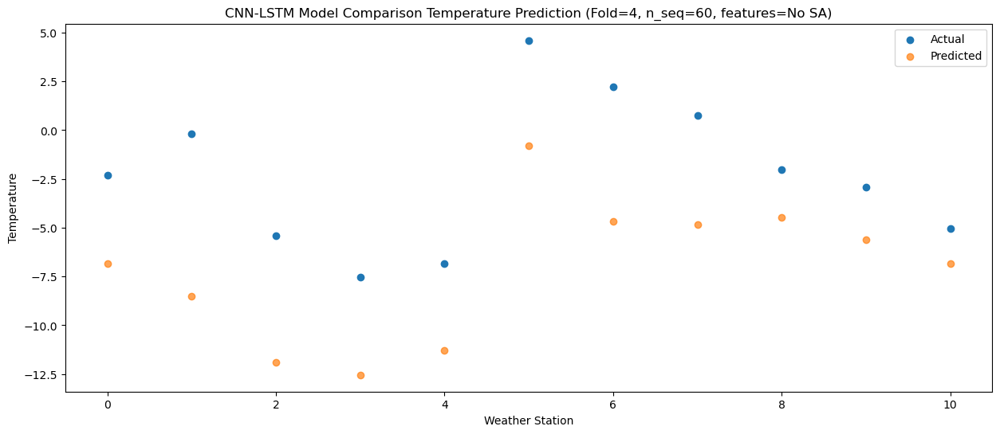

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41  -2.262743
1                 1    2.63  -3.943738
2                 2   -0.67  -7.323526
3                 3   -1.36  -7.963322
4                 4    0.09  -6.693301
5                 5   11.92   3.796554
6                 6    5.79  -0.093490
7                 7    7.43  -0.273116
8                 8    5.43   0.107227
9                 9    5.27  -1.022584
10               10    0.91  -2.262897


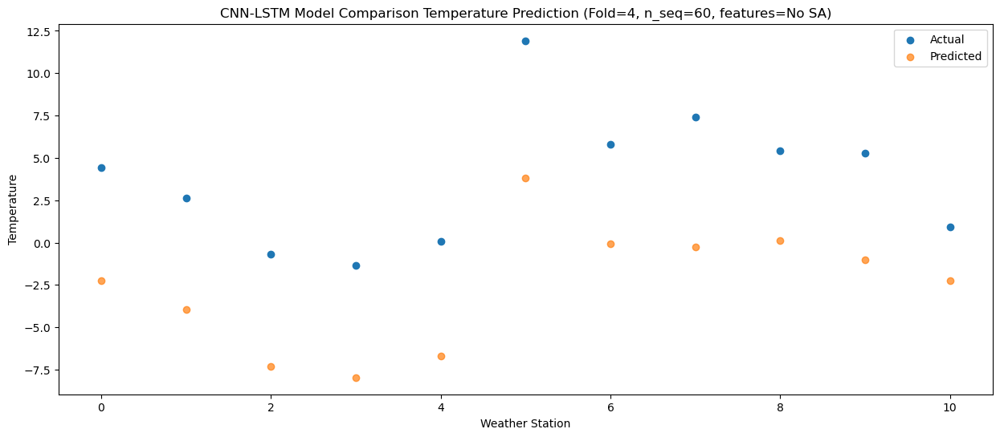

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   2.220763
1                 1    4.97   0.539946
2                 2    3.54  -2.839890
3                 3    4.69  -3.479724
4                 4    6.78  -2.209707
5                 5   19.43   8.280170
6                 6    8.45   4.390143
7                 7   11.29   4.210449
8                 8    9.21   4.590745
9                 9    9.39   3.460902
10               10    4.91   2.220652


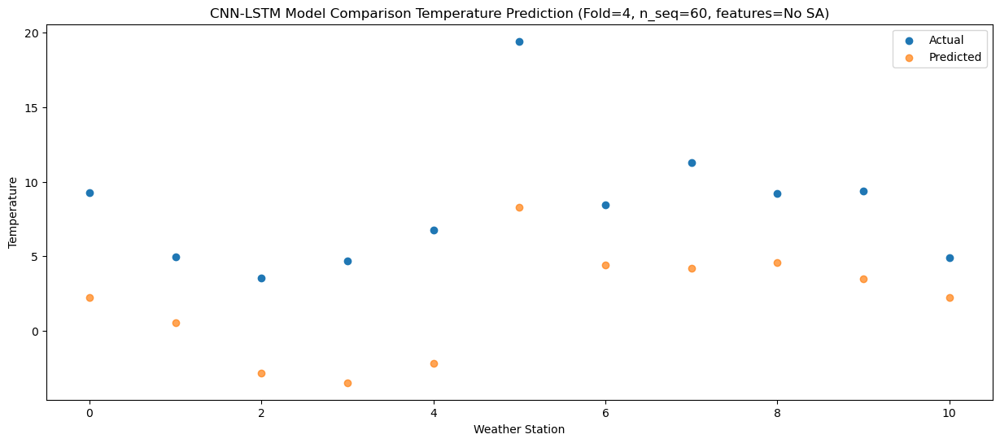

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23   7.461380
1                 1    7.79   5.780469
2                 2    9.34   2.400651
3                 3    9.40   1.760842
4                 4   11.61   3.030861
5                 5   25.12  13.520734
6                 6   14.43   9.630688
7                 7   16.96   9.451025
8                 8   17.71   9.831351
9                 9   17.92   8.701525
10               10   13.49   7.461240


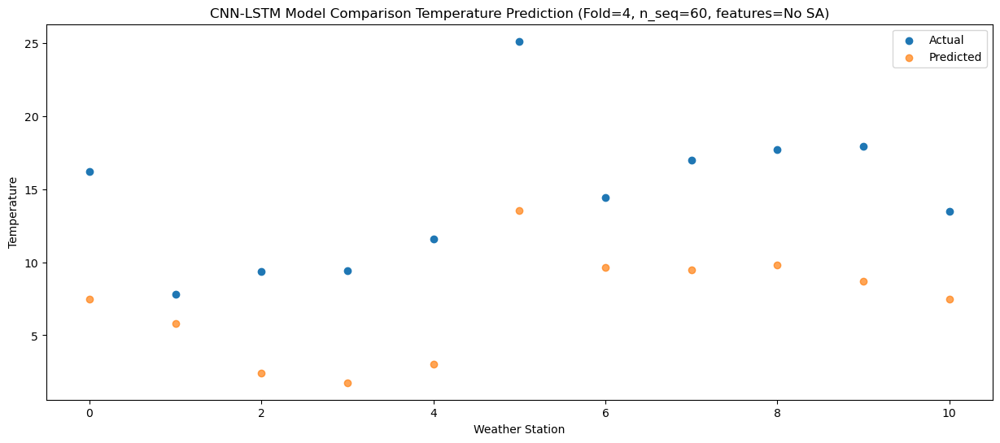

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  11.102901
1                 1    9.51   9.421743
2                 2   12.63   6.041983
3                 3   13.95   5.402225
4                 4   16.28   6.672258
5                 5   27.49  17.162106
6                 6   17.64  13.272017
7                 7   22.28  13.092460
8                 8   22.19  13.472836
9                 9   22.53  12.343064
10               10   16.76  11.102702


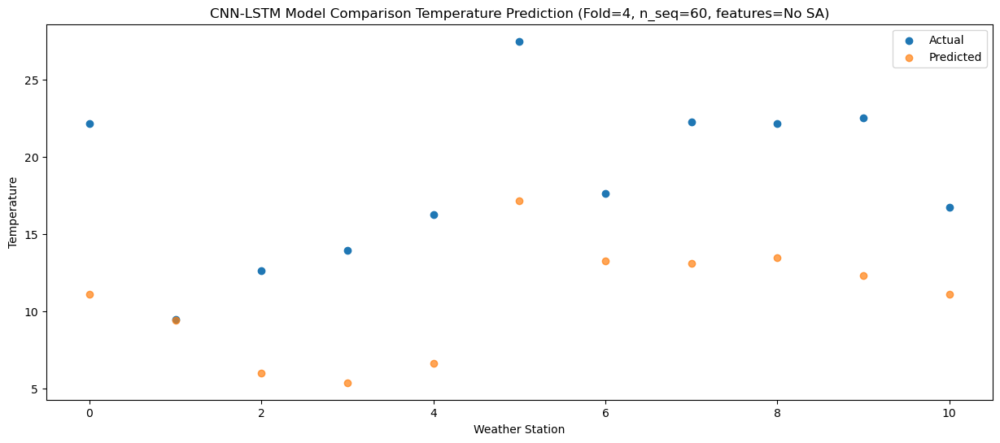

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  13.035238
1                 1    9.88  11.353773
2                 2   12.83   7.974084
3                 3   17.25   7.334389
4                 4   19.70   8.604432
5                 5   29.39  19.094244
6                 6   18.91  15.204113
7                 7   25.98  15.024678
8                 8   24.13  15.405145
9                 9   23.35  14.275433
10               10   19.36  13.034976


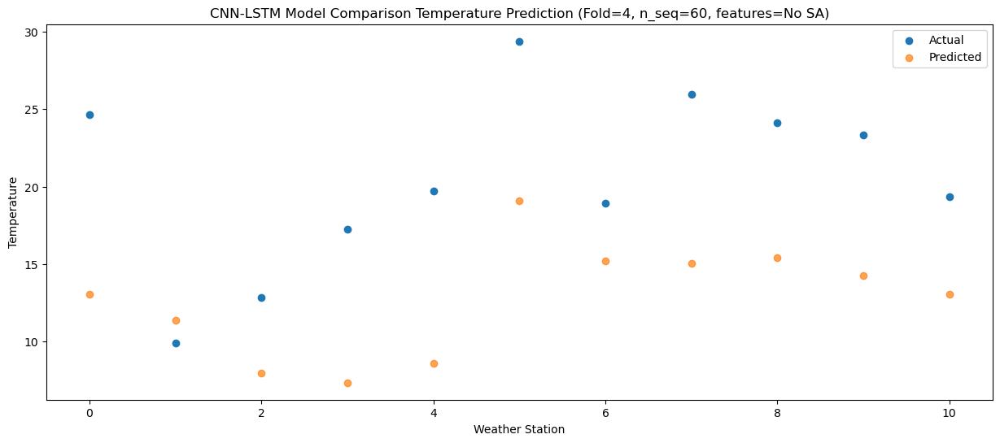

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  11.743198
1                 1    9.83  10.061106
2                 2   11.29   6.681575
3                 3   14.52   6.042000
4                 4   16.86   7.312066
5                 5   26.09  17.801806
6                 6   17.39  13.911603
7                 7   22.46  13.732407
8                 8   21.90  14.113052
9                 9   22.05  12.983464
10               10   18.29  11.742810


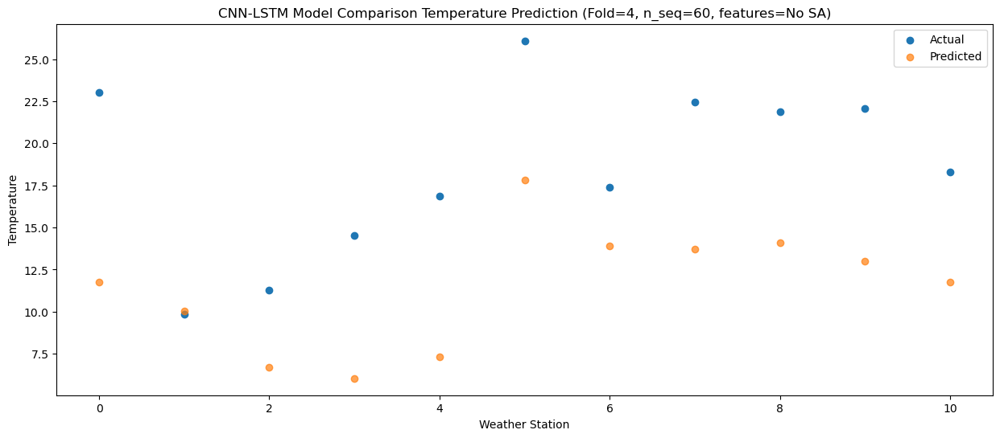

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09   8.581620
1                 1    8.39   6.899406
2                 2    9.22   3.519910
3                 3   11.09   2.880353
4                 4   12.77   4.150420
5                 5   23.19  14.640141
6                 6   14.30  10.749940
7                 7   18.87  10.570784
8                 8   17.99  10.951470
9                 9   17.91   9.821903
10               10   14.24   8.581219


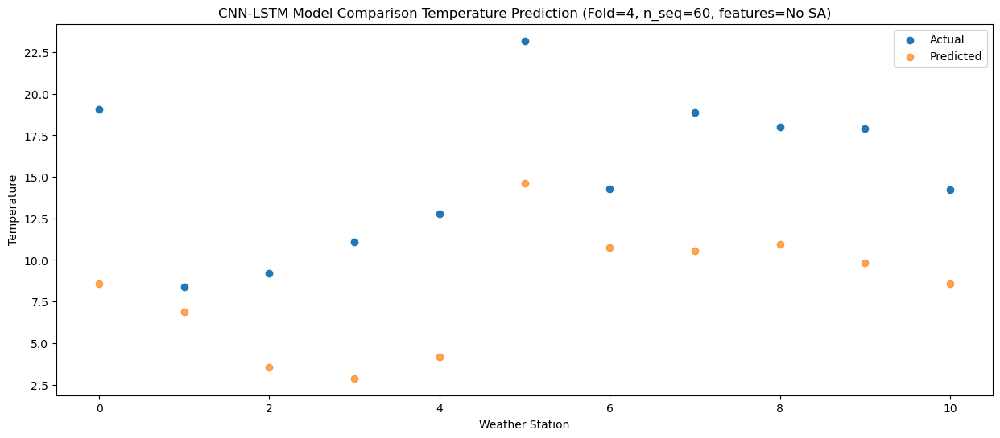

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   1.797083
1                 1    4.56   0.114634
2                 2    3.09  -3.264804
3                 3    4.22  -3.904324
4                 4    5.62  -2.634251
5                 5   16.38   7.855432
6                 6    7.43   3.965232
7                 7   12.50   3.786162
8                 8   10.50   4.166935
9                 9   10.44   3.037410
10               10    7.38   1.796662


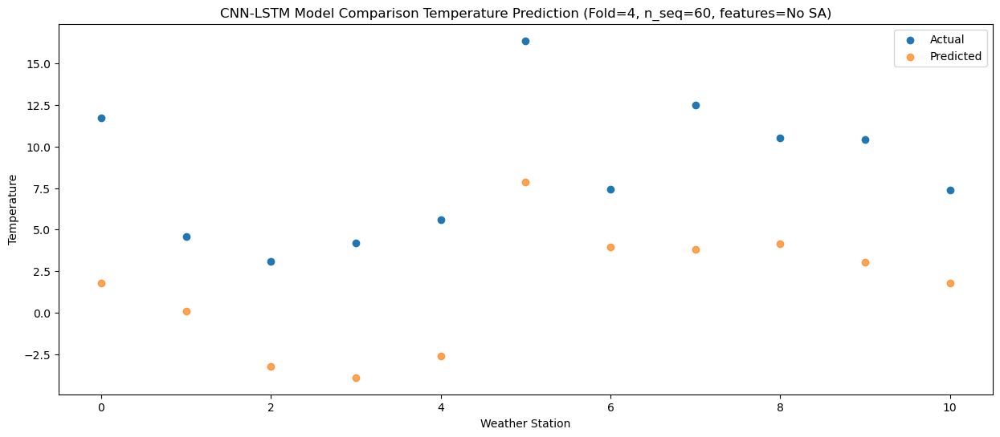

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41  -3.373613
1                 1    3.10  -5.056234
2                 2   -1.50  -8.435630
3                 3   -2.83  -9.075124
4                 4   -1.47  -7.805043
5                 5    8.53   2.684616
6                 6    4.73  -1.205593
7                 7    5.95  -1.384597
8                 8    4.71  -1.003774
9                 9    4.90  -2.133267
10               10    3.30  -3.374063


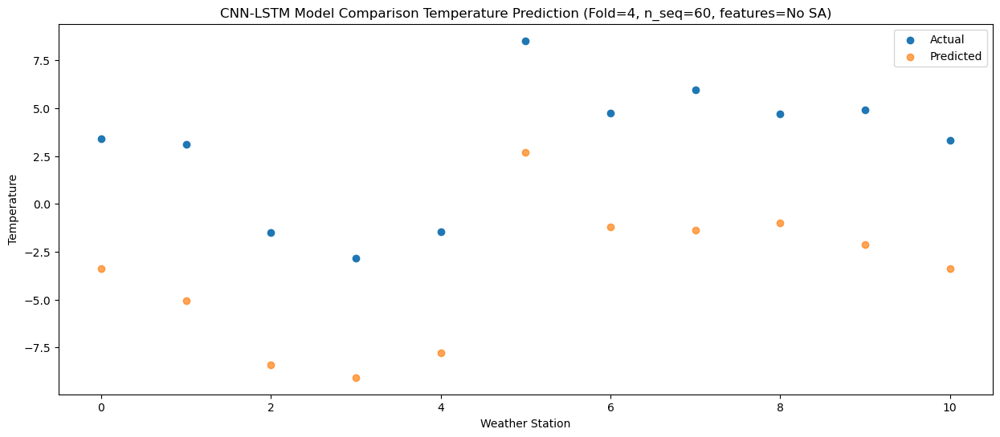

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -7.632551
1                 1   -1.75  -9.315185
2                 2   -3.93 -12.694578
3                 3   -5.52 -13.334068
4                 4   -4.44 -12.063983
5                 5    6.93  -1.574324
6                 6   -1.22  -5.464541
7                 7    1.10  -5.643541
8                 8   -1.07  -5.262715
9                 9   -1.83  -6.392211
10               10   -3.41  -7.633008


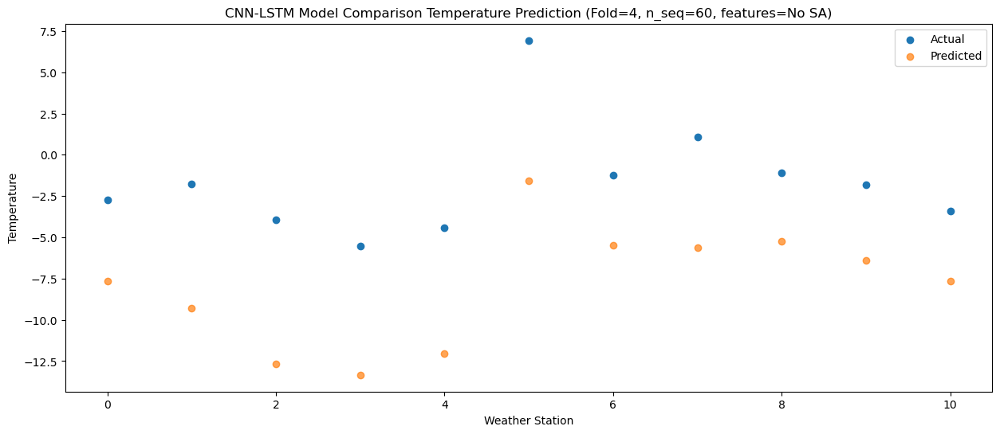

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77  -6.682363
1                 1   -1.90  -8.365354
2                 2   -3.52 -11.744657
3                 3   -4.53 -12.384084
4                 4   -3.67 -11.113987
5                 5    7.30  -0.624367
6                 6    1.80  -4.514618
7                 7    2.75  -4.693486
8                 8    0.89  -4.312550
9                 9    0.41  -5.441976
10               10   -1.78  -6.682881


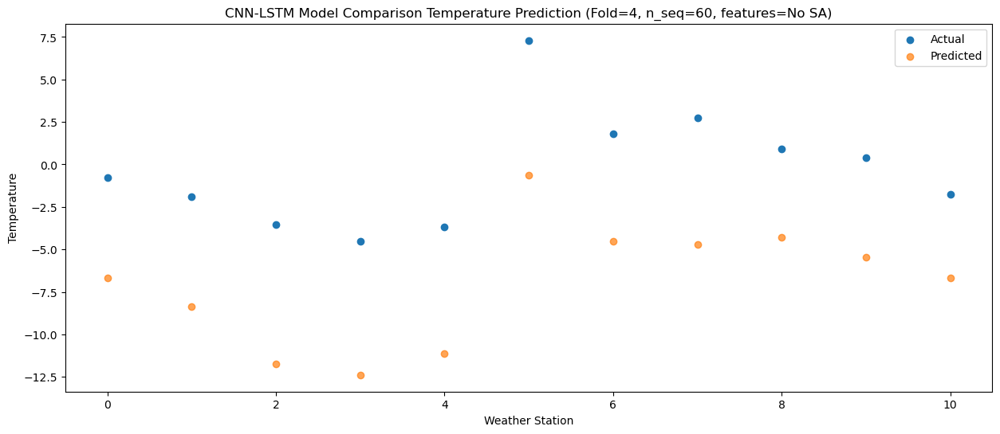

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -6.124843
1                 1    1.40  -7.807964
2                 2   -1.58 -11.187238
3                 3   -4.47 -11.826637
4                 4   -3.44 -10.556542
5                 5    7.47  -0.066924
6                 6    5.22  -3.957199
7                 7    4.89  -4.136014
8                 8    2.48  -3.755043
9                 9    1.60  -4.884439
10               10   -1.64  -6.125391


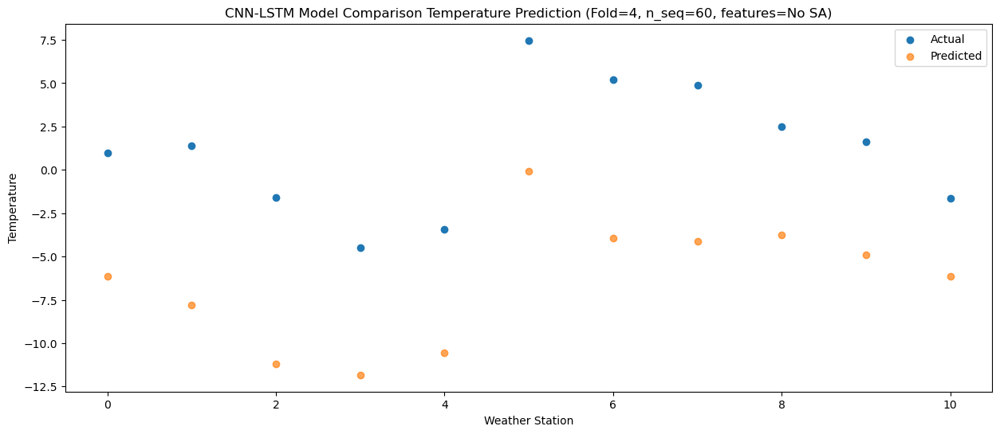

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16  -3.683514
1                 1    3.12  -5.366602
2                 2    0.57  -8.745895
3                 3    0.06  -9.385298
4                 4    1.41  -8.115203
5                 5   12.54   2.374416
6                 6    5.70  -1.515850
7                 7    6.61  -1.694673
8                 8    3.75  -1.313708
9                 9    4.14  -2.443102
10               10   -0.76  -3.684052


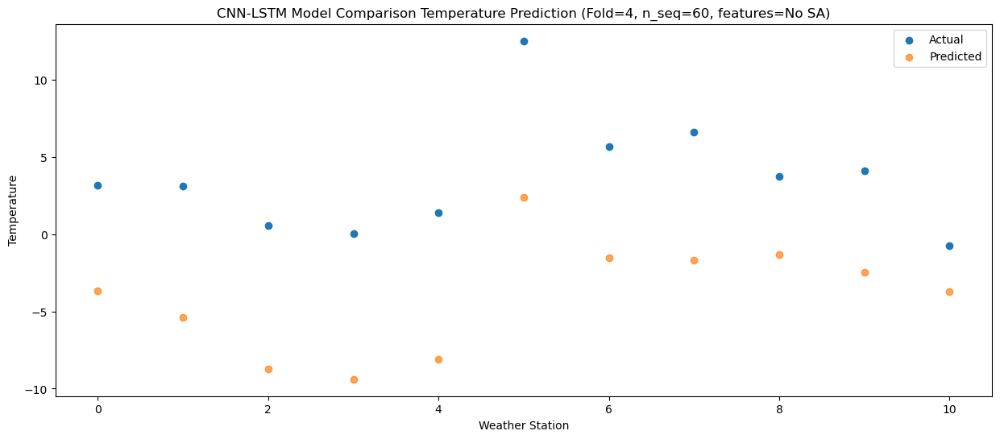

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   0.907504
1                 1    5.84  -0.775286
2                 2    2.32  -4.154657
3                 3    2.66  -4.794117
4                 4    4.06  -3.524036
5                 5   16.76   6.965623
6                 6    8.81   3.075390
7                 7   12.23   2.896453
8                 8   10.25   3.277336
9                 9   11.47   2.147885
10               10    7.71   0.907031


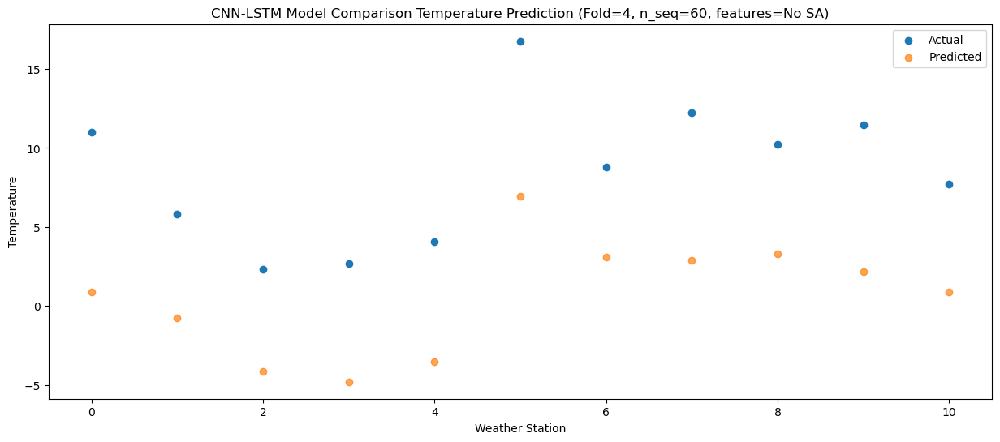

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80   4.880976
1                 1    6.62   3.198551
2                 2    7.18  -0.180919
3                 3    8.34  -0.820445
4                 4   10.22   0.449624
5                 5   21.68  10.939342
6                 6   11.43   7.049132
7                 7   17.01   6.870054
8                 8   15.96   7.250819
9                 9   17.23   6.121299
10               10   11.40   4.880554


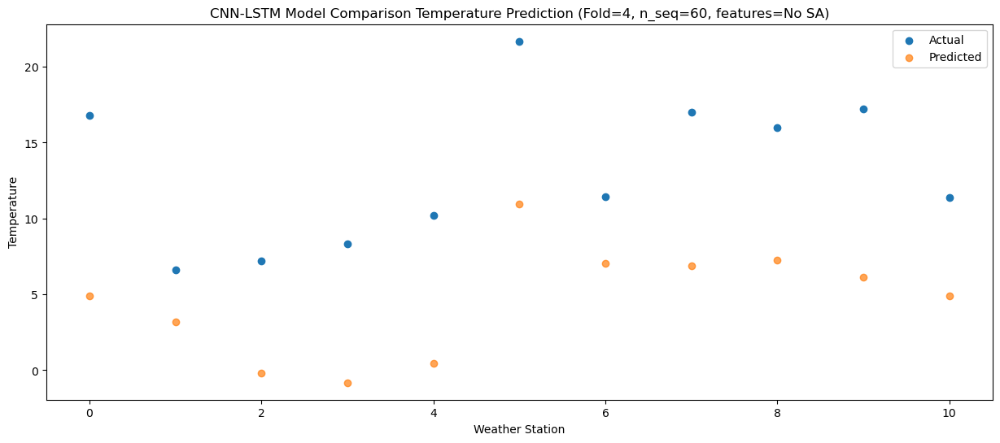

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71   8.637266
1                 1    8.83   6.954440
2                 2   10.77   3.575070
3                 3   12.53   2.935624
4                 4   15.33   4.205705
5                 5   28.16  14.695362
6                 6   15.07  10.805123
7                 7   21.09  10.626194
8                 8   19.84  11.007085
9                 9   21.54   9.877639
10               10   15.71   8.636776


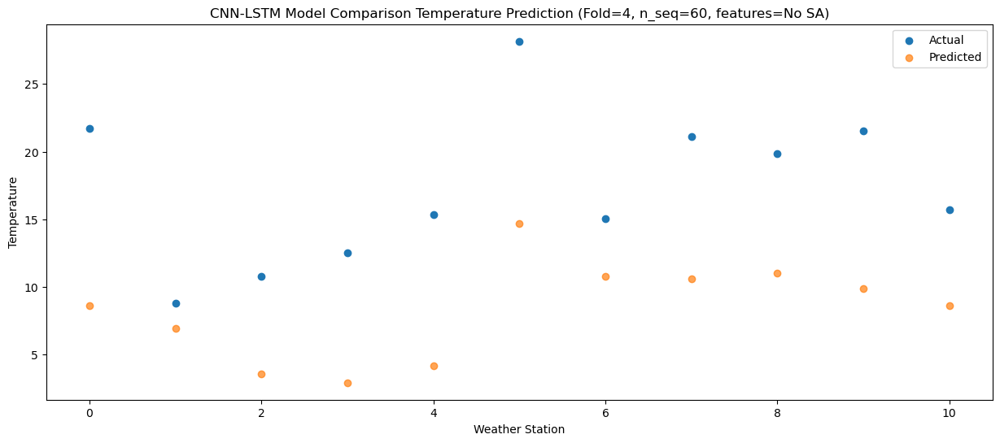

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  11.781837
1                 1   10.44  10.099053
2                 2   12.55   6.719672
3                 3   15.08   6.080220
4                 4   18.41   7.350299
5                 5   29.62  17.839967
6                 6   18.94  13.949732
7                 7   23.05  13.770788
8                 8   22.57  14.151653
9                 9   23.07  13.022202
10               10   18.80  11.781358


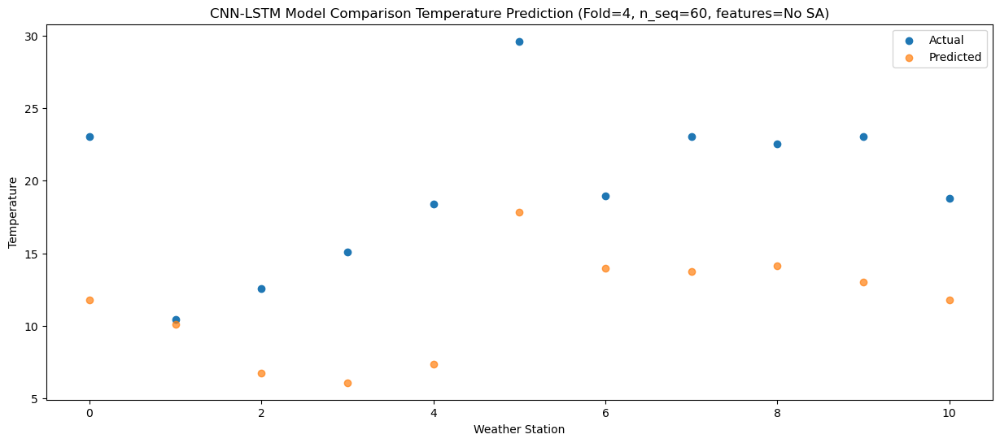

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  11.226330
1                 1   10.95   9.543253
2                 2   14.63   6.163941
3                 3   17.63   5.524549
4                 4   20.28   6.794636
5                 5   29.71  17.284274
6                 6   18.38  13.394001
7                 7   22.86  13.215167
8                 8   21.41  13.596113
9                 9   21.81  12.466712
10               10   17.47  11.225793


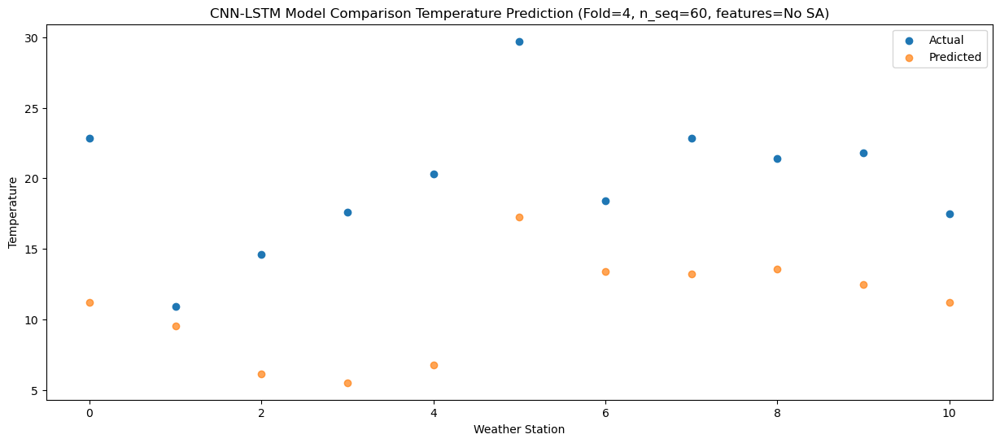

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99   7.903981
1                 1    8.85   6.220915
2                 2   10.88   2.841601
3                 3   12.93   2.202211
4                 4   15.19   3.472302
5                 5   26.23  13.961945
6                 6   14.54  10.071657
7                 7   18.92   9.892823
8                 8   18.32  10.273755
9                 9   18.77   9.144350
10               10   15.13   7.903429


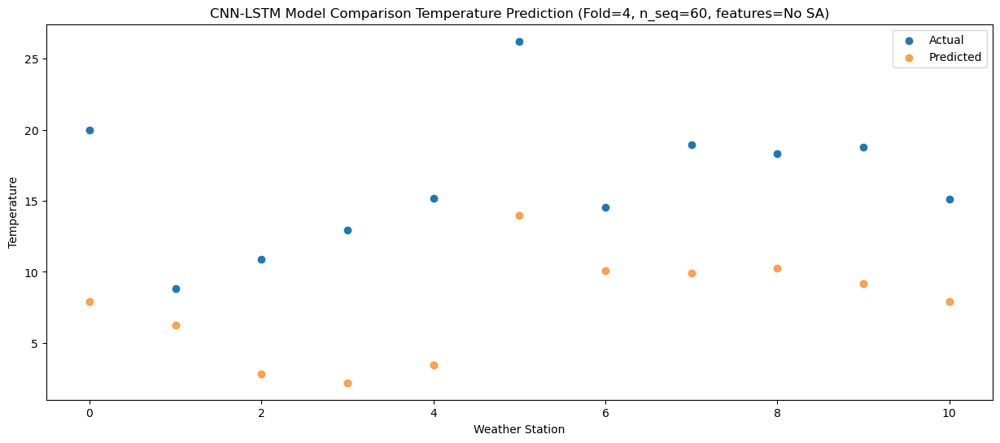

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87   1.835099
1                 1    5.20   0.151669
2                 2    4.77  -3.227549
3                 3    4.80  -3.866865
4                 4    6.36  -2.596762
5                 5   17.70   7.892833
6                 6    9.10   4.002503
7                 7   13.02   3.823808
8                 8   12.18   4.204846
9                 9   12.36   3.075514
10               10    9.87   1.834475


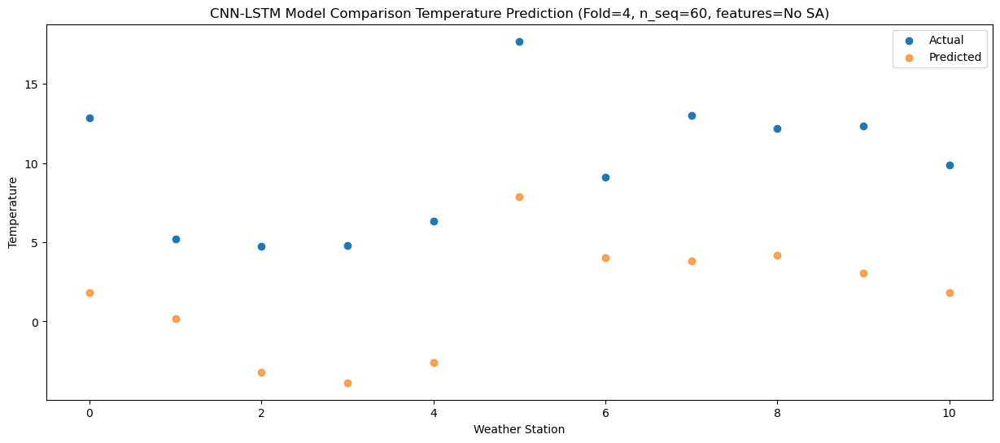

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62  -4.774530
1                 1    1.49  -6.458069
2                 2   -2.19  -9.837261
3                 3   -1.27 -10.476552
4                 4   -0.17  -9.206444
5                 5   10.99   1.283135
6                 6    3.37  -2.607208
7                 7    7.12  -2.785859
8                 8    5.11  -2.404793
9                 9    5.27  -3.534102
10               10    2.48  -4.775174


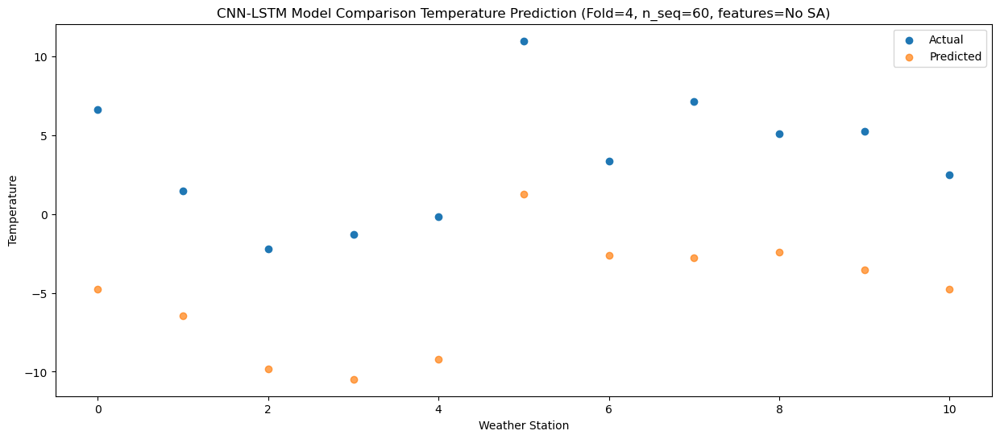

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22  -7.460400
1                 1   -0.63  -9.144106
2                 2   -4.74 -12.523254
3                 3   -4.29 -13.162506
4                 4   -3.30 -11.892393
5                 5    8.19  -1.402832
6                 6    1.16  -5.293200
7                 7    4.24  -5.471790
8                 8    3.22  -5.090691
9                 9    3.28  -6.219964
10               10    1.82  -7.461093


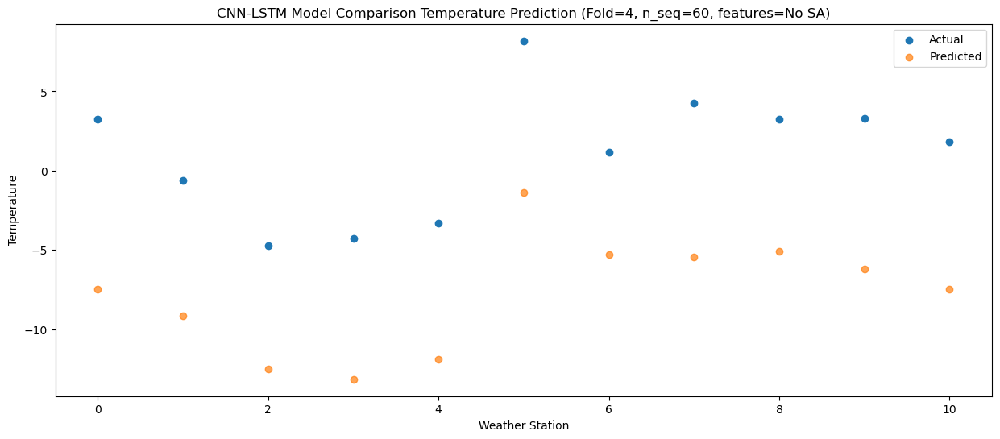

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37 -11.657361
1                 1   -2.05 -13.340755
2                 2   -8.93 -16.719980
3                 3   -9.81 -17.359290
4                 4   -8.65 -16.089188
5                 5    3.94  -5.599580
6                 6   -1.28  -9.489924
7                 7   -2.92  -9.668635
8                 8   -3.06  -9.287632
9                 9   -4.30 -10.416969
10               10   -3.95 -11.658003


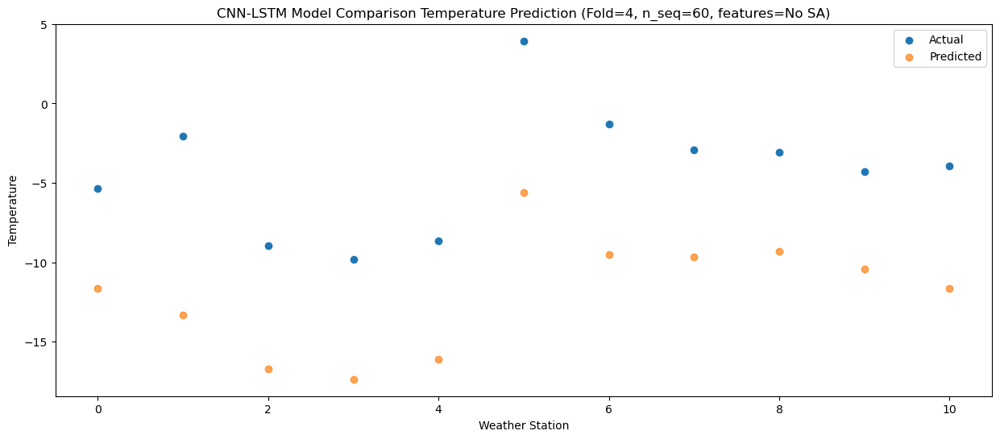

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74  -7.466255
1                 1   -2.32  -9.149811
2                 2   -2.61 -12.528996
3                 3   -1.40 -13.168269
4                 4   -0.33 -11.898160
5                 5   10.76  -1.408569
6                 6    2.13  -5.298943
7                 7    6.99  -5.477584
8                 8    3.28  -5.096544
9                 9    3.47  -6.225854
10               10   -0.47  -7.466937


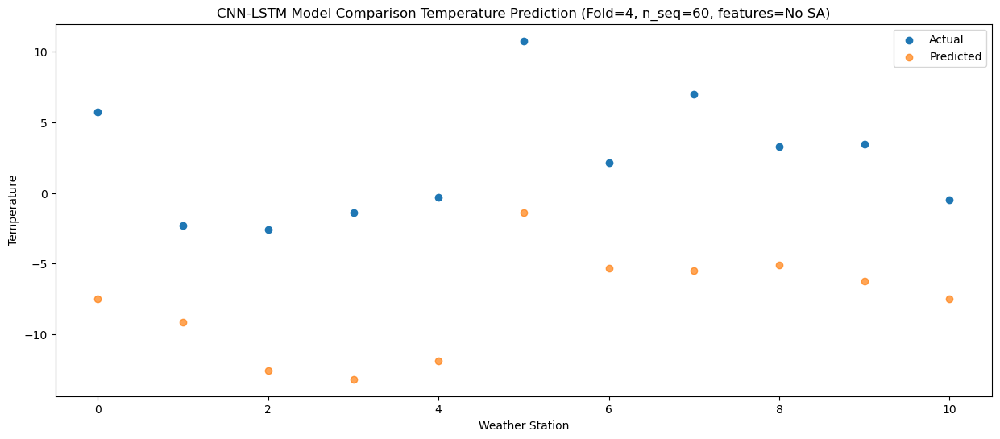

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27  -4.537002
1                 1    2.58  -6.220595
2                 2   -0.38  -9.599774
3                 3    1.01 -10.239035
4                 4    2.24  -8.968922
5                 5   13.36   1.520668
6                 6    5.92  -2.369722
7                 7    9.42  -2.548344
8                 8    7.72  -2.167302
9                 9    7.62  -3.296606
10               10    2.88  -4.537705


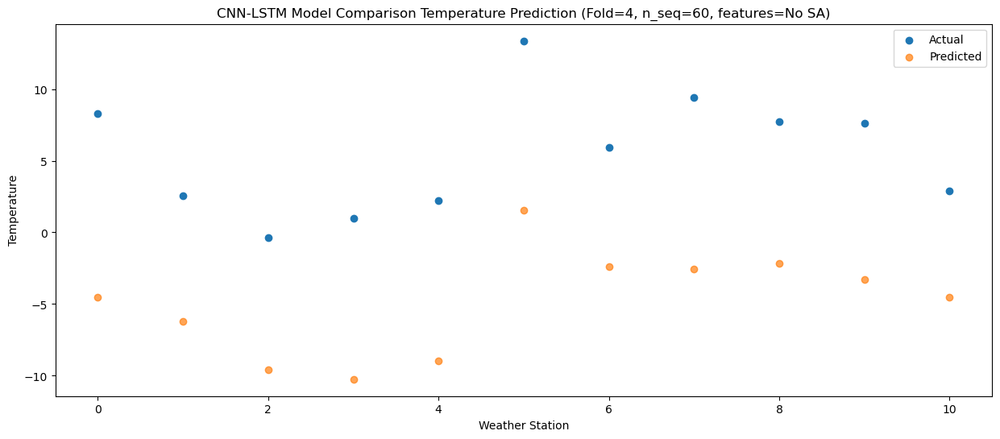

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89  -0.507180
1                 1    3.63  -2.190589
2                 2    3.44  -5.569819
3                 3    4.86  -6.209121
4                 4    6.29  -4.939014
5                 5   18.32   5.550604
6                 6   10.15   1.660229
7                 7   13.56   1.481544
8                 8   12.30   1.862531
9                 9   12.11   0.733202
10               10    8.60  -0.507852


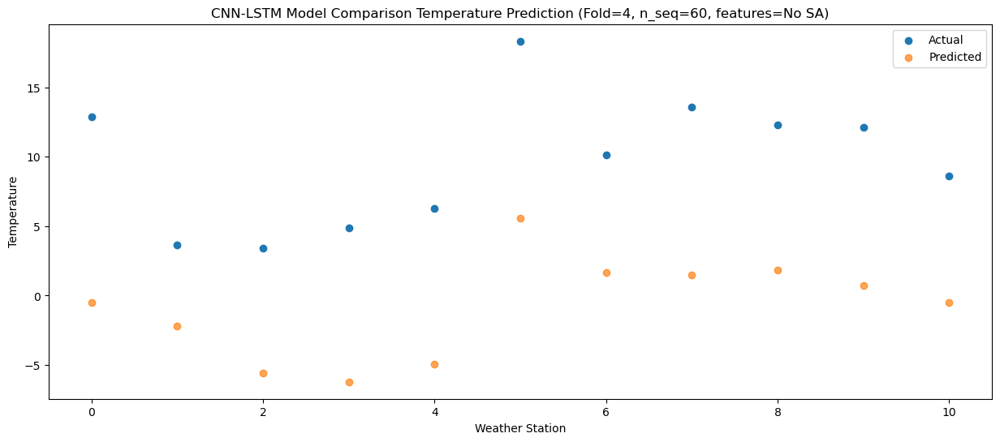

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90   4.145721
1                 1    9.08   2.462407
2                 2    8.96  -0.916843
3                 3    9.62  -1.556169
4                 4   11.09  -0.286067
5                 5   23.61  10.203560
6                 6   14.22   6.313205
7                 7   18.21   6.134484
8                 8   18.90   6.515452
9                 9   19.14   5.386099
10               10   14.70   4.145077


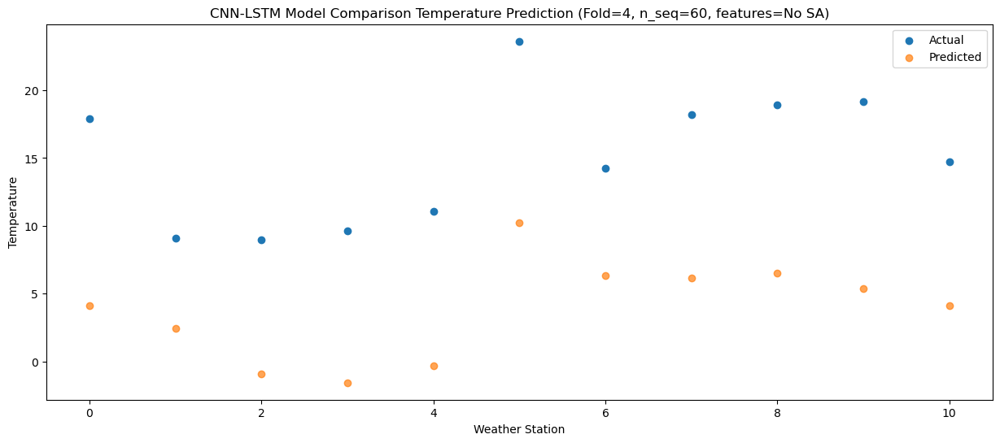

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09   8.466886
1                 1    9.73   6.783089
2                 2   11.59   3.403957
3                 3   13.65   2.764731
4                 4   15.54   4.034849
5                 5   27.62  14.524407
6                 6   17.64  10.634003
7                 7   21.93  10.455473
8                 8   22.26  10.836588
9                 9   23.11   9.707317
10               10   17.86   8.466148


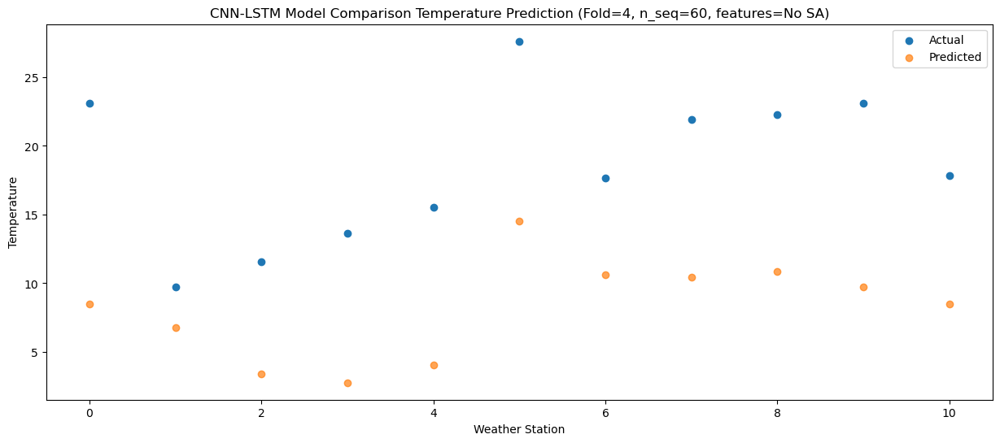

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85   9.208439
1                 1   10.42   7.524500
2                 2   12.61   4.145408
3                 3   14.55   3.506209
4                 4   16.25   4.776331
5                 5   26.45  15.265878
6                 6   19.10  11.375457
7                 7   22.23  11.196969
8                 8   22.27  11.578131
9                 9   22.14  10.448888
10               10   19.38   9.207671


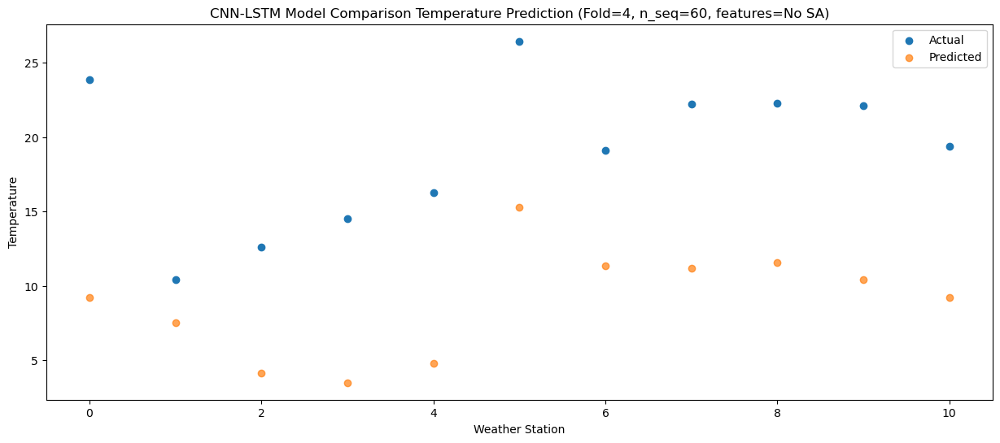

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36   8.809744
1                 1   10.12   7.125939
2                 2   13.18   3.746811
3                 3   16.30   3.107584
4                 4   18.21   4.377701
5                 5   28.91  14.867262
6                 6   17.94  10.976861
7                 7   22.67  10.798321
8                 8   22.19  11.179450
9                 9   21.80  10.050180
10               10   18.24   8.809012


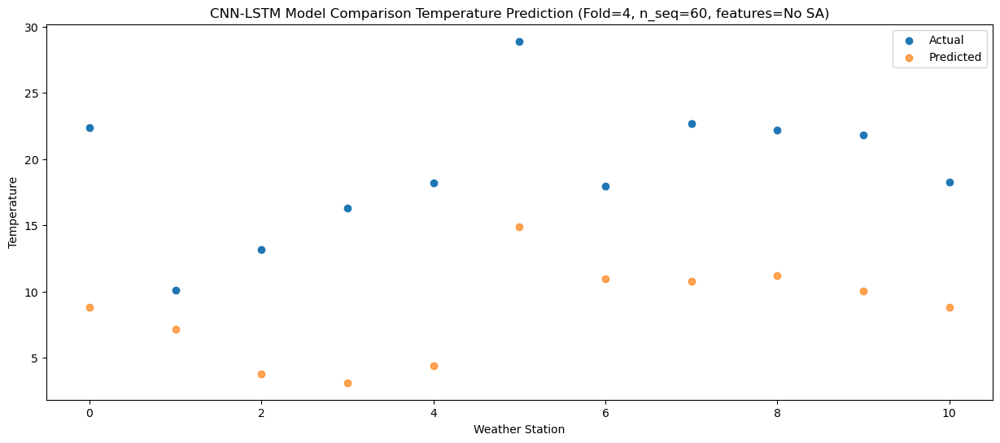

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93   5.397155
1                 1    9.25   3.713537
2                 2    9.57   0.334358
3                 3   10.91  -0.304909
4                 4   12.20   0.965208
5                 5   22.46  11.454789
6                 6   15.50   7.564412
7                 7   18.53   7.385797
8                 8   19.58   7.766877
9                 9   18.57   6.637572
10               10   15.97   5.396460


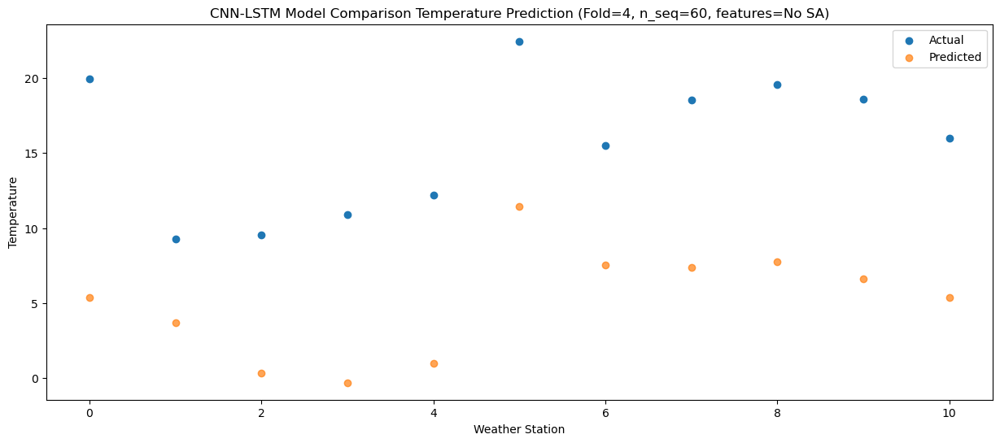

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80   1.025137
1                 1    5.48  -0.658789
2                 2    5.43  -4.037889
3                 3    8.16  -4.677097
4                 4    9.78  -3.406972
5                 5   20.75   7.082561
6                 6    9.88   3.192163
7                 7   14.85   3.013664
8                 8   13.65   3.394845
9                 9   13.50   2.265596
10               10    9.50   1.024397


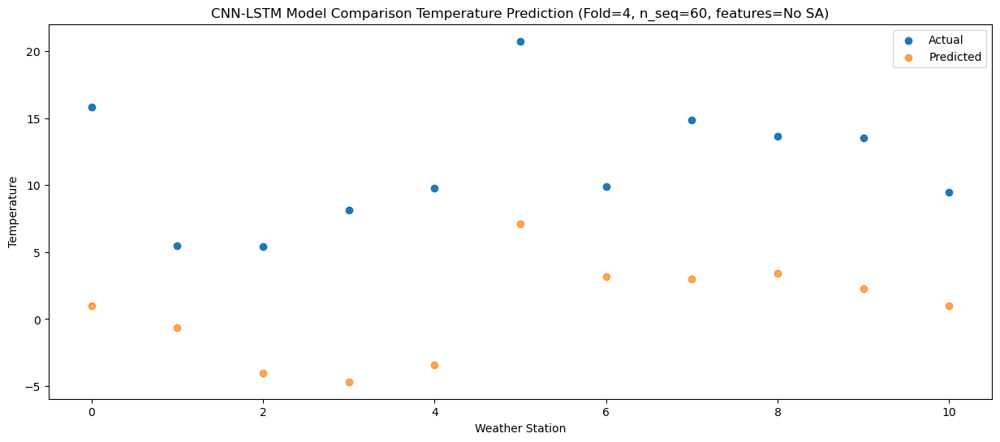

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_6 (Conv1D)           (None, 1, 256)            464896    
                                                                 
 max_pooling1d_6 (MaxPooling  (None, 1, 256)           0         
 1D)                                                             
                                                                 
 dropout_18 (Dropout)        (None, 1, 256)            0         
                                                                 
 lstm_12 (LSTM)              (None, 1, 1024)           5246976   
                                                                 
 dropout_19 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_13 (LSTM)              (None, 1024)              8392704   
                                                      

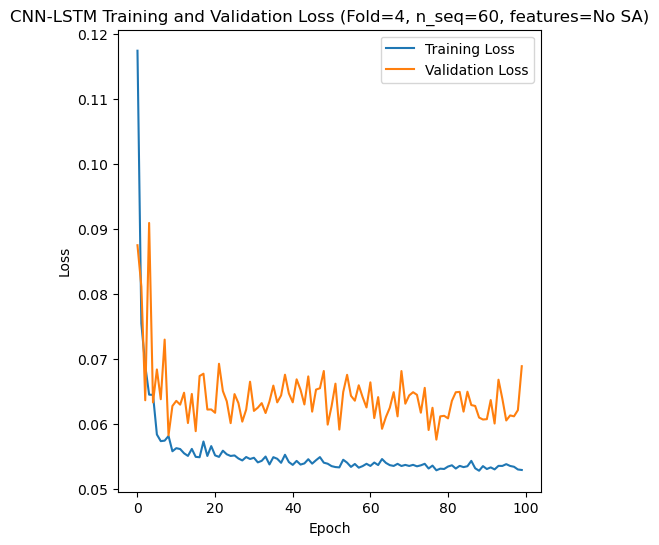

[[1.4168938469163934, 0.9766120907892615, 1.3325180006214332, 1.6863912427196939, 2.0106716470958803, 1.5549175977049319, 2.511059827353368, 3.1349439001104176, 3.4761939714333097, 2.6328313659610565, 2.188855013640158, 1.045982700308973, 1.6032757389610086, 1.679464812611269, 1.572293809065806, 2.10479637361711, 1.64434342463901, 2.039945344745704, 2.7080088946334695, 3.9537850002750154, 3.2086227368331848, 3.68938409199189, 3.4569259756607544, 2.983696375291174, 2.807646139995635, 2.280629565996111, 2.232066079888251, 1.585528472938365, 1.4148552823272273, 2.6808950977227646, 3.3982827065015204, 3.7174589466067016, 4.50228940598375, 4.4301344839005115, 3.713350915556258, 3.753356041427879, 2.576221812407818, 3.223607596103118, 2.4361419718335875, 1.998335532436665, 3.1557668058089448, 3.991019632811593, 4.831259087008068, 5.599925597220612, 5.593520023548944, 5.379568198295629, 5.754752920808044, 5.429269027324687, 4.592159031871321, 5.200889158301349, 4.406454485856716, 4.6164866529

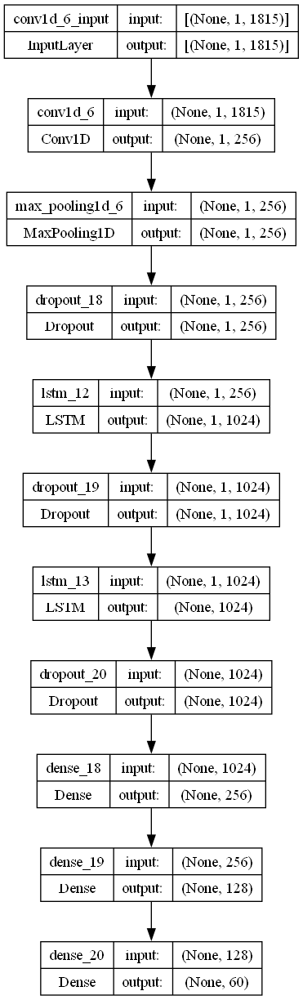

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 256
    lr = 0.0014335369627198127
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 1024
    dropout_rate = 0.11945020126222661

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# make one forecast with a CNN-LSTM model,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)